In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import os,sys, gc
import keras


dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import clean_LC,generate_representation
from evaluation import calculate_metrics, evaluate_metadata, evaluate_metadata_raw


folder = "../../KOI_Data/"
folder_lc = "/work/work_teamEXOPLANET/KOI_LC/"

Using TensorFlow backend.


In [2]:
def impute_on_pandas(df):
    return df.fillna(df.median(),inplace=False)

df_meta = pd.read_csv(folder+"/kepler_dataset.csv")
all_labels = df_meta["NExScI Disposition"].values
mask_conf = (all_labels=="CONFIRMED")
mask_fp = (all_labels=="FALSE POSITIVE")
mask_cand = (all_labels=="CANDIDATE")

#NEW METADATA SELECTED!
metadata_used = ["Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",
                 "Inclination", "Impact Parameter", 
                 "Fitted Stellar Density",
                 "Teq",
                 "Limb Darkening Coeff1", "Limb Darkening Coeff2",
                "Teff","Stellar Radius", "Stellar Mass"]
#dividir duration por 24??
df_meta["Duration"] = df_meta["Duration"]/24

#df_meta["Time of Transit Epoch"] = df_meta["Time of Transit Epoch"]- time_kepler[:,0] #modificacion

df_meta_obj = df_meta[metadata_used]
mask_nan = pd.isna(df_meta_obj)

df_meta_obj = impute_on_pandas(df_meta_obj)

df_meta_obj.head()

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
0,8.884923,0.086252,169.991686,0.114,36.466,89.89,0.069,11.62061,770.0,0.497,0.204,5332.0,0.843,0.821
1,5.092465,0.152458,357.535940,0.014,10.670,89.14,0.161,0.88510,844.0,0.551,0.165,5037.0,0.751,0.727
2,275.073650,0.140417,315.248600,0.014,512.000,89.93,0.595,33.55994,303.0,0.437,0.243,5604.0,1.187,0.864
3,8.460439,0.197288,133.774490,0.478,14.087,85.68,1.061,0.73874,804.0,0.299,0.306,5951.0,0.702,0.796
4,21.761298,0.051792,166.540438,0.032,137.070,89.95,0.123,102.86534,486.0,0.627,0.108,4859.0,0.720,0.781


In [3]:
df_sets = pd.read_csv(folder+"/koi_sets.csv") 
mask_train = (df_sets["Set"] == "Train").values
mask_test = (df_sets["Set"] == "Test").values
mask_unlabeled = (df_sets["Set"] == "Unlabeled").values

mask_train_conf = mask_train & mask_conf
mask_test_conf = mask_test & mask_conf

In [4]:
Y_train = df_meta_obj.values[mask_train_conf]
Y_test = df_meta_obj.values[mask_test_conf]
Y_train.shape

(1610, 14)

In [5]:
#pre-process: scale metadata
from sklearn.preprocessing import StandardScaler, RobustScaler
#scaler_meta = RobustScaler()
scaler_meta = StandardScaler()

Ystd_train = scaler_meta.fit_transform(Y_train)
Ystd_test = scaler_meta.transform(Y_test)

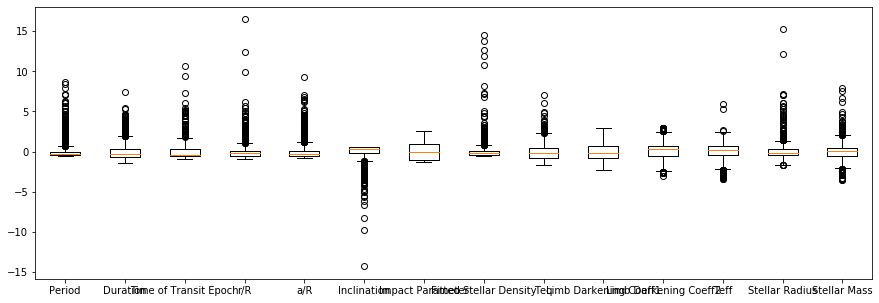

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
count,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03
mean,-3.054837e-17,7.499867e-16,5.907007e-15,-1.612582e-15,1.519764e-15,-6.772423e-14,1.335026e-15,6.172502e-16,2.427320e-17,-2.639779e-15,2.343305e-14,2.711427e-16,-2.270130e-15,3.242375e-15
std,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00
min,-5.908227e-01,-1.450501e+00,-8.906004e-01,-8.851677e-01,-8.407552e-01,-1.431460e+01,-1.305204e+00,-5.335584e-01,-1.728111e+00,-2.258535e+00,-3.089904e+00,-3.395382e+00,-1.703084e+00,-3.525412e+00
25%,-4.821600e-01,-6.703882e-01,-5.516610e-01,-5.040630e-01,-5.662212e-01,-1.426957e-01,-1.045922e+00,-4.219073e-01,-7.441942e-01,-8.013483e-01,-5.591437e-01,-4.824721e-01,-4.884028e-01,-5.372881e-01
50%,-3.365976e-01,-2.669818e-01,-4.050554e-01,-2.076482e-01,-3.274285e-01,3.226130e-01,-8.717967e-02,-2.298973e-01,-1.479202e-01,-1.761280e-01,2.596318e-01,1.926621e-01,-1.801033e-01,9.894913e-03
75%,-1.750069e-03,3.716218e-01,3.663228e-01,1.311116e-01,1.281076e-01,5.689991e-01,9.582414e-01,8.804824e-02,4.921406e-01,7.206023e-01,7.062367e-01,6.795483e-01,2.726248e-01,5.044431e-01
max,8.616681e+00,7.401561e+00,1.070401e+01,1.647627e+01,9.296306e+00,6.317726e-01,2.614182e+00,1.447999e+01,7.011231e+00,2.932537e+00,2.983921e+00,5.973887e+00,1.529320e+01,7.896348e+00


In [6]:
### boxplot de las variables..
plt.figure(figsize=(15,5))
plt.boxplot(Ystd_train)
plt.xticks(np.arange(len(metadata_used))+1,metadata_used)
plt.show()
aux_df = pd.DataFrame(Ystd_train)
aux_df.columns = metadata_used
aux_df.describe()

In [7]:
### evaluar.. residuo + errores .
def get_res(x,xhat):
    x = np.squeeze(x)
    xhat = np.squeeze(xhat)
    return x - xhat

def RMSE_LC(x, xhat, res=[]):
    if len(res) == 0:
        res = get_res(x, xhat)
    return np.mean( np.sqrt(np.mean(np.square(res), axis=-1)) )

def MSE_LC(x, xhat, res=[]):
    if len(res) == 0:
        res = get_res(x, xhat)
    return np.mean(np.mean( np.square(res), axis=-1))

def MAE_LC(x, xhat, res=[]):
    if len(res) == 0:
        res = get_res(x, xhat)
    return np.mean( np.mean( np.abs(res), axis=-1))

def evaluate_reconst(x,xhat):
    print("----- EVALUANDO RECONSTRUCCION DE LA CURVA -----")
    res = get_res(x, xhat)
    plt.figure(figsize=(8,5))
    sns.distplot(res.flatten())
    plt.title("Distribucion de residuos promedio")
    plt.show()
    
    print("MSE      = ",MSE_LC(None,None, res))
    print("RMSE (+-)= ",RMSE_LC(None,None, res))
    print("MAE  (+-)= ",MAE_LC(None,None, res))
    
    print("--------- Smoothness ------------")
    xhat = np.squeeze(xhat)
    A = np.mean(np.apply_along_axis(autocorr_func, 1, xhat)[:,1])
    print("AutoCorr lag-one = ",A)
    M = np.mean(np.apply_along_axis(mean_diff, 1, xhat))
    print("Diff MEAN = ",M)
    S = np.mean(np.apply_along_axis(std_diff, 1, xhat))
    print("Diff STD = ",S)
    print("--------- Smoothness ------------")
        
#https://en.wikipedia.org/wiki/Autocorrelation
#https://stats.stackexchange.com/questions/24607/how-to-measure-smoothness-of-a-time-series-in-r
def autocorr_func(x):
    #FATS: https://arxiv.org/pdf/1506.00010.pdf
    if np.sum(x) == 0:
        return 0
    inp = x - np.mean(x)
    result = np.correlate(inp, inp, mode='full')
    return result[len(x)-1:]/np.var(x, ddof=len(x)-1)

#:::::::lag-one autocorrelation
# scores near 1 imply a smoothly varying series
# scores near 0 imply that there's no overall linear relationship between a data point and the following one (that is, plot(x[-length(x)],x[-1]) won't give a scatterplot with any apparent linearity)
# scores near -1 suggest that the series is jagged in a particular way: if one point is above the mean, the next is likely to be below the mean by about the same amount, and vice
def std_diff(x):
    if np.sum(x) == 0:
        return 0
    aux = np.abs(np.diff(x, axis=-1))
    return np.std(aux)#/np.mean(aux)

def mean_diff(x):
    if np.sum(x) == 0:
        return 0
    aux = np.abs(np.diff(x, axis=-1))
    return np.mean(aux)#/np.mean(aux)

### Create dataset

In [8]:
mask_transit = np.load("data/mask_transit_LC.npy")  #
# datos de abajo debieran ser todas las curvas.. poner mascara sobre los utilziados
mask_transit

array([ True,  True, False, ...,  True,  True,  True])

In [9]:
T = 300
X_fold_lc = np.load("data/LC_global_%dT.npy"%T)
X_fold_lc_aug = np.load("data/LC_globalA_%dT.npy"%T)
X_fold_time = np.load("data/Time_global_%dT.npy"%T)
X_fold_lc.shape

(8054, 300)

In [10]:
## NEW : set mask
X_fold_lc_tr = X_fold_lc[mask_transit]
X_fold_lc_aug_tr = X_fold_lc_aug[mask_transit]
X_fold_time_tr = X_fold_time[mask_transit]
N,T = X_fold_lc_tr.shape

In [11]:
mask_train = np.random.rand(X_fold_lc_tr.shape[0])< 1#0.75
mask_test = ~mask_train

In [12]:
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train_t = np.concatenate([X_fold_time_tr[mask_train], X_fold_time_tr[mask_train]], axis=0)
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train = np.concatenate([X_fold_lc_tr[mask_train], X_fold_lc_aug_tr[mask_train]], axis=0)

if Ystd_train.shape[0] != X_train.shape[0]:
    Ystd_train = np.tile(Ystd_train, (2,1))

#X_test = X_fold_lc[mask_test[mask_conf]]
X_test = X_fold_lc_tr[mask_test]
#X_test_t = X_fold_time[mask_test[mask_conf]]
X_test_t = X_fold_time_tr[mask_test]

X_train = np.expand_dims(X_train, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

X_train_t = np.expand_dims(X_train_t, axis=-1)
X_test_t = np.expand_dims(X_test_t, axis=-1)

print("X train shape: ",X_train.shape)
print("X train time shape: ",X_train_t.shape)
print("X test shape: ",X_test.shape)
print("Y train shape: ",Ystd_train.shape)
print("Y test shape: ",Ystd_test.shape)

X train shape:  (8634, 300, 1)
X train time shape:  (8634, 300, 1)
X test shape:  (0, 300, 1)
Y train shape:  (3220, 14)
Y test shape:  (671, 14)


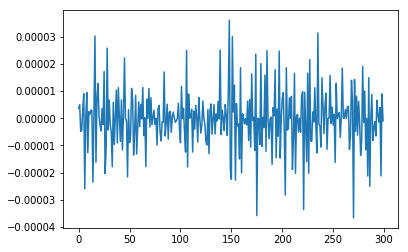

In [60]:
plt.plot(X_train[1248,:,0])
plt.show()

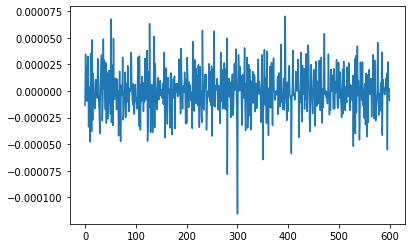

In [58]:
plt.plot(X_train[1248,:,0])
plt.show()

###  NEW

In [13]:
def scaled_MSE(y_true,y_pred,scale):
    return np.mean(np.mean( scale**2 * np.mean( (y_true - y_pred)**2 , axis=1), axis=0))

S_train = 1/np.std(X_train, axis=1)
S_test = 1/np.std(X_test, axis=1)

S_fold = 1/np.std(X_fold_lc, axis=1) #all data

S_mu = np.mean(S_train)
S_std = np.std(S_train) 

In [14]:
X_train = X_train*S_train[:,None,:]
X_test = X_test*S_test[:,None,:]

X_train_all = X_fold_lc*S_fold[:,None]
X_train_t_all = X_fold_time

X_train_all = np.expand_dims(X_train_all, axis=-1)
X_train_t_all = np.expand_dims(X_train_t_all, axis=-1)
X_train_t_all.shape

(8054, 300, 1)

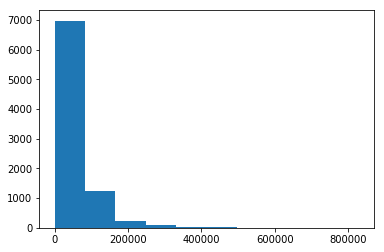

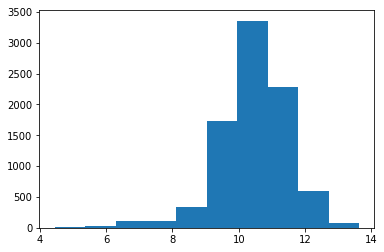

In [111]:
plt.hist(S_train)
plt.show()
plt.hist(np.log(S_train))
plt.show()

In [25]:
print("--------- Smoothness ------------")
x_aux = np.squeeze(X_train[:N,:,0])
A = np.mean(np.apply_along_axis(autocorr_func, 1, x_aux)[:,1])
print("AutoCorr lag-one = ",A)
M = np.mean(np.apply_along_axis(mean_diff, 1, x_aux))
print("Diff MEAN = ",M)
S = np.mean(np.apply_along_axis(std_diff, 1, x_aux))
print("Diff STD = ",S)
print("--------- Smoothness ------------")
del x_aux

--------- Smoothness ------------
AutoCorr lag-one =  0.2726586971818649
Diff MEAN =  0.7840281211441535
Diff STD =  0.8318126136642711
--------- Smoothness ------------


In [164]:
np.apply_along_axis(autocorr_func, 1, X_train[:N,:,0])[:,1]

array([ 0.61735923,  0.37768799,  0.21200254, ..., -0.32365263,
       -0.07688984,  0.81998818])

### Keras models

In [15]:
import keras
from keras import backend as K
from keras.models import Sequential, Model
from keras.layers import *

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
import matplotlib.pyplot as plt
def plot_n_lc(real_lc, decoded_lc, n = 10, s=None):
    for _ in range(n):
        n_sampled = np.random.randint(0, real_lc.shape[0])
        
        if s !=None:
            print("Real scale = %f\nPred scale = %f"%(s[0][n_sampled], s[1][n_sampled] ))
        f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
        ax1.plot(real_lc[n_sampled], 'b.-')
        ax1.set_title("Real")
        ax2.plot(decoded_lc[n_sampled], 'b.-')
        ax2.set_title("Reconstructed")
        plt.show()  

        plt.figure(figsize=(15,5))
        plt.plot(real_lc[n_sampled], 'bo-', label="Real")
        plt.plot(decoded_lc[n_sampled], 'g*-', label="Reconstructed")
        plt.title("Over data "+str(n_sampled))
        plt.legend()
        plt.show()
        print("----------------------------------------------------------------")

In [16]:
latent_dim = 32
_, T, channels = X_train.shape
D_dim = 5 #o variar: Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",

## Regular VAE

In [17]:
l = 0.001 #kl weight

In [18]:
def sampling(args):
    z_mean, z_log_var = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0], K.shape(z_mean)[1]), mean=0., stddev=1.)
    return z_mean + K.exp(0.5*z_log_var) * epsilon

def KL_loss(y_true, y_pred):
    return - 0.5 * K.sum(1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)

#### IF THIS IS USED,, KL WEIGHT NEEDED TO BE LOW ######
def MSE_loss(y_true, y_pred):
    v = K.mean( K.square( y_true - y_pred ), axis=1) #on time axis..    
    return K.flatten(v)

#### HAS TO BE USED IN ORDER TO LEARN #######
def SSE_loss(y_true, y_pred):
    v = K.sum( K.square( y_true - y_pred ), axis=1) #on time axis..    
    return K.flatten(v)

def vae_loss(y_true, y_pred):
    return MSE_loss(y_true, y_pred) + l*KL_loss(y_true, y_pred)

In [20]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=500, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 300, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 300, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 300, 1)       112641      T_inp[0][0]                      
          

8634/8634 [==============================] - 28s 3ms/step - loss: 0.7328 - KL_loss: 11.6926 - MSE_loss: 0.7211
Epoch 120/500
8634/8634 [==============================] - 28s 3ms/step - loss: 0.7294 - KL_loss: 12.0117 - MSE_loss: 0.7174
Epoch 121/500
8634/8634 [==============================] - 28s 3ms/step - loss: 0.7036 - KL_loss: 12.0036 - MSE_loss: 0.6916
Epoch 122/500
8634/8634 [==============================] - 27s 3ms/step - loss: 0.7501 - KL_loss: 11.4578 - MSE_loss: 0.7387
Epoch 123/500
8634/8634 [==============================] - 27s 3ms/step - loss: 0.7127 - KL_loss: 11.8085 - MSE_loss: 0.7009
Epoch 124/500
8634/8634 [==============================] - 27s 3ms/step - loss: 0.7226 - KL_loss: 11.9992 - MSE_loss: 0.7106
Epoch 125/500
8634/8634 [==============================] - 28s 3ms/step - loss: 0.7130 - KL_loss: 12.2222 - MSE_loss: 0.7008
Epoch 126/500
8634/8634 [==============================] - 27s 3ms/step - loss: 0.7037 - KL_loss: 12.2910 - MSE_loss: 0.6915
Epoch 127/500


8634/8634 [==============================] - 25s 3ms/step - loss: 0.6941 - KL_loss: 14.7665 - MSE_loss: 0.6794
Epoch 250/500
8634/8634 [==============================] - 25s 3ms/step - loss: 0.6437 - KL_loss: 14.6168 - MSE_loss: 0.6290
Epoch 251/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6633 - KL_loss: 14.6181 - MSE_loss: 0.6487
Epoch 252/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6802 - KL_loss: 15.1997 - MSE_loss: 0.6650
Epoch 253/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6600 - KL_loss: 15.2497 - MSE_loss: 0.6447
Epoch 254/500
8634/8634 [==============================] - 25s 3ms/step - loss: 0.6416 - KL_loss: 14.9118 - MSE_loss: 0.6267
Epoch 255/500
8634/8634 [==============================] - 25s 3ms/step - loss: 0.6750 - KL_loss: 14.7709 - MSE_loss: 0.6602
Epoch 256/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6536 - KL_loss: 15.1334 - MSE_loss: 0.6385
Epoch 257/500


8634/8634 [==============================] - 26s 3ms/step - loss: 0.6276 - KL_loss: 16.0469 - MSE_loss: 0.6115
Epoch 380/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6182 - KL_loss: 16.2769 - MSE_loss: 0.6020
Epoch 381/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.5937 - KL_loss: 16.1824 - MSE_loss: 0.5776
Epoch 382/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6108 - KL_loss: 16.0117 - MSE_loss: 0.5947
Epoch 383/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6109 - KL_loss: 16.3121 - MSE_loss: 0.5946
Epoch 384/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6130 - KL_loss: 15.9388 - MSE_loss: 0.5971
Epoch 385/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6298 - KL_loss: 16.0587 - MSE_loss: 0.6138
Epoch 386/500
8634/8634 [==============================] - 26s 3ms/step - loss: 0.6192 - KL_loss: 16.2909 - MSE_loss: 0.6029
Epoch 387/500


In [21]:
X_train_hat = vae.predict([X_train_t[:N], X_train[:N]], batch_size=512)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


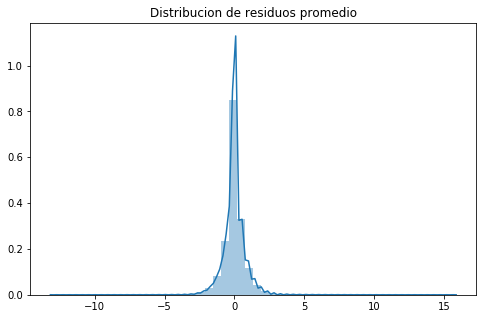

MSE      =  0.5225711160340664
RMSE (+-)=  0.6771094143182808
MAE  (+-)=  0.4770196161243925
--------- Smoothness ------------
AutoCorr lag-one =  0.5560048
Diff MEAN =  0.08030016
Diff STD =  0.44612834
--------- Smoothness ------------


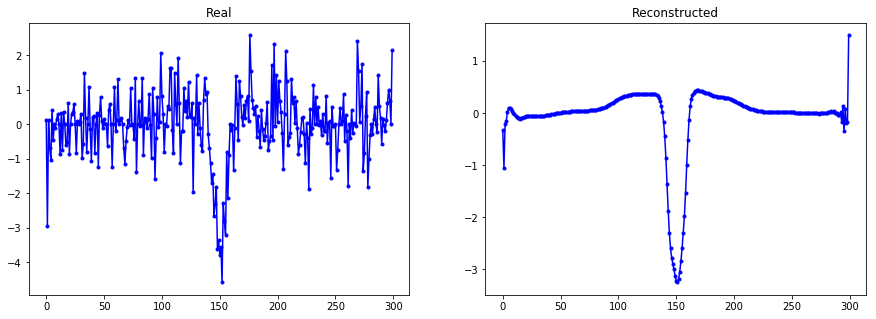

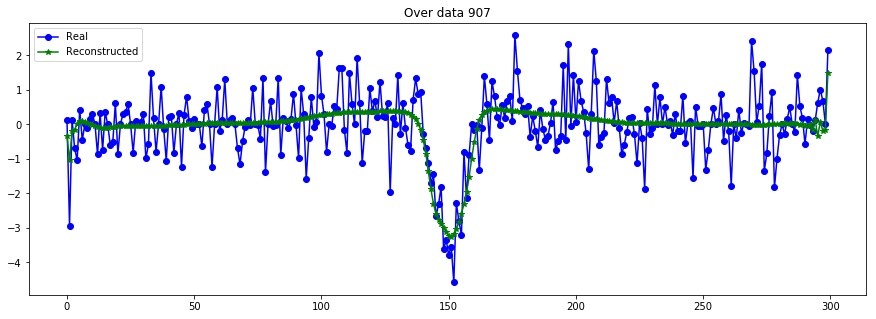

----------------------------------------------------------------


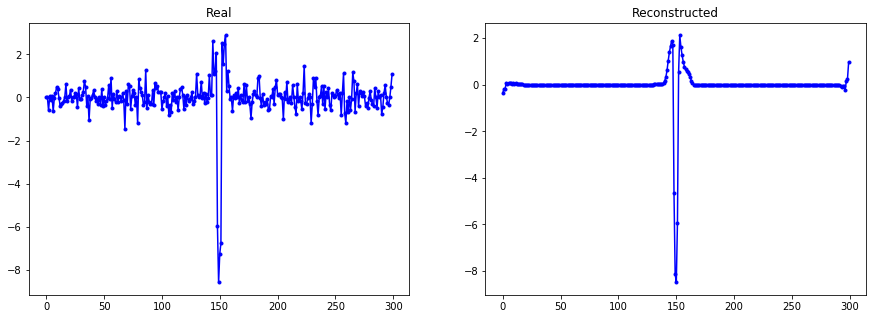

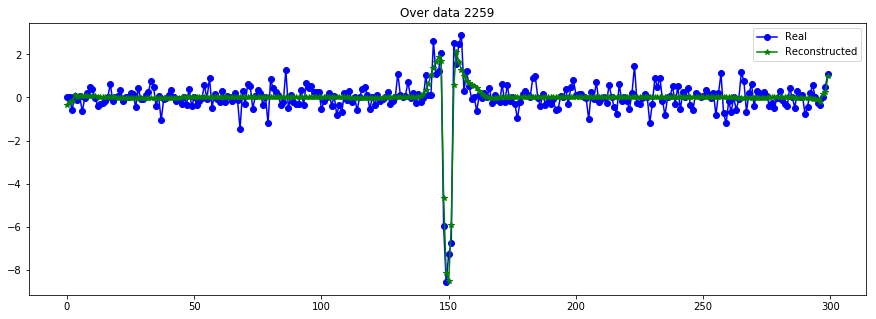

----------------------------------------------------------------


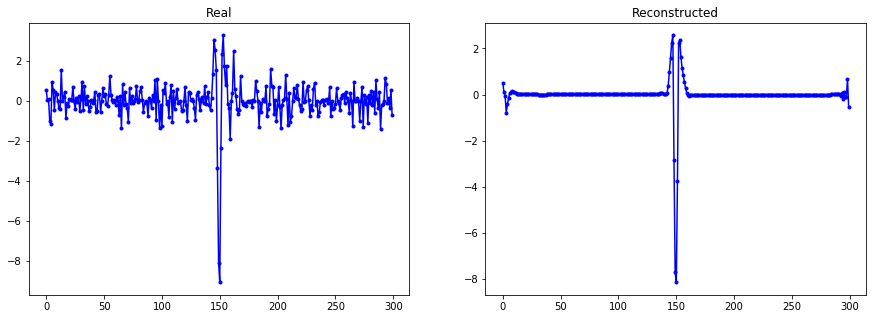

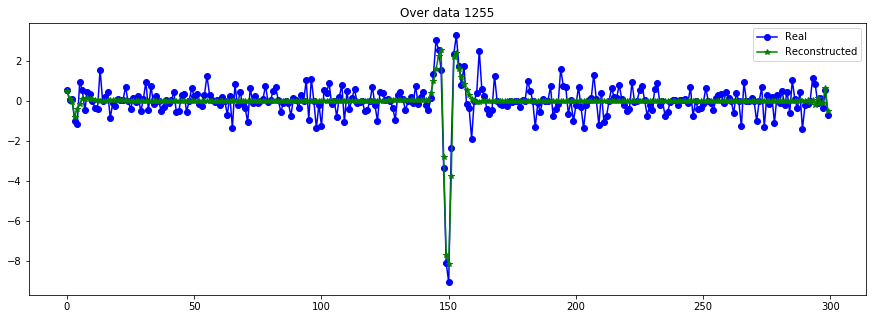

----------------------------------------------------------------


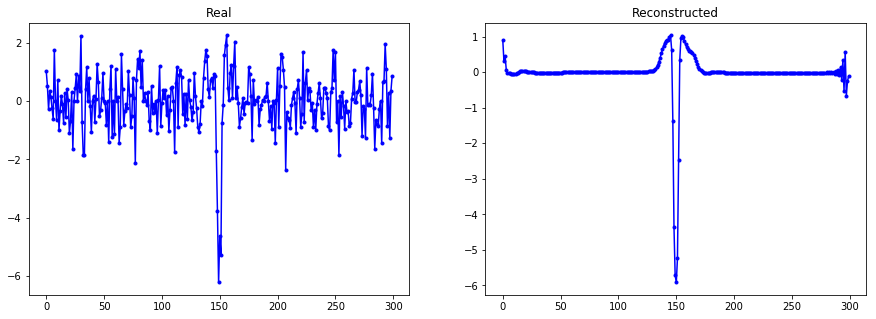

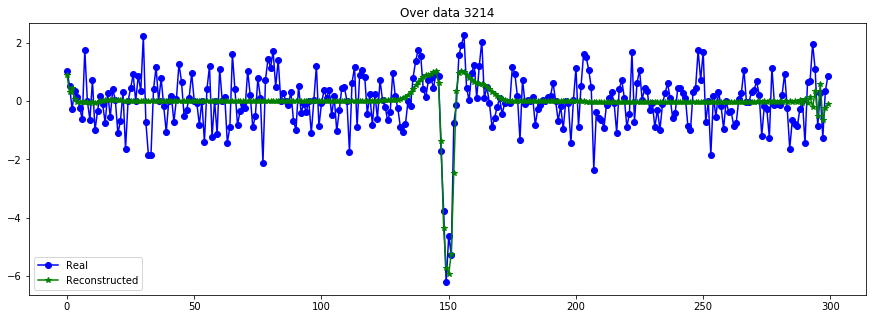

----------------------------------------------------------------


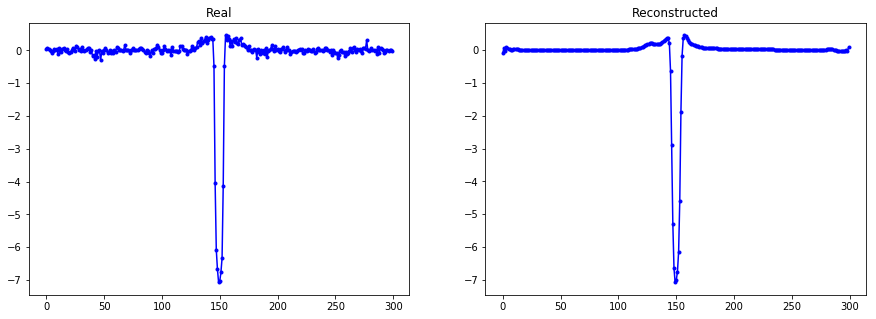

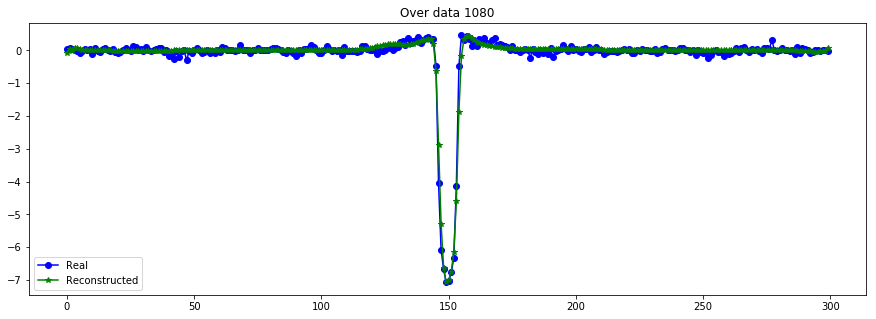

----------------------------------------------------------------


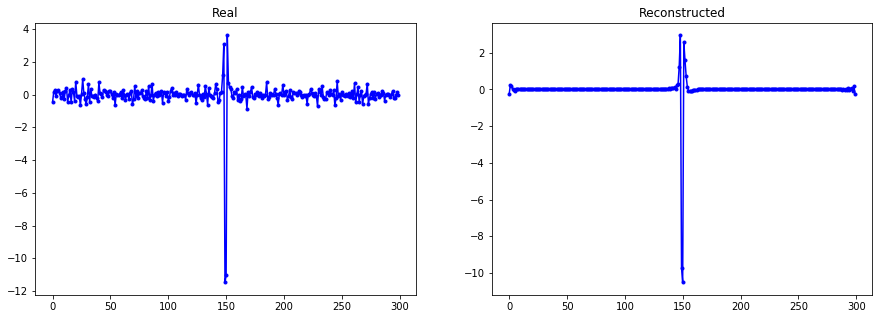

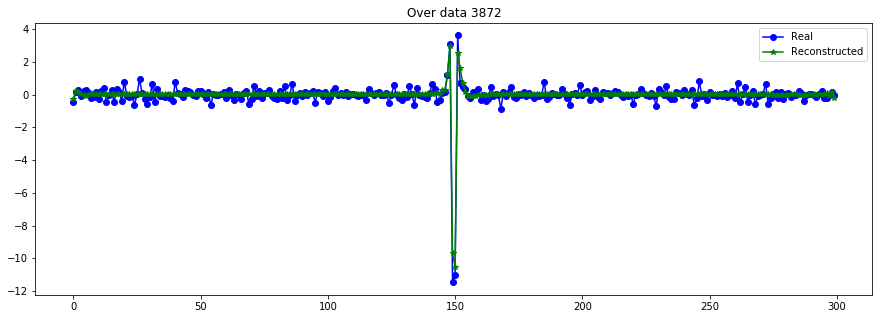

----------------------------------------------------------------


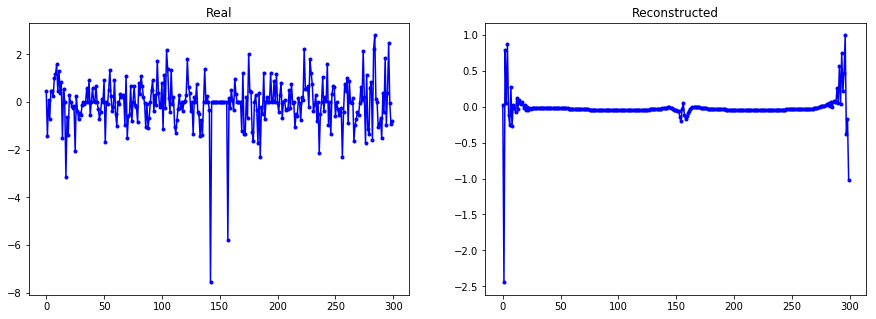

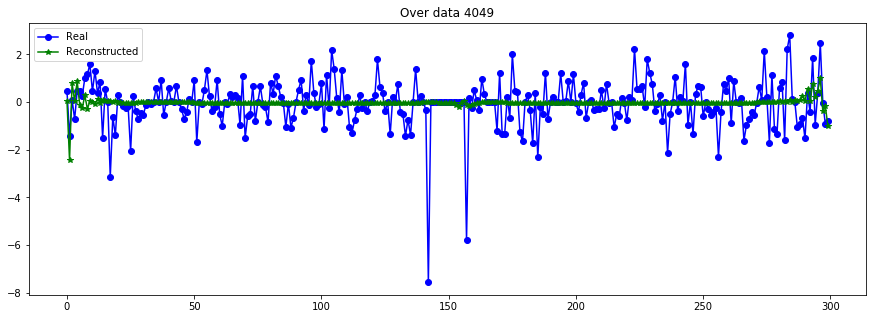

----------------------------------------------------------------


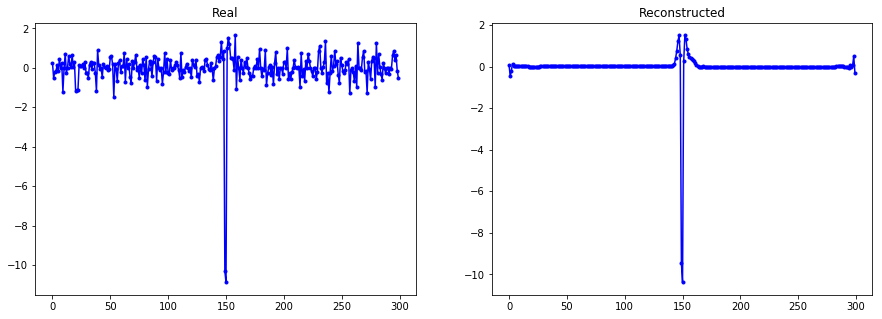

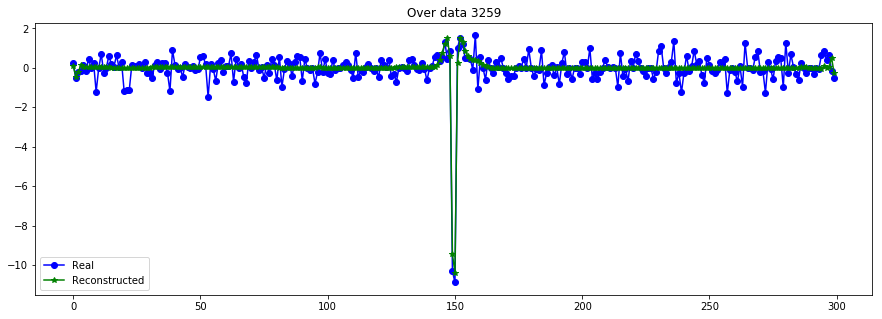

----------------------------------------------------------------


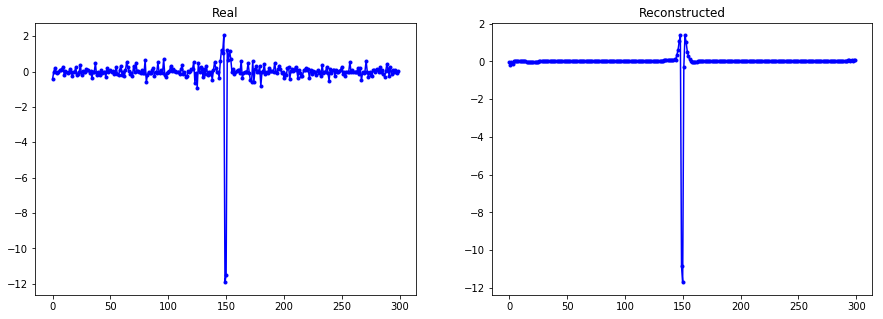

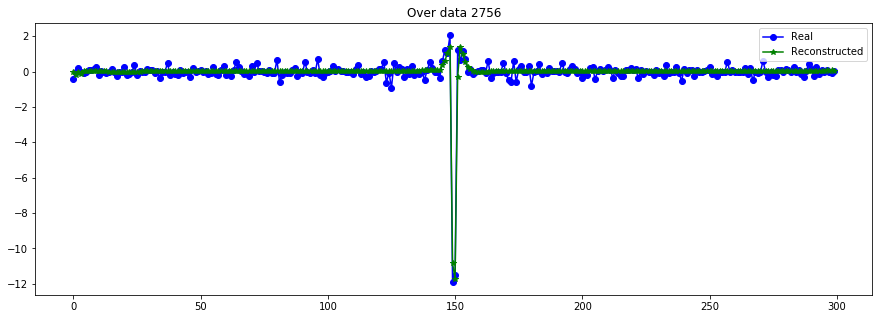

----------------------------------------------------------------


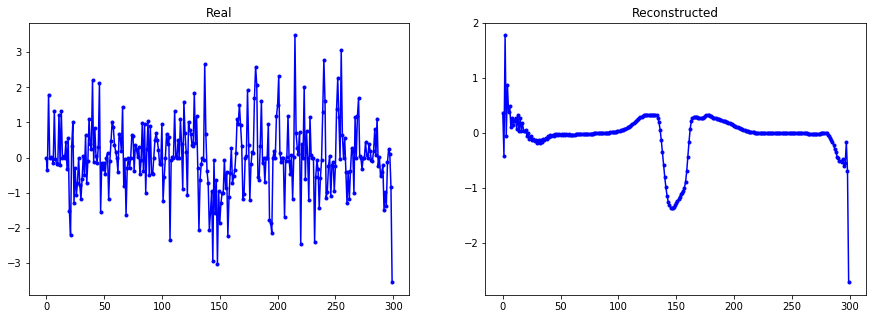

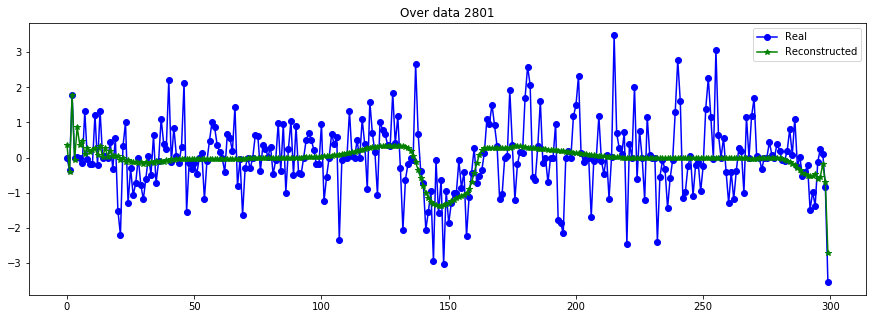

----------------------------------------------------------------


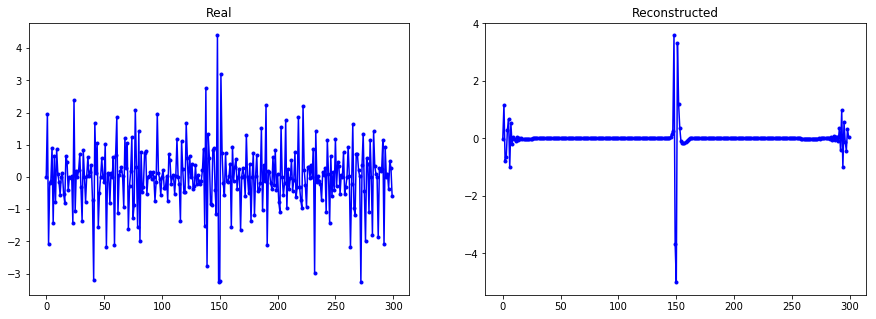

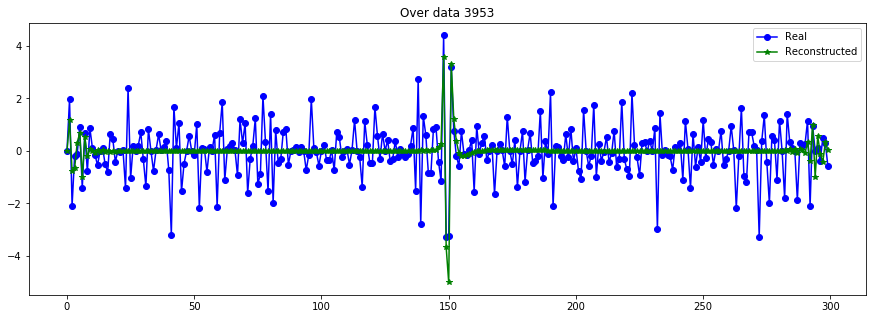

----------------------------------------------------------------


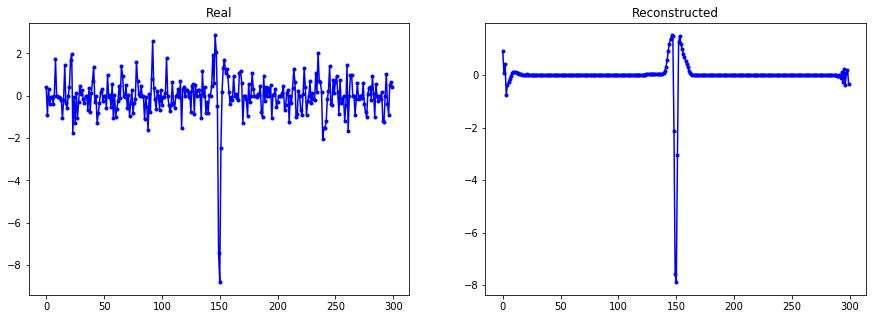

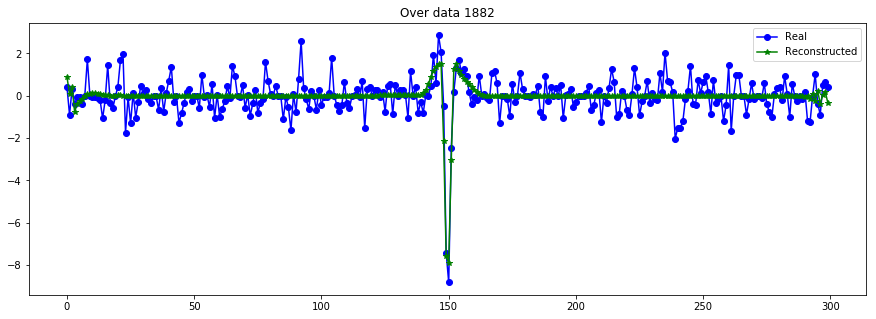

----------------------------------------------------------------


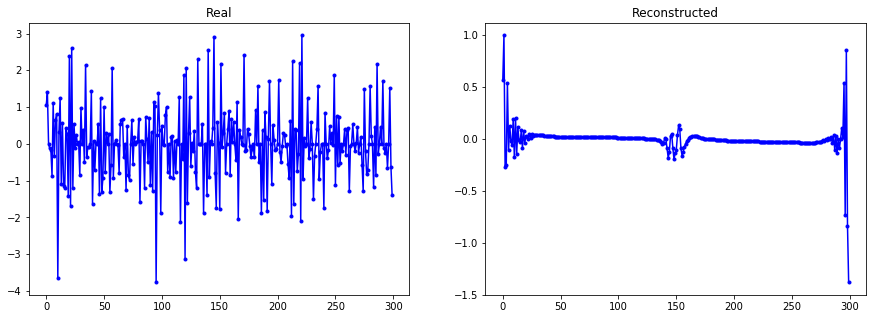

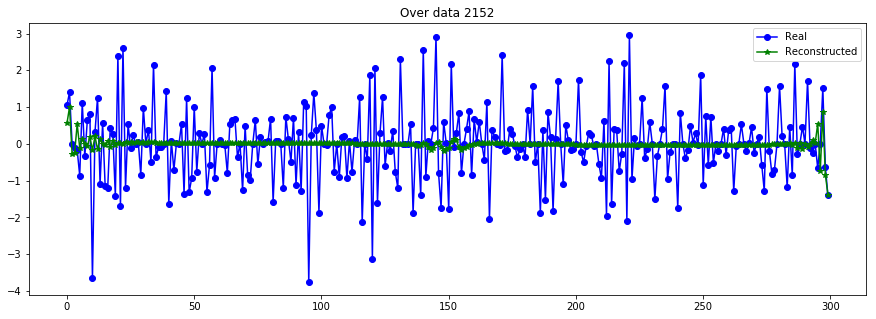

----------------------------------------------------------------


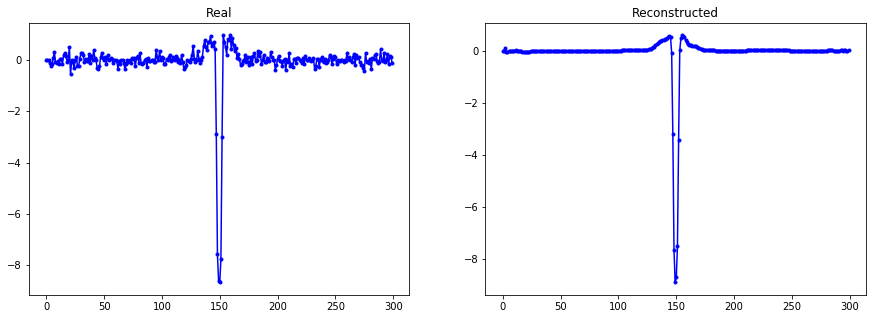

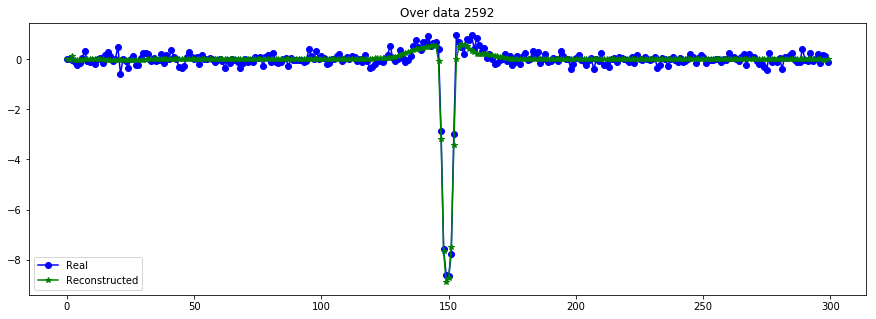

----------------------------------------------------------------


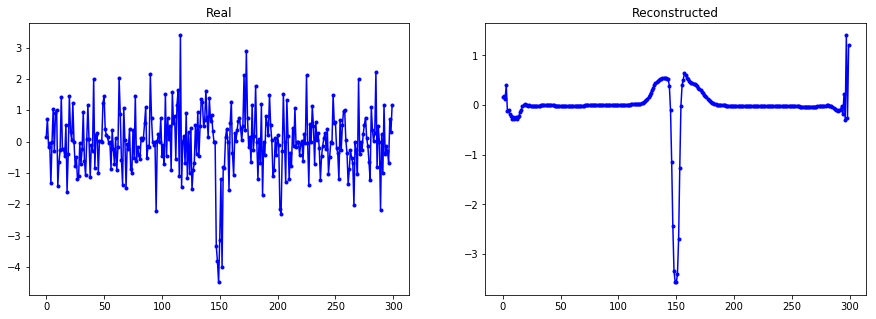

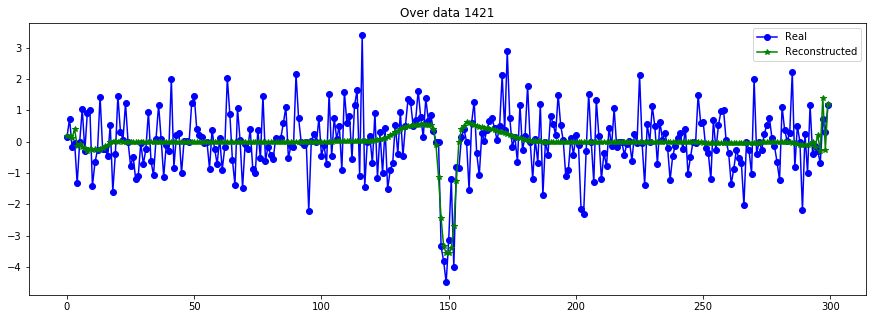

----------------------------------------------------------------


In [24]:
evaluate_reconst(X_train[:N], X_train_hat)

plot_n_lc(X_train[:N,:,0], X_train_hat, n= 15)

### Filtros

In [19]:
#https://plot.ly/python/v3/fft-filters/
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html
#https://scipy-cookbook.readthedocs.io/items/ButterworthBandpass.html
from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    #b, a = butter(order, high, btype='highpass')
    #b, a = butter(order, low, btype='lowpass')
    return b, a

def butter_bandpass_filter(data):
    b, a = butter_bandpass(lowcut, highcut, fs, order)
    y = lfilter(b, a, data)
    return y

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


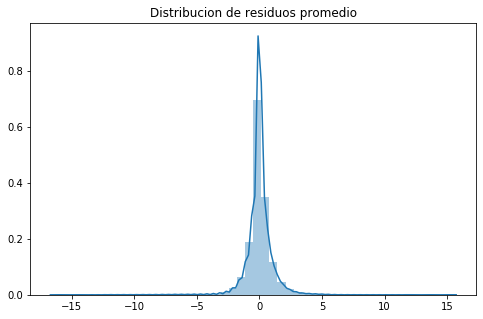

MSE      =  1.1771321860084596
RMSE (+-)=  1.0810371548093136
MAE  (+-)=  0.6259611584565287
--------- Smoothness ------------
AutoCorr lag-one =  0.9677034441088077
Diff MEAN =  0.04689125019223795
Diff STD =  0.07313381137312894
--------- Smoothness ------------


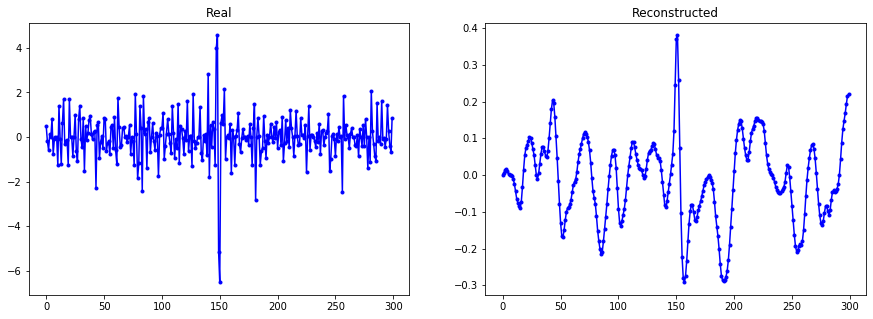

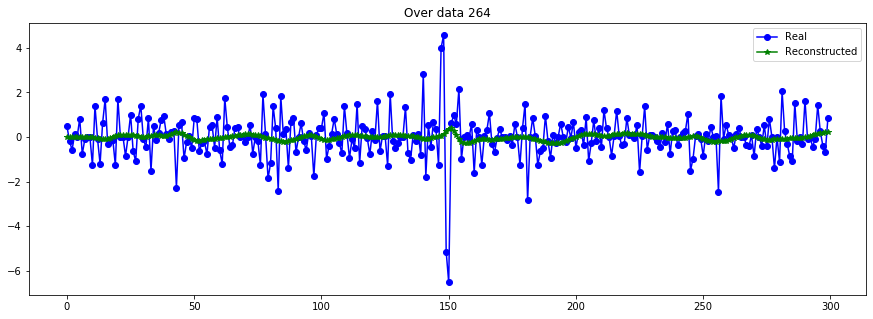

----------------------------------------------------------------


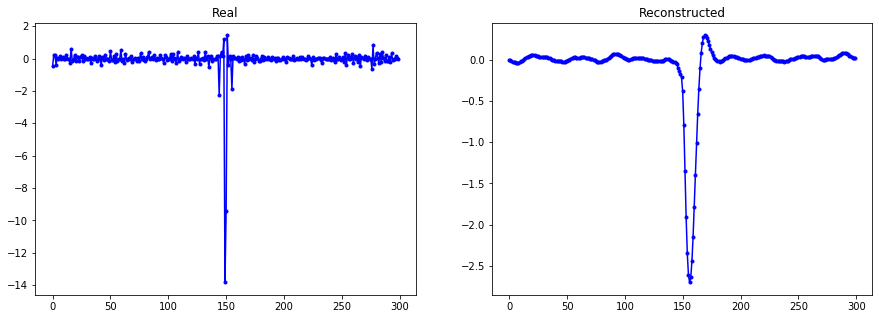

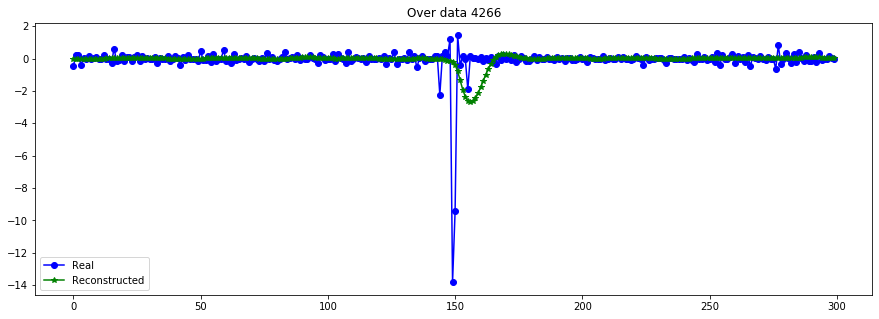

----------------------------------------------------------------


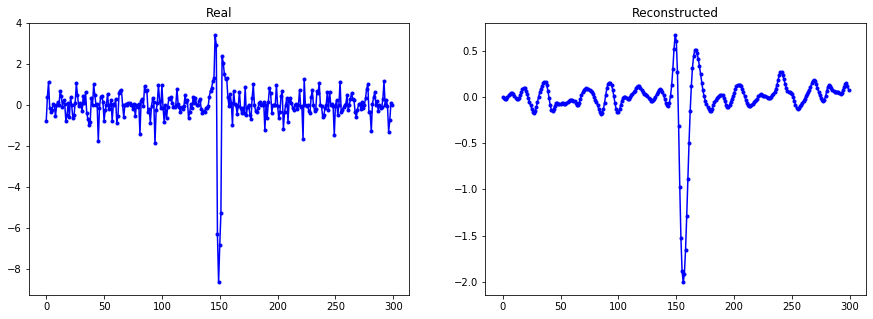

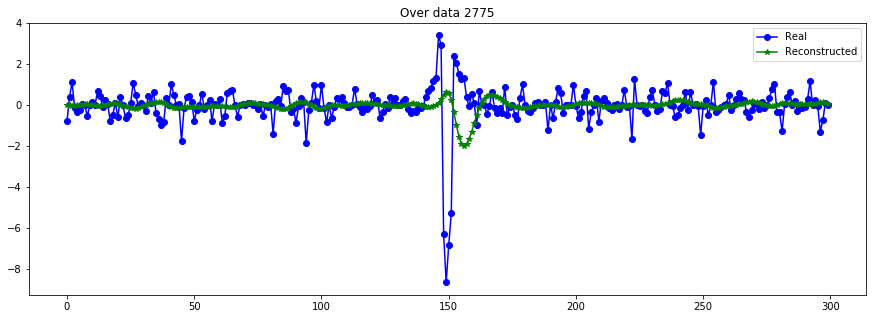

----------------------------------------------------------------


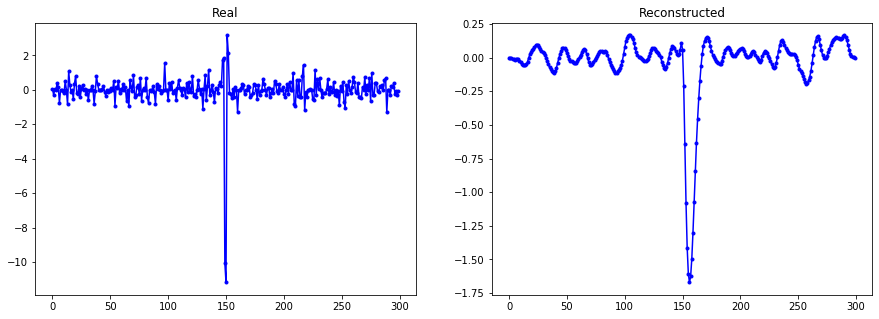

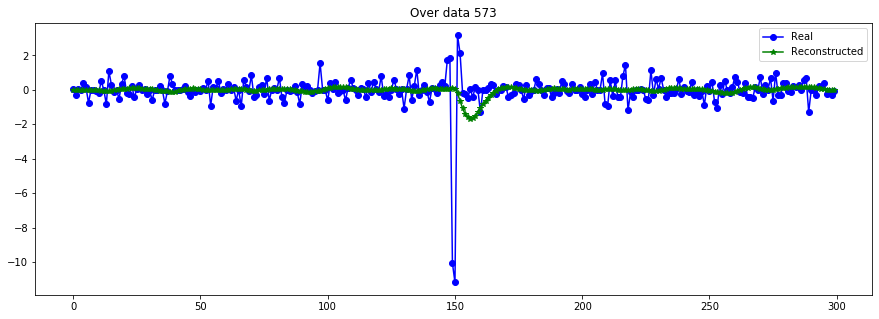

----------------------------------------------------------------


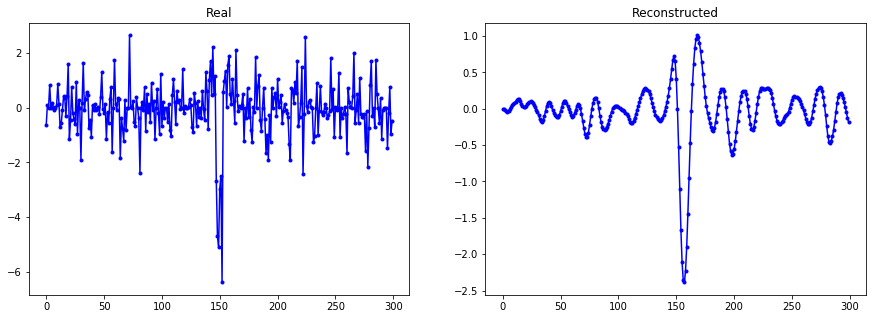

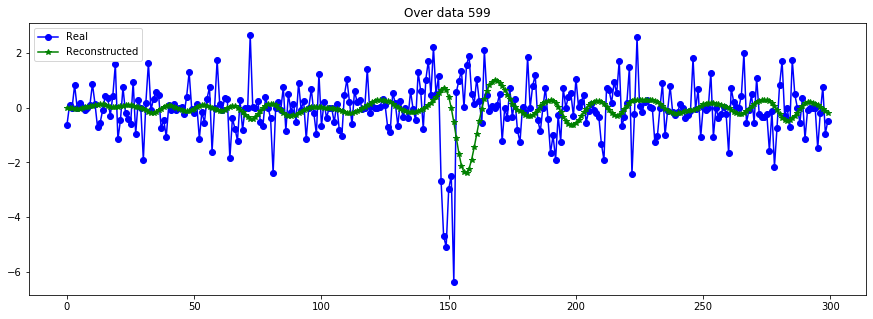

----------------------------------------------------------------


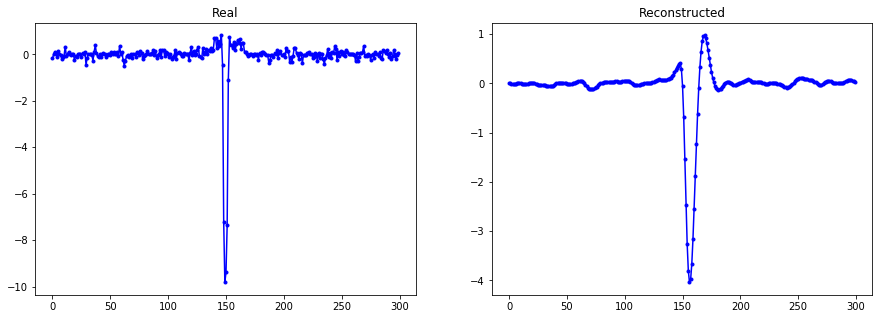

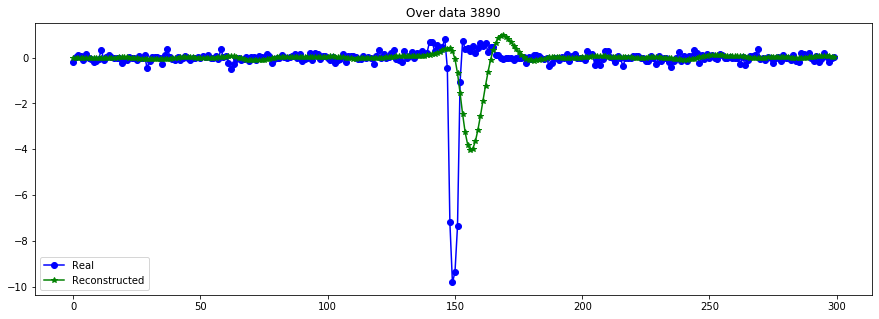

----------------------------------------------------------------


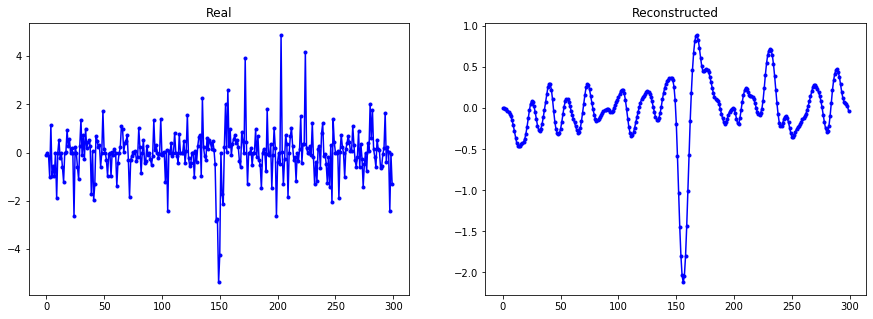

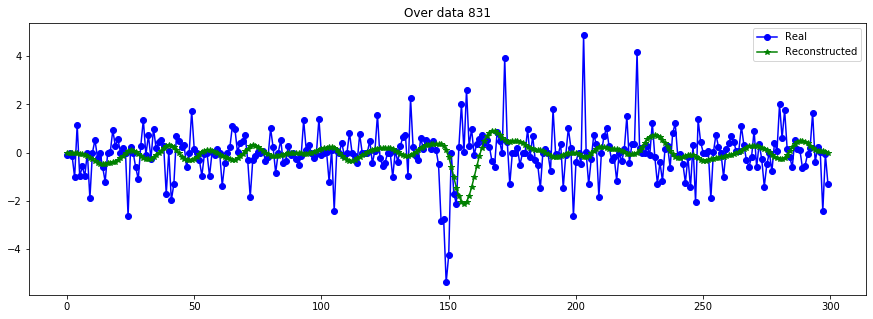

----------------------------------------------------------------


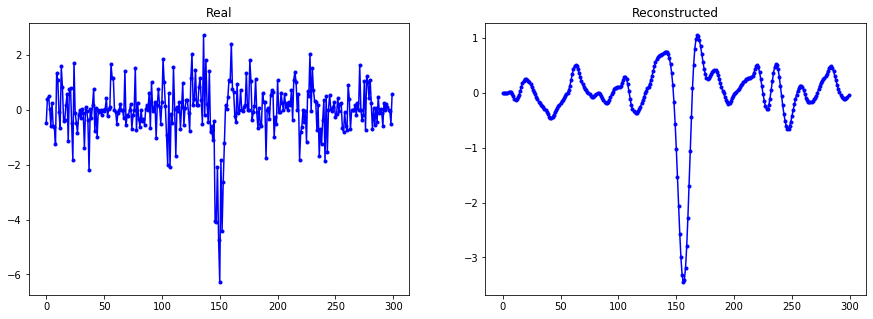

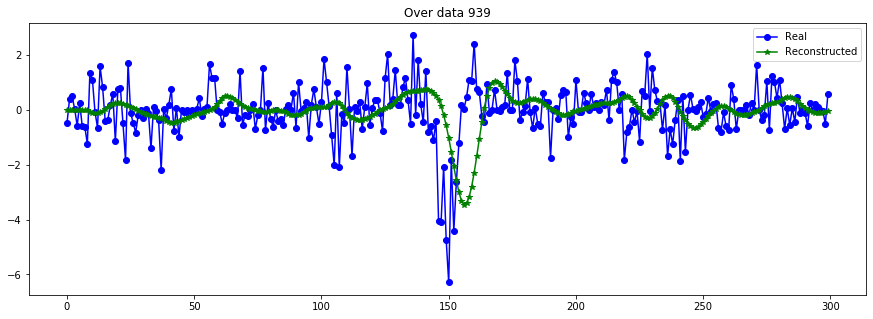

----------------------------------------------------------------


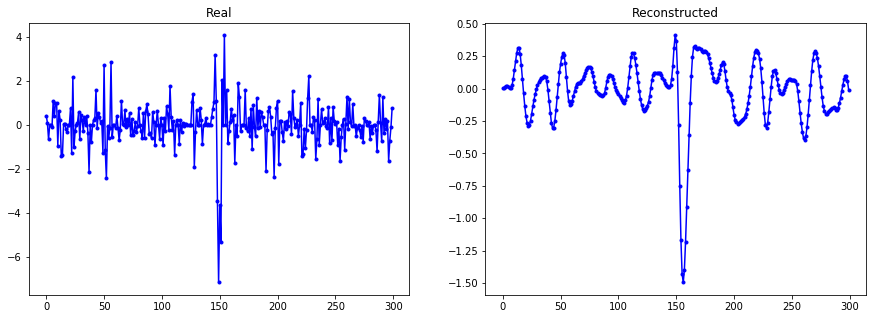

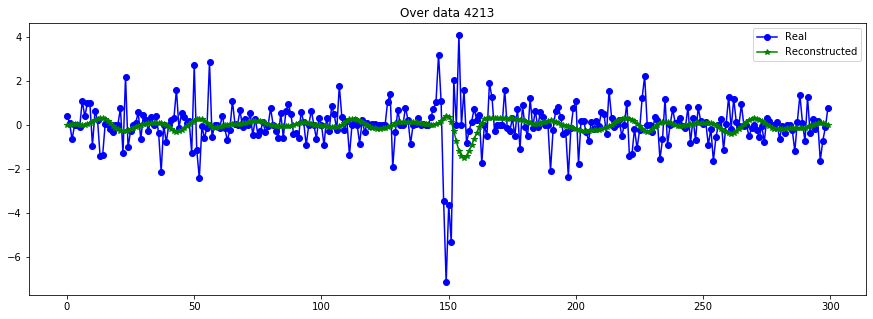

----------------------------------------------------------------


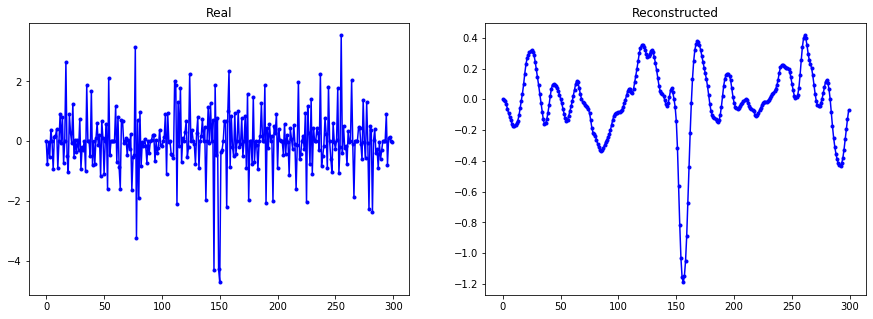

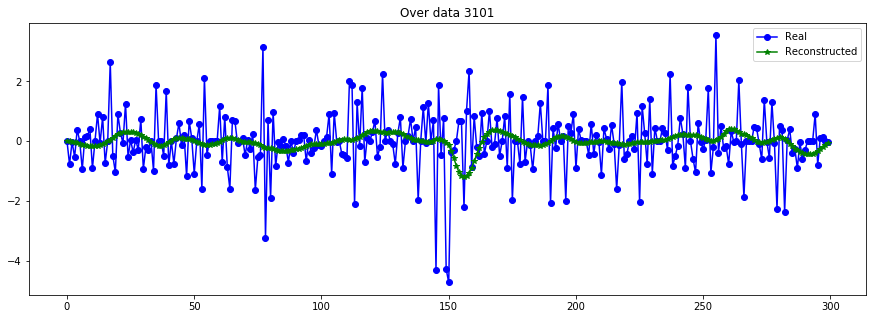

----------------------------------------------------------------


In [20]:
lowcut  = 1 #300. #2000. #con order 3
highcut = 500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0])

evaluate_reconst(X_train[:N], X_train_filter)

plot_n_lc(X_train[:N,:,0], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


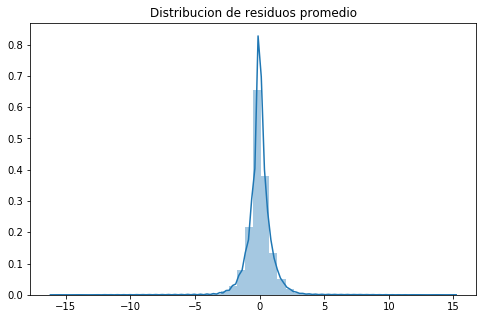

MSE      =  1.1067741203141208
RMSE (+-)=  1.0358927443745882
MAE  (+-)=  0.633528209143264
--------- Smoothness ------------
AutoCorr lag-one =  0.8309864693822597
Diff MEAN =  0.19692797350597255
Diff STD =  0.27351855143666703
--------- Smoothness ------------


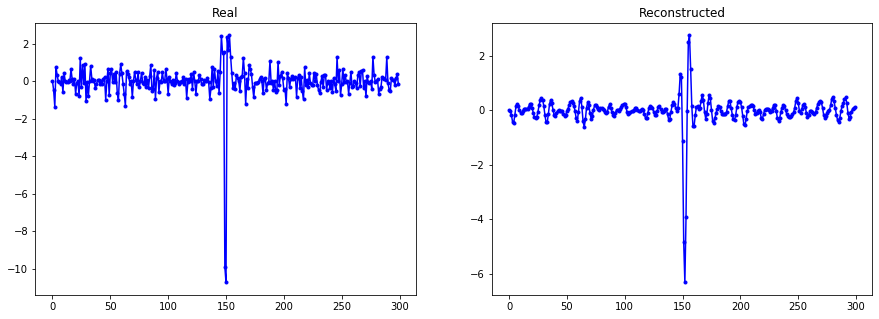

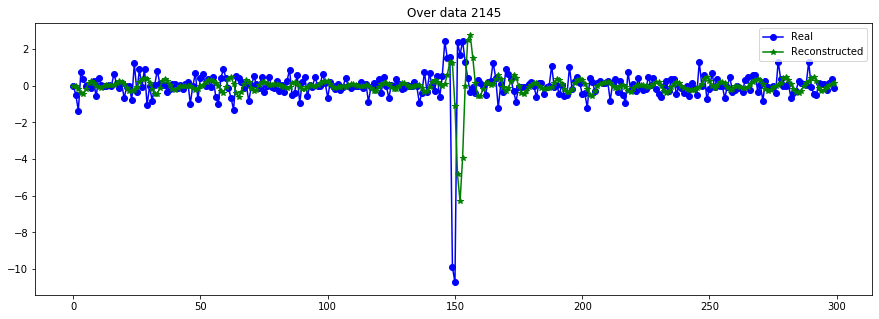

----------------------------------------------------------------


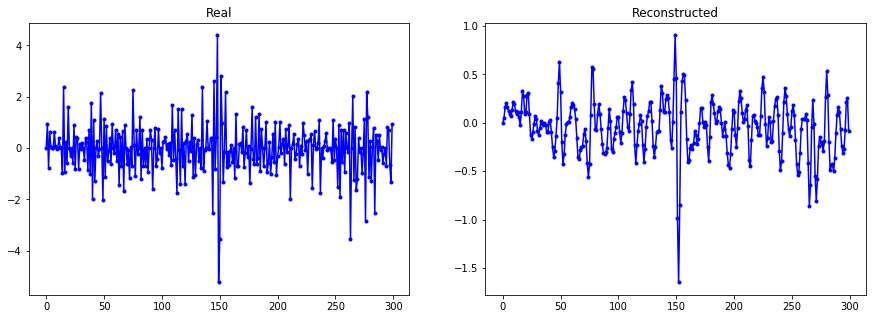

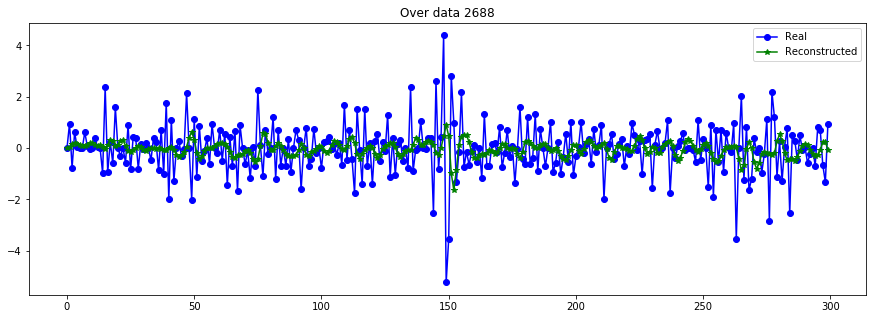

----------------------------------------------------------------


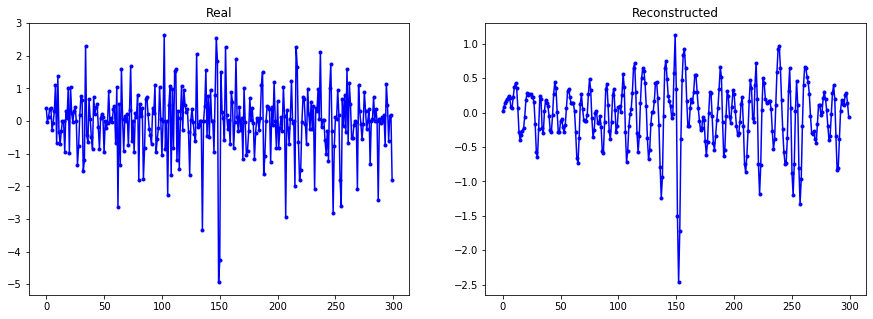

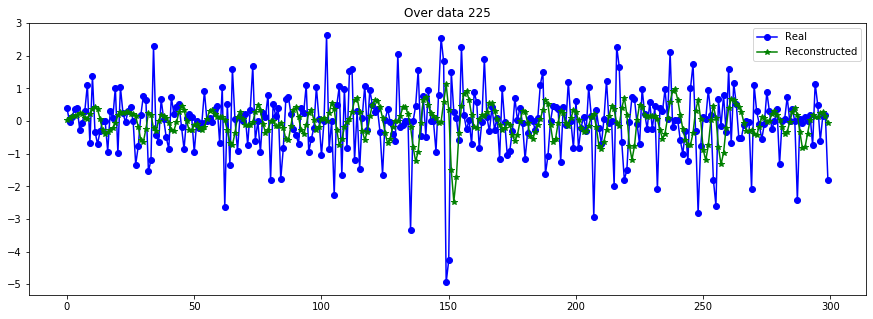

----------------------------------------------------------------


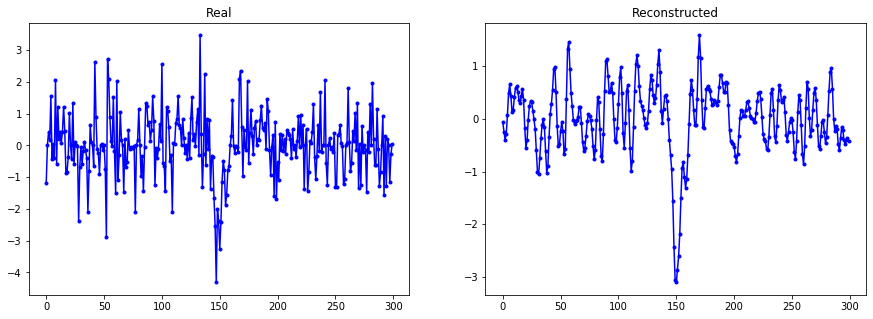

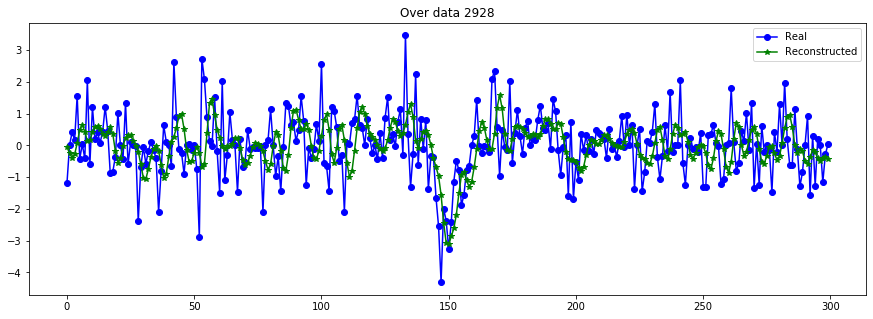

----------------------------------------------------------------


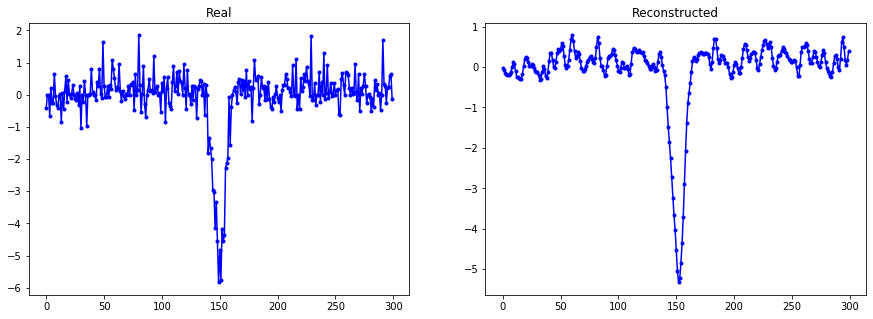

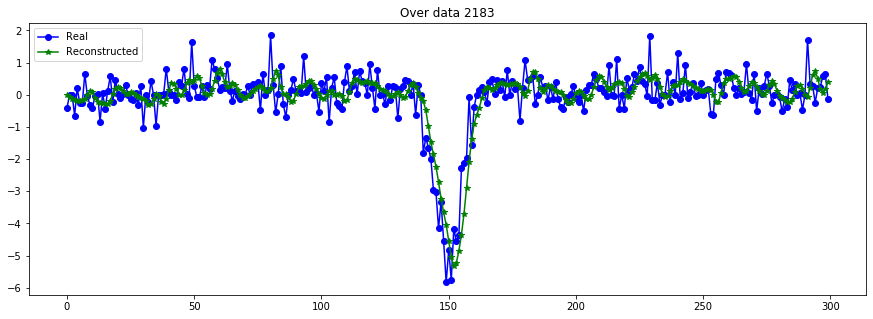

----------------------------------------------------------------


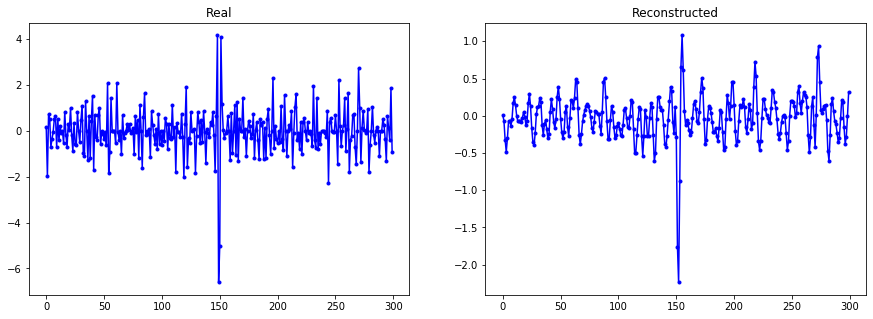

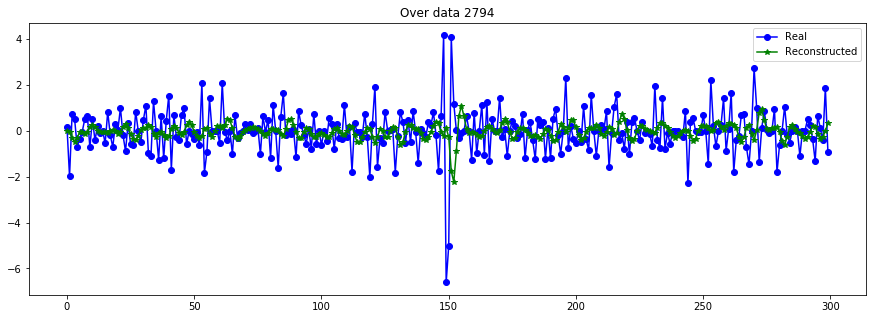

----------------------------------------------------------------


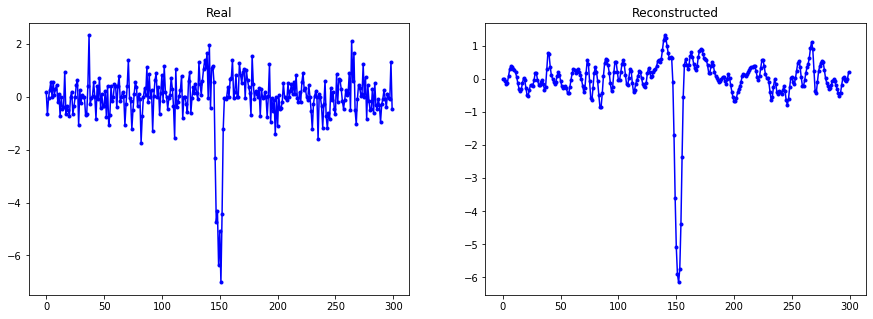

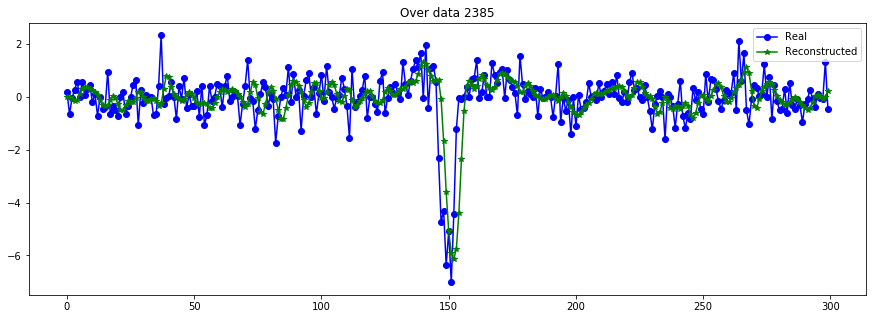

----------------------------------------------------------------


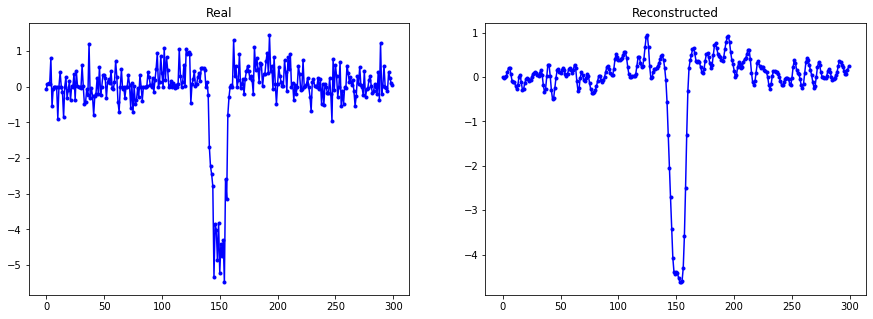

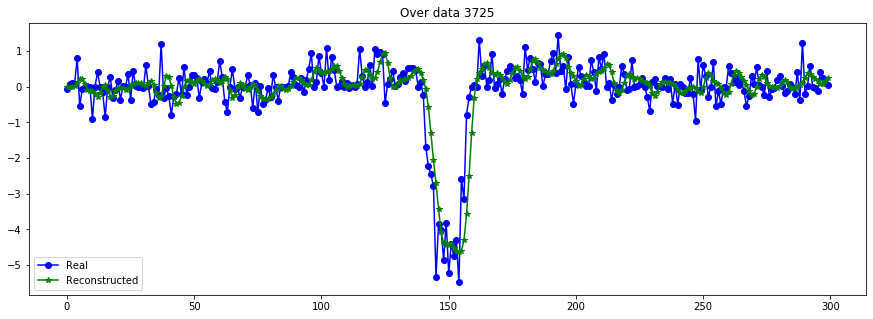

----------------------------------------------------------------


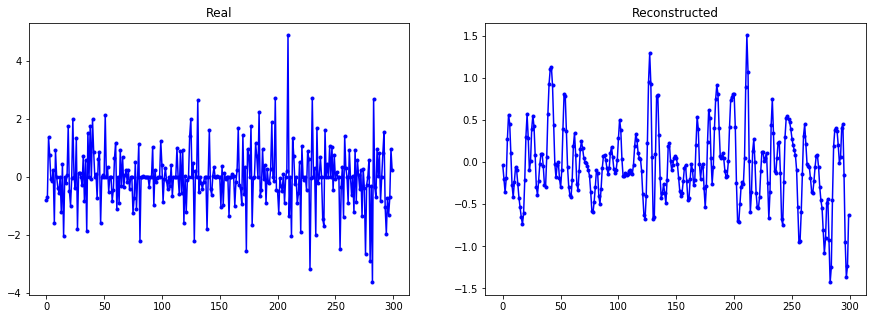

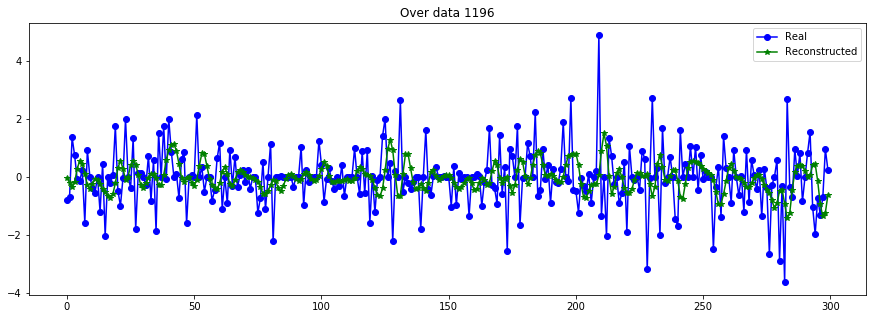

----------------------------------------------------------------


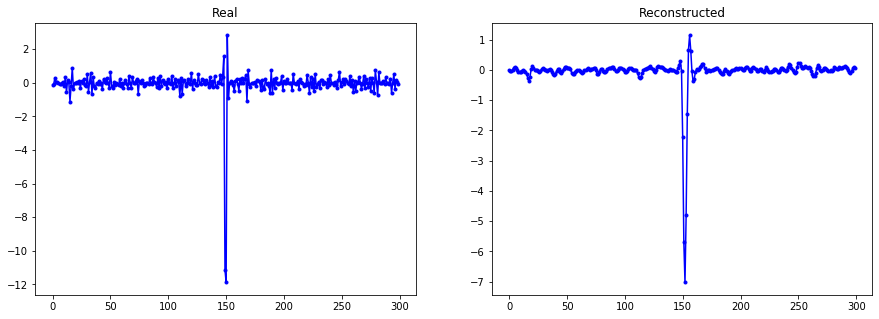

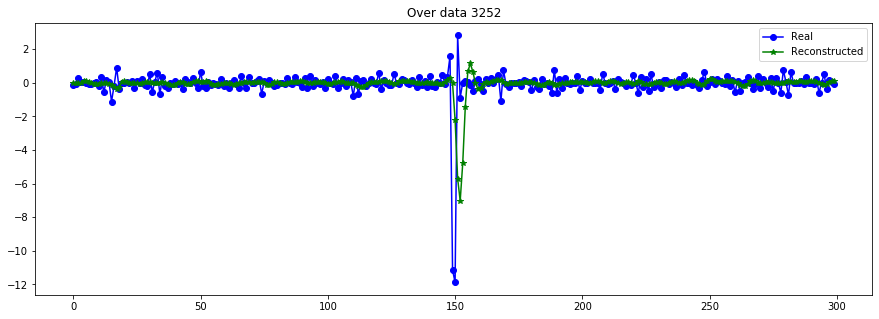

----------------------------------------------------------------


In [21]:
lowcut = 1. 
highcut= 1500.
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0])

evaluate_reconst(X_train[:N], X_train_filter)

plot_n_lc(X_train[:N,:,0], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


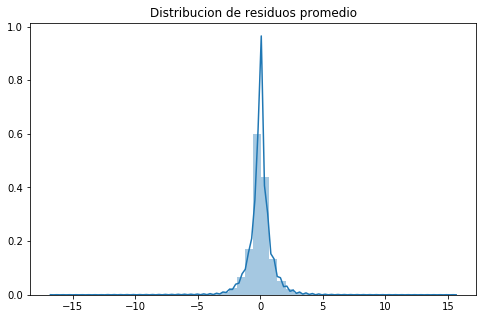

MSE      =  1.1466254200723789
RMSE (+-)=  1.068486953123902
MAE  (+-)=  0.6368145013362504
--------- Smoothness ------------
AutoCorr lag-one =  0.9693243179782709
Diff MEAN =  0.04613753569154356
Diff STD =  0.06999825958153903
--------- Smoothness ------------


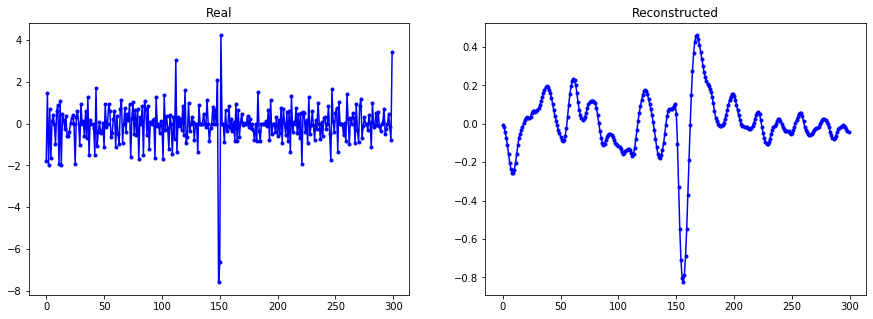

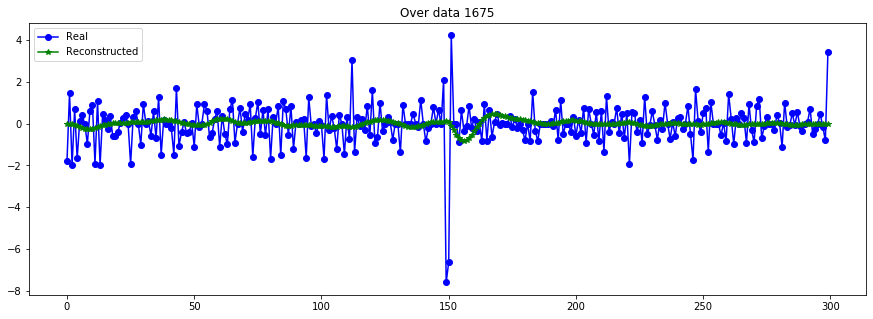

----------------------------------------------------------------


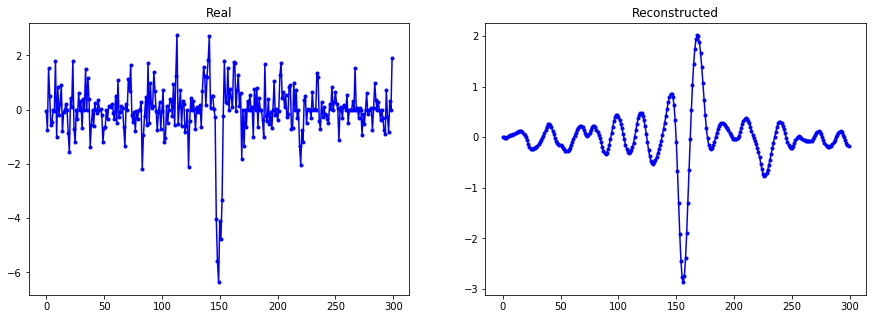

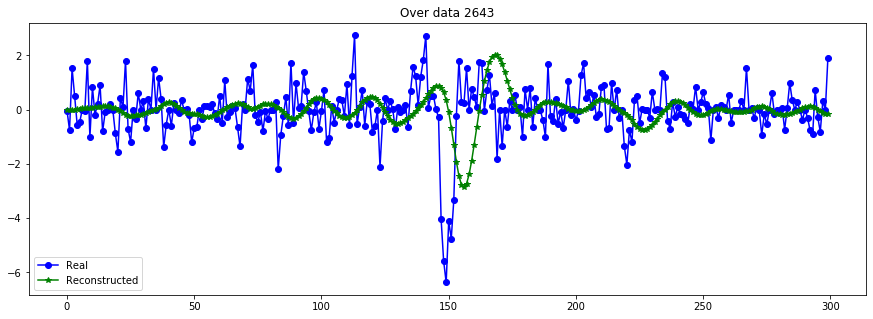

----------------------------------------------------------------


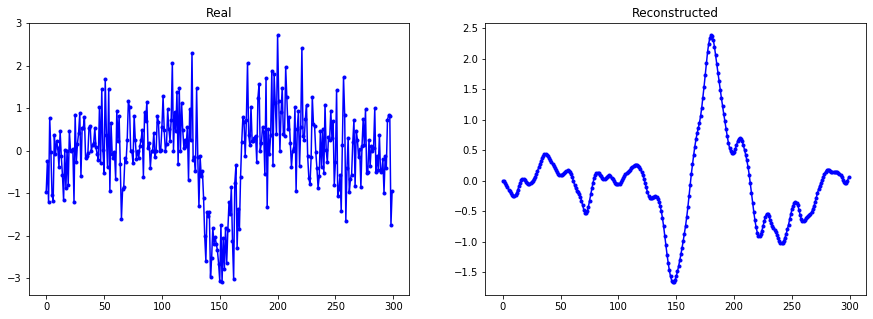

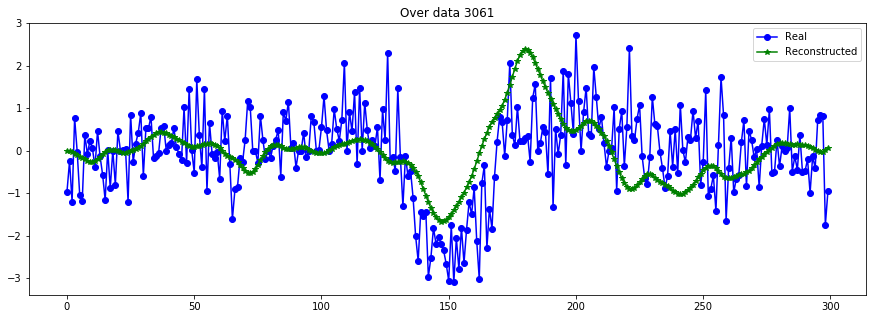

----------------------------------------------------------------


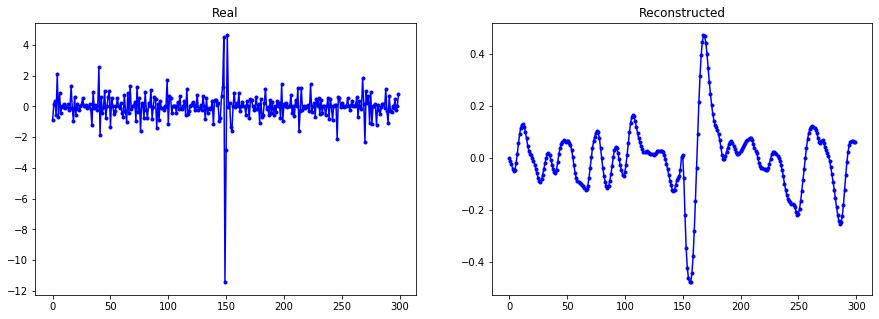

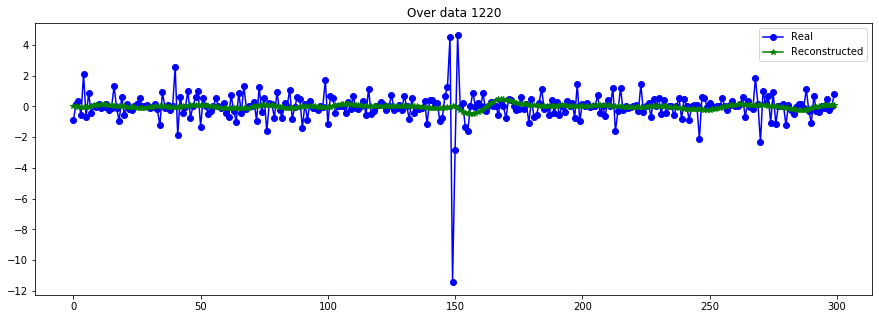

----------------------------------------------------------------


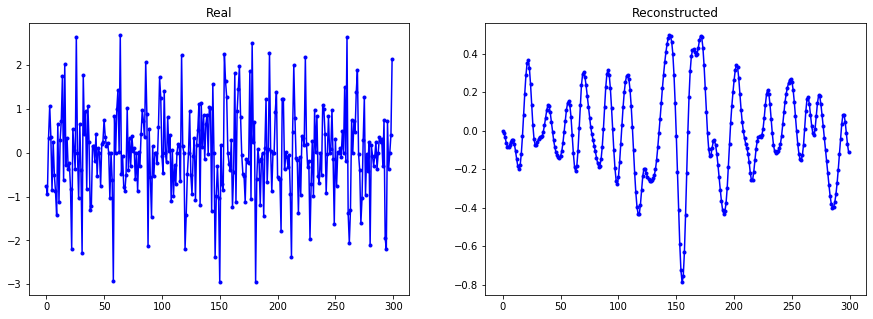

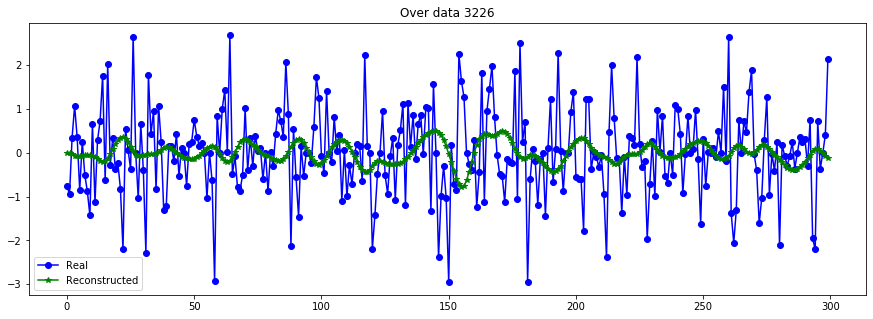

----------------------------------------------------------------


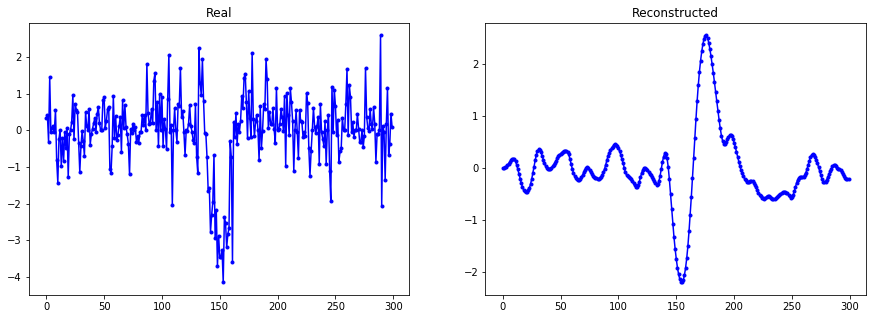

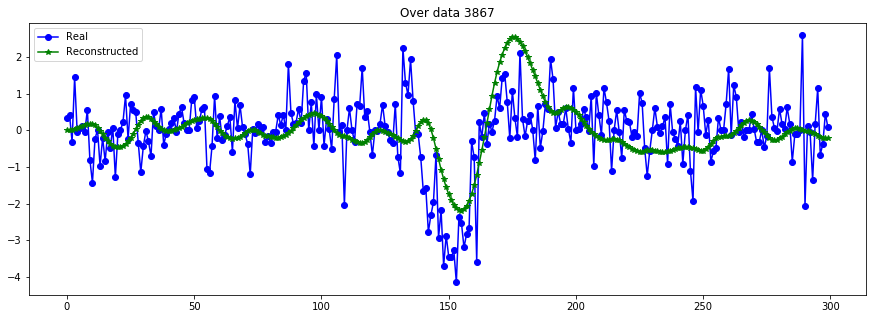

----------------------------------------------------------------


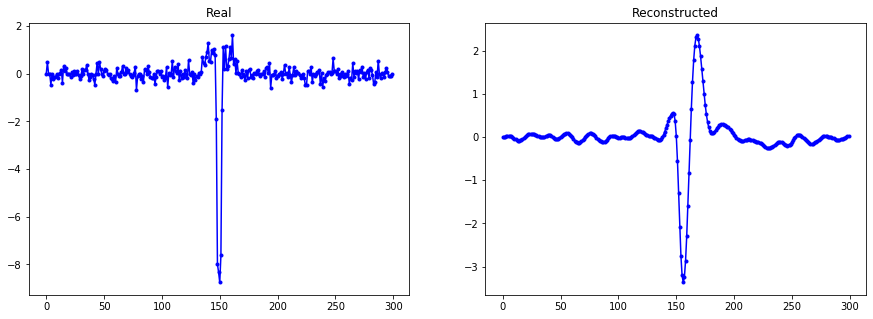

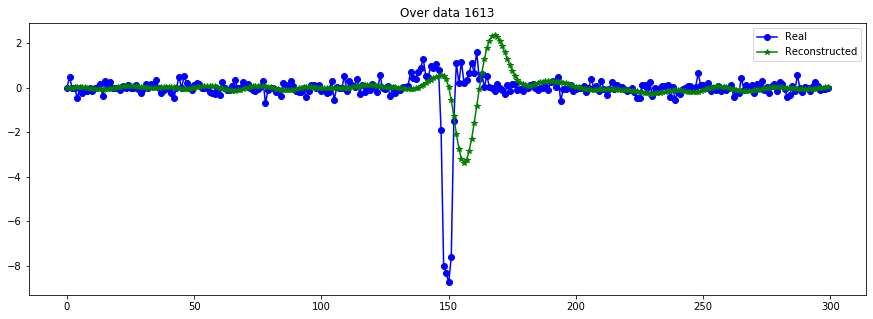

----------------------------------------------------------------


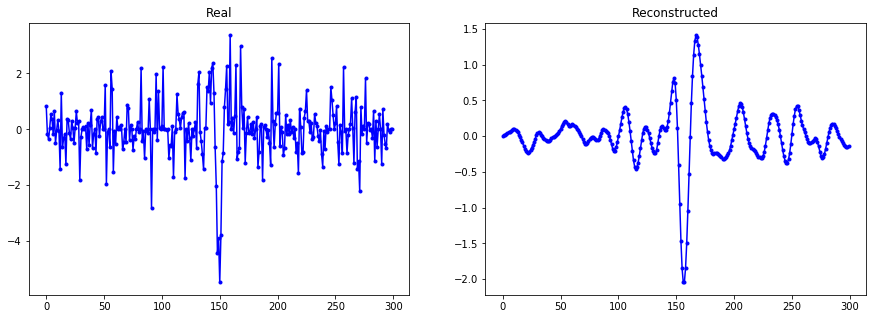

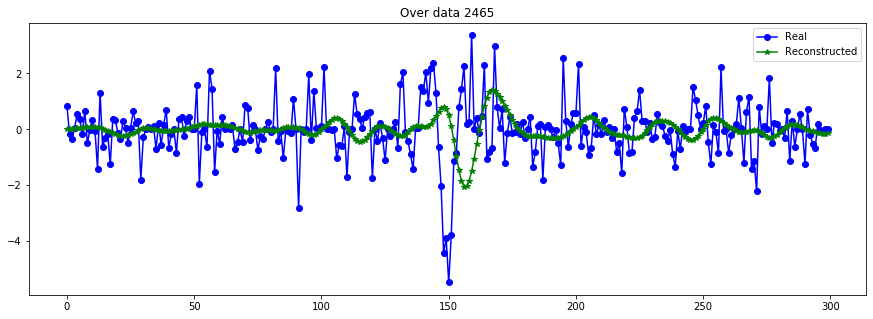

----------------------------------------------------------------


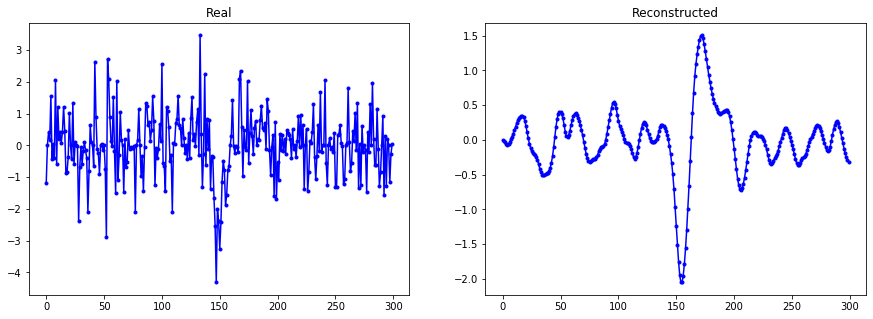

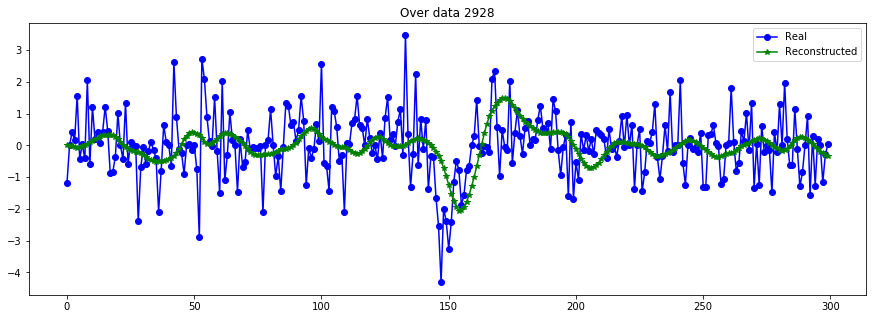

----------------------------------------------------------------


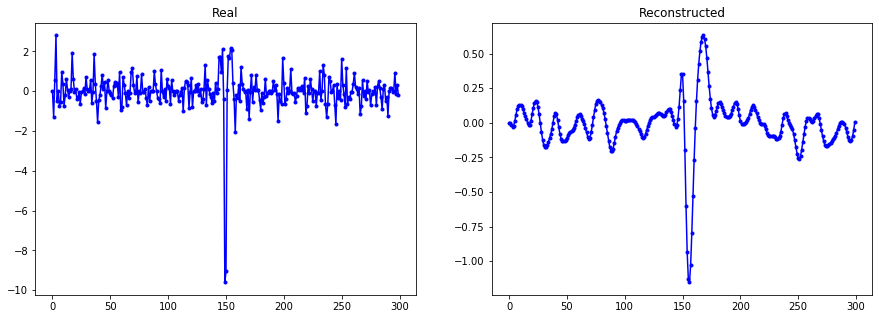

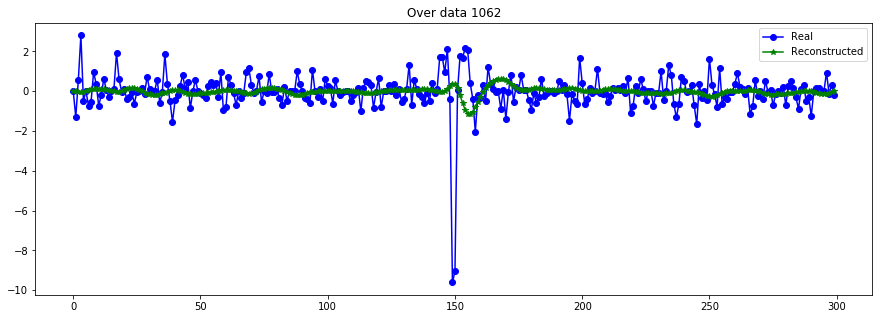

----------------------------------------------------------------


In [22]:
lowcut  = 50 #300. #2000. #con order 3
highcut = 500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0])

evaluate_reconst(X_train[:N], X_train_filter)

plot_n_lc(X_train[:N,:,0], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


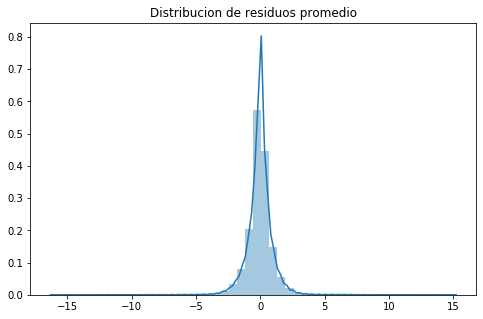

MSE      =  1.1071625431674987
RMSE (+-)=  1.0411482330354898
MAE  (+-)=  0.6547341818479366
--------- Smoothness ------------
AutoCorr lag-one =  0.8308406281062473
Diff MEAN =  0.19652549378649792
Diff STD =  0.2724746570384025
--------- Smoothness ------------


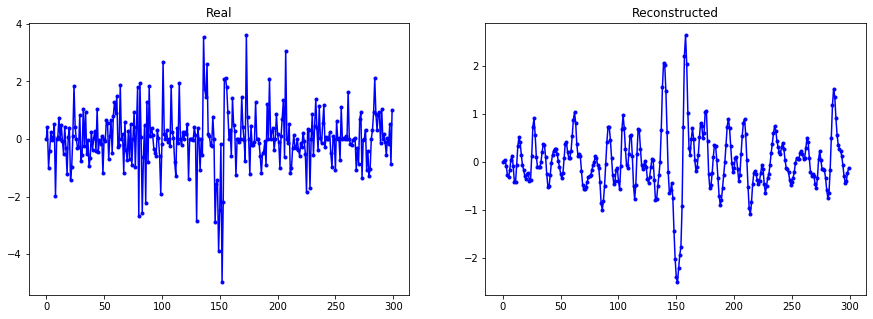

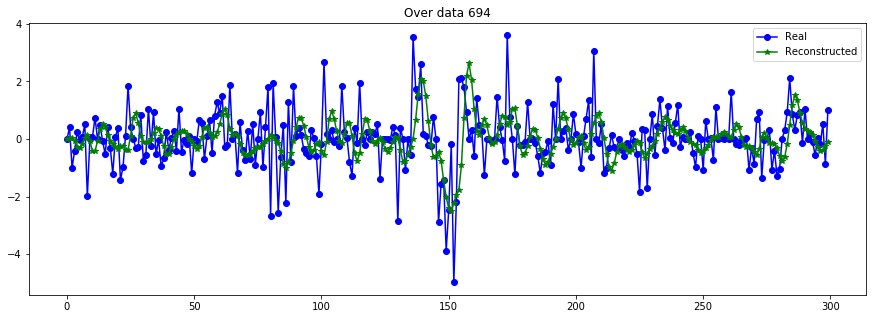

----------------------------------------------------------------


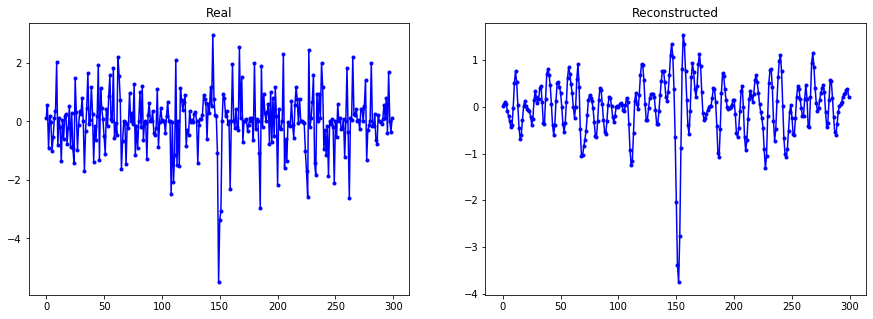

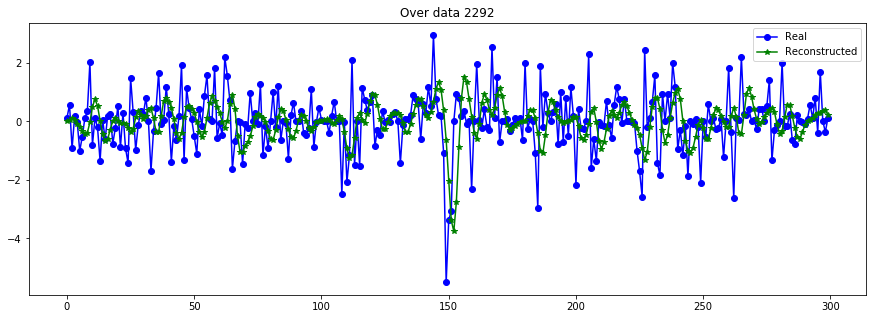

----------------------------------------------------------------


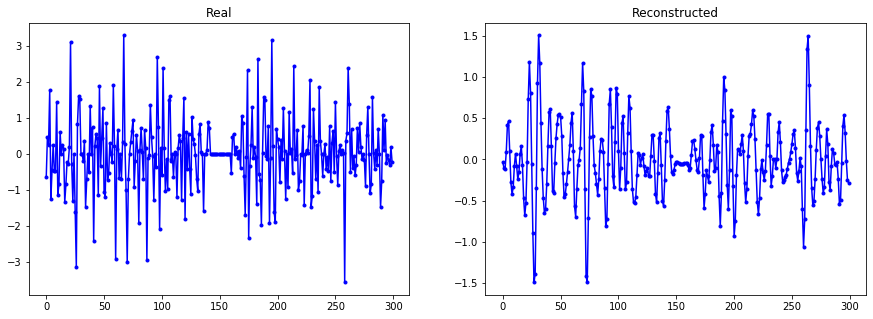

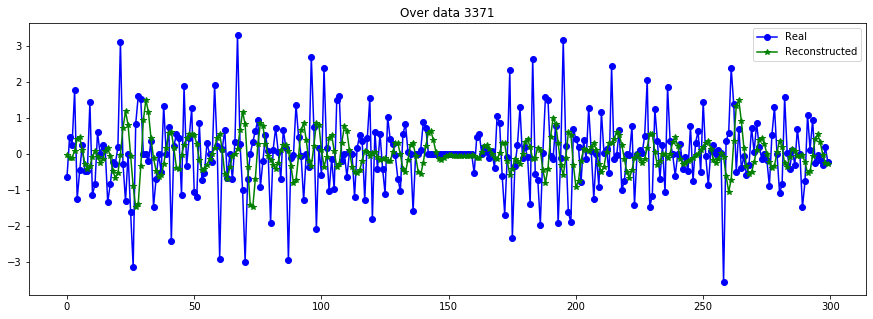

----------------------------------------------------------------


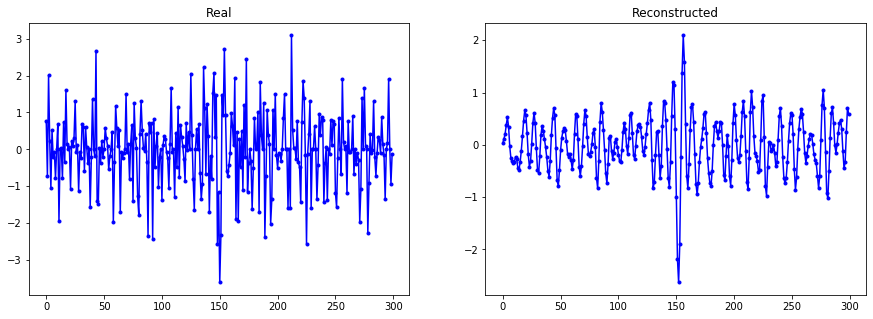

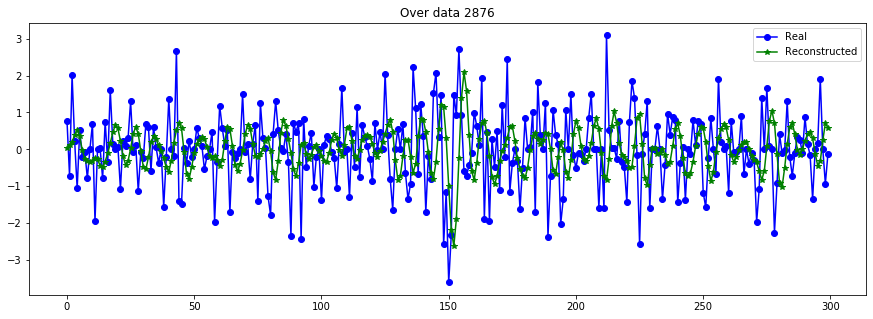

----------------------------------------------------------------


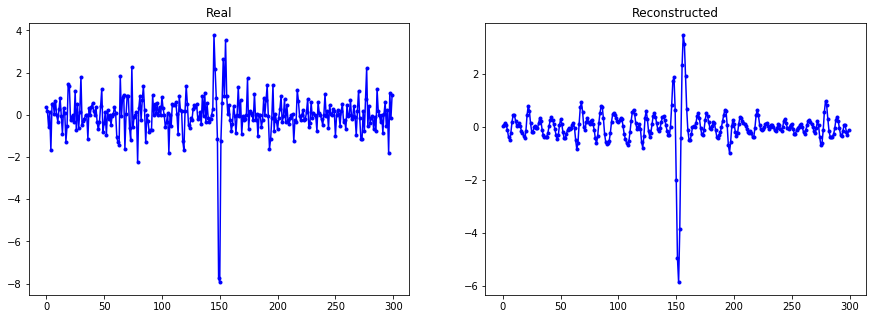

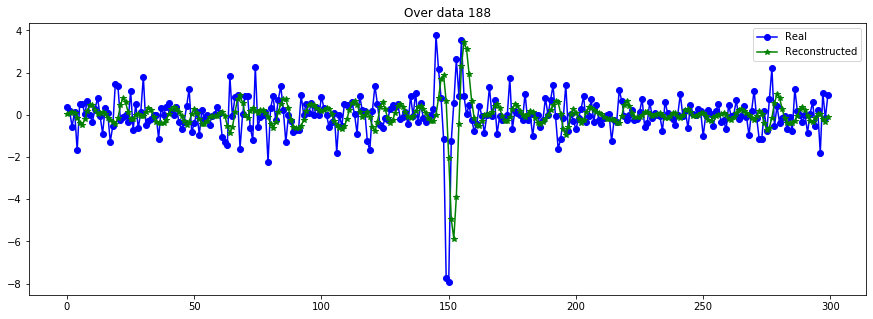

----------------------------------------------------------------


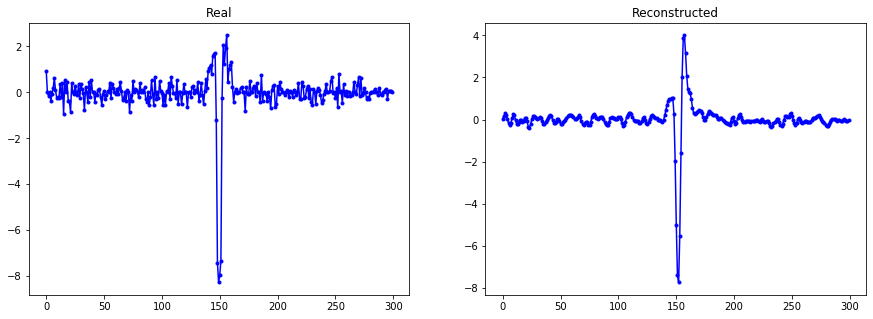

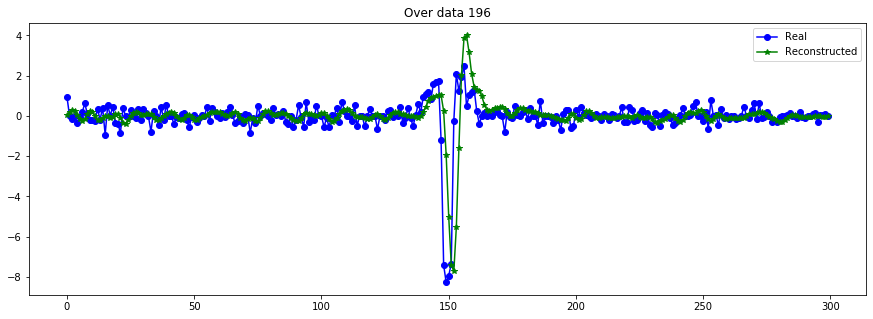

----------------------------------------------------------------


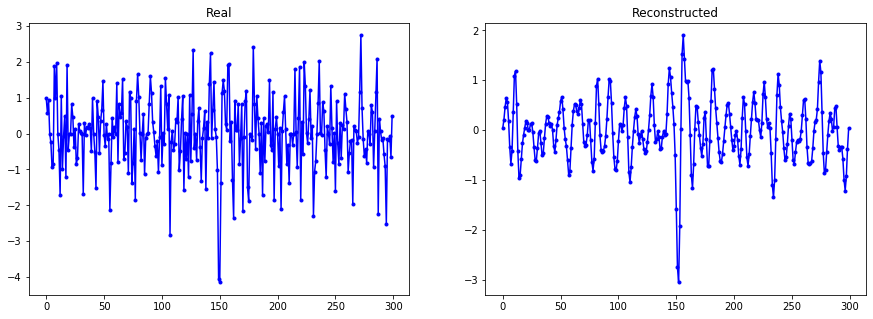

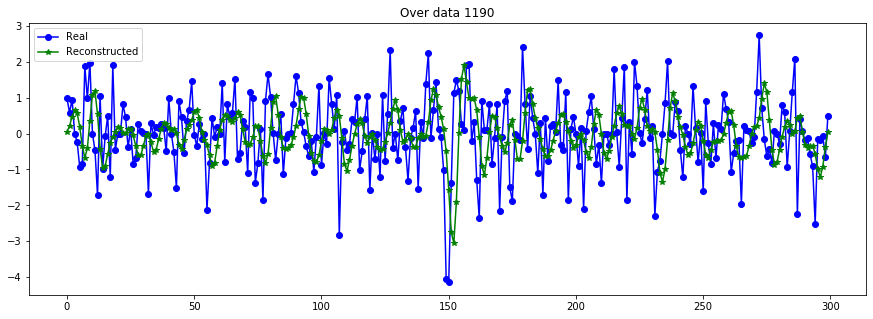

----------------------------------------------------------------


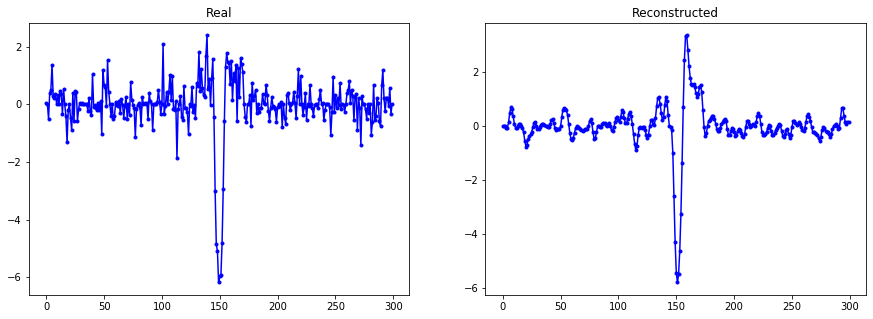

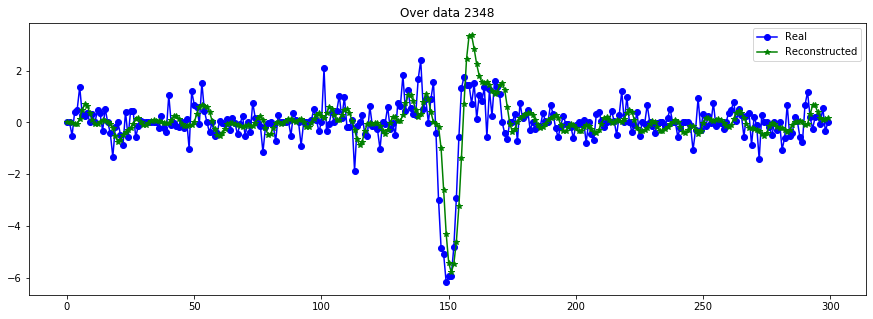

----------------------------------------------------------------


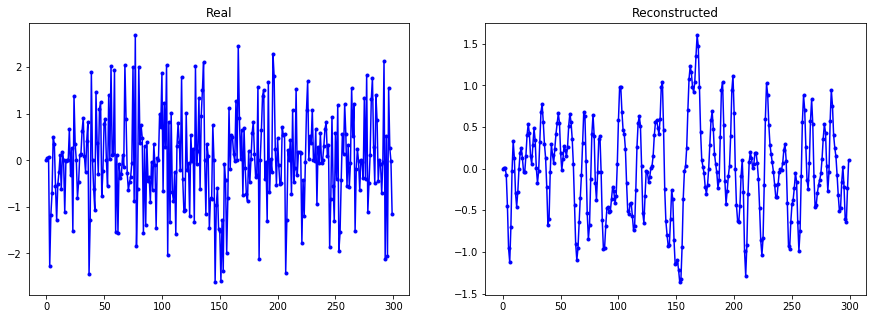

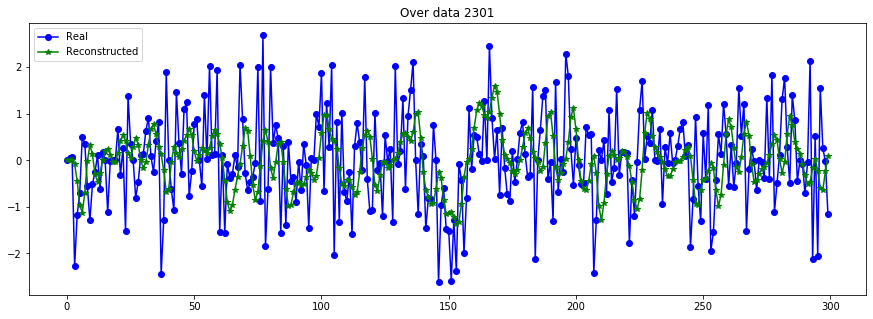

----------------------------------------------------------------


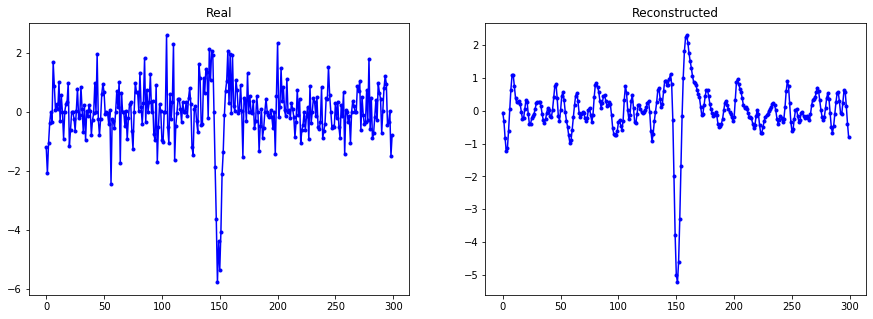

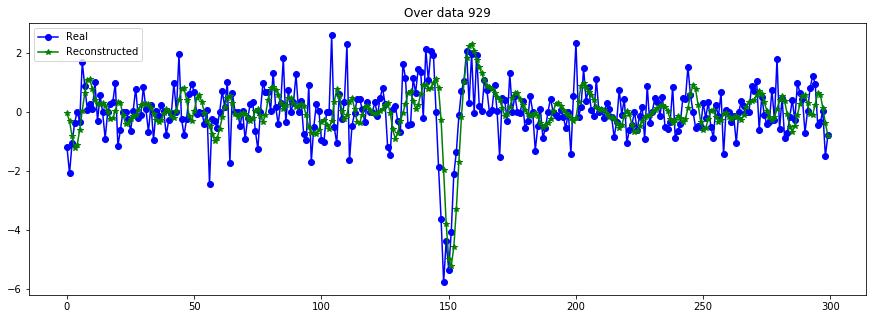

----------------------------------------------------------------


In [23]:
lowcut  = 50 #300. #2000. #con order 3
highcut = 1500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0])

evaluate_reconst(X_train[:N], X_train_filter)

plot_n_lc(X_train[:N,:,0], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


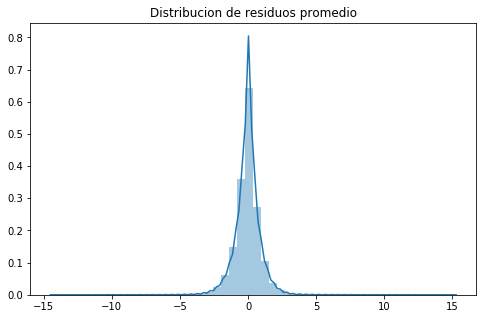

MSE      =  0.9578200775186706
RMSE (+-)=  0.9591904213536888
MAE  (+-)=  0.6403531005600597
--------- Smoothness ------------
AutoCorr lag-one =  0.6700086968365959
Diff MEAN =  0.3634347977239073
Diff STD =  0.44982382280892624
--------- Smoothness ------------


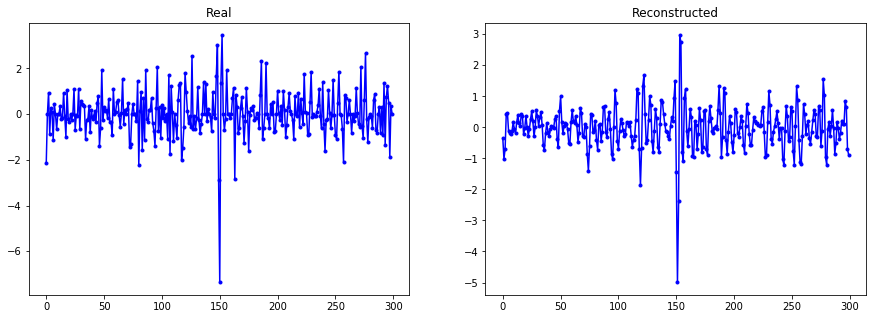

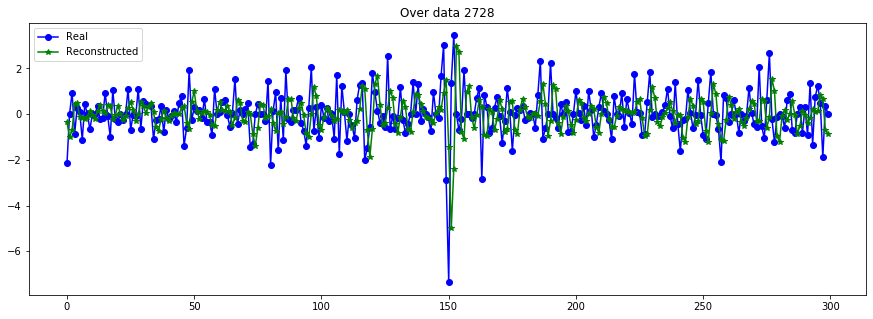

----------------------------------------------------------------


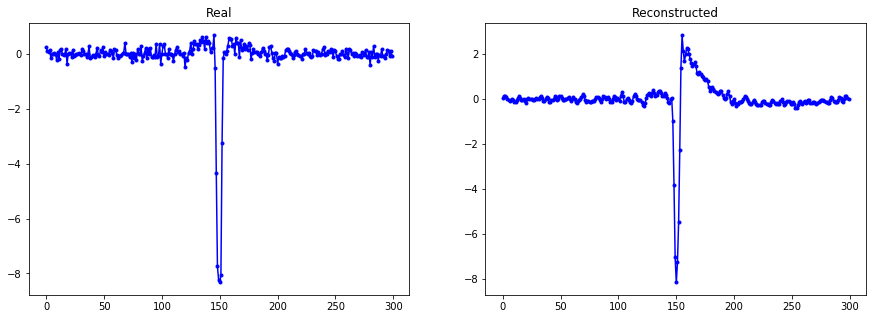

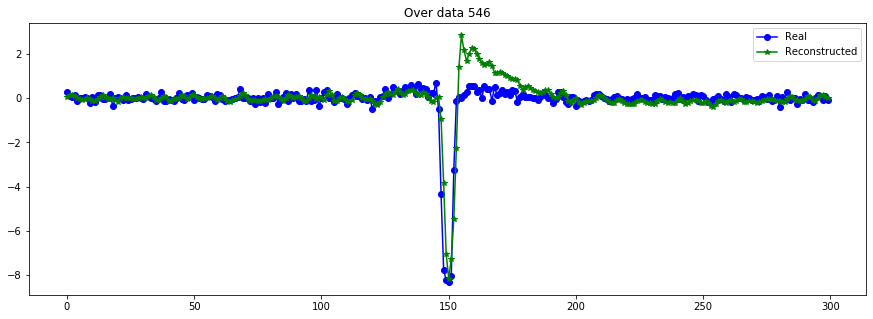

----------------------------------------------------------------


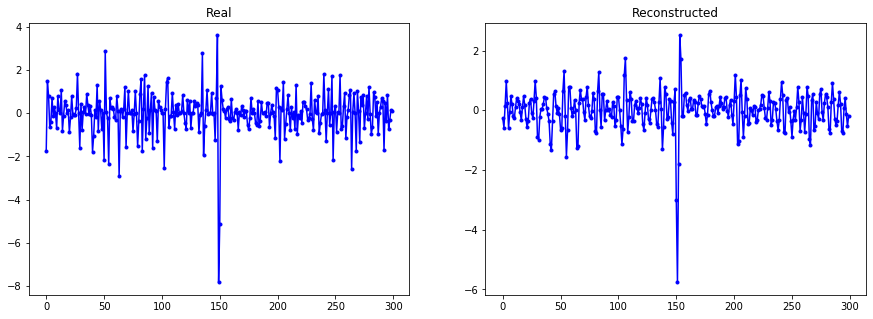

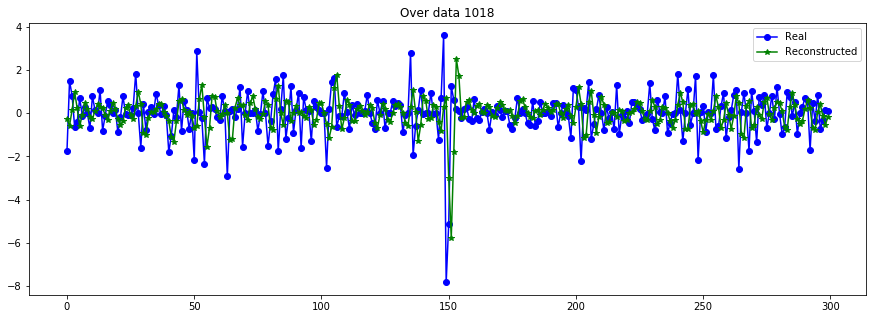

----------------------------------------------------------------


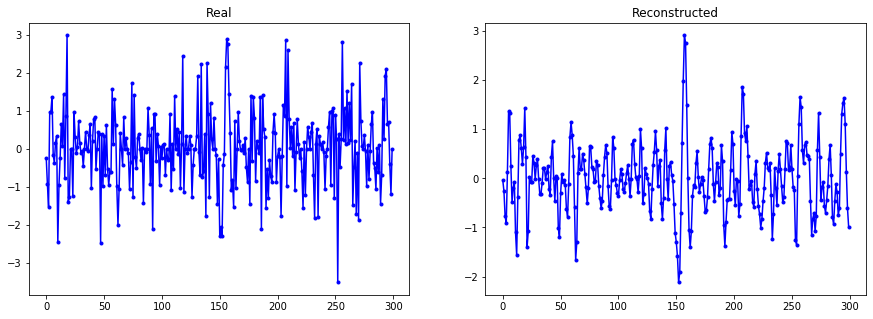

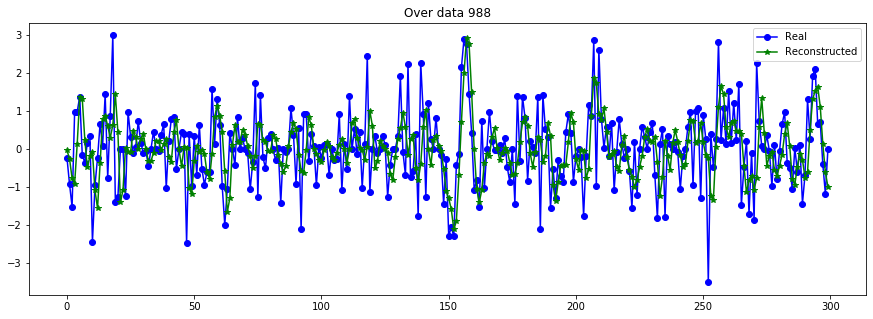

----------------------------------------------------------------


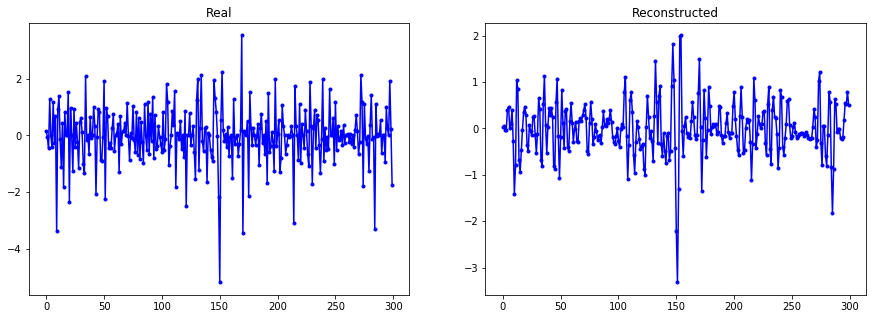

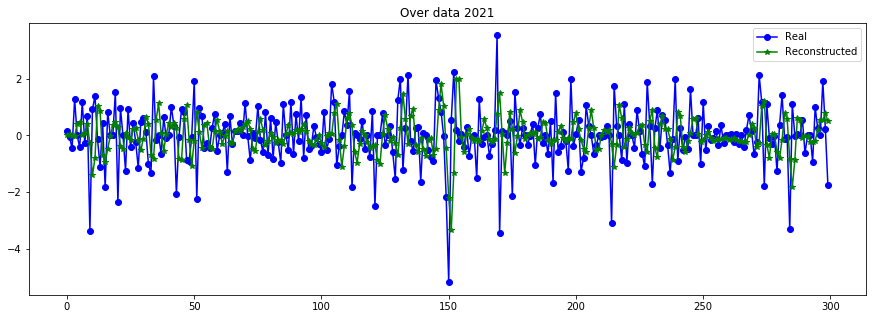

----------------------------------------------------------------


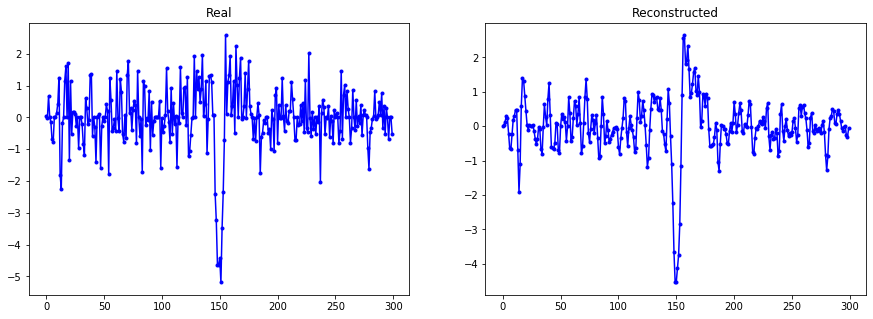

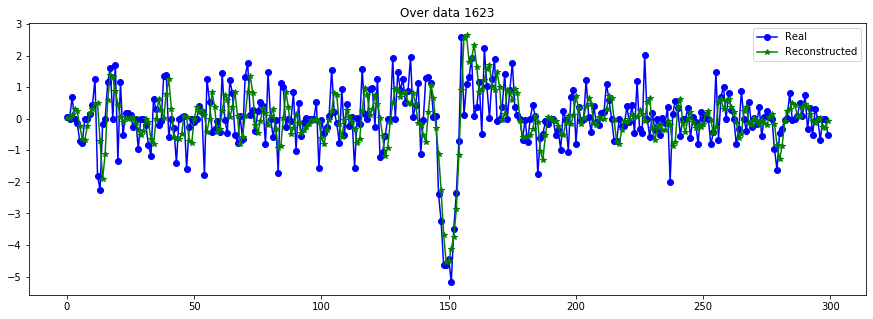

----------------------------------------------------------------


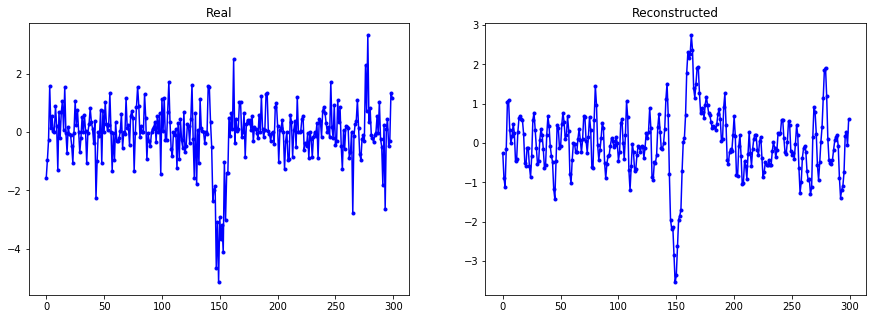

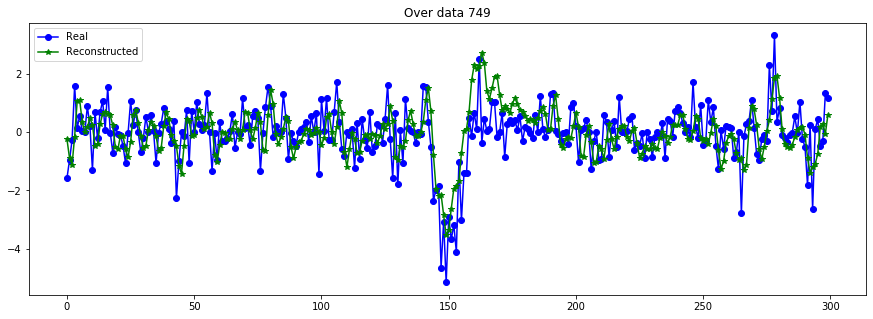

----------------------------------------------------------------


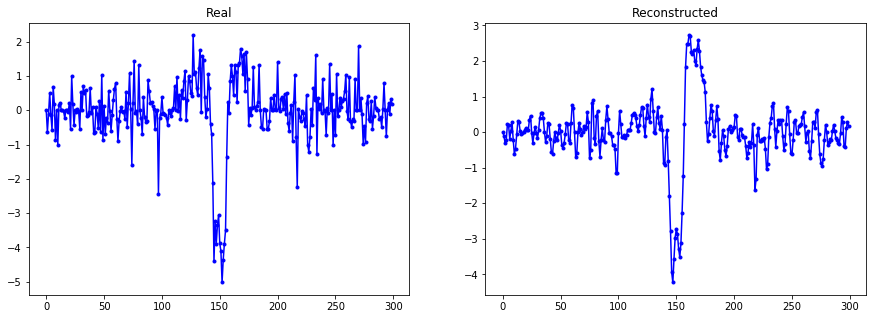

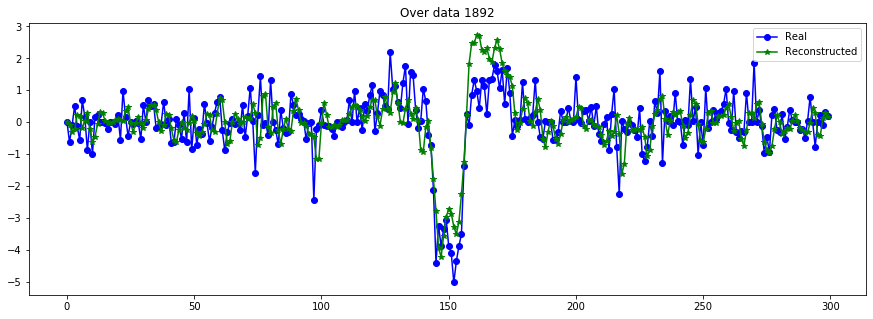

----------------------------------------------------------------


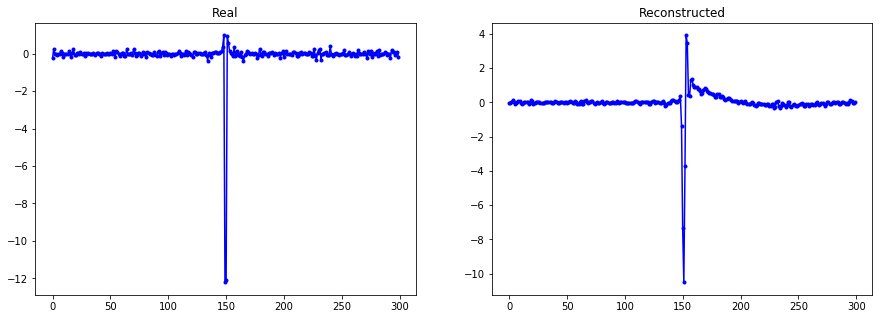

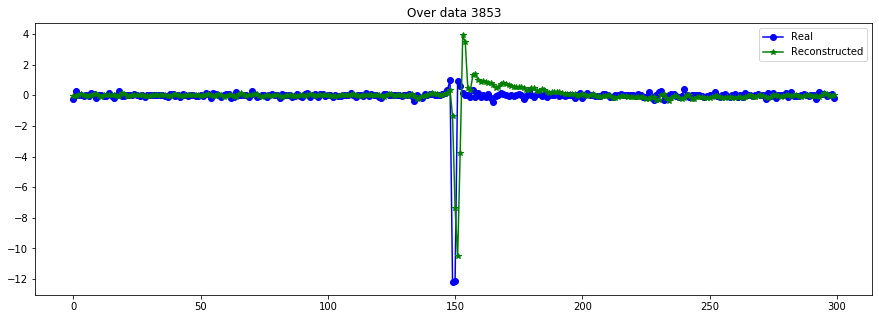

----------------------------------------------------------------


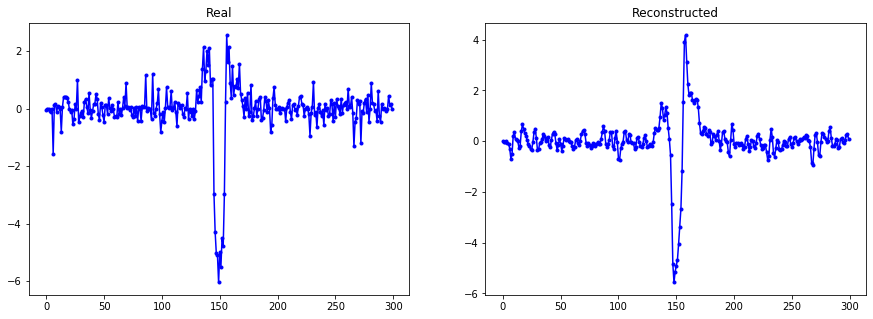

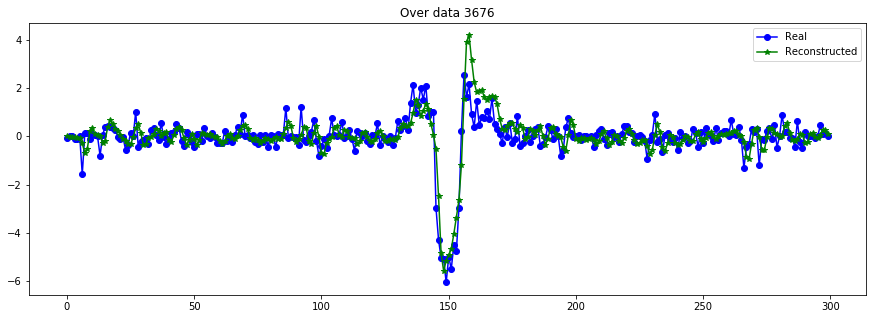

----------------------------------------------------------------


In [24]:
lowcut  = 50 #300. #2000. #con order 3
highcut = 2500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0])

evaluate_reconst(X_train[:N], X_train_filter)

plot_n_lc(X_train[:N,:,0], X_train_filter, n= 10)

### Smooth light curve (moving average)

In [25]:
df = pd.DataFrame(X_train[:N,:,0])
df.head()

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,0.001755,-0.015353,-0.029722,-0.053500,0.026395,-0.017859,0.091809,0.005582,0.011196,-0.007103,...,0.004323,-0.058153,0.008254,-0.042254,0.012044,0.000472,0.000000,0.004695,0.017936,0.041400
1,1.713703,0.000000,0.550766,-1.036800,-0.155234,-0.143814,0.345360,-0.288304,-0.649825,0.023794,...,0.433612,0.380711,0.151400,0.671420,-1.313290,0.000000,0.731992,-0.340403,0.911760,0.068769
2,0.058238,-0.620704,1.298923,-0.312117,0.122567,-0.595697,1.319357,0.000000,0.662465,-1.252039,...,-1.257980,0.126108,0.306365,-0.116427,-0.548265,0.217362,-0.196374,0.163628,0.063909,0.000000
3,0.012195,-0.028396,0.000000,0.121830,0.061334,0.012432,0.019282,0.162736,0.208623,-0.004228,...,-0.025754,0.070074,0.000000,-0.011534,0.000000,-0.013845,0.066574,0.000000,-0.039599,-0.208369
4,-0.302318,-0.469019,1.023780,-0.121473,0.340718,-0.181688,-0.001961,1.512010,-0.093183,-1.129639,...,-1.318478,-0.967788,1.272291,-0.450919,-0.224901,-0.029626,0.809729,-0.016381,0.000000,-0.054760


----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


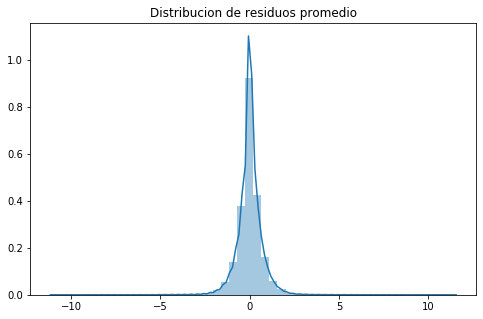

MSE      =  0.5425008087998157
RMSE (+-)=  0.7187058571779475
MAE  (+-)=  0.4611879447505643
--------- Smoothness ------------
AutoCorr lag-one =  0.7035915001171614
Diff MEAN =  0.27365729201587496
Diff STD =  0.3427567136880747
--------- Smoothness ------------


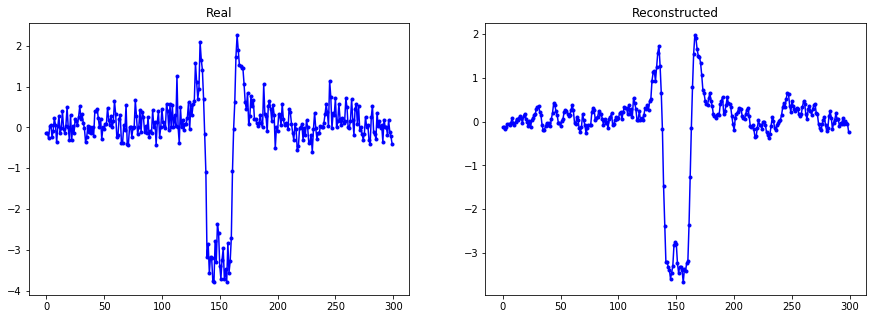

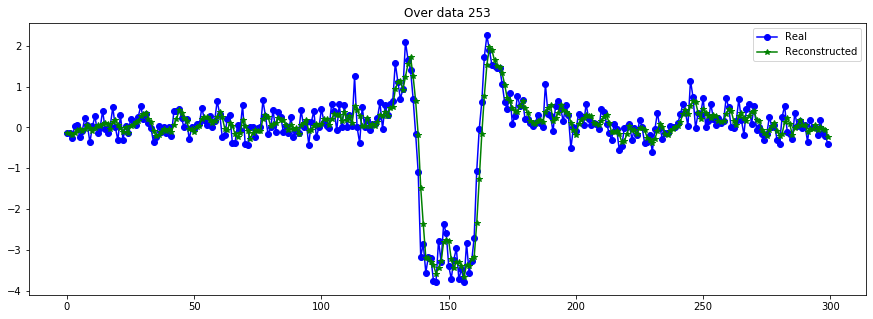

----------------------------------------------------------------


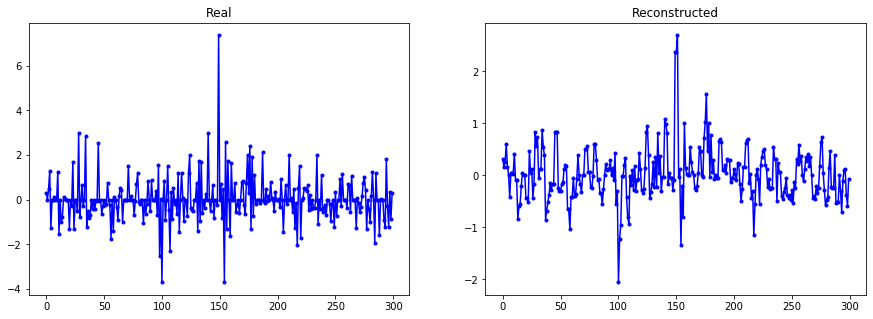

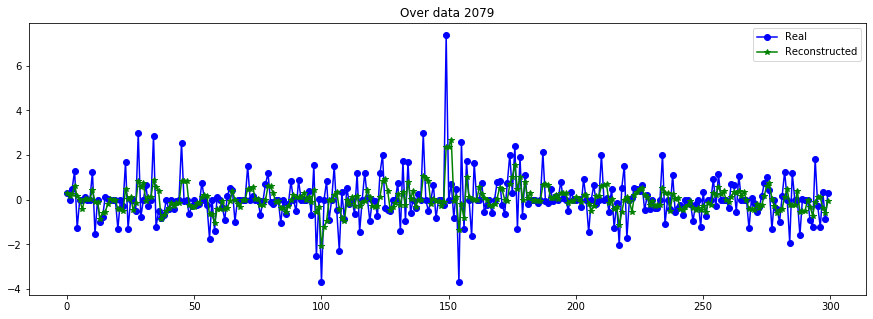

----------------------------------------------------------------


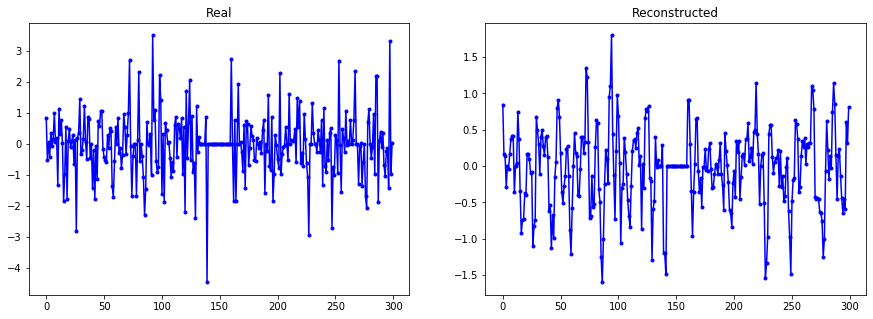

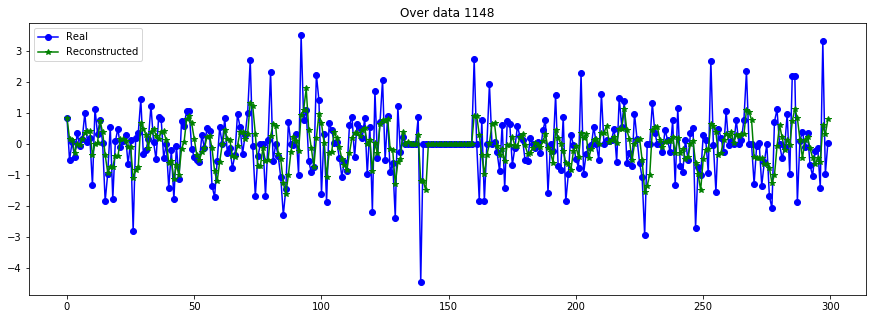

----------------------------------------------------------------


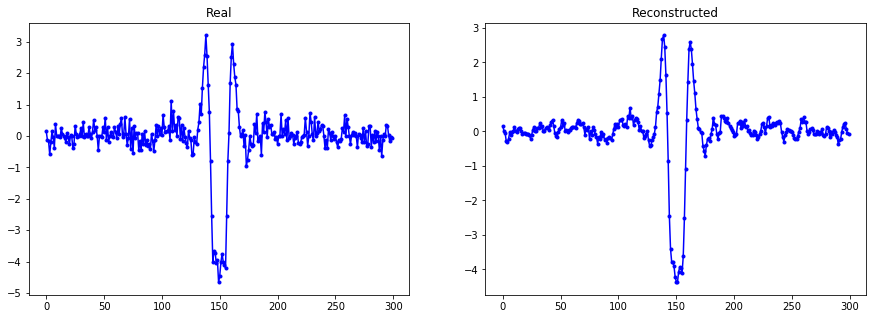

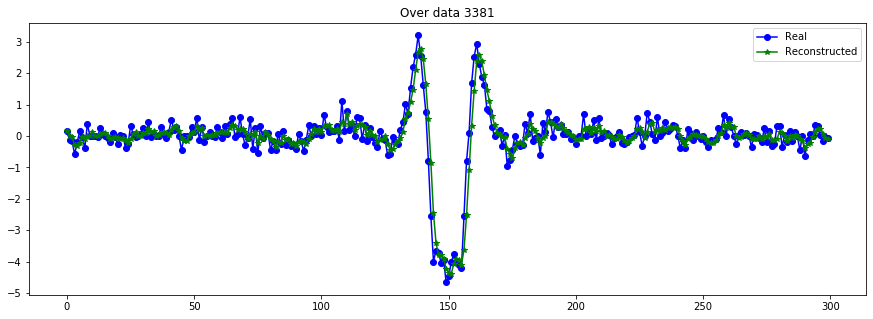

----------------------------------------------------------------


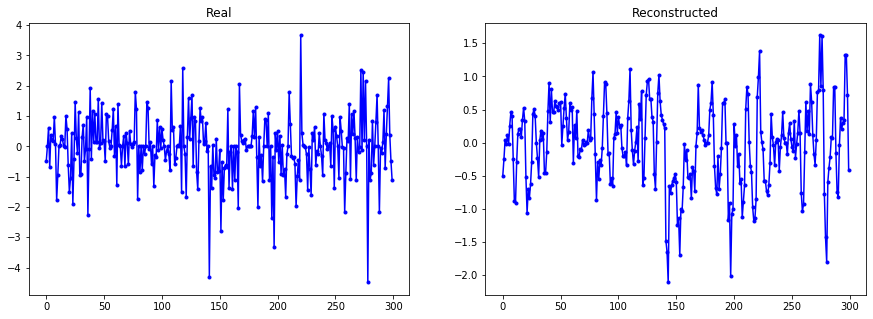

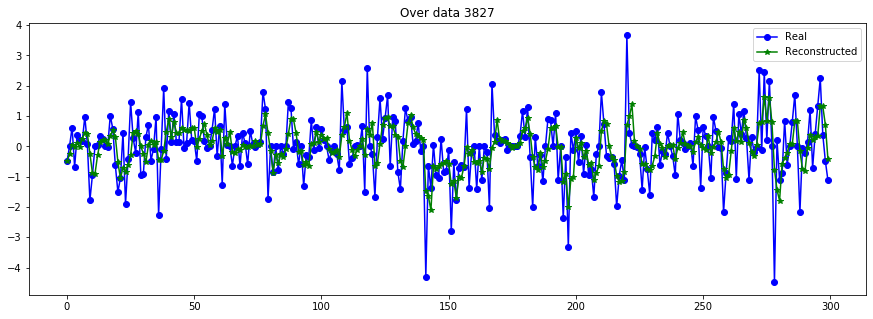

----------------------------------------------------------------


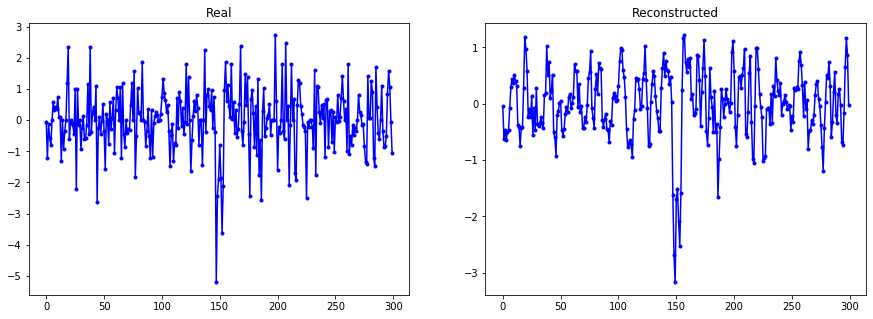

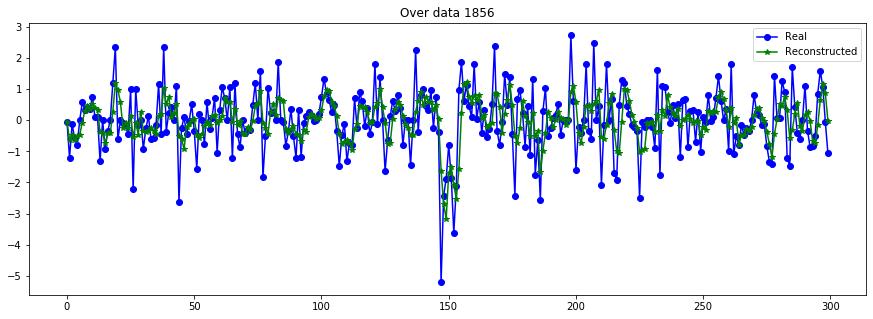

----------------------------------------------------------------


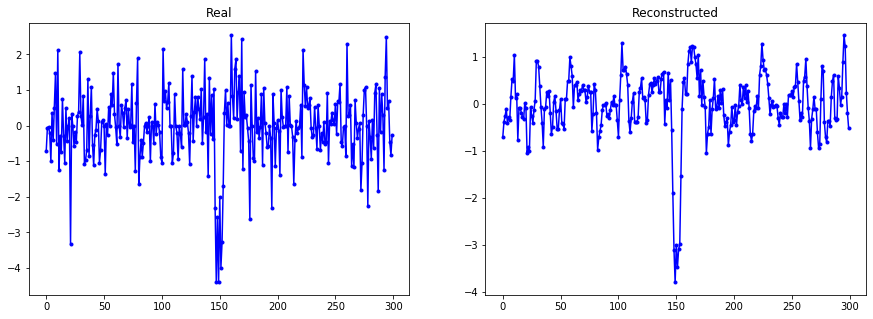

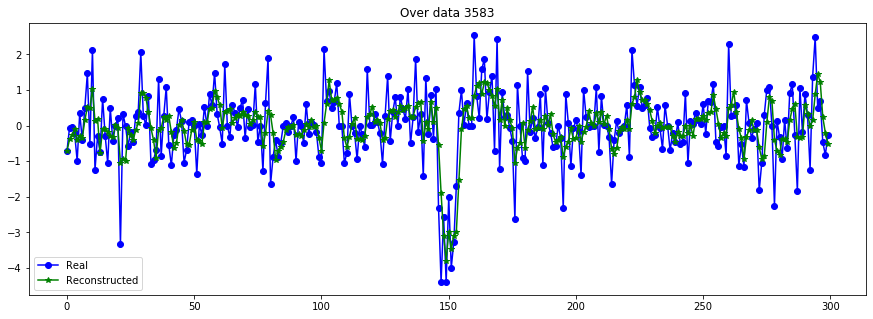

----------------------------------------------------------------


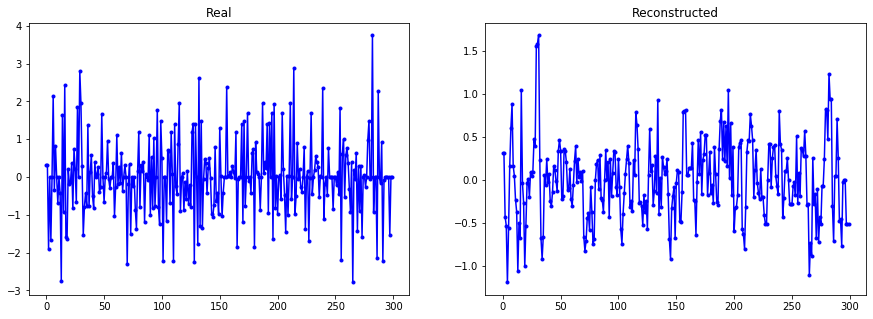

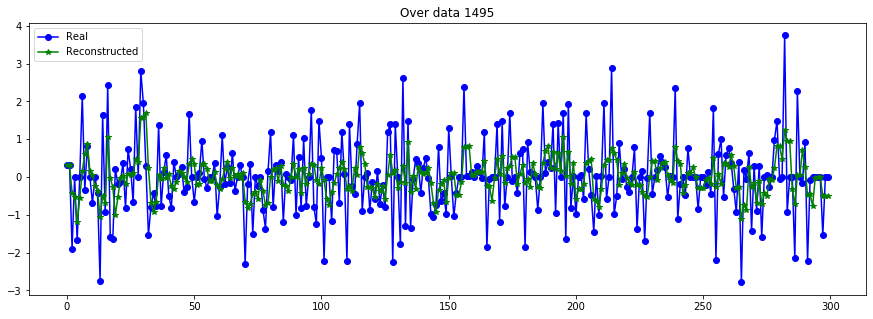

----------------------------------------------------------------


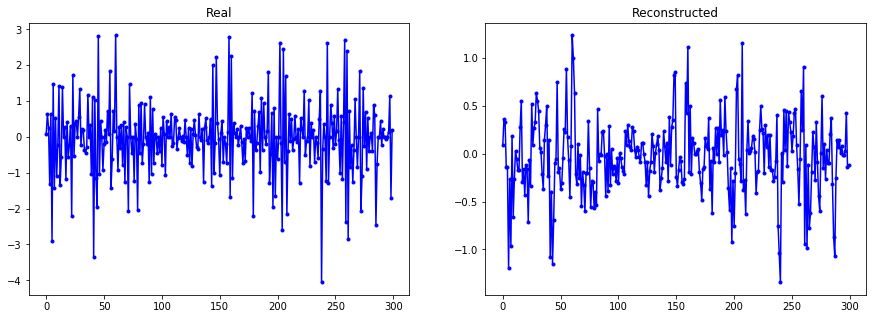

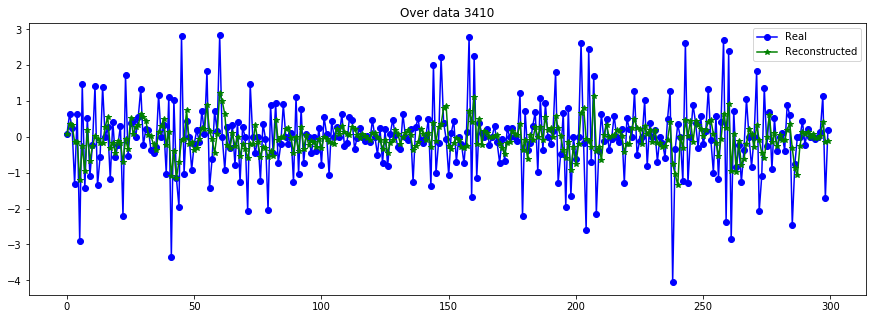

----------------------------------------------------------------


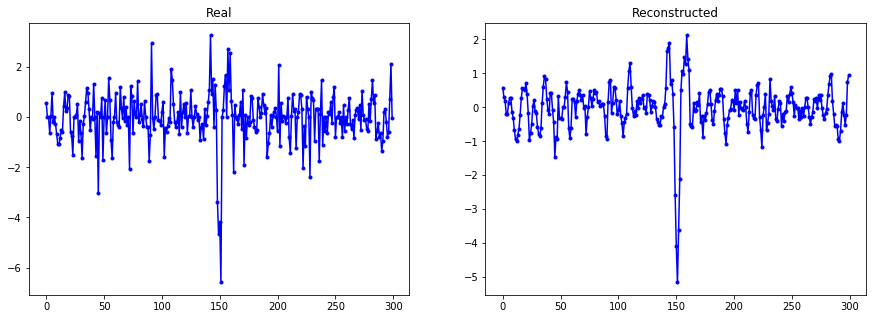

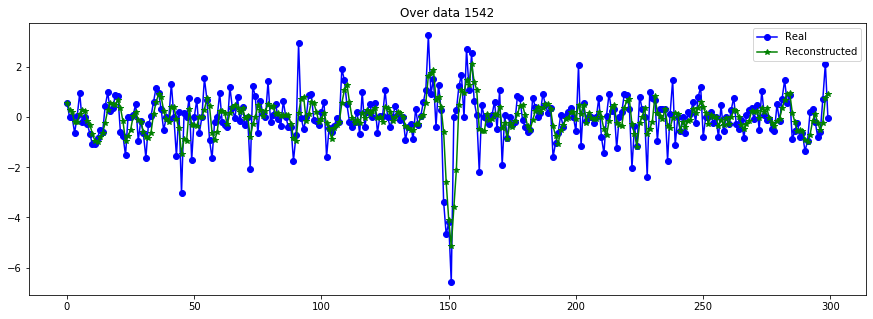

----------------------------------------------------------------


In [26]:
X_train_smooth = df.rolling(window=3, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N], X_train_smooth)

plot_n_lc(X_train[:N,:,0], X_train_smooth, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


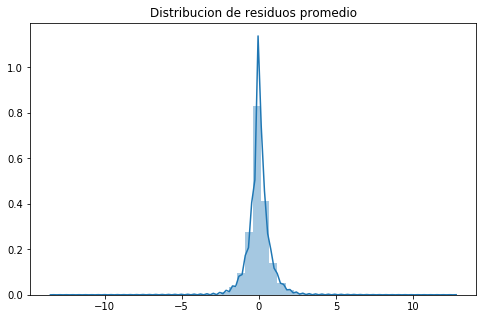

MSE      =  0.7240594003899344
RMSE (+-)=  0.8409120402980607
MAE  (+-)=  0.5127002680673107
--------- Smoothness ------------
AutoCorr lag-one =  0.7843279671025901
Diff MEAN =  0.1697166959053285
Diff STD =  0.21726005725833075
--------- Smoothness ------------


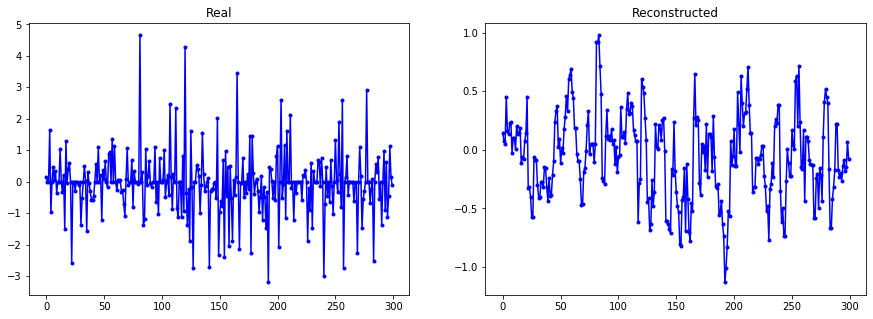

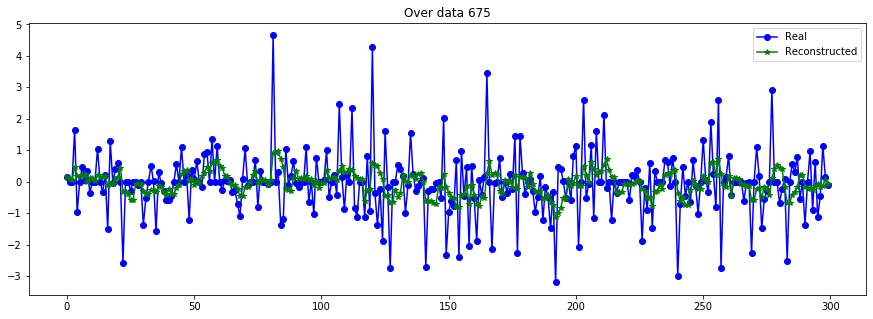

----------------------------------------------------------------


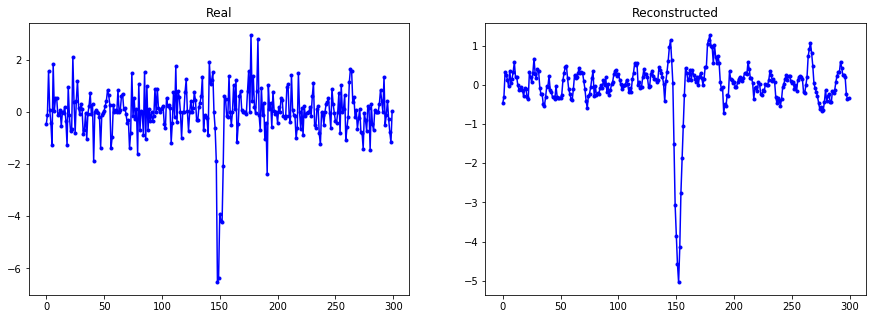

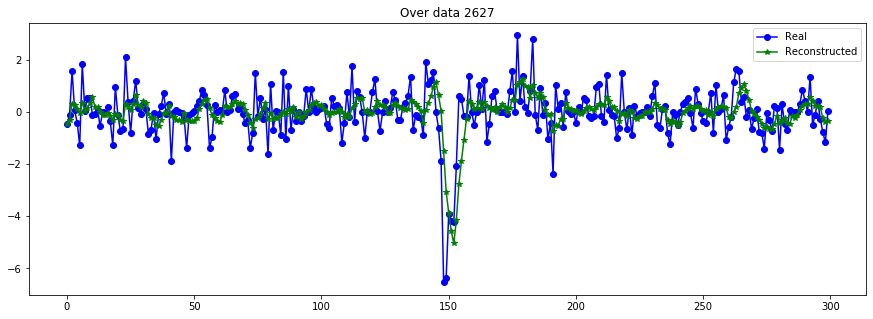

----------------------------------------------------------------


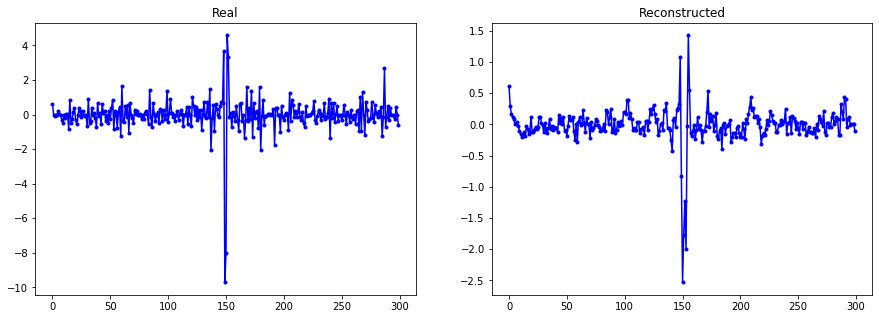

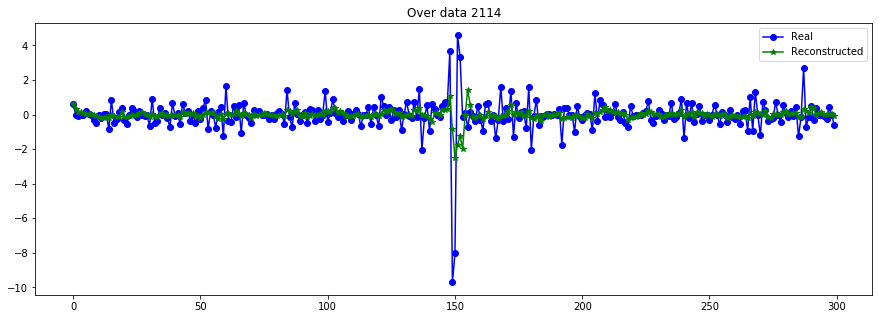

----------------------------------------------------------------


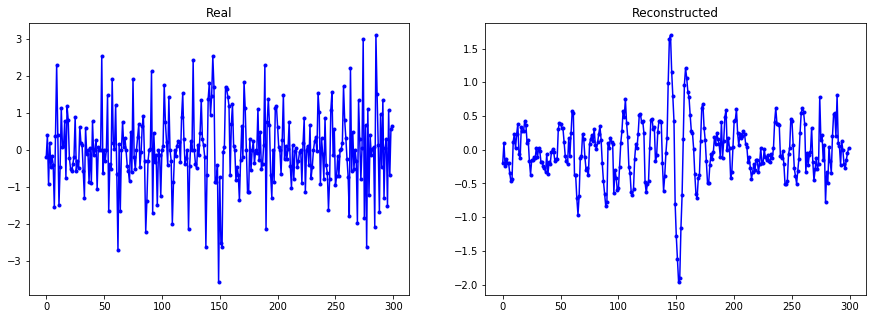

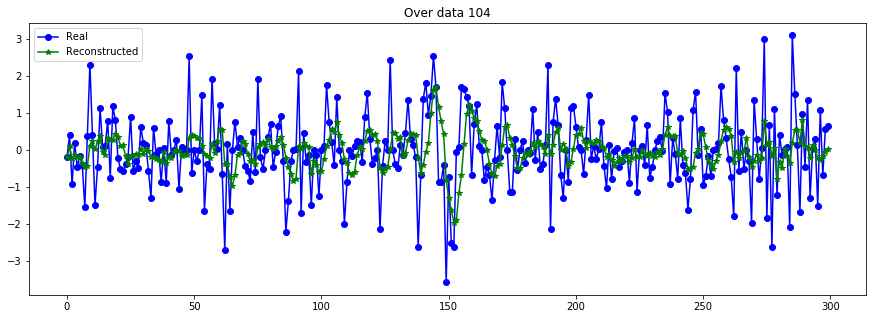

----------------------------------------------------------------


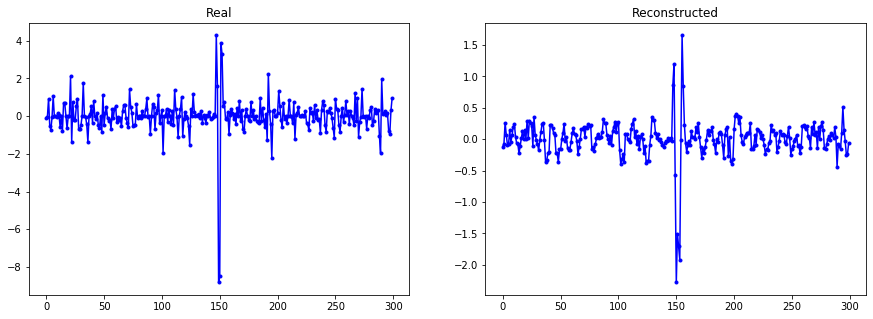

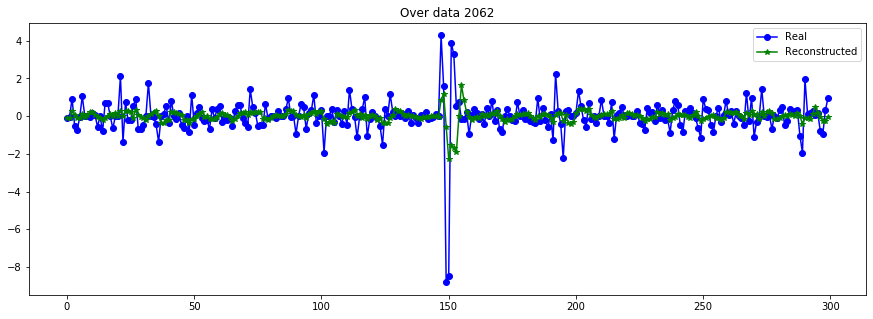

----------------------------------------------------------------


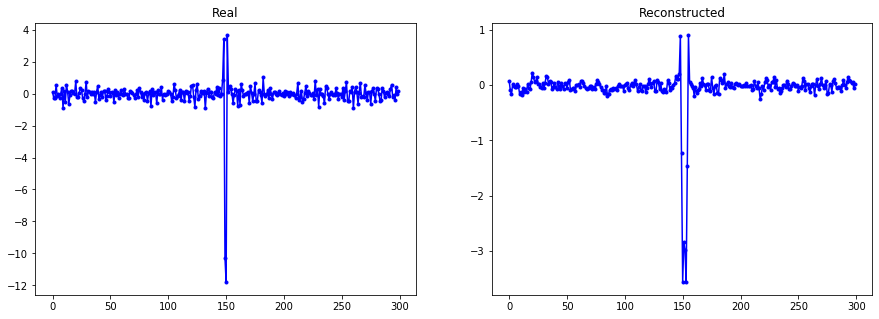

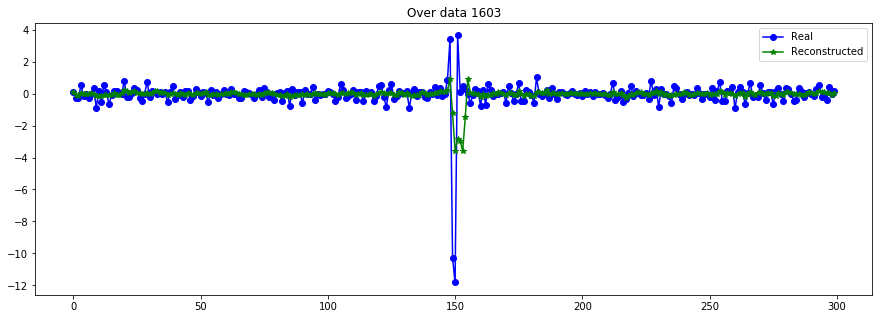

----------------------------------------------------------------


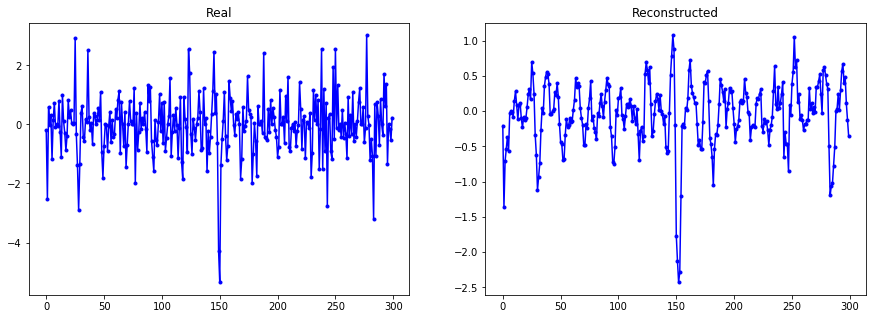

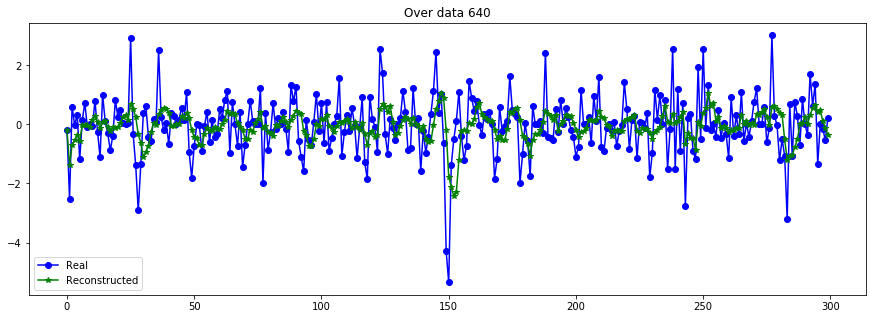

----------------------------------------------------------------


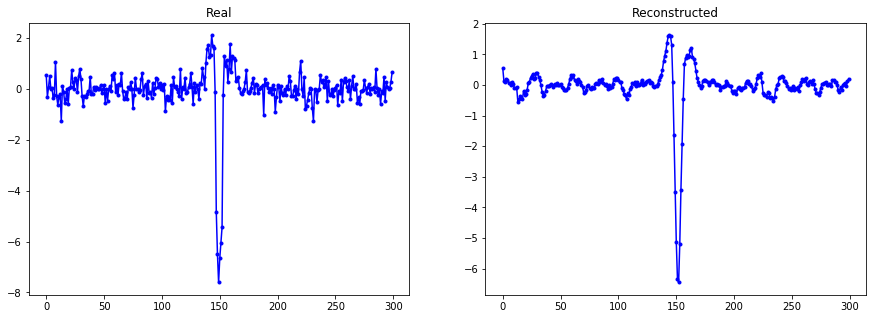

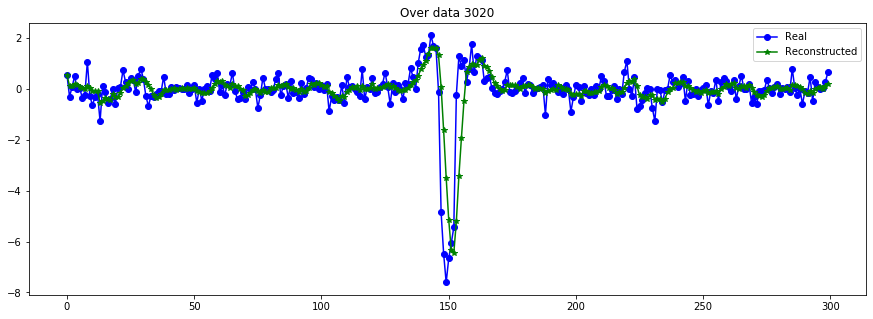

----------------------------------------------------------------


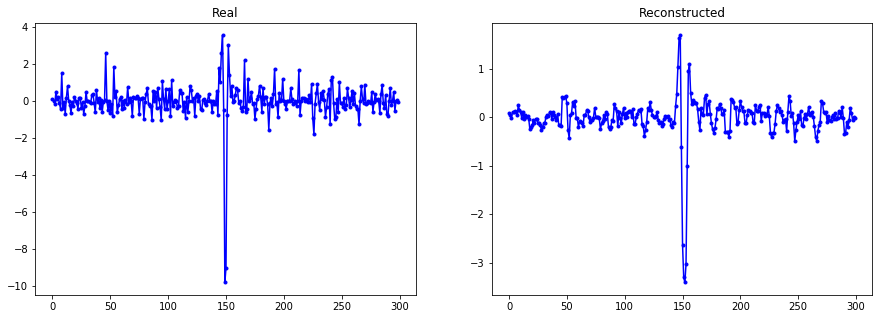

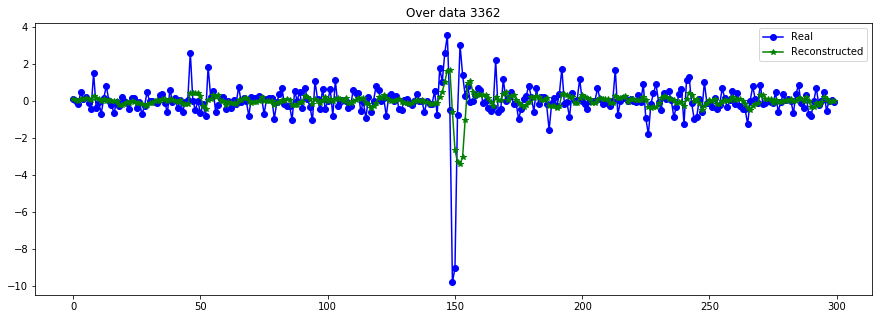

----------------------------------------------------------------


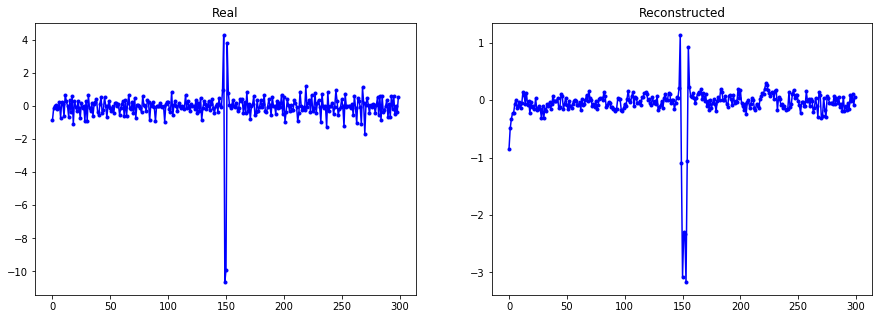

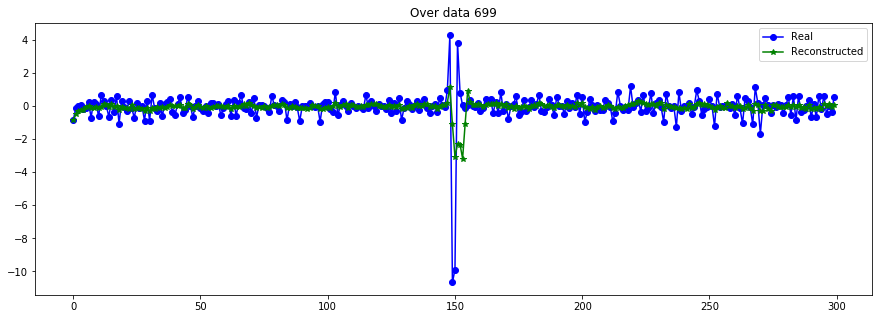

----------------------------------------------------------------


In [27]:
X_train_smooth = df.rolling(window=5, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N], X_train_smooth)

plot_n_lc(X_train[:N,:,0], X_train_smooth, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


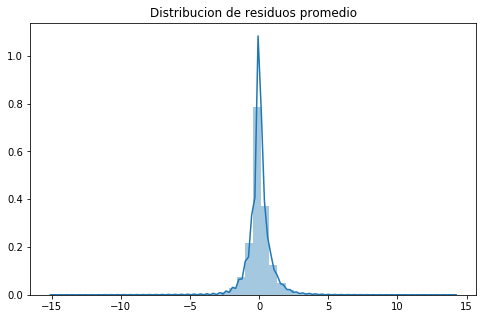

MSE      =  0.8845909695252157
RMSE (+-)=  0.9374380124070237
MAE  (+-)=  0.553104806769996
--------- Smoothness ------------
AutoCorr lag-one =  0.8429504580613226
Diff MEAN =  0.08855878372794385
Diff STD =  0.114783196267587
--------- Smoothness ------------


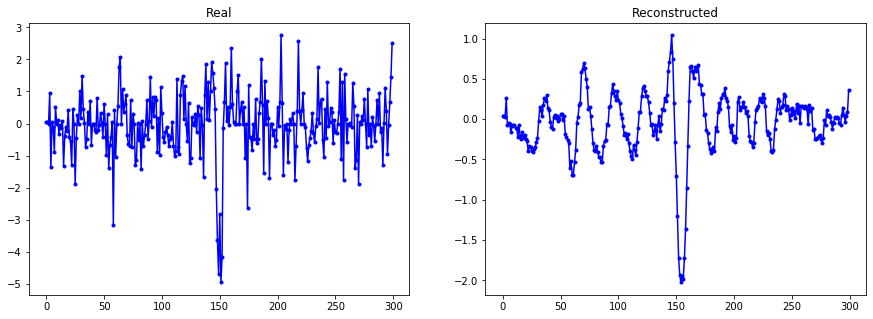

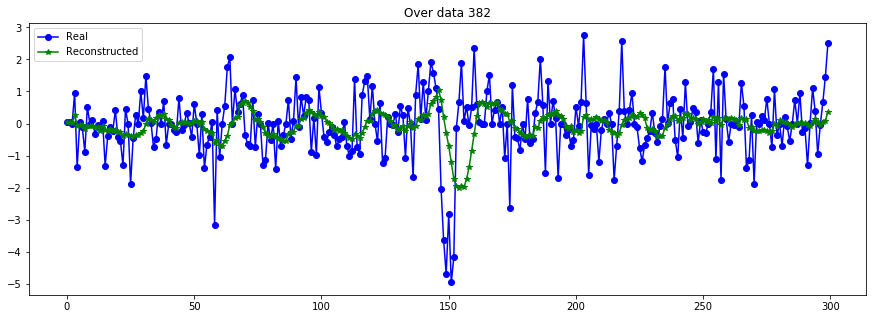

----------------------------------------------------------------


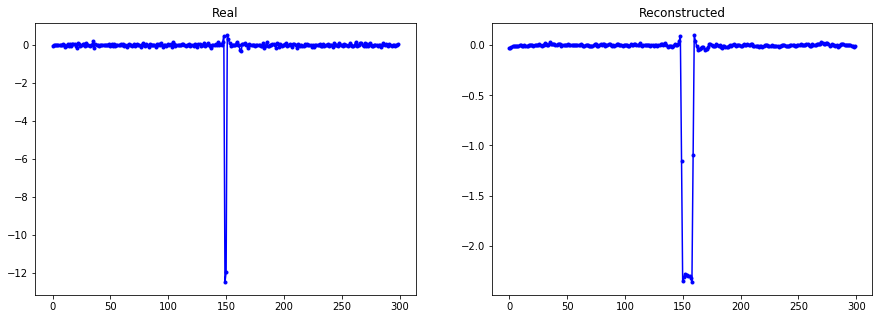

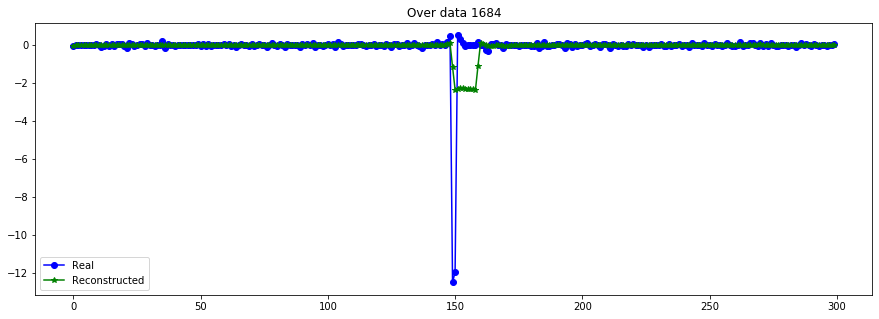

----------------------------------------------------------------


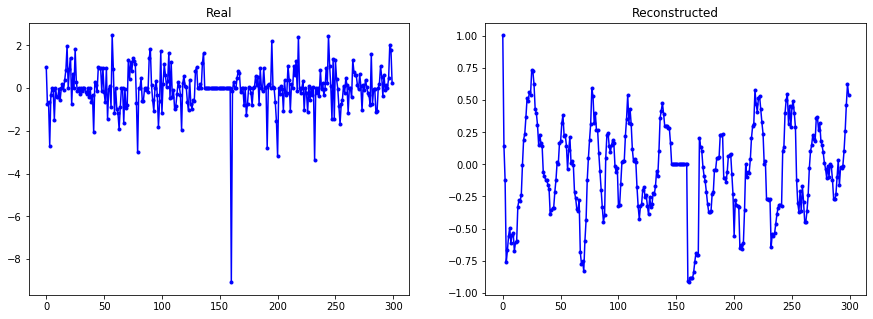

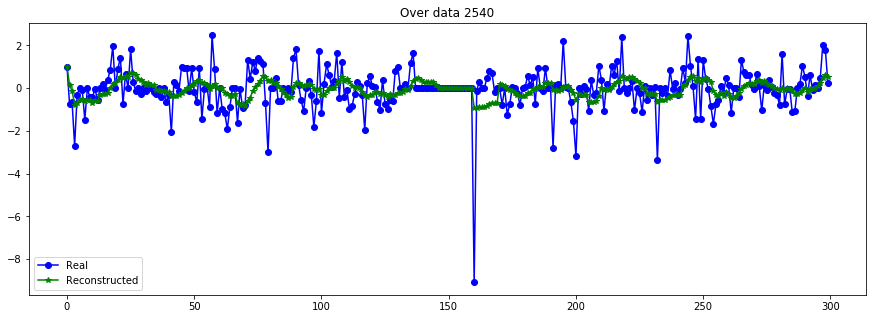

----------------------------------------------------------------


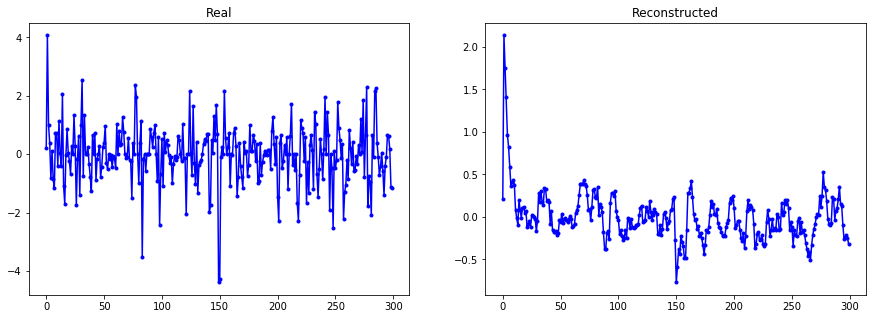

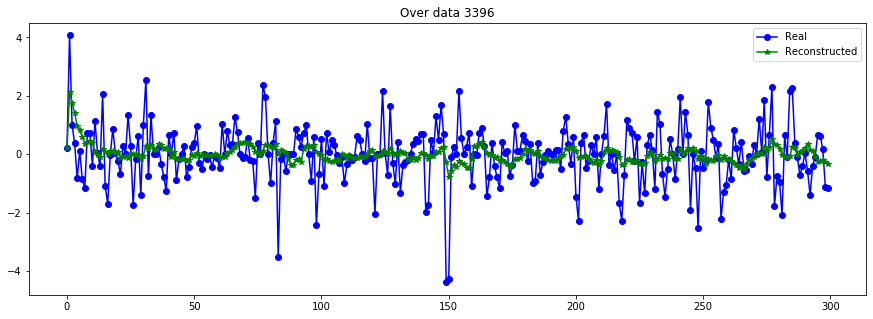

----------------------------------------------------------------


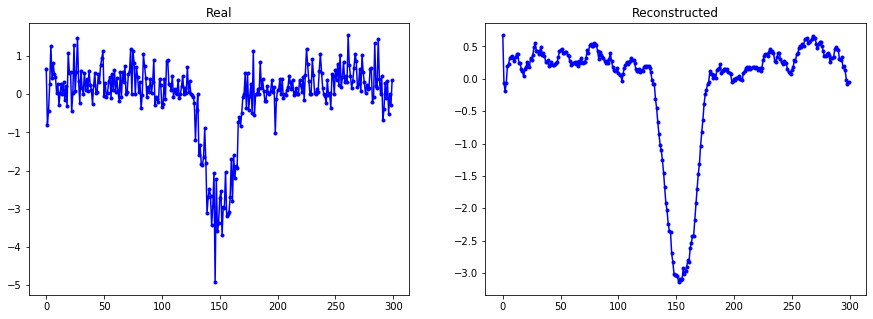

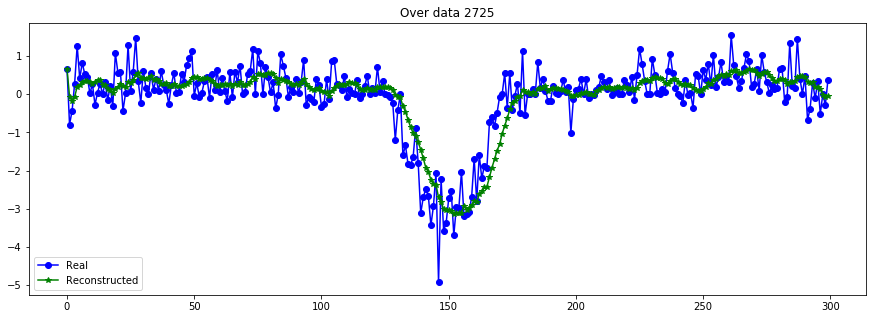

----------------------------------------------------------------


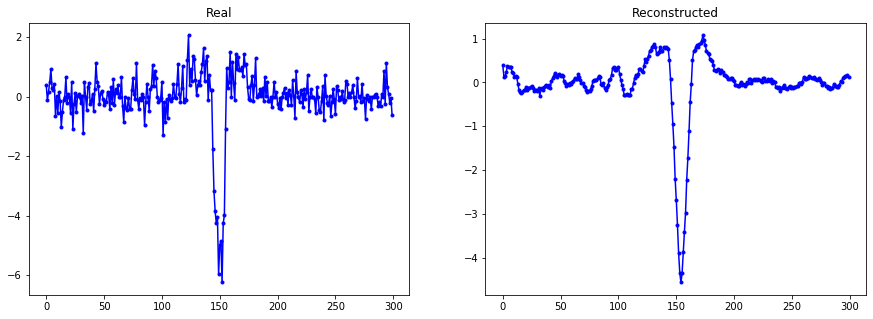

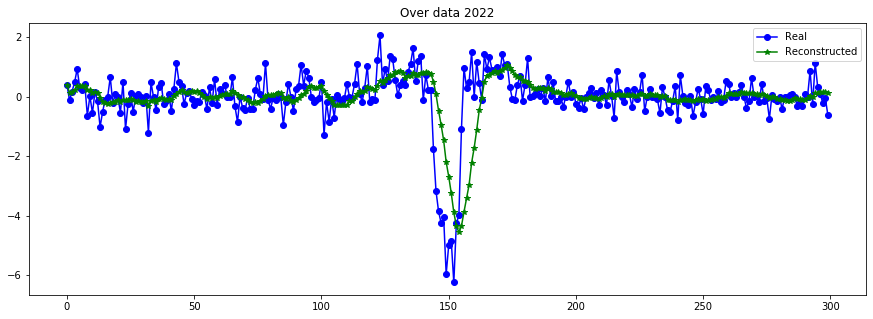

----------------------------------------------------------------


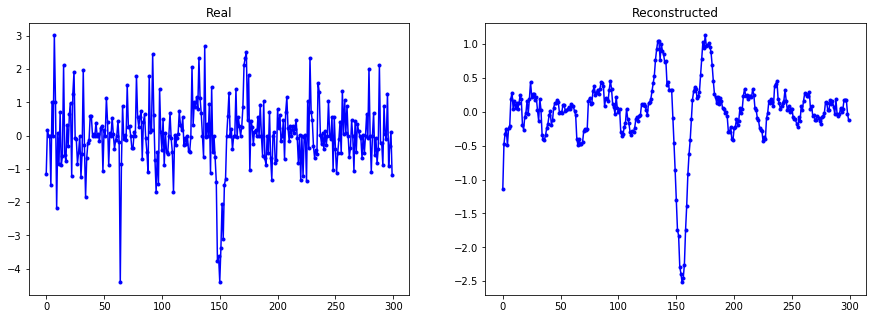

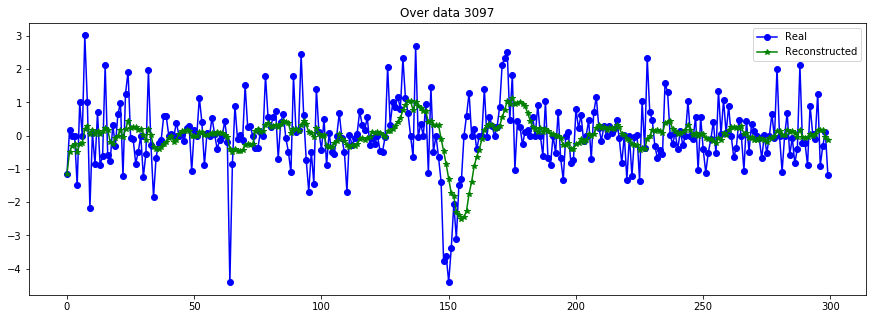

----------------------------------------------------------------


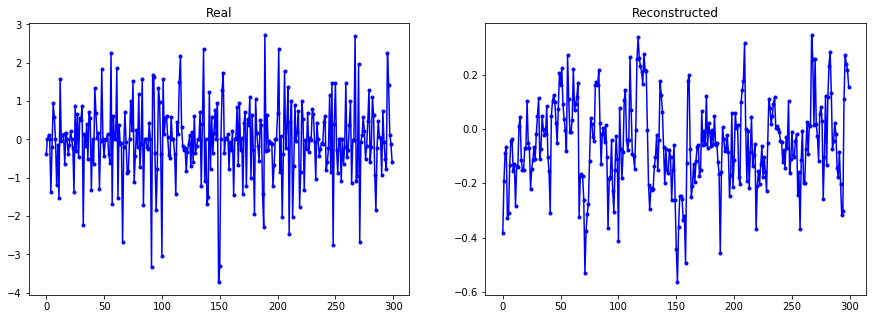

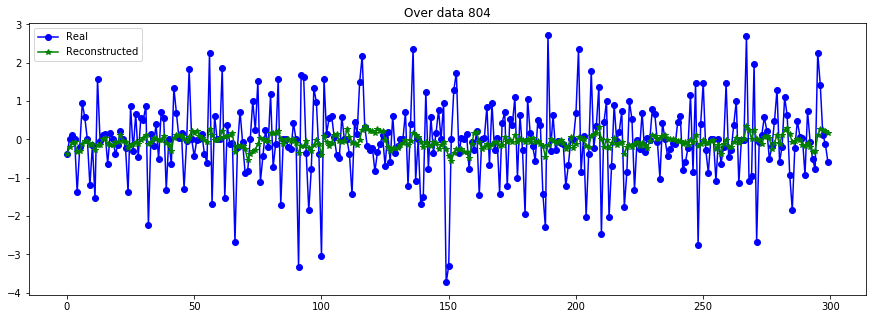

----------------------------------------------------------------


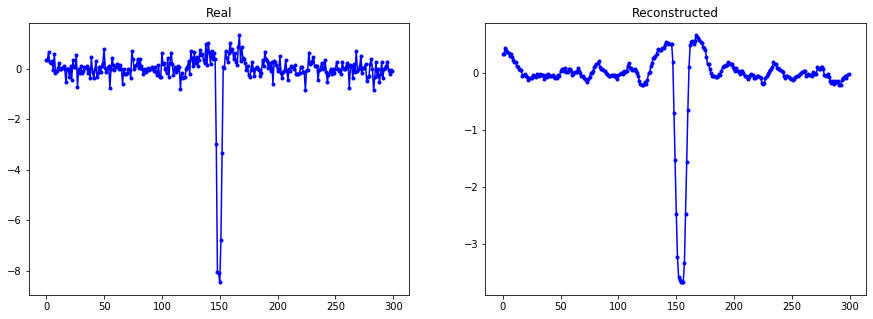

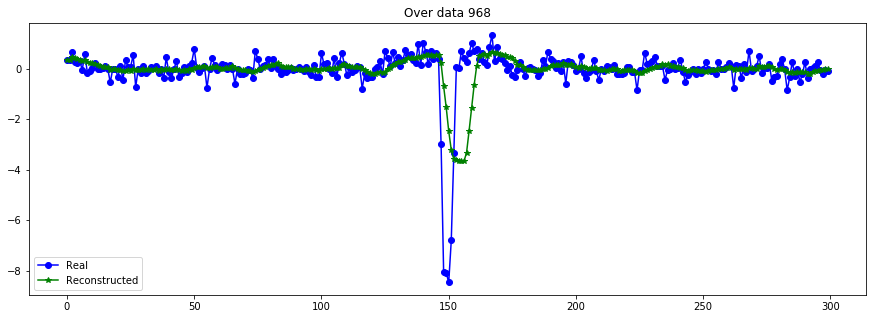

----------------------------------------------------------------


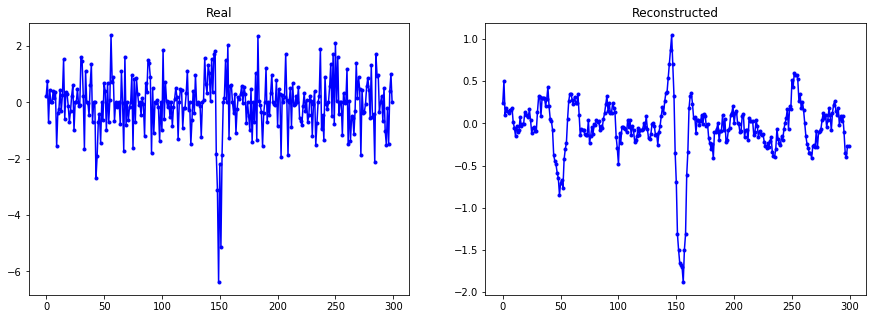

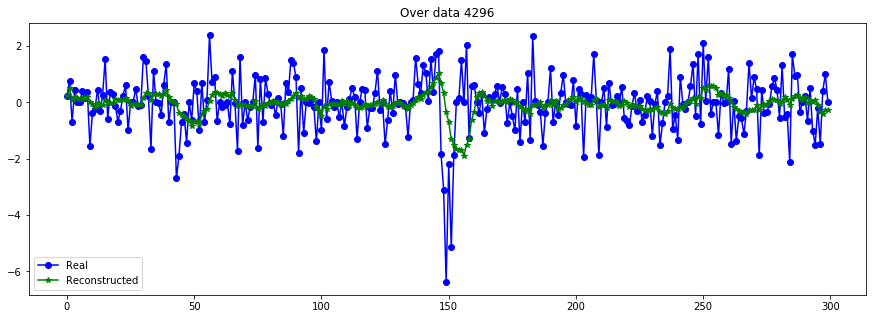

----------------------------------------------------------------


In [28]:
X_train_smooth = df.rolling(window=10, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N], X_train_smooth)

plot_n_lc(X_train[:N,:,0], X_train_smooth, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


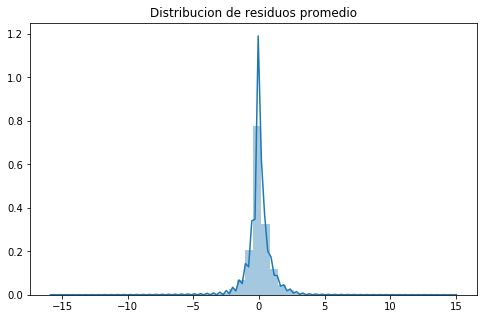

MSE      =  0.9585057517222456
RMSE (+-)=  0.9784135451479038
MAE  (+-)=  0.5716868761399737
--------- Smoothness ------------
AutoCorr lag-one =  0.8652092112413781
Diff MEAN =  0.04672179944086782
Diff STD =  0.06495790528718007
--------- Smoothness ------------


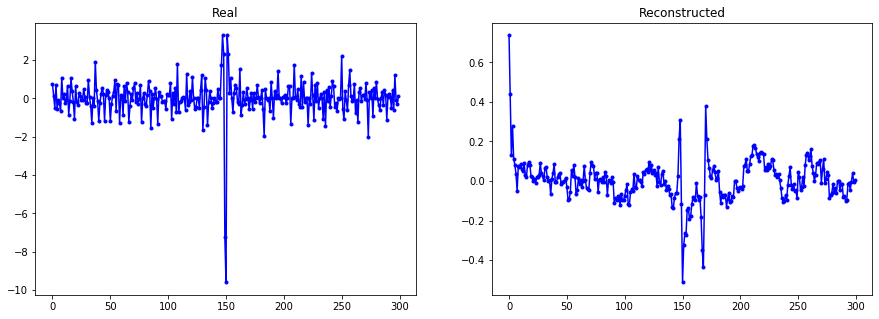

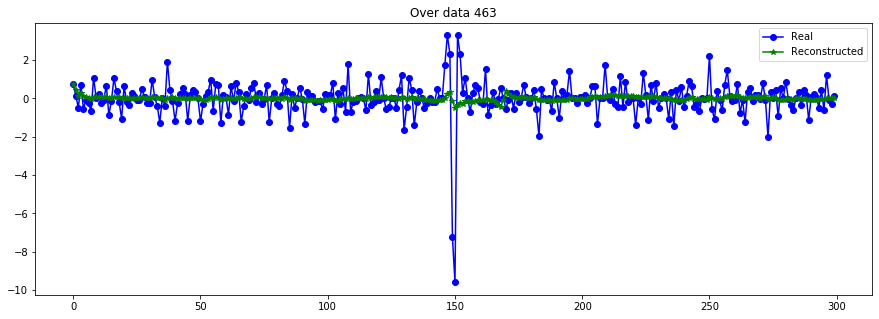

----------------------------------------------------------------


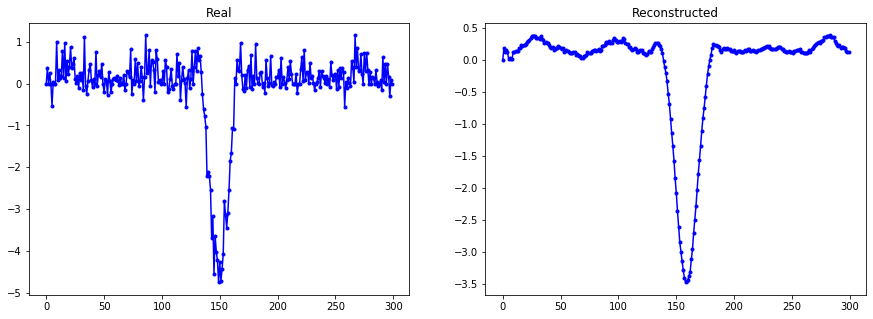

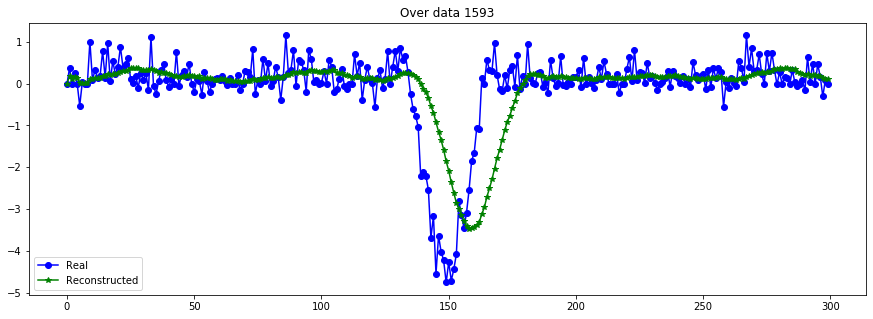

----------------------------------------------------------------


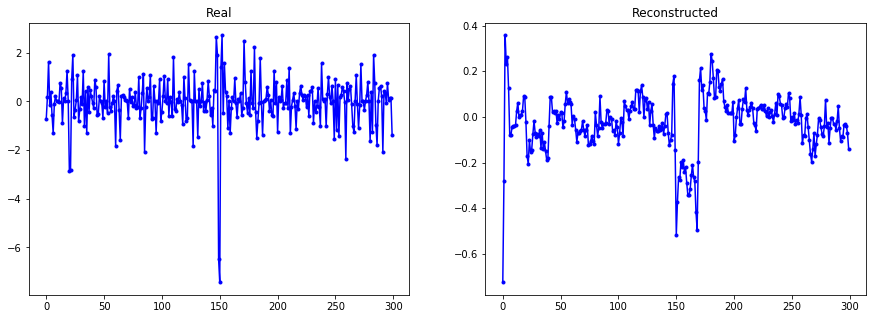

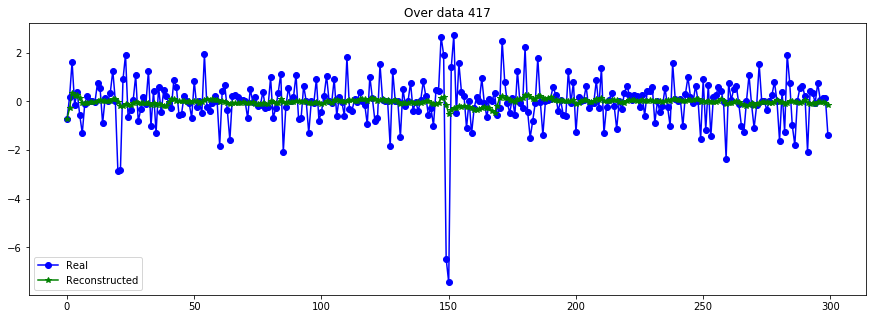

----------------------------------------------------------------


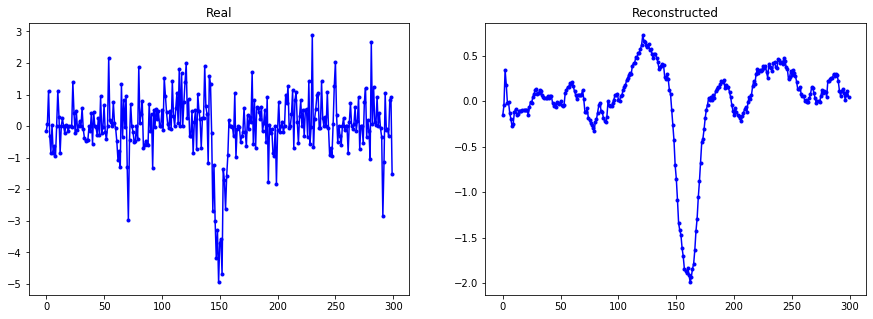

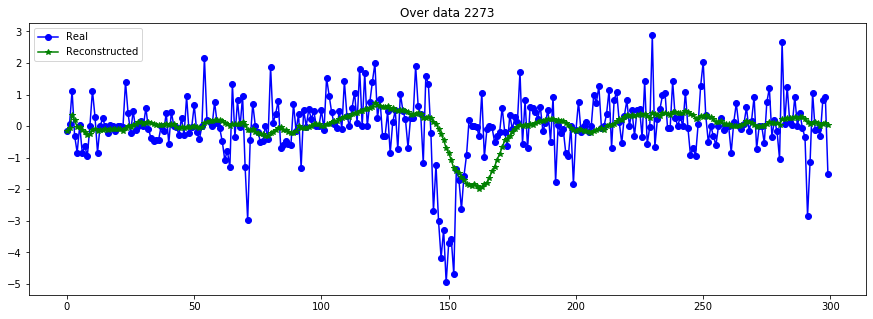

----------------------------------------------------------------


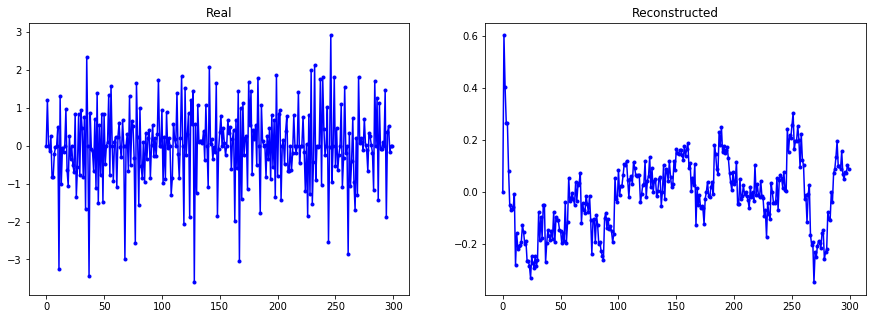

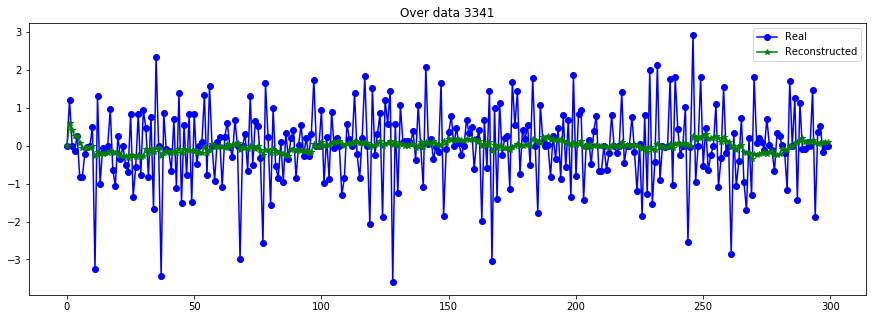

----------------------------------------------------------------


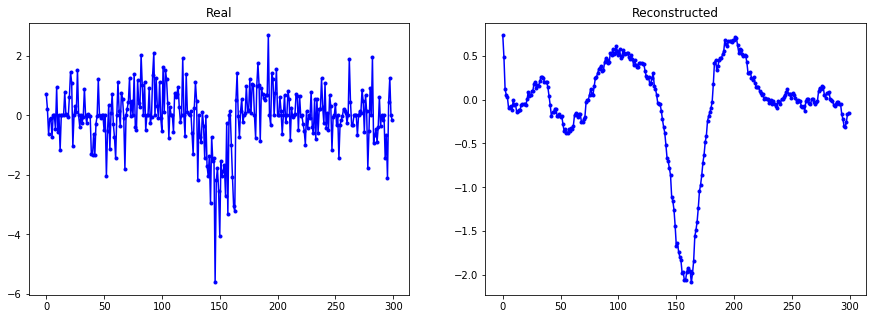

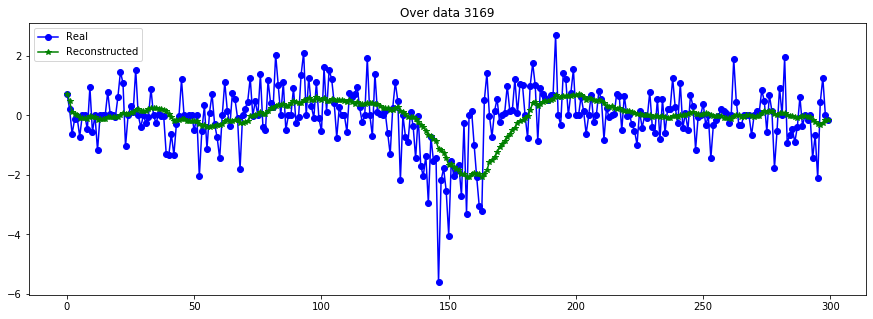

----------------------------------------------------------------


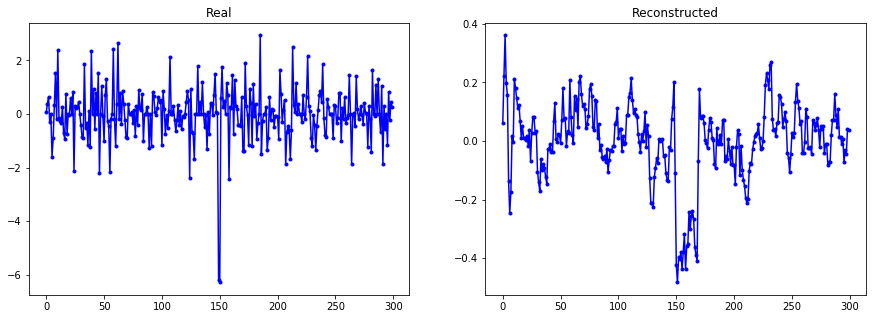

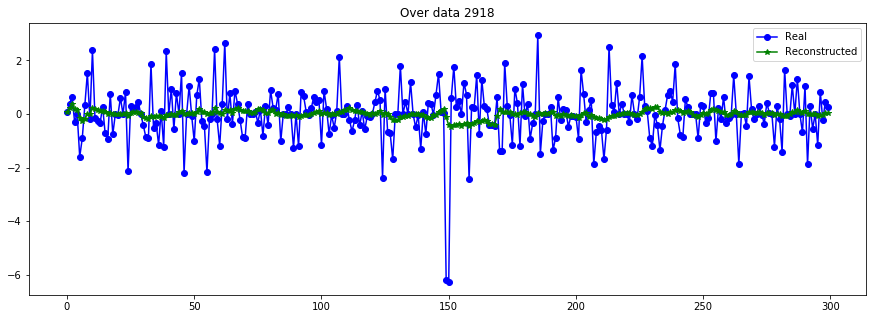

----------------------------------------------------------------


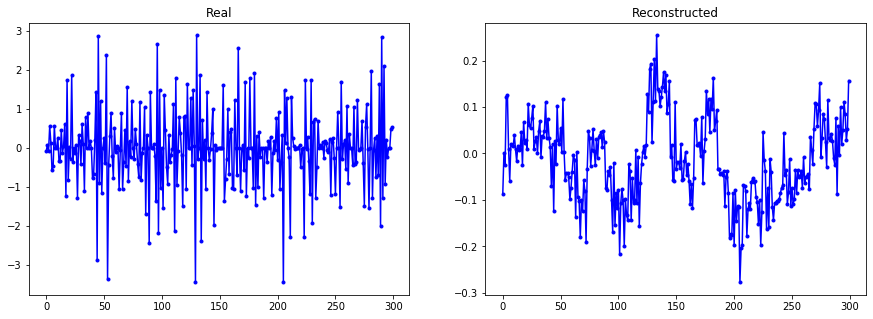

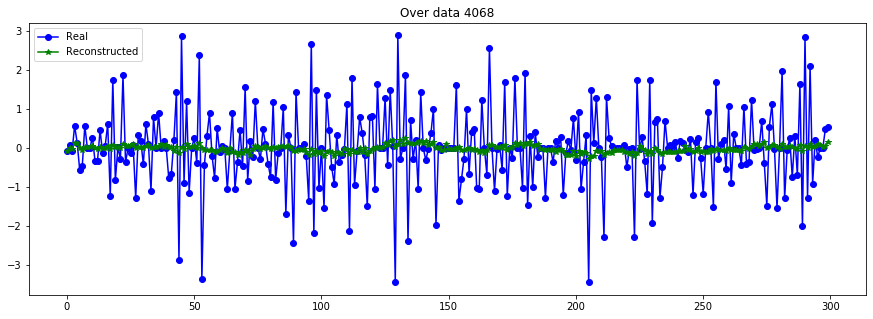

----------------------------------------------------------------


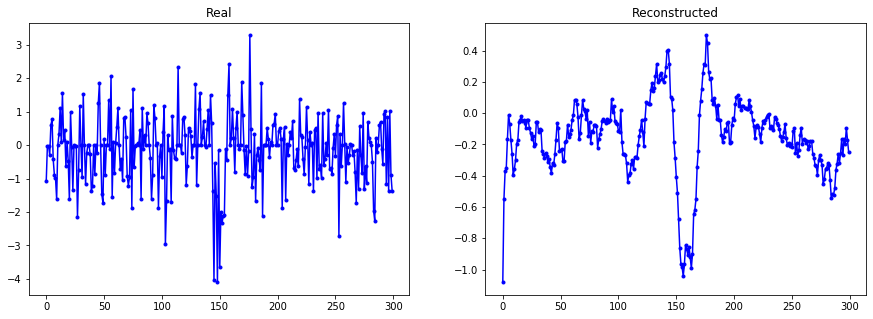

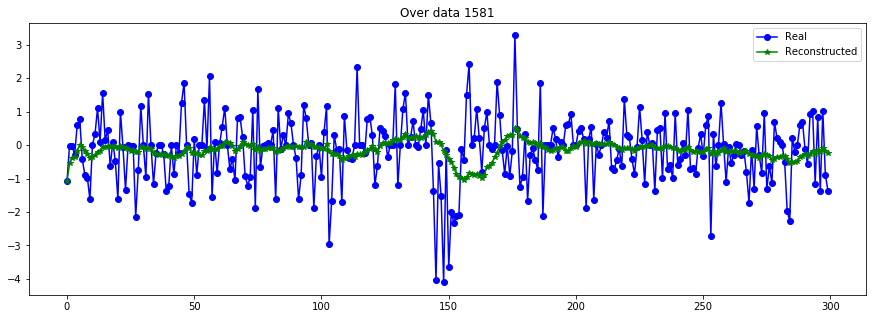

----------------------------------------------------------------


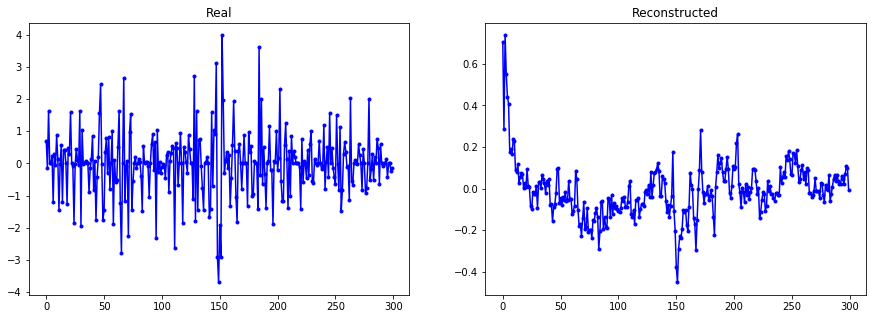

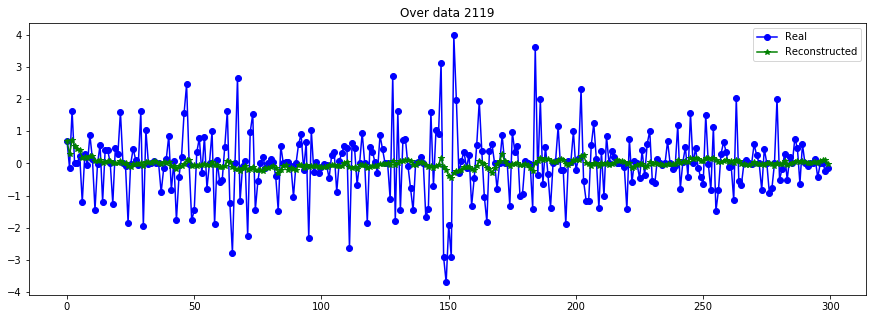

----------------------------------------------------------------


In [29]:
X_train_smooth = df.rolling(window=20, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N], X_train_smooth)

plot_n_lc(X_train[:N,:,0], X_train_smooth, n= 10)

### Mandel-Agol model

In [30]:
import pysyzygy as ps
from pytransit import QuadraticModel
import batman
from IPython.display import display

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6,0.539366,0.226417,131.97457,0.016,1.012,12.57,0.988,0.06737,5016.0,0.314,0.304,6341.0,5.302,2.05


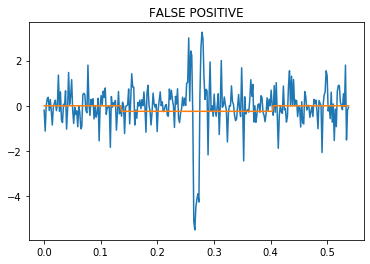

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
62,2.283466,0.324996,132.34883,1.166,4.917,84.66,0.457,0.43124,2014.0,0.273,0.318,6723.0,1.719,1.327


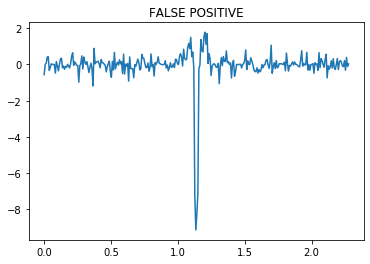

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
72,2.43574,0.927083,133.47404,0.127,1.105,25.56,0.997,0.0043,2102.0,0.235,0.338,7239.0,1.781,1.558


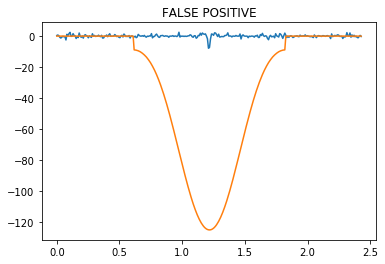

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
84,1.404692,0.26097,131.552084,1.068,3.642,80.56,0.597,0.46311,2263.0,0.328,0.306,6230.0,1.863,1.396


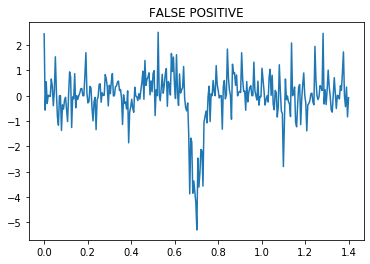

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
110,7.453067,0.198404,131.76434,9.563,28.0,68.35,10.337,7.4908,932.0,0.404,0.262,5780.0,1.0,1.0


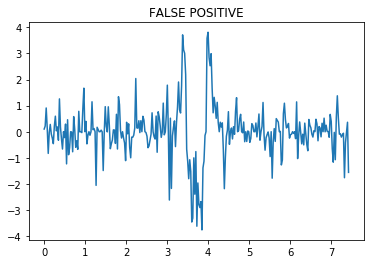

Error in elliptic integral function RC().


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
190,0.922256,0.176125,131.8088,0.008,1.042,17.8,0.992,0.02514,2206.0,0.413,0.26,5631.0,1.485,1.046


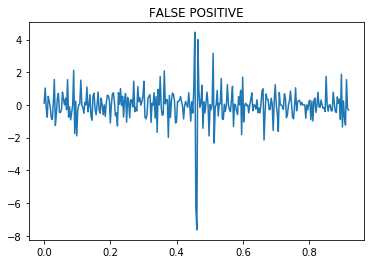

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
194,21.513523,3.249292,132.3356,1.475,2.6,20.29,2.441,0.00072,1006.0,0.547,0.171,5088.0,3.318,1.294


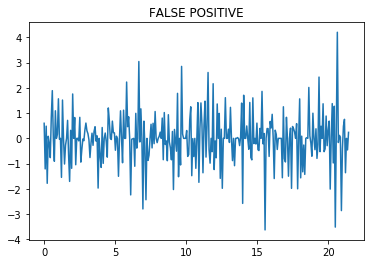

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
345,0.948952,0.182537,132.468516,1.056,3.341,73.32,0.959,0.78347,1853.0,0.404,0.262,5780.0,1.0,1.0


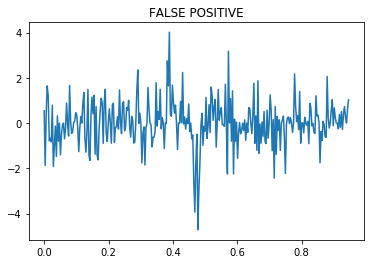

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
416,3.912679,0.148167,133.42885,22.82,53.344,64.31,23.127,187.57475,1018.0,0.335,0.306,5616.0,0.72,0.675


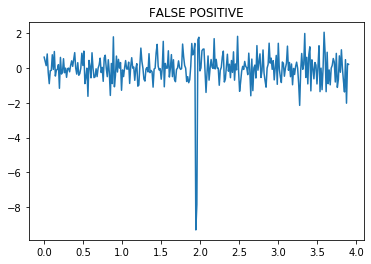

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
452,1.015044,0.458083,131.56407,0.016,1.013,13.85,0.984,0.01909,1979.0,0.351,0.289,5910.0,1.124,0.959


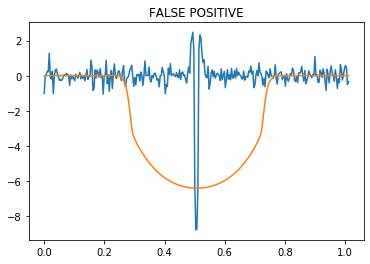

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
521,2.8811,0.393278,134.238752,1.213,5.004,80.47,0.829,0.28558,2946.0,0.303,0.272,8104.0,3.369,1.957


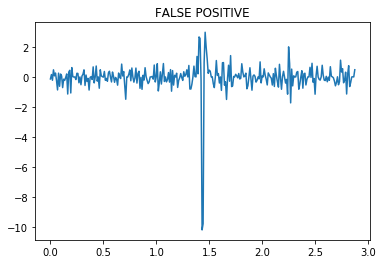

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
527,1.085965,0.4465,132.006611,0.113,1.09,32.81,0.916,0.02078,6297.0,0.128,0.249,15896.0,2.404,2.995


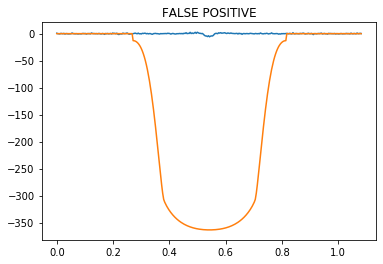

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
544,0.983762,0.418833,132.28418,0.022,1.02,7.83,1.01,0.02072,4203.0,0.292,0.304,6431.0,5.294,1.932


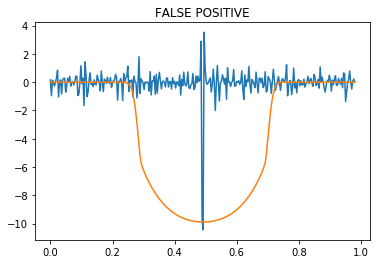

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
888,6.282033,0.349071,131.590793,1.359,9.107,78.75,1.777,0.36209,1029.0,0.334,0.296,6074.0,0.976,0.979


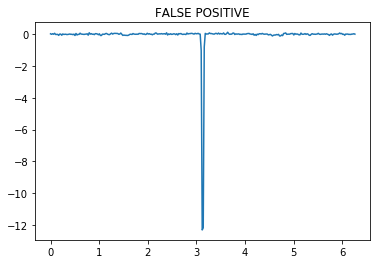

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
904,16.025019,0.161783,367.693328,12.407,68.0,78.78,13.239,23.188,657.0,0.356,0.286,5776.0,0.789,0.879


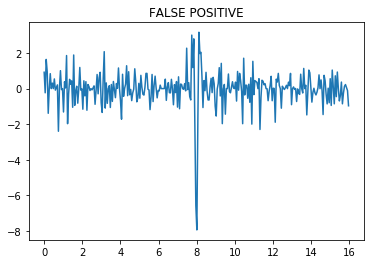

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
925,13.995854,0.209617,131.65924,1.248,17.45,83.1,2.095,0.51338,1202.0,0.33,0.292,5638.0,2.703,1.055


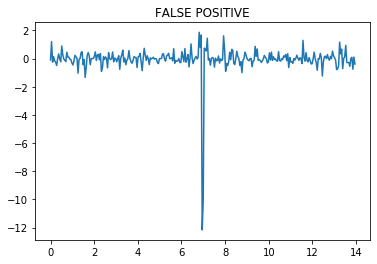

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1002,1.46127,0.686125,131.78154,0.357,1.352,17.61,1.288,0.02188,1253.0,0.454,0.234,5226.0,0.674,0.743


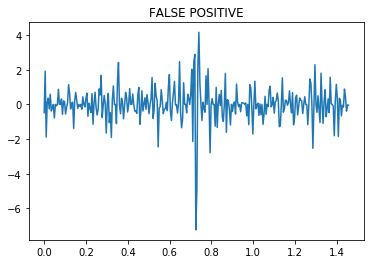

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1023,3.722404,0.105058,133.56824,1.653,13.54,79.9,2.375,3.39206,1082.0,0.356,0.286,5747.0,0.799,0.811


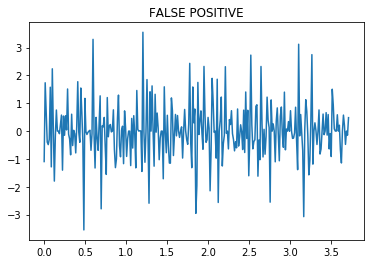

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1169,2.112396,0.115475,134.034448,1.055,9.48,82.21,1.285,3.60688,1419.0,0.404,0.262,5780.0,1.0,1.0


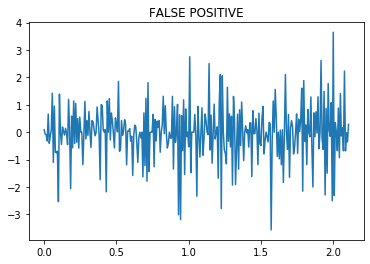

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1222,1.878877,0.27537,133.074198,1.099,4.64,84.55,0.441,0.53539,1846.0,0.287,0.307,6569.0,1.235,1.06


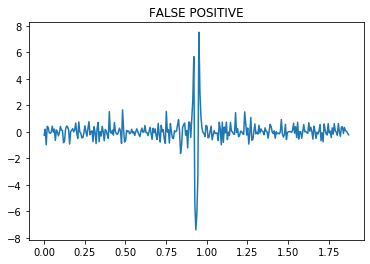

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1253,2.086076,0.100133,133.416141,12.633,22.1,52.67,13.376,46.65963,1645.0,0.324,0.298,6124.0,1.119,0.839


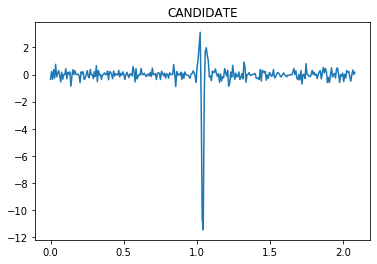

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1264,1.120998,0.468458,131.48486,0.126,1.124,7.67,1.114,0.02138,3992.0,0.271,0.322,6720.0,4.845,2.02


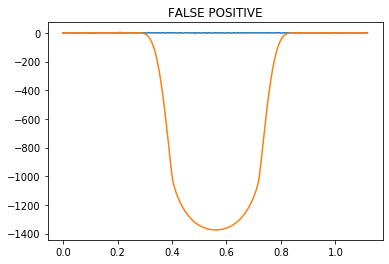

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1375,2.302365,0.995,132.4231,0.47,1.457,40.96,1.1,0.01104,1568.0,0.359,0.287,5948.0,1.229,1.025


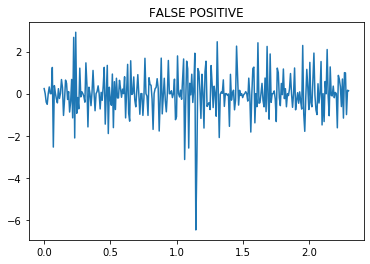

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1495,49.266785,0.23205,191.187887,7.446,79.6,83.97,8.364,3.92515,538.0,0.381,0.28,5988.0,1.143,1.152


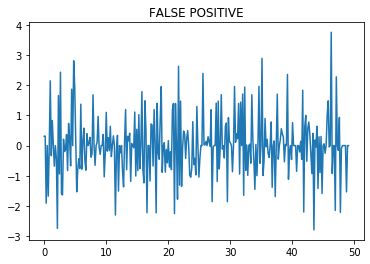

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1556,3.215591,0.677542,133.5375,0.166,1.163,7.81,1.153,0.00288,1366.0,0.307,0.306,6300.0,1.036,1.012


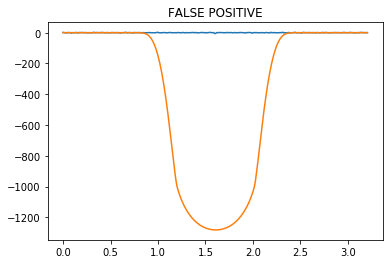

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1557,1.615605,0.60625,131.4952,0.196,1.154,5.58,1.149,0.01114,2202.0,0.274,0.319,6770.0,1.623,1.365


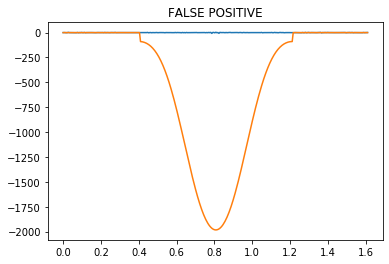

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1604,4.35046,0.105317,132.27239,3.448,19.59,77.61,4.203,7.51067,1472.0,0.289,0.31,6585.0,1.416,1.185


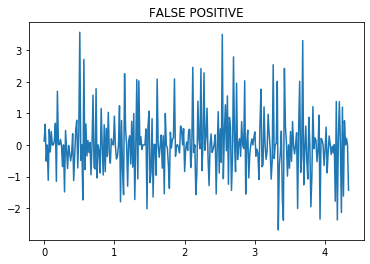

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1632,6.195862,0.108658,134.23422,2.432,11.31,72.61,3.38,0.71239,883.0,0.434,0.243,5608.0,0.813,0.909


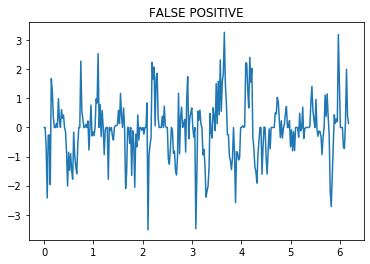

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1646,0.656201,0.174125,132.09943,1.034,2.416,53.45,1.439,0.61974,2157.0,0.359,0.287,6025.0,0.999,1.08


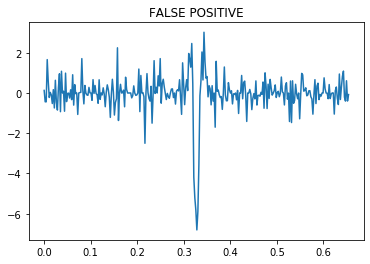

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1666,3.35021,0.184722,131.838052,8.829,14.16,46.93,9.666,4.78071,1656.0,0.273,0.318,6657.0,1.501,1.255


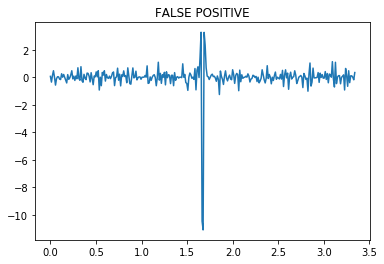

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1701,3.735993,0.728654,135.062493,1.29,3.723,74.53,0.993,0.06991,2063.0,0.41,0.259,5467.0,4.055,1.62


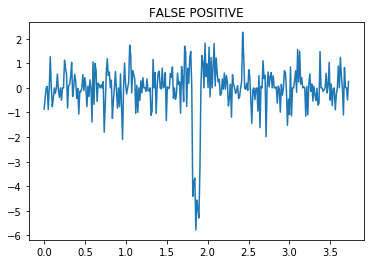

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1826,0.638698,0.215037,131.755665,1.258,2.396,42.83,1.757,0.63758,2464.0,0.3,0.314,6424.0,1.18,1.242


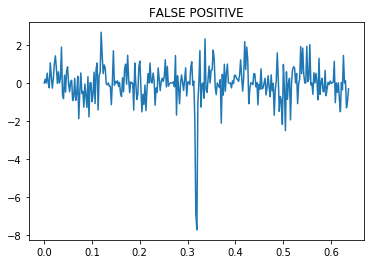

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1932,15.852311,0.202946,142.52451,6.222,88.7,85.93,6.286,52.4597,725.0,0.404,0.262,5780.0,1.0,1.0


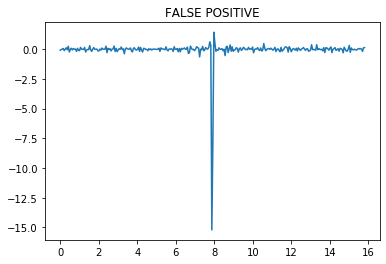

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2008,24.328225,0.256583,141.05149,3.452,15.06,72.91,4.426,0.10913,520.0,0.497,0.204,5286.0,0.78,0.872


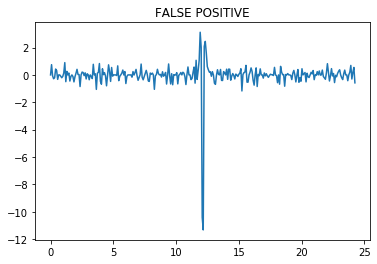

Error in elliptic integral function RC().


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2104,4.182244,0.258708,134.0885,0.01,1.436,46.42,0.99,0.0032,1206.0,0.324,0.298,6057.0,0.999,0.896


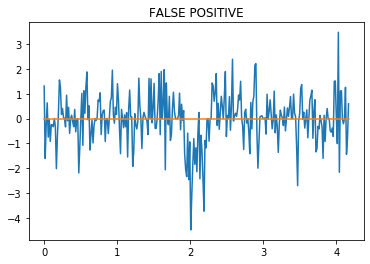

Error in elliptic integral function RC().


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2223,34.650637,0.428625,143.0279,0.027,8.5,83.42,0.973,0.00966,1191.0,0.271,0.322,6681.0,4.185,1.866


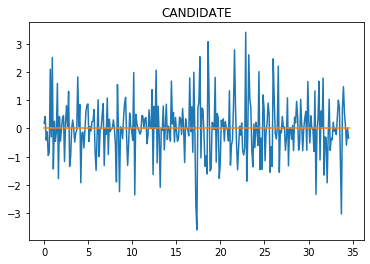

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2292,3.343285,1.137083,134.8451,0.221,1.218,6.71,1.21,0.00306,2094.0,0.293,0.31,6541.0,2.652,1.519


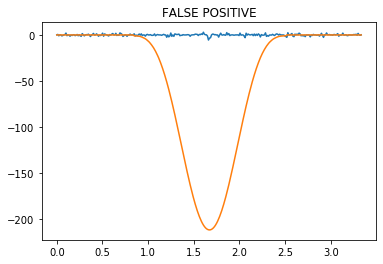

Object does not transit the star.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2297,0.875197,0.002167,131.813592,0.004,2.175,62.52,1.004,0.25417,2518.0,0.413,0.26,5855.0,1.796,1.174


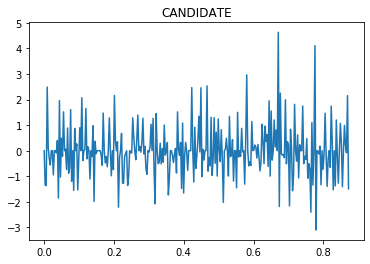

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2299,1.739429,0.103725,354.889074,3.316,5.93,44.32,4.246,1.30666,1268.0,0.421,0.252,5415.0,0.742,0.806


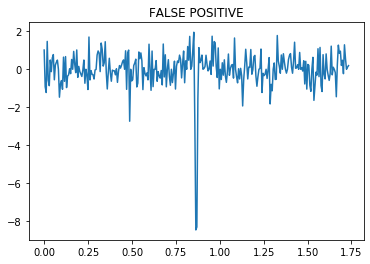

Error in elliptic integral function RC().


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2360,1.906633,0.128438,170.064102,0.02,1.671,54.12,0.98,0.02429,1847.0,0.273,0.317,6736.0,1.243,1.224


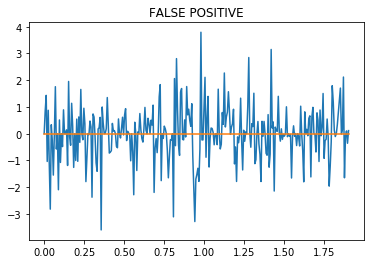

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2436,5.063188,0.578804,133.707285,3.68,9.761,69.62,3.4,0.68622,908.0,0.454,0.234,5375.0,0.752,0.7


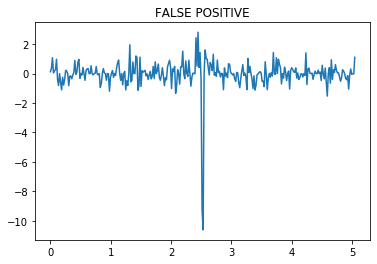

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2586,2.401752,0.086813,133.711919,4.418,12.96,66.1,5.25,7.13655,888.0,0.574,0.155,4577.0,0.557,0.552


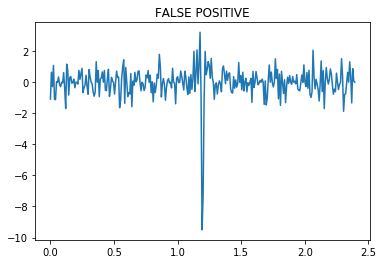

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2591,15.873381,0.335121,143.859941,3.047,32.0,83.8,3.454,2.45958,962.0,0.437,0.243,5622.0,1.895,1.056


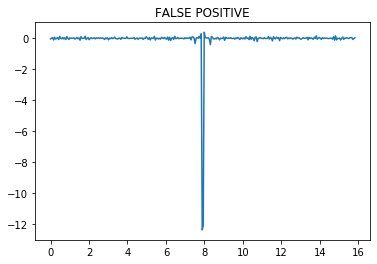

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2629,14.541781,0.379796,144.269401,21.721,58.7,67.71,22.28,18.12216,834.0,0.345,0.292,5997.0,1.148,0.968


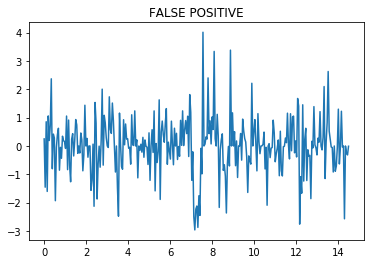

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2785,4.320693,2.111667,131.8905,0.015,1.015,16.66,0.973,0.00106,1205.0,0.319,0.302,6225.0,1.031,1.091


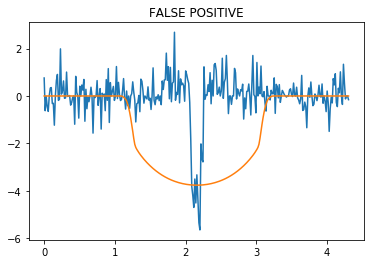

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2815,2.080432,0.312487,131.827995,1.497,5.281,81.6,0.771,0.64364,2719.0,0.281,0.28,8344.0,2.115,1.79


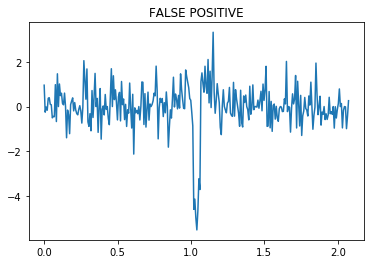

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2816,2.080434,0.321167,131.827041,4.178,5.43,19.79,5.106,0.69851,1629.0,0.295,0.31,6377.0,1.119,1.147


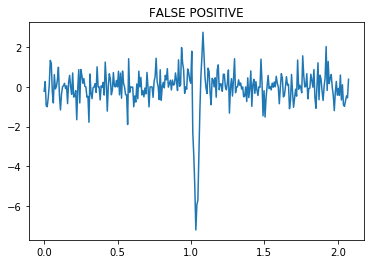

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3122,16.662167,0.161508,142.186468,6.607,52.0,81.76,7.444,9.55468,834.0,0.297,0.312,6440.0,1.169,1.196


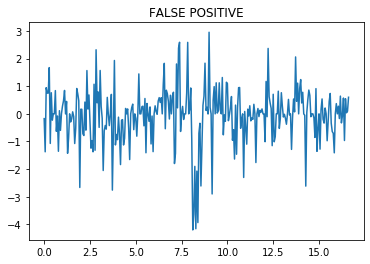

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3155,7.702374,0.160246,137.563452,2.485,15.32,77.38,3.346,1.14611,825.0,0.442,0.24,5598.0,0.83,0.928


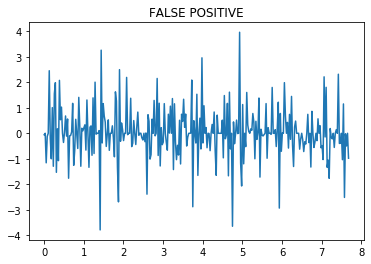

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3299,0.566796,0.216417,131.8335,0.013,1.006,12.68,0.981,0.05994,2411.0,0.315,0.303,6319.0,1.032,1.084


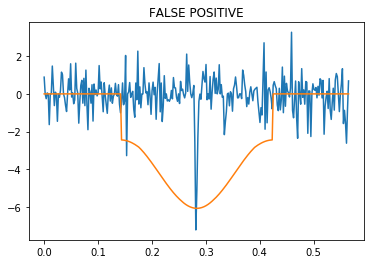

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3301,0.566797,0.227958,131.83811,0.016,1.008,14.79,0.974,0.06025,931.0,0.357,0.366,3453.0,0.358,0.364


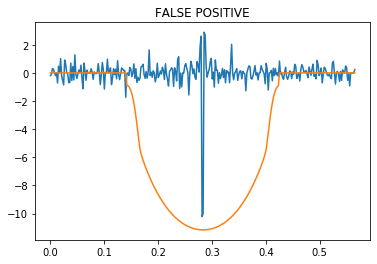

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3387,0.566795,0.183292,131.84569,0.01,1.009,15.15,0.974,0.06052,2457.0,0.286,0.312,6395.0,1.049,1.094


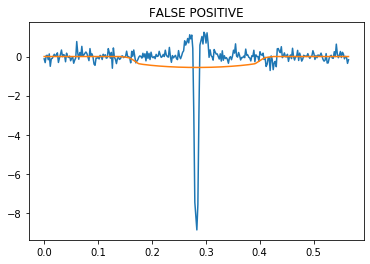

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3421,33.937542,0.465321,147.182401,1.188,21.75,84.78,1.979,0.16909,618.0,0.319,0.302,6220.0,1.066,1.07


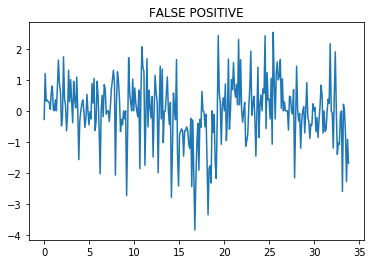

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3441,29.015853,0.299935,138.402477,11.513,83.4,81.57,12.223,13.01865,592.0,0.373,0.279,5783.0,0.941,0.841


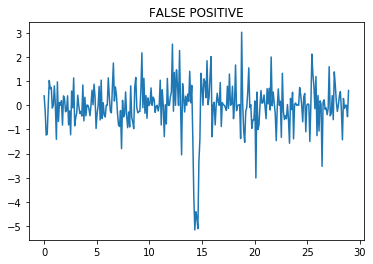

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3520,6.9981,0.085367,171.898913,6.503,38.6,79.0,7.361,22.19119,853.0,0.442,0.24,5612.0,0.829,0.926


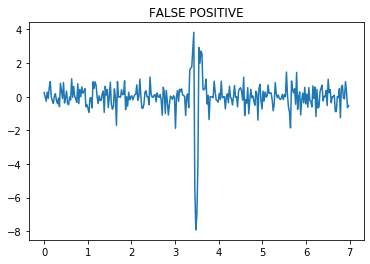

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3525,0.566811,0.257917,131.80761,0.018,1.01,13.58,0.982,0.06071,1921.0,0.398,0.267,5593.0,0.752,0.791


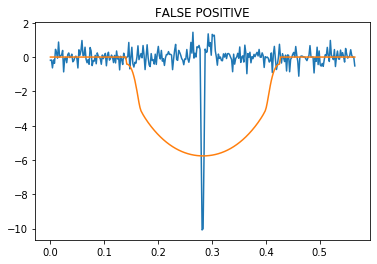

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3718,44.827324,0.285876,173.410349,1.198,80.48,88.94,1.494,4.90797,779.0,0.495,0.208,5160.0,3.279,1.45


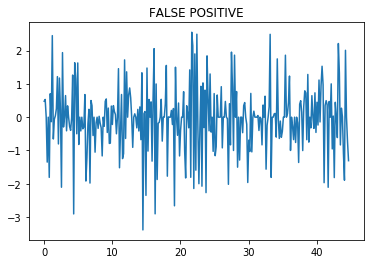

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3816,2.947377,0.087129,171.522978,1.654,3.92,47.65,2.641,0.13115,2404.0,0.258,0.309,8090.0,2.234,1.828


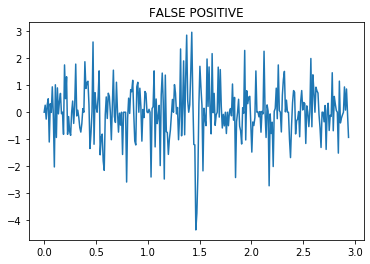

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3865,2.37159,0.146317,132.743293,1.344,8.79,79.15,1.653,2.28086,1043.0,0.389,0.279,5340.0,0.601,0.685


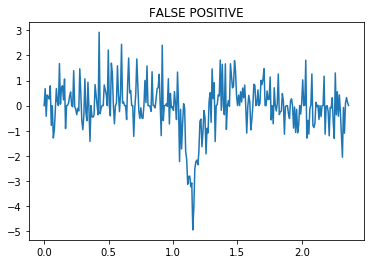

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3922,17.794005,0.170458,365.34666,2.741,13.61,74.13,3.72,0.1505,762.0,0.319,0.302,6273.0,1.044,1.099


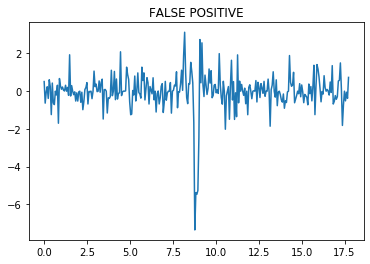

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3942,121.599128,0.63165,137.27469,4.104,59.6,85.18,5.011,0.27145,358.0,0.324,0.298,6036.0,0.847,0.931


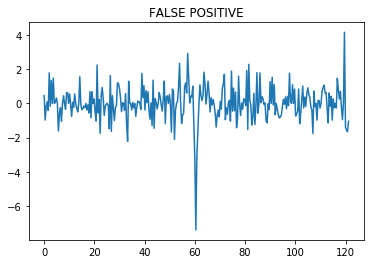

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3956,2.113203,0.146808,356.32832,2.217,3.92,35.77,3.178,0.25469,1281.0,0.442,0.24,5482.0,0.858,0.853


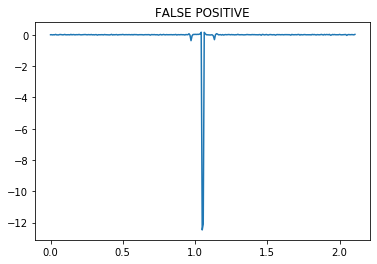

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4041,7.226944,0.95885,136.163008,1.601,5.79,77.71,1.233,0.07032,1179.0,0.315,0.302,6270.0,1.36,1.064


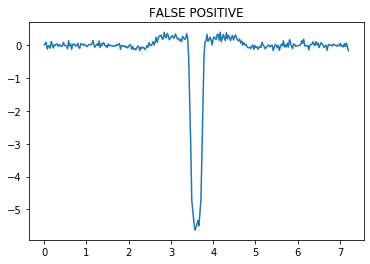

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4074,0.655095,0.256625,131.78278,0.239,1.236,9.25,1.22,0.08327,2173.0,0.366,0.284,6063.0,1.012,1.117


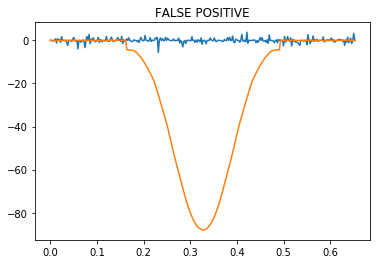

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4204,46.840086,0.159158,164.134422,3.72,75.4,86.47,4.652,3.7023,552.0,0.324,0.298,6006.0,1.055,0.867


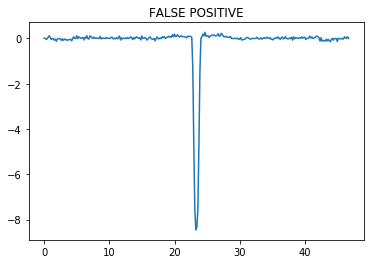

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4262,3.607274,0.586838,133.77548,1.137,4.29,83.8,0.463,0.11474,1833.0,0.253,0.326,7026.0,1.785,1.36


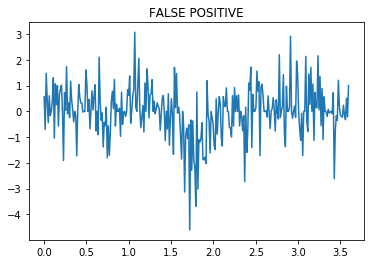

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4345,35.516192,0.104167,165.930432,7.565,140.2,86.54,8.467,41.31467,504.0,0.442,0.24,5514.0,0.871,0.883


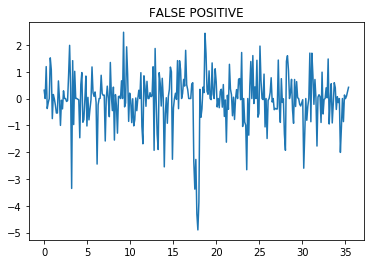

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4401,16.371987,0.160204,172.75926,8.359,34.5,74.37,9.303,2.90473,438.0,0.622,0.117,4187.0,0.592,0.58


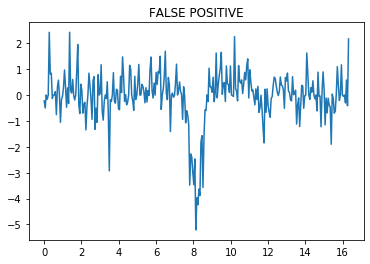

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4716,85.340926,0.442254,386.211642,12.009,152.2,85.18,12.773,9.15013,409.0,0.334,0.296,6004.0,0.898,0.978


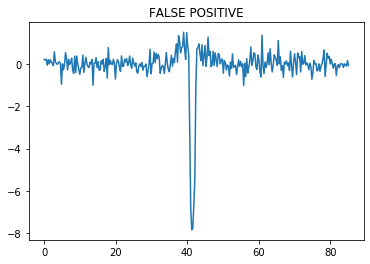

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4736,20.84992,0.573696,137.558835,13.443,54.22,75.35,13.715,6.93637,1099.0,0.239,0.334,7355.0,1.984,1.581


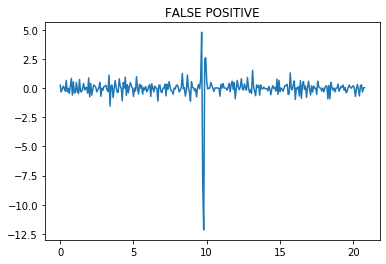

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4958,2.617281,0.402542,132.391963,2.696,3.85,18.64,3.651,0.15801,1689.0,0.289,0.31,6432.0,1.345,1.06


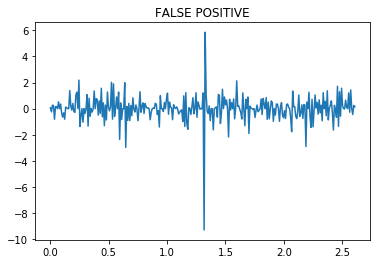

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5071,2.34748,1.09375,133.67205,0.487,1.473,44.47,1.051,0.01098,1502.0,0.351,0.289,5891.0,1.138,0.953


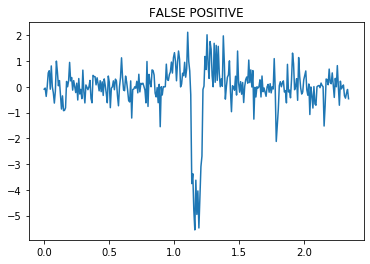

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5092,5.888835,0.158283,173.582863,5.354,16.76,68.22,6.217,2.56681,1008.0,0.404,0.262,5780.0,1.0,1.0


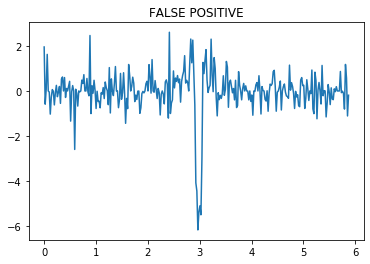

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5113,1.576587,0.6325,132.4469,0.046,1.044,5.26,1.04,0.00867,2946.0,0.27,0.323,6742.0,3.138,1.752


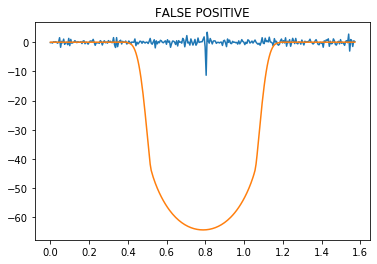

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5252,1.811461,0.350976,132.932453,1.128,3.695,85.2,0.309,0.29091,3438.0,0.267,0.28,8572.0,3.034,2.009


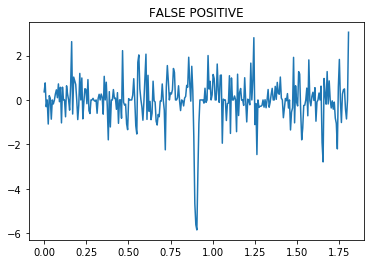

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5256,2.174915,0.351742,131.93954,1.084,4.085,79.86,0.719,0.27267,2009.0,0.274,0.319,6792.0,1.636,1.364


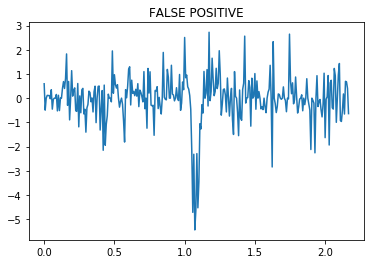

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5401,15.926991,0.479758,144.452622,1.323,19.921,86.06,1.368,0.58954,566.0,0.389,0.279,5191.0,0.65,0.635


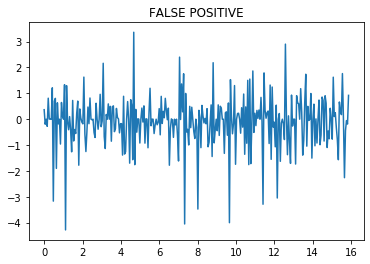

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5413,0.645852,0.082352,131.889136,1.011,4.4,75.01,1.138,3.86401,1234.0,0.334,0.325,4399.0,0.463,0.48


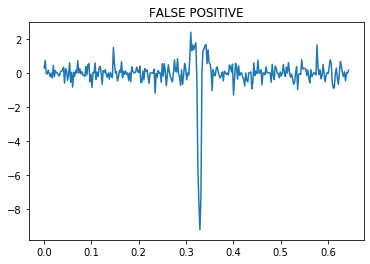

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5620,4.309067,0.092083,134.71445,1.177,13.2,81.32,1.993,2.34533,882.0,0.575,0.15,4897.0,0.789,0.761


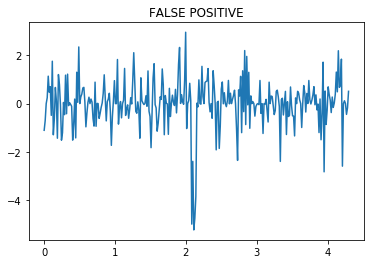

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5692,1.247157,0.111579,132.36584,24.663,30.4,34.03,25.224,342.90933,4120.0,0.594,0.139,4770.0,9.67,1.373


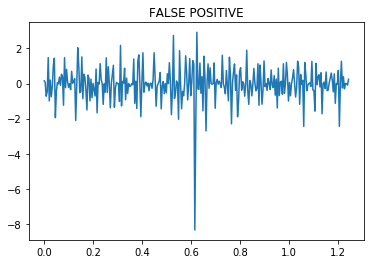

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5715,3.55651,0.530683,133.522192,1.069,4.411,81.9,0.622,0.12838,2353.0,0.298,0.28,8105.0,2.433,1.868


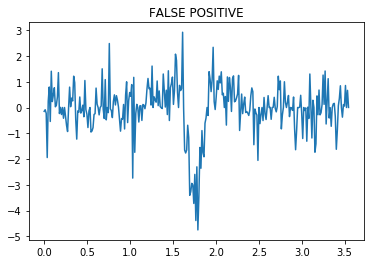

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5726,2.332115,0.123635,132.19683,1.174,8.0,77.38,1.747,1.77772,1594.0,0.287,0.307,6384.0,1.094,0.97


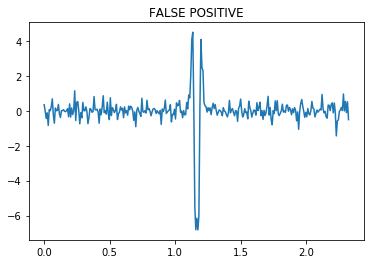

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5727,3.661896,1.484892,132.531674,2.16,3.178,21.39,2.959,0.04528,1708.0,0.277,0.309,6793.0,1.589,1.162


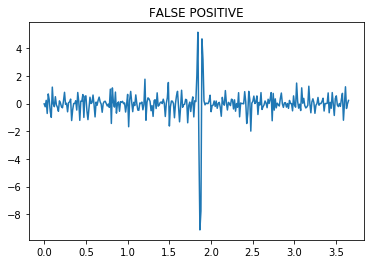

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5805,20.427232,0.144345,135.862807,4.912,98.0,86.78,5.499,42.61535,749.0,0.319,0.302,6167.0,1.121,1.032


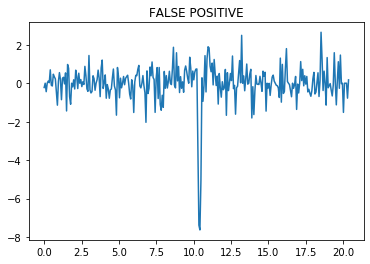

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5895,4.394518,0.123029,133.62094,1.247,18.41,85.12,1.566,6.11196,554.0,0.316,0.387,3695.0,0.483,0.504


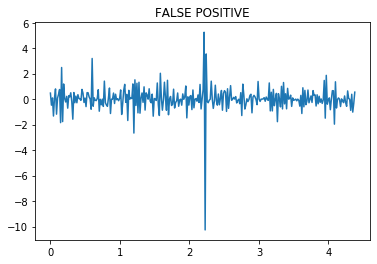

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5913,2.53021,0.907917,132.0918,0.293,1.288,8.13,1.275,0.00631,1543.0,0.382,0.274,5780.0,1.296,0.924


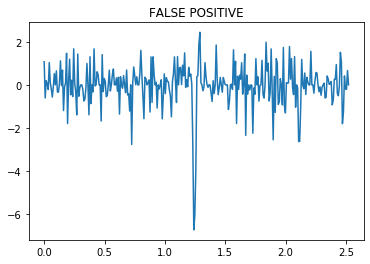

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6332,1.096587,0.126196,132.51421,1.64,2.75,17.79,2.623,0.32884,1726.0,0.41,0.26,5869.0,0.942,1.054


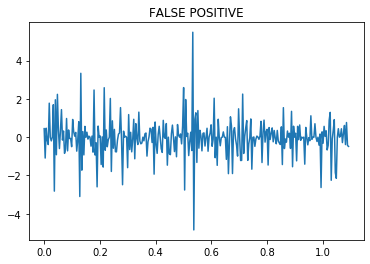

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6436,158.348345,0.439583,260.2924,2.676,45.2,85.36,3.655,0.06954,409.0,0.303,0.316,6521.0,1.276,1.334


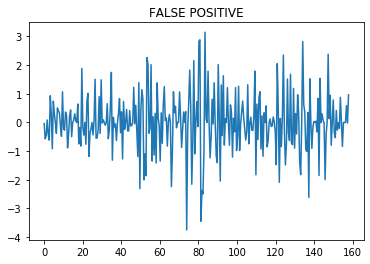

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6462,7.061151,0.147792,169.86425,1.856,7.02,66.27,2.824,0.13121,886.0,0.386,0.271,5795.0,0.848,0.938


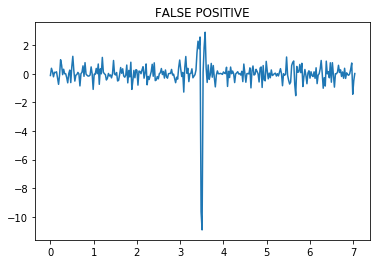

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6491,9.726754,0.817558,139.47635,3.746,5.62,33.72,4.676,0.03551,1363.0,0.317,0.303,6327.0,2.433,1.495


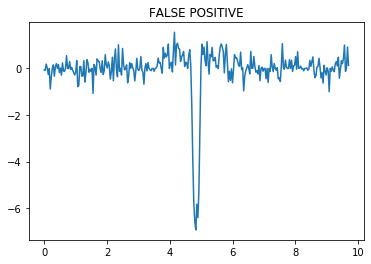

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6492,9.726749,0.808721,139.477464,1.807,8.274,76.84,1.883,0.11328,997.0,0.437,0.243,5618.0,1.406,0.922


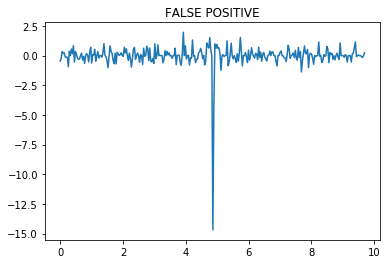

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6511,9.296746,0.286695,135.68564,1.271,16.509,84.36,1.623,0.98482,1552.0,0.289,0.312,6461.0,2.884,1.418


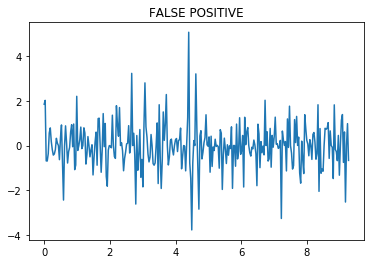

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6628,11.521446,0.151663,170.839688,1.625,20.75,83.13,2.483,1.27376,753.0,0.386,0.271,5795.0,0.848,0.938


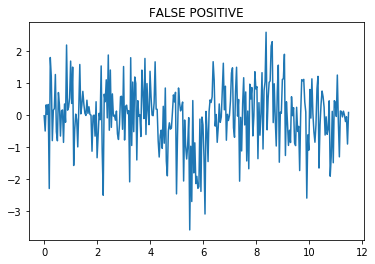

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6753,1.427966,0.536054,132.604851,0.396,1.383,19.36,1.305,0.02454,1637.0,0.334,0.296,6099.0,0.919,1.0


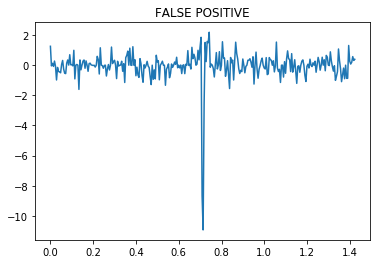

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6757,0.948086,0.334583,131.93348,0.121,1.12,9.31,1.105,0.02954,3359.0,0.273,0.329,6875.0,2.856,1.868


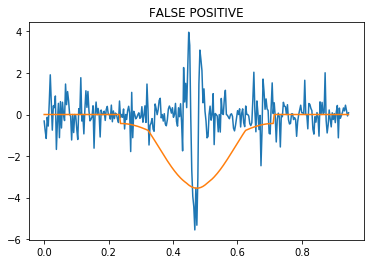

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6901,3.371797,0.143421,134.876289,3.075,19.04,80.26,3.219,11.47624,1155.0,0.434,0.243,5615.0,0.912,0.865


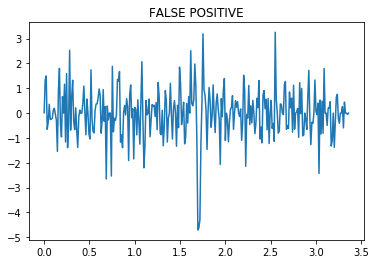

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7030,0.668483,0.100538,132.156558,1.271,4.754,80.64,0.773,4.54953,2082.0,0.404,0.262,5780.0,1.0,1.0


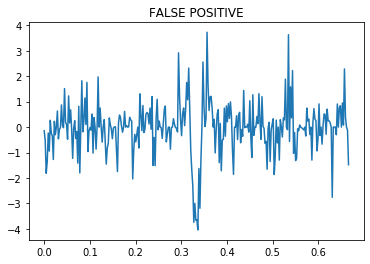

Star-crossing orbit.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7054,3.213185,0.644583,132.044475,0.05,1.019,24.96,0.924,0.00194,1710.0,0.271,0.318,6712.0,1.513,1.206


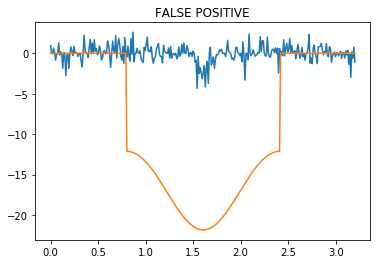

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7138,3.269177,0.113471,133.257825,1.485,10.93,78.42,2.195,2.31211,1349.0,0.307,0.306,6372.0,1.015,1.066


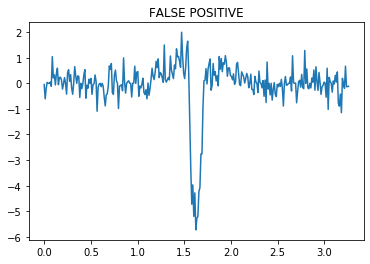

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7204,8.344105,0.075058,361.839209,9.139,49.2,78.22,10.047,32.39087,785.0,0.46,0.229,5447.0,0.838,0.928


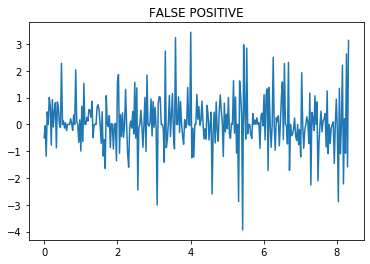

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7410,4.053254,0.16715,134.744552,14.708,30.7,60.02,15.329,33.23987,1191.0,0.366,0.284,6022.0,1.039,1.116


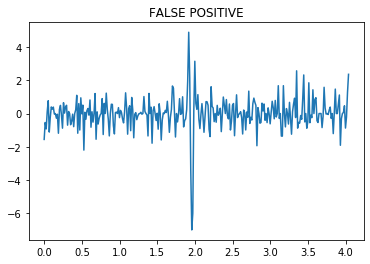

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7546,8.42809,0.078375,358.303469,5.886,40.4,80.33,6.787,17.59264,817.0,0.373,0.279,5761.0,0.805,0.893


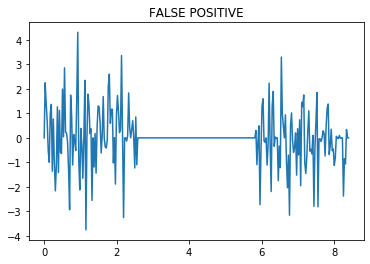

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7854,6.096031,0.768879,135.030891,1.384,5.984,83.84,0.642,0.1091,1925.0,0.219,0.342,7598.0,2.692,1.945


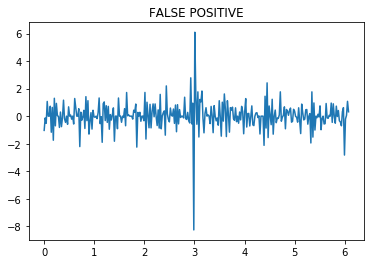

Error in elliptic integral function RC().


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7860,5.937206,0.203417,171.57597,0.024,3.033,71.23,0.976,0.01497,894.0,0.312,0.308,5857.0,0.712,0.802


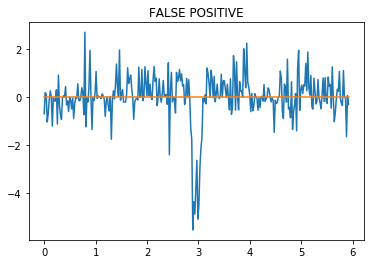

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7861,5.937177,0.223125,135.95682,5.442,13.66,62.62,6.282,1.36751,1005.0,0.404,0.262,5780.0,1.0,1.0


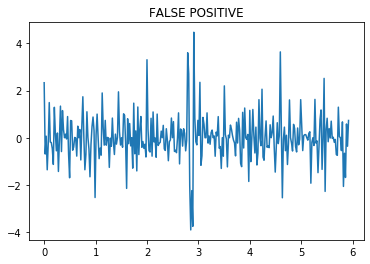

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7868,0.865959,0.079408,132.053694,2.821,8.58,69.06,3.068,15.96065,1162.0,0.221,0.4,4561.0,0.469,0.492


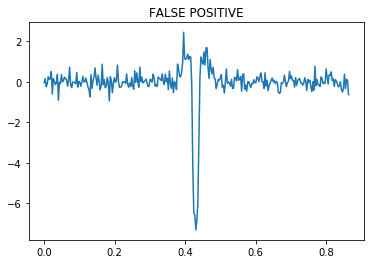

Bad value for ``RpRs``.


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7952,17.907665,0.232772,139.743761,2.488,51.36,86.89,2.79,7.99211,746.0,0.324,0.303,6173.0,1.041,1.104


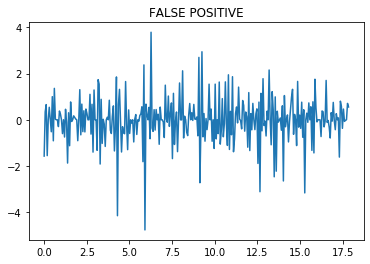

CPU times: user 35 s, sys: 630 ms, total: 35.6 s
Wall time: 34.8 s


In [45]:
%%time
for i in range(df_meta.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    ## LOAD ALL METADATA TO SIMULATE
    period = metadata_n["Period"]
    duration = metadata_n["Duration"]/24
    a_R = metadata_n["a/R"]
    t_0 = t_glo[int(np.round(T/2))] #trabajando con folds.. #metadata_n["Time of Transit Epoch"]-t[0] #start on 0
    r_R = metadata_n["r/R"]
    
    #https://slideplayer.com/slide/6301069/21/images/7/Finally%2C+finding+transit+duration..jpg
    # con a y b se puede obtener la inclinacion..
    impact_p = metadata_n["Impact Parameter"] #bcirc: circular impact parameter
    inclination = metadata_n["Inclination"]
    
    u1 = metadata_n["Limb Darkening Coeff1"]
    u2 = metadata_n["Limb Darkening Coeff2"]
    
    #build model
    model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, bcirc=impact_p,
                       maxpts=100000)
    try:
        lc_simulated = model(t_glo) #primer error/contratiempo encontrado (TIEMPO)
    except Exception as e:
        print(e)
        display(pd.DataFrame(metadata_n).T)
        model = QuadraticModel()
        model.set_data(t_glo)
    
        lc_simulated = model.evaluate_ps(k = r_R, t0=t_0, p=period, a=a_R, i=inclination, e=0, ldc=[u1, u2])-1
        
        plt.plot(t_glo, X_train[i,:,0])
        plt.plot(t_glo, lc_simulated*S_train[i])
        plt.title(df_meta.iloc[i]["NExScI Disposition"])
        plt.show()
        continue
    #    print("ERROR, CURVA ELIMINADO DE INMEDIATO")

Tipo de errores (Son todos Falsos o candidatos):
* *Bad value for ``RpRs`*: radio de planeta sobre radio estrella mayor a 1 (planeta mas grande que estrella)
* *Error in elliptic integral function RC()*: Error numérico en 
    * Carlson's degenerate elliptic integral
        (C) Copr. 1986-92 Numerical Recipes Software "U,6VV'.
* *Star-crossing orbit*: Si el radio del planeta + 1 (radio de estrella) es mayor al semi major axis (distancia planeta-estrella) -- orbita se cruza con la estrella? 
* *Object does not transit the star*: ? quizas en los tiempos de modelación no alcanza a aparecer un tránsito (tránsito muy rápido, con tiempo corto)

In [27]:
%%time

for i in range(df_meta.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    ## LOAD ALL METADATA TO SIMULATE
    period = metadata_n["Period"]
    duration = metadata_n["Duration"]/24
    a_R = metadata_n["a/R"]
    t_0 = t_glo[int(np.round(T/2))] #trabajando con folds.. #metadata_n["Time of Transit Epoch"]-t[0] #start on 0
    r_R = metadata_n["r/R"]
    
    #https://slideplayer.com/slide/6301069/21/images/7/Finally%2C+finding+transit+duration..jpg
    # con a y b se puede obtener la inclinacion..
    impact_p = metadata_n["Impact Parameter"] #bcirc: circular impact parameter
    inclination = metadata_n["Inclination"]
    
    u1 = metadata_n["Limb Darkening Coeff1"]
    u2 = metadata_n["Limb Darkening Coeff2"]
    
    #build model
    model = QuadraticModel()
    model.set_data(t_glo)
    
    try:
        lc_simulated = model.evaluate_ps(k = r_R, t0=t_0, p=period, a=a_R, i=inclination, e=0, ldc=[u1, u2])
    except Exception as e:
        print(e)
        plt.plot(t_glo, X_train[i,:,0])
        plt.show()
        continue

CPU times: user 10min 7s, sys: 9.53 s, total: 10min 16s
Wall time: 19min 12s


In [120]:
%%time

for i in range(df_meta.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    ## LOAD ALL METADATA TO SIMULATE
    period = metadata_n["Period"]
    duration = metadata_n["Duration"]/24
    a_R = metadata_n["a/R"]
    t_0 = t_glo[int(np.round(T/2))] #trabajando con folds.. #metadata_n["Time of Transit Epoch"]-t[0] #start on 0
    r_R = metadata_n["r/R"]
    
    #https://slideplayer.com/slide/6301069/21/images/7/Finally%2C+finding+transit+duration..jpg
    # con a y b se puede obtener la inclinacion..
    impact_p = metadata_n["Impact Parameter"] #bcirc: circular impact parameter
    inclination = metadata_n["Inclination"]
    
    u1 = metadata_n["Limb Darkening Coeff1"]
    u2 = metadata_n["Limb Darkening Coeff2"]
    
    #build model
    params = batman.TransitParams()       #object to store transit parameters
    params.t0 = t_0                        #time of inferior conjunction
    params.per = period                       #orbital period
    params.rp = r_R                      #planet radius (in units of stellar radii)--rp/rs
    params.a = a_R                     #semi-major axis (in units of stellar radii) -- el que tengo es AU
    params.inc = inclination                      #orbital inclination (in degrees)
    params.limb_dark = "quadratic"        #limb darkening model
    params.u = [u1, u2]      #limb darkening coefficients [u1, u2, u3, u4]

    #dont known in kepler
    #params.ecc = 0.                       #eccentricity
    #params.w = 90.                        #longitude of periastron (in degrees)

    m = batman.TransitModel(params, t_glo, nthreads = 4)    #initializes model
    try:
        lc_simulated = m.light_curve(params)
    except Exception as e:
        print(e)
        plt.plot(t_glo, X_train[i,:,0])
        plt.show()
        continue

Exception: OpenMP not enabled: do not set the nthreads parameter

In [31]:
X_MA = []

for i in range(df_meta.shape[0]):
    #load time to simulate
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    ## LOAD ALL METADATA TO SIMULATE
    period = metadata_n["Period"]
    duration = metadata_n["Duration"]/24
    a_R = metadata_n["a/R"]
    t_0 = t_glo[int(np.round(T/2))] #trabajando con folds global ... #metadata_n["Time of Transit Epoch"]
    r_R = metadata_n["r/R"]
    
    #https://slideplayer.com/slide/6301069/21/images/7/Finally%2C+finding+transit+duration..jpg
    # con a y b se puede obtener la inclinacion..
    impact_p = metadata_n["Impact Parameter"] #bcirc: circular impact parameter
    inclination = metadata_n["Inclination"]
    
    u1 = metadata_n["Limb Darkening Coeff1"]
    u2 = metadata_n["Limb Darkening Coeff2"]
    
    #build model
    model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, bcirc=impact_p,
                       maxpts=65000)
    try:
        lc_simulated = model(t_glo) 
    except:
        print("ERROR GENERACION DE CURVA")
        display(pd.DataFrame(metadata_n).T)
        lc_simulated = np.ones(len(t_glo))
    X_MA.append(lc_simulated -1)
    
X_MA = np.asarray(X_MA)
X_MA.shape

ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6,0.539366,0.226417,131.97457,0.016,1.012,12.57,0.988,0.06737,5016.0,0.314,0.304,6341.0,5.302,2.05


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
62,2.283466,0.324996,132.34883,1.166,4.917,84.66,0.457,0.43124,2014.0,0.273,0.318,6723.0,1.719,1.327


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
72,2.43574,0.927083,133.47404,0.127,1.105,25.56,0.997,0.0043,2102.0,0.235,0.338,7239.0,1.781,1.558


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
84,1.404692,0.26097,131.552084,1.068,3.642,80.56,0.597,0.46311,2263.0,0.328,0.306,6230.0,1.863,1.396


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
110,7.453067,0.198404,131.76434,9.563,28.0,68.35,10.337,7.4908,932.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
190,0.922256,0.176125,131.8088,0.008,1.042,17.8,0.992,0.02514,2206.0,0.413,0.26,5631.0,1.485,1.046


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
194,21.513523,3.249292,132.3356,1.475,2.6,20.29,2.441,0.00072,1006.0,0.547,0.171,5088.0,3.318,1.294


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
345,0.948952,0.182537,132.468516,1.056,3.341,73.32,0.959,0.78347,1853.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
416,3.912679,0.148167,133.42885,22.82,53.344,64.31,23.127,187.57475,1018.0,0.335,0.306,5616.0,0.72,0.675


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
452,1.015044,0.458083,131.56407,0.016,1.013,13.85,0.984,0.01909,1979.0,0.351,0.289,5910.0,1.124,0.959


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
521,2.8811,0.393278,134.238752,1.213,5.004,80.47,0.829,0.28558,2946.0,0.303,0.272,8104.0,3.369,1.957


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
527,1.085965,0.4465,132.006611,0.113,1.09,32.81,0.916,0.02078,6297.0,0.128,0.249,15896.0,2.404,2.995


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
544,0.983762,0.418833,132.28418,0.022,1.02,7.83,1.01,0.02072,4203.0,0.292,0.304,6431.0,5.294,1.932


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
888,6.282033,0.349071,131.590793,1.359,9.107,78.75,1.777,0.36209,1029.0,0.334,0.296,6074.0,0.976,0.979


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
904,16.025019,0.161783,367.693328,12.407,68.0,78.78,13.239,23.188,657.0,0.356,0.286,5776.0,0.789,0.879


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
925,13.995854,0.209617,131.65924,1.248,17.45,83.1,2.095,0.51338,1202.0,0.33,0.292,5638.0,2.703,1.055


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1002,1.46127,0.686125,131.78154,0.357,1.352,17.61,1.288,0.02188,1253.0,0.454,0.234,5226.0,0.674,0.743


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1023,3.722404,0.105058,133.56824,1.653,13.54,79.9,2.375,3.39206,1082.0,0.356,0.286,5747.0,0.799,0.811


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1169,2.112396,0.115475,134.034448,1.055,9.48,82.21,1.285,3.60688,1419.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1222,1.878877,0.27537,133.074198,1.099,4.64,84.55,0.441,0.53539,1846.0,0.287,0.307,6569.0,1.235,1.06


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1253,2.086076,0.100133,133.416141,12.633,22.1,52.67,13.376,46.65963,1645.0,0.324,0.298,6124.0,1.119,0.839


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1264,1.120998,0.468458,131.48486,0.126,1.124,7.67,1.114,0.02138,3992.0,0.271,0.322,6720.0,4.845,2.02


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1375,2.302365,0.995,132.4231,0.47,1.457,40.96,1.1,0.01104,1568.0,0.359,0.287,5948.0,1.229,1.025


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1495,49.266785,0.23205,191.187887,7.446,79.6,83.97,8.364,3.92515,538.0,0.381,0.28,5988.0,1.143,1.152


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1556,3.215591,0.677542,133.5375,0.166,1.163,7.81,1.153,0.00288,1366.0,0.307,0.306,6300.0,1.036,1.012


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1557,1.615605,0.60625,131.4952,0.196,1.154,5.58,1.149,0.01114,2202.0,0.274,0.319,6770.0,1.623,1.365


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1604,4.35046,0.105317,132.27239,3.448,19.59,77.61,4.203,7.51067,1472.0,0.289,0.31,6585.0,1.416,1.185


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1632,6.195862,0.108658,134.23422,2.432,11.31,72.61,3.38,0.71239,883.0,0.434,0.243,5608.0,0.813,0.909


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1646,0.656201,0.174125,132.09943,1.034,2.416,53.45,1.439,0.61974,2157.0,0.359,0.287,6025.0,0.999,1.08


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1666,3.35021,0.184722,131.838052,8.829,14.16,46.93,9.666,4.78071,1656.0,0.273,0.318,6657.0,1.501,1.255


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1701,3.735993,0.728654,135.062493,1.29,3.723,74.53,0.993,0.06991,2063.0,0.41,0.259,5467.0,4.055,1.62


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1826,0.638698,0.215037,131.755665,1.258,2.396,42.83,1.757,0.63758,2464.0,0.3,0.314,6424.0,1.18,1.242


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
1932,15.852311,0.202946,142.52451,6.222,88.7,85.93,6.286,52.4597,725.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2008,24.328225,0.256583,141.05149,3.452,15.06,72.91,4.426,0.10913,520.0,0.497,0.204,5286.0,0.78,0.872


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2104,4.182244,0.258708,134.0885,0.01,1.436,46.42,0.99,0.0032,1206.0,0.324,0.298,6057.0,0.999,0.896


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2223,34.650637,0.428625,143.0279,0.027,8.5,83.42,0.973,0.00966,1191.0,0.271,0.322,6681.0,4.185,1.866


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2292,3.343285,1.137083,134.8451,0.221,1.218,6.71,1.21,0.00306,2094.0,0.293,0.31,6541.0,2.652,1.519


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2297,0.875197,0.002167,131.813592,0.004,2.175,62.52,1.004,0.25417,2518.0,0.413,0.26,5855.0,1.796,1.174


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2299,1.739429,0.103725,354.889074,3.316,5.93,44.32,4.246,1.30666,1268.0,0.421,0.252,5415.0,0.742,0.806


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2360,1.906633,0.128438,170.064102,0.02,1.671,54.12,0.98,0.02429,1847.0,0.273,0.317,6736.0,1.243,1.224


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2436,5.063188,0.578804,133.707285,3.68,9.761,69.62,3.4,0.68622,908.0,0.454,0.234,5375.0,0.752,0.7


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2586,2.401752,0.086813,133.711919,4.418,12.96,66.1,5.25,7.13655,888.0,0.574,0.155,4577.0,0.557,0.552


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2591,15.873381,0.335121,143.859941,3.047,32.0,83.8,3.454,2.45958,962.0,0.437,0.243,5622.0,1.895,1.056


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2629,14.541781,0.379796,144.269401,21.721,58.7,67.71,22.28,18.12216,834.0,0.345,0.292,5997.0,1.148,0.968


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2785,4.320693,2.111667,131.8905,0.015,1.015,16.66,0.973,0.00106,1205.0,0.319,0.302,6225.0,1.031,1.091


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2815,2.080432,0.312487,131.827995,1.497,5.281,81.6,0.771,0.64364,2719.0,0.281,0.28,8344.0,2.115,1.79


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
2816,2.080434,0.321167,131.827041,4.178,5.43,19.79,5.106,0.69851,1629.0,0.295,0.31,6377.0,1.119,1.147


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3122,16.662167,0.161508,142.186468,6.607,52.0,81.76,7.444,9.55468,834.0,0.297,0.312,6440.0,1.169,1.196


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3155,7.702374,0.160246,137.563452,2.485,15.32,77.38,3.346,1.14611,825.0,0.442,0.24,5598.0,0.83,0.928


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3299,0.566796,0.216417,131.8335,0.013,1.006,12.68,0.981,0.05994,2411.0,0.315,0.303,6319.0,1.032,1.084


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3301,0.566797,0.227958,131.83811,0.016,1.008,14.79,0.974,0.06025,931.0,0.357,0.366,3453.0,0.358,0.364


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3387,0.566795,0.183292,131.84569,0.01,1.009,15.15,0.974,0.06052,2457.0,0.286,0.312,6395.0,1.049,1.094


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3421,33.937542,0.465321,147.182401,1.188,21.75,84.78,1.979,0.16909,618.0,0.319,0.302,6220.0,1.066,1.07


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3441,29.015853,0.299935,138.402477,11.513,83.4,81.57,12.223,13.01865,592.0,0.373,0.279,5783.0,0.941,0.841


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3520,6.9981,0.085367,171.898913,6.503,38.6,79.0,7.361,22.19119,853.0,0.442,0.24,5612.0,0.829,0.926


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3525,0.566811,0.257917,131.80761,0.018,1.01,13.58,0.982,0.06071,1921.0,0.398,0.267,5593.0,0.752,0.791


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3718,44.827324,0.285876,173.410349,1.198,80.48,88.94,1.494,4.90797,779.0,0.495,0.208,5160.0,3.279,1.45


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3816,2.947377,0.087129,171.522978,1.654,3.92,47.65,2.641,0.13115,2404.0,0.258,0.309,8090.0,2.234,1.828


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3865,2.37159,0.146317,132.743293,1.344,8.79,79.15,1.653,2.28086,1043.0,0.389,0.279,5340.0,0.601,0.685


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3922,17.794005,0.170458,365.34666,2.741,13.61,74.13,3.72,0.1505,762.0,0.319,0.302,6273.0,1.044,1.099


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3942,121.599128,0.63165,137.27469,4.104,59.6,85.18,5.011,0.27145,358.0,0.324,0.298,6036.0,0.847,0.931


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
3956,2.113203,0.146808,356.32832,2.217,3.92,35.77,3.178,0.25469,1281.0,0.442,0.24,5482.0,0.858,0.853


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4041,7.226944,0.95885,136.163008,1.601,5.79,77.71,1.233,0.07032,1179.0,0.315,0.302,6270.0,1.36,1.064


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4074,0.655095,0.256625,131.78278,0.239,1.236,9.25,1.22,0.08327,2173.0,0.366,0.284,6063.0,1.012,1.117


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4204,46.840086,0.159158,164.134422,3.72,75.4,86.47,4.652,3.7023,552.0,0.324,0.298,6006.0,1.055,0.867


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4262,3.607274,0.586838,133.77548,1.137,4.29,83.8,0.463,0.11474,1833.0,0.253,0.326,7026.0,1.785,1.36


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4345,35.516192,0.104167,165.930432,7.565,140.2,86.54,8.467,41.31467,504.0,0.442,0.24,5514.0,0.871,0.883


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4401,16.371987,0.160204,172.75926,8.359,34.5,74.37,9.303,2.90473,438.0,0.622,0.117,4187.0,0.592,0.58


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4716,85.340926,0.442254,386.211642,12.009,152.2,85.18,12.773,9.15013,409.0,0.334,0.296,6004.0,0.898,0.978


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4736,20.84992,0.573696,137.558835,13.443,54.22,75.35,13.715,6.93637,1099.0,0.239,0.334,7355.0,1.984,1.581


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
4958,2.617281,0.402542,132.391963,2.696,3.85,18.64,3.651,0.15801,1689.0,0.289,0.31,6432.0,1.345,1.06


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5071,2.34748,1.09375,133.67205,0.487,1.473,44.47,1.051,0.01098,1502.0,0.351,0.289,5891.0,1.138,0.953


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5092,5.888835,0.158283,173.582863,5.354,16.76,68.22,6.217,2.56681,1008.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5113,1.576587,0.6325,132.4469,0.046,1.044,5.26,1.04,0.00867,2946.0,0.27,0.323,6742.0,3.138,1.752


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5252,1.811461,0.350976,132.932453,1.128,3.695,85.2,0.309,0.29091,3438.0,0.267,0.28,8572.0,3.034,2.009


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5256,2.174915,0.351742,131.93954,1.084,4.085,79.86,0.719,0.27267,2009.0,0.274,0.319,6792.0,1.636,1.364


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5401,15.926991,0.479758,144.452622,1.323,19.921,86.06,1.368,0.58954,566.0,0.389,0.279,5191.0,0.65,0.635


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5413,0.645852,0.082352,131.889136,1.011,4.4,75.01,1.138,3.86401,1234.0,0.334,0.325,4399.0,0.463,0.48


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5620,4.309067,0.092083,134.71445,1.177,13.2,81.32,1.993,2.34533,882.0,0.575,0.15,4897.0,0.789,0.761


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5692,1.247157,0.111579,132.36584,24.663,30.4,34.03,25.224,342.90933,4120.0,0.594,0.139,4770.0,9.67,1.373


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5715,3.55651,0.530683,133.522192,1.069,4.411,81.9,0.622,0.12838,2353.0,0.298,0.28,8105.0,2.433,1.868


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5726,2.332115,0.123635,132.19683,1.174,8.0,77.38,1.747,1.77772,1594.0,0.287,0.307,6384.0,1.094,0.97


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5727,3.661896,1.484892,132.531674,2.16,3.178,21.39,2.959,0.04528,1708.0,0.277,0.309,6793.0,1.589,1.162


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5805,20.427232,0.144345,135.862807,4.912,98.0,86.78,5.499,42.61535,749.0,0.319,0.302,6167.0,1.121,1.032


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5895,4.394518,0.123029,133.62094,1.247,18.41,85.12,1.566,6.11196,554.0,0.316,0.387,3695.0,0.483,0.504


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
5913,2.53021,0.907917,132.0918,0.293,1.288,8.13,1.275,0.00631,1543.0,0.382,0.274,5780.0,1.296,0.924


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6332,1.096587,0.126196,132.51421,1.64,2.75,17.79,2.623,0.32884,1726.0,0.41,0.26,5869.0,0.942,1.054


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6436,158.348345,0.439583,260.2924,2.676,45.2,85.36,3.655,0.06954,409.0,0.303,0.316,6521.0,1.276,1.334


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6462,7.061151,0.147792,169.86425,1.856,7.02,66.27,2.824,0.13121,886.0,0.386,0.271,5795.0,0.848,0.938


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6491,9.726754,0.817558,139.47635,3.746,5.62,33.72,4.676,0.03551,1363.0,0.317,0.303,6327.0,2.433,1.495


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6492,9.726749,0.808721,139.477464,1.807,8.274,76.84,1.883,0.11328,997.0,0.437,0.243,5618.0,1.406,0.922


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6511,9.296746,0.286695,135.68564,1.271,16.509,84.36,1.623,0.98482,1552.0,0.289,0.312,6461.0,2.884,1.418


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6628,11.521446,0.151663,170.839688,1.625,20.75,83.13,2.483,1.27376,753.0,0.386,0.271,5795.0,0.848,0.938


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6753,1.427966,0.536054,132.604851,0.396,1.383,19.36,1.305,0.02454,1637.0,0.334,0.296,6099.0,0.919,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6757,0.948086,0.334583,131.93348,0.121,1.12,9.31,1.105,0.02954,3359.0,0.273,0.329,6875.0,2.856,1.868


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
6901,3.371797,0.143421,134.876289,3.075,19.04,80.26,3.219,11.47624,1155.0,0.434,0.243,5615.0,0.912,0.865


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7030,0.668483,0.100538,132.156558,1.271,4.754,80.64,0.773,4.54953,2082.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7054,3.213185,0.644583,132.044475,0.05,1.019,24.96,0.924,0.00194,1710.0,0.271,0.318,6712.0,1.513,1.206


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7138,3.269177,0.113471,133.257825,1.485,10.93,78.42,2.195,2.31211,1349.0,0.307,0.306,6372.0,1.015,1.066


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7204,8.344105,0.075058,361.839209,9.139,49.2,78.22,10.047,32.39087,785.0,0.46,0.229,5447.0,0.838,0.928


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7410,4.053254,0.16715,134.744552,14.708,30.7,60.02,15.329,33.23987,1191.0,0.366,0.284,6022.0,1.039,1.116


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7546,8.42809,0.078375,358.303469,5.886,40.4,80.33,6.787,17.59264,817.0,0.373,0.279,5761.0,0.805,0.893


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7854,6.096031,0.768879,135.030891,1.384,5.984,83.84,0.642,0.1091,1925.0,0.219,0.342,7598.0,2.692,1.945


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7860,5.937206,0.203417,171.57597,0.024,3.033,71.23,0.976,0.01497,894.0,0.312,0.308,5857.0,0.712,0.802


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7861,5.937177,0.223125,135.95682,5.442,13.66,62.62,6.282,1.36751,1005.0,0.404,0.262,5780.0,1.0,1.0


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7868,0.865959,0.079408,132.053694,2.821,8.58,69.06,3.068,15.96065,1162.0,0.221,0.4,4561.0,0.469,0.492


ERROR GENERACION DE CURVA


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
7952,17.907665,0.232772,139.743761,2.488,51.36,86.89,2.79,7.99211,746.0,0.324,0.303,6173.0,1.041,1.104


(8054, 300)

In [32]:
X_train_MA = X_MA[mask_transit]
X_train_MA *= S_train[:N] #M-A esta en la escala original de los datos..
X_train_MA.shape

(4317, 300)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


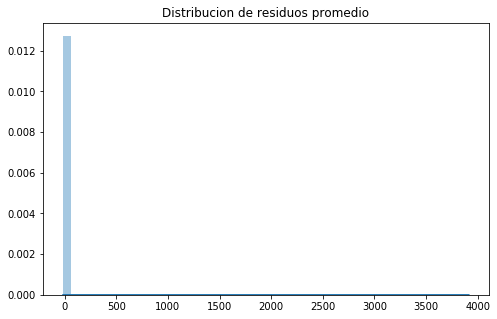

MSE      =  77.93020204700233
RMSE (+-)=  2.2174889036377
MAE  (+-)=  0.6273753849806974
--------- Smoothness ------------
AutoCorr lag-one =  0.6635394832219231
Diff MEAN =  0.21832389056272458
Diff STD =  2.4702304336619405
--------- Smoothness ------------


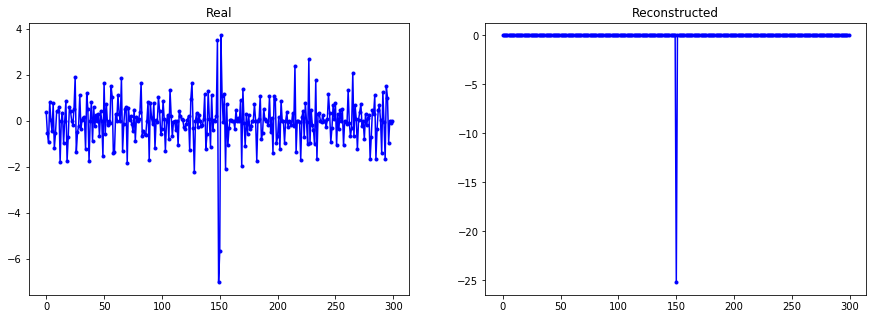

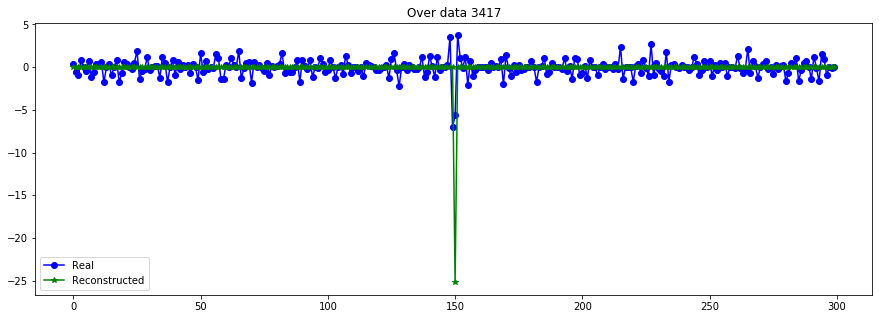

----------------------------------------------------------------


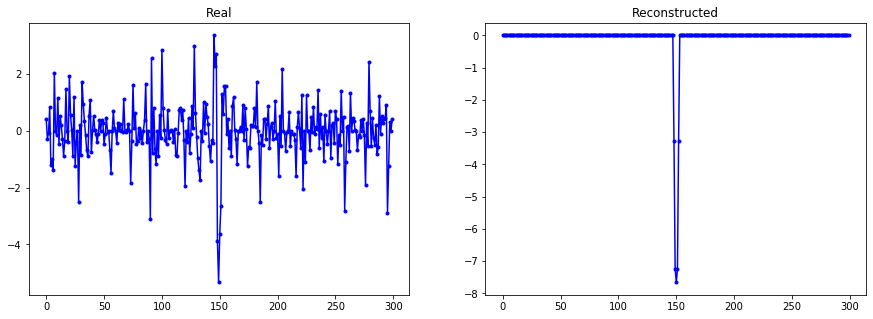

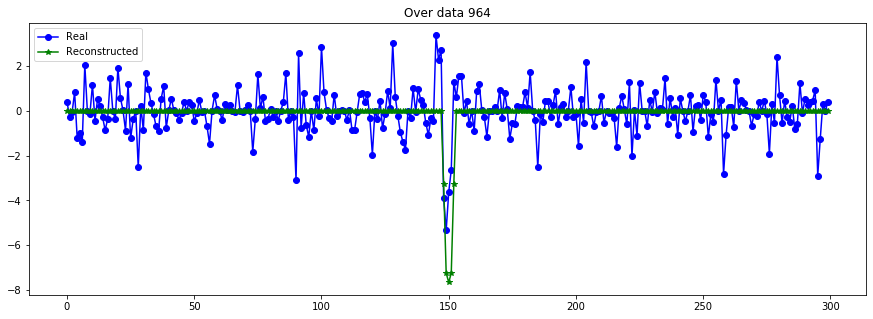

----------------------------------------------------------------


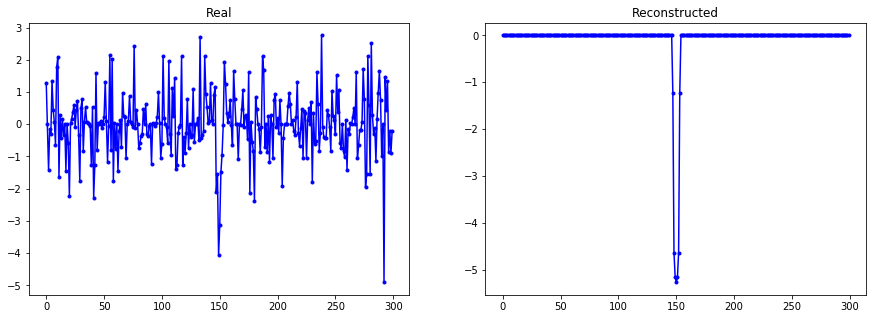

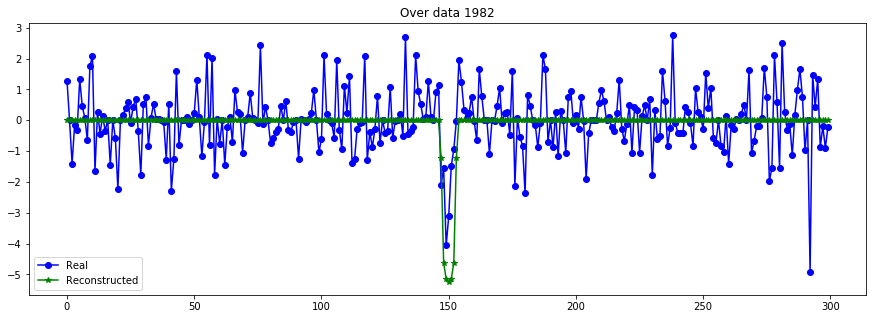

----------------------------------------------------------------


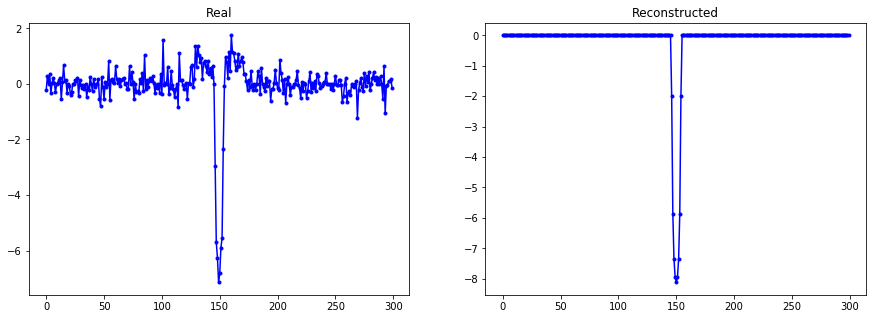

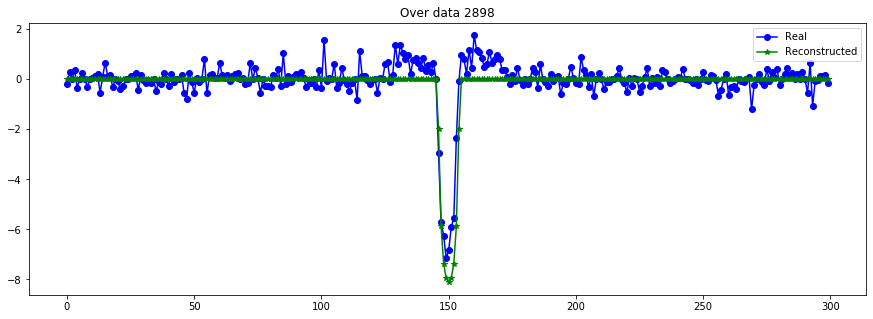

----------------------------------------------------------------


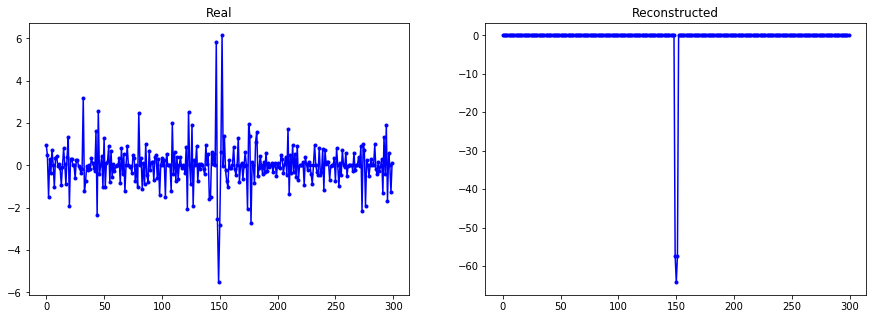

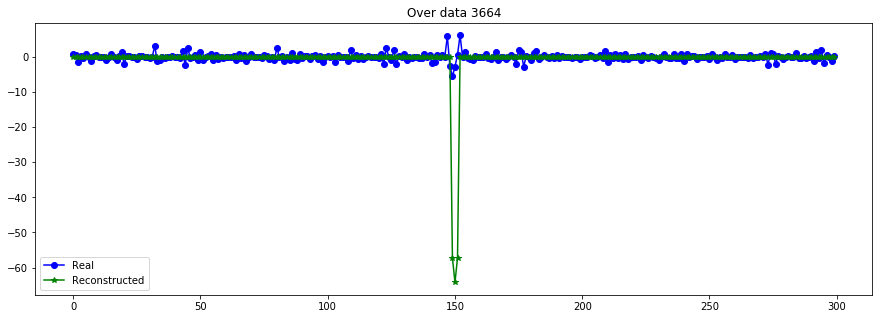

----------------------------------------------------------------


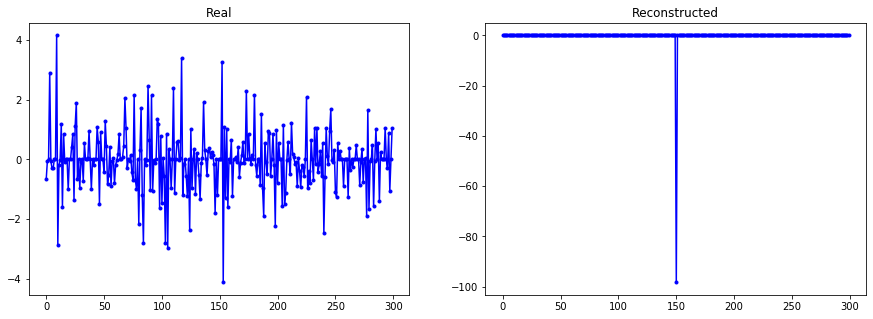

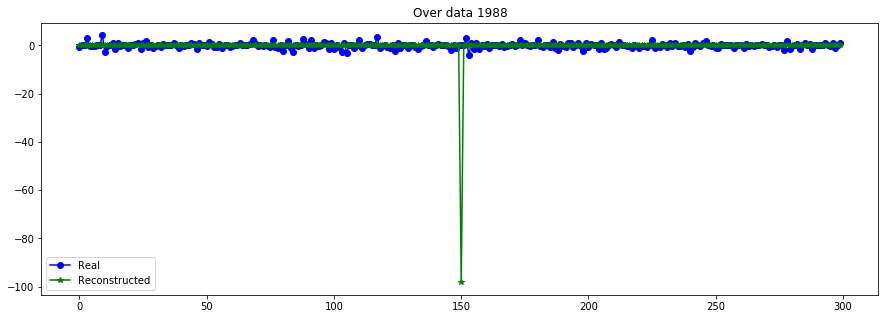

----------------------------------------------------------------


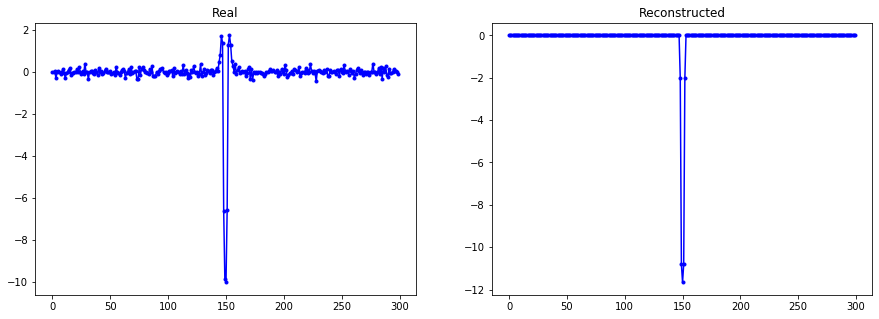

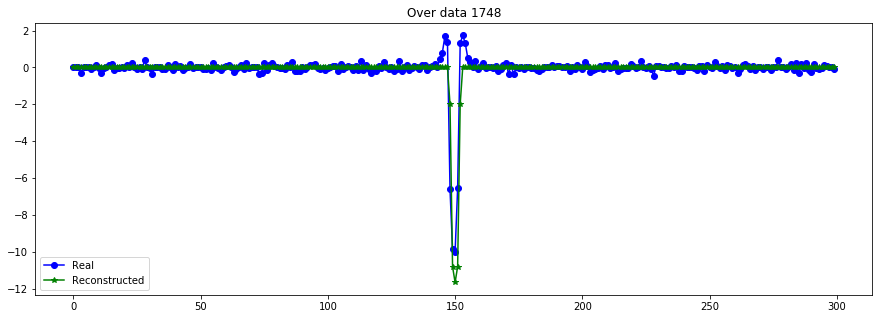

----------------------------------------------------------------


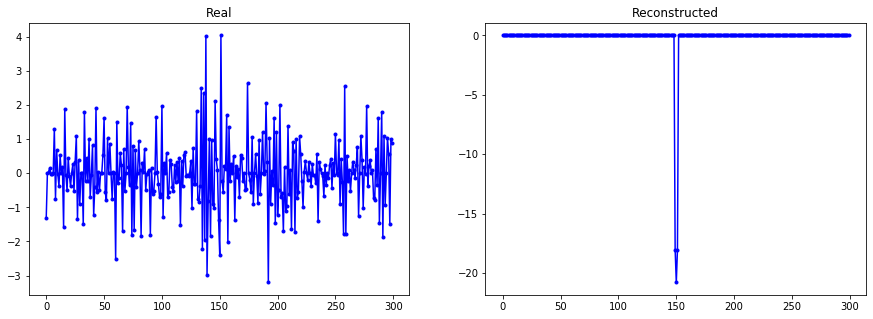

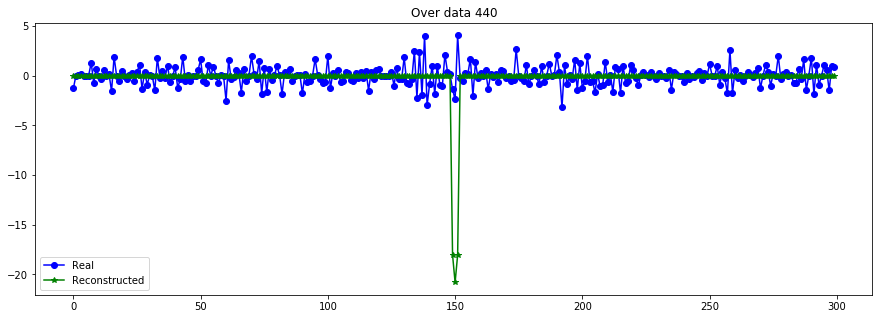

----------------------------------------------------------------


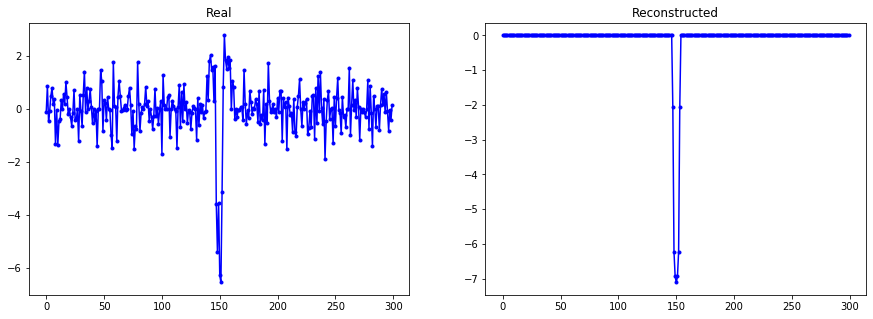

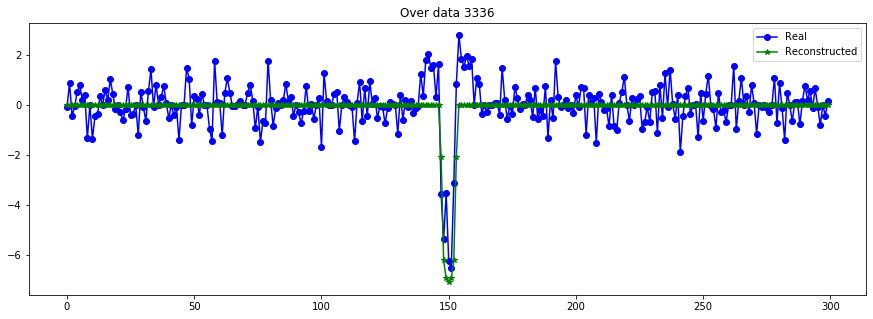

----------------------------------------------------------------


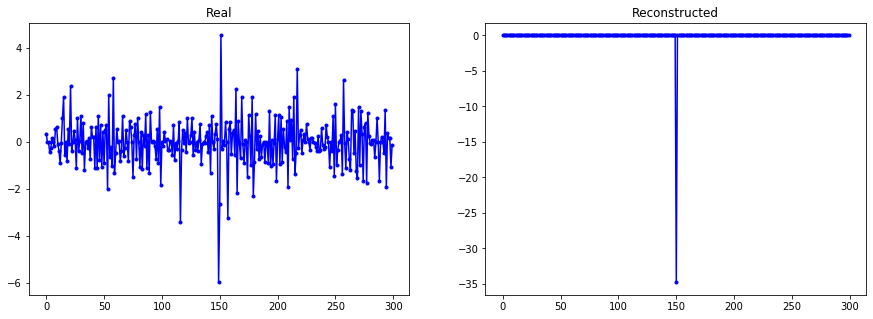

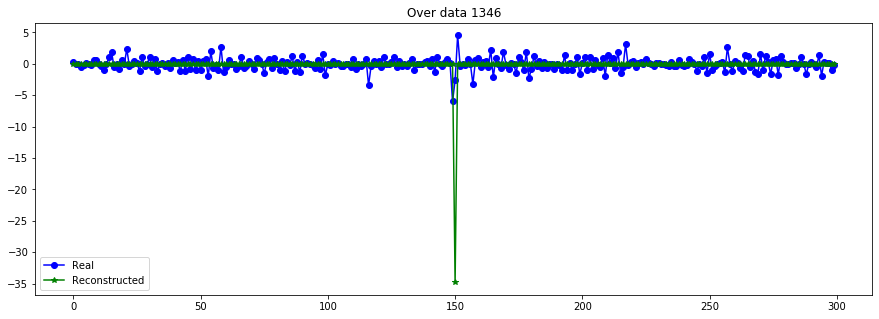

----------------------------------------------------------------


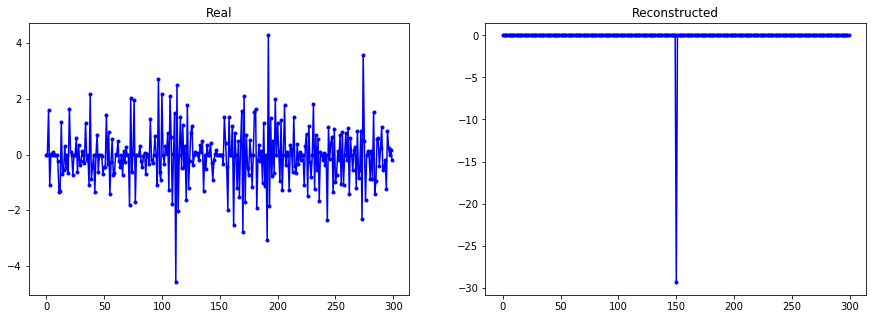

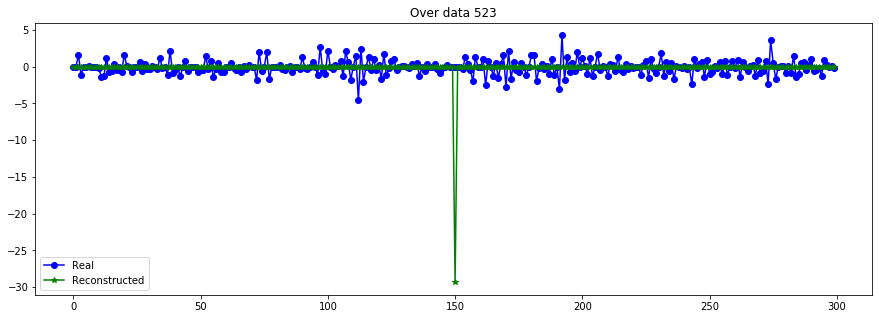

----------------------------------------------------------------


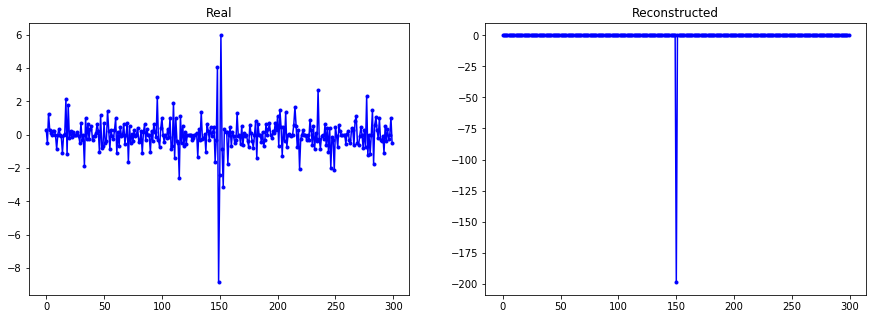

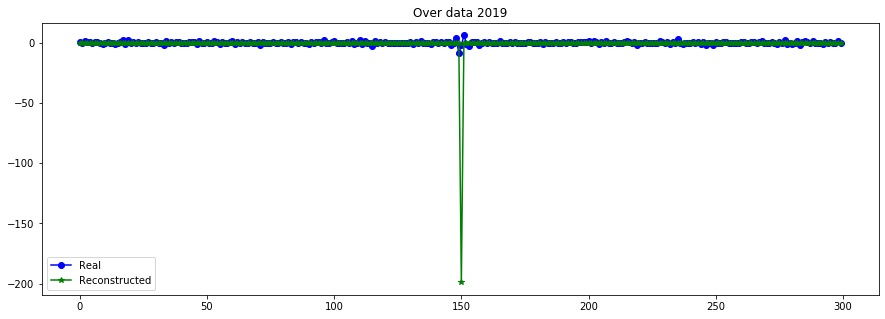

----------------------------------------------------------------


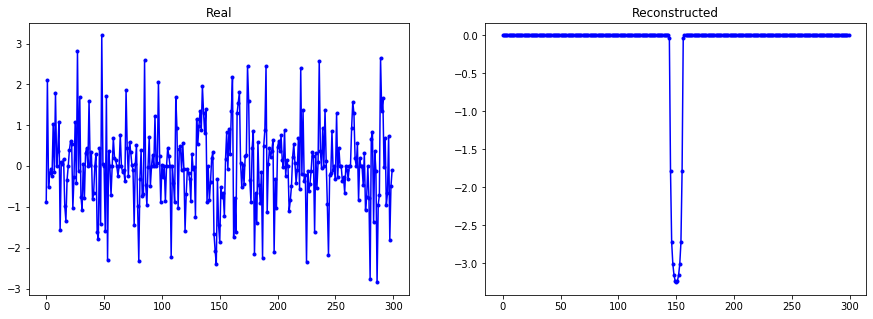

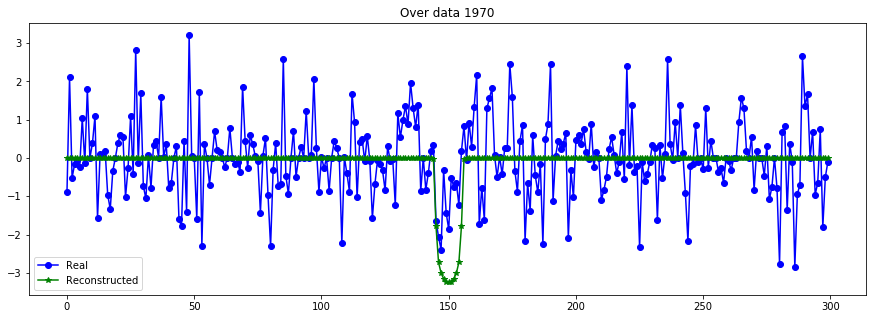

----------------------------------------------------------------


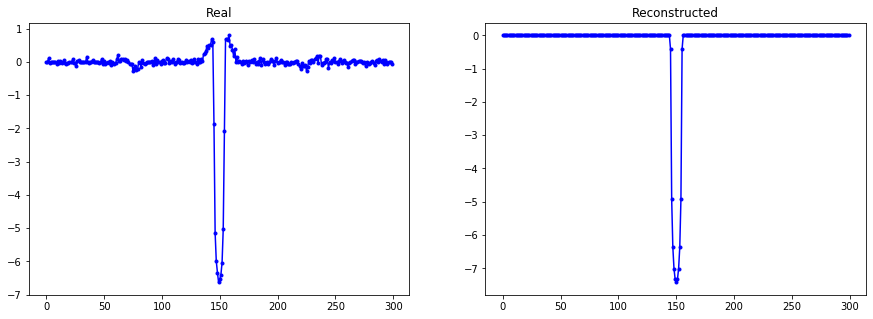

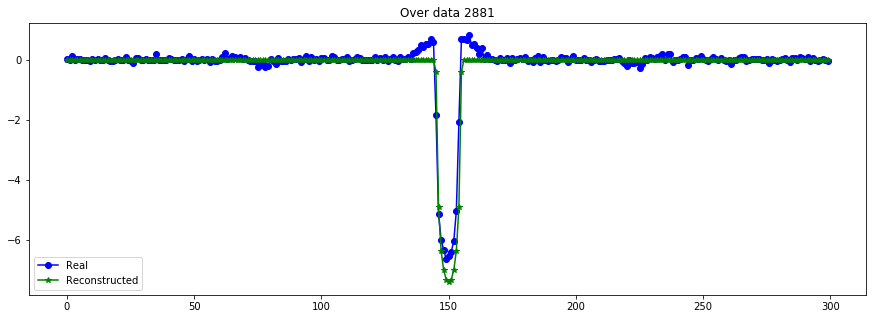

----------------------------------------------------------------


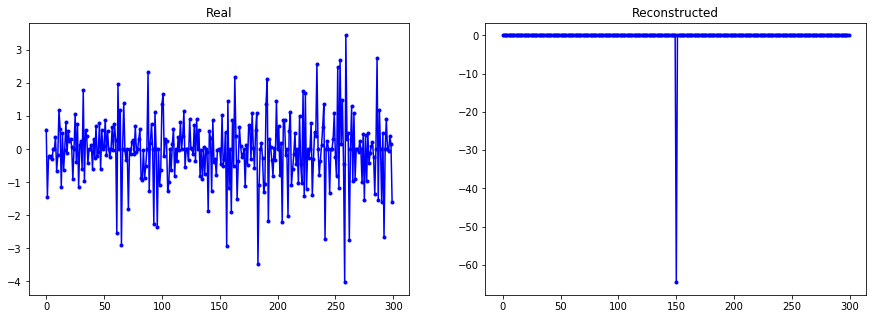

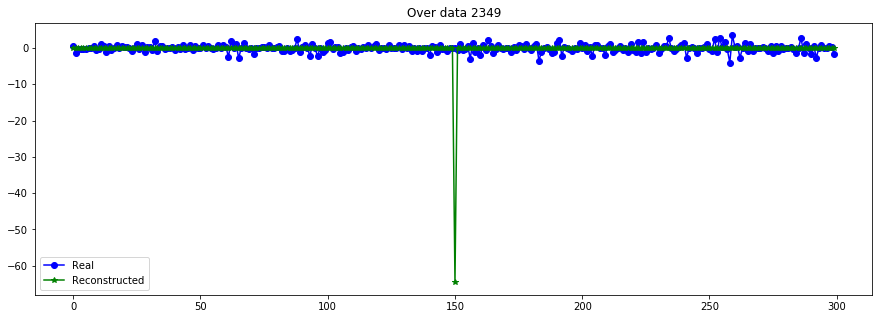

----------------------------------------------------------------


In [33]:
evaluate_reconst(X_train[:N], X_train_MA)

plot_n_lc(X_train[:N,:,0], X_train_MA, n= 15)

### Summary Reconstruction

|Técnicas|MSE| RMSE | MAE || AutoCorr| Diff Mean | Diff Std|
|---|---|---|---||---|---|---|
|Curva| - | - |-     ||  0.27        | 0.78     |  0.83   |
|Passband 1-500|1.18|1.08|0.62||0.97|0.05|0.07|
|Passband 50-1500|1.11|1.04|0.65||0.83|0.20|0.27|
|Passband 50-2500|0.96|0.96|0.64||0.67|0.36|0.45|
|Mov. avg (3)|0.54|0.72|0.46||0.70|0.27|0.34|
|Mov. avg (5)|0.72|0.84|0.51||0.78|0.17|0.22
|Mov. avg (10)|0.88|0.94|0.55||0.84|0.09|0.11|
|Mandel-Agol|77.93|2.22|0.63||0.66|  0.22 | 2.47|
|**VAE-32**|0.52|0.68|0.48||0.56|   0.08        | 0.45  |

* Es un buen denoising
* Genera representación útil

## Visualize encoded rep.

In [26]:
def transform_plot(model, data, just_plot=False):
    if just_plot:
        to_plot = data
    else:
        to_plot = model.fit_transform(data)
        
    plt.figure(figsize=(10,7))
    plt.scatter(to_plot[:,0],to_plot[:,1])
    plt.show()
    return to_plot

Y_transit = df_meta_obj.values[mask_transit]
labels_transit = df_meta["NExScI Disposition"].values[mask_transit]

In [27]:
## encode all.. not only transits..
encoder_all = Model([x_t, x_lc], [z_mean, z_log_var], name="encoder")
z_aux, z_var_aux = encoder_all.predict([X_train_t_all, X_train_all], batch_size=512)
z_samp = samp_encoder.predict([X_train_t_all, X_train_all], batch_size=512)
z_samp.shape

(8054, 32)

/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


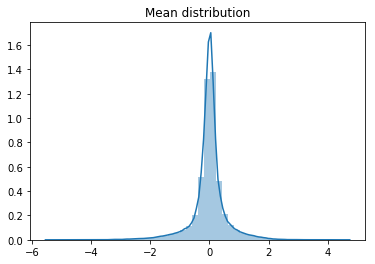

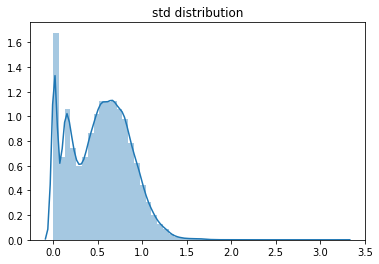

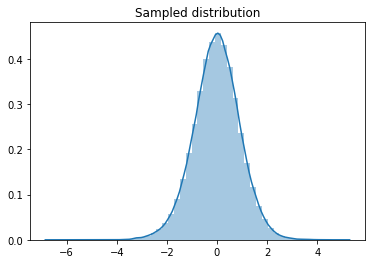

In [28]:
sns.distplot(z_aux.flatten())
plt.title("Mean distribution")
plt.show()

sns.distplot(np.exp(z_var_aux.flatten()))
plt.title("std distribution")
plt.show()

sns.distplot(z_samp.flatten())
plt.title("Sampled distribution")
plt.show()

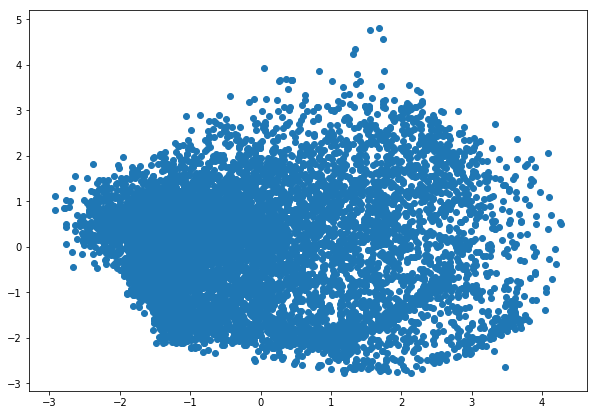

In [29]:
from sklearn.decomposition import PCA
model = PCA(2)

a = transform_plot(model, z_aux)

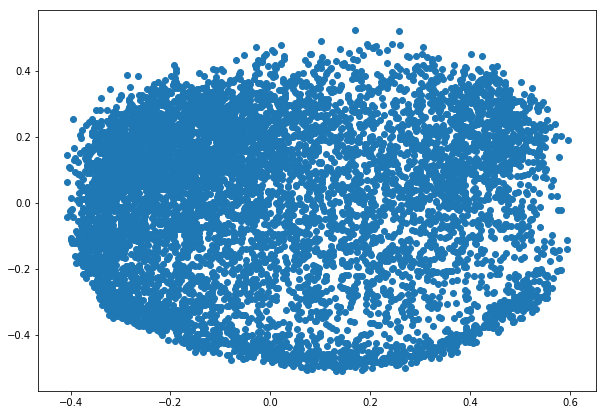

In [30]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, z_aux)

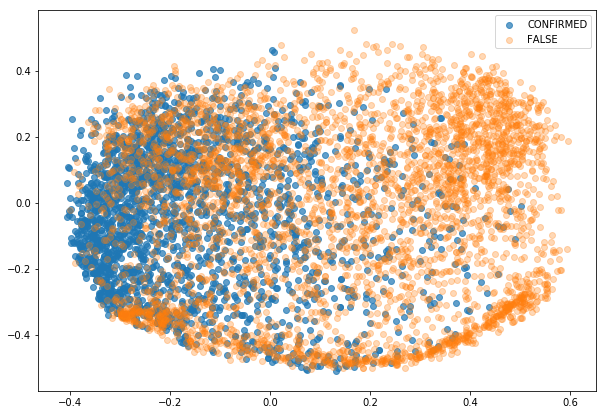

In [31]:
plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

In [70]:
#tsne
from sklearn.manifold import TSNE
model = TSNE(2, metric='euclidean', n_jobs=-1)

to_plot = transform_plot(model, z_aux)

TypeError: __init__() got an unexpected keyword argument 'n_jobs'

In [ ]:
plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

#### Transit traineds

(4317, 32)


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


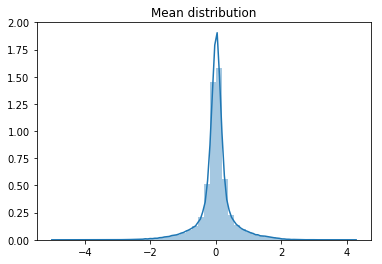

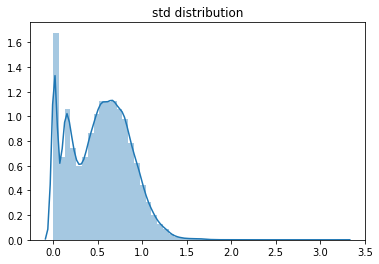

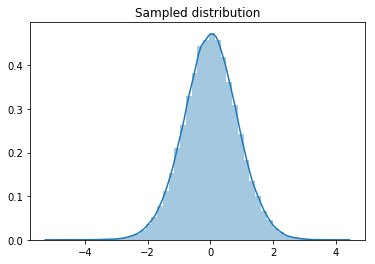

In [32]:
z_aux  = z_aux[mask_transit]
z_samp = z_samp[mask_transit]
print(z_aux.shape)

sns.distplot(z_aux.flatten())
plt.title("Mean distribution")
plt.show()

sns.distplot(np.exp(z_var_aux.flatten()))
plt.title("std distribution")
plt.show()

sns.distplot(z_samp.flatten())
plt.title("Sampled distribution")
plt.show()

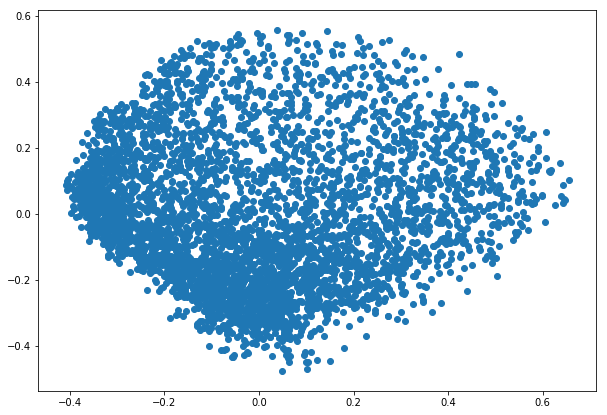

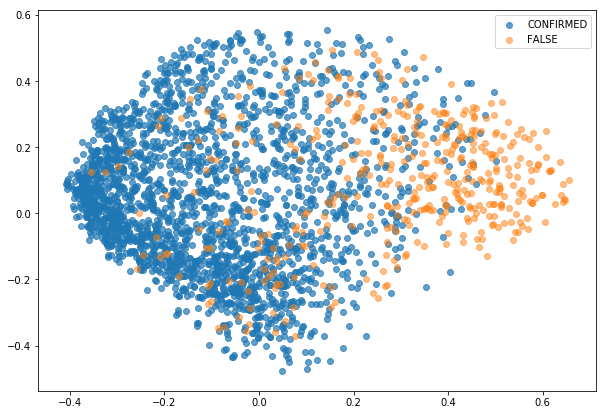

In [33]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, z_aux)

plt.figure(figsize=(10,7))
mask_ = (labels_transit=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (labels_transit=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.5)

plt.legend()
plt.show()

/home/fmena/.local/lib/python3.5/site-packages/sklearn/utils/extmath.py:530: RuntimeWarning: invalid value encountered in multiply
  v *= signs[:, np.newaxis]


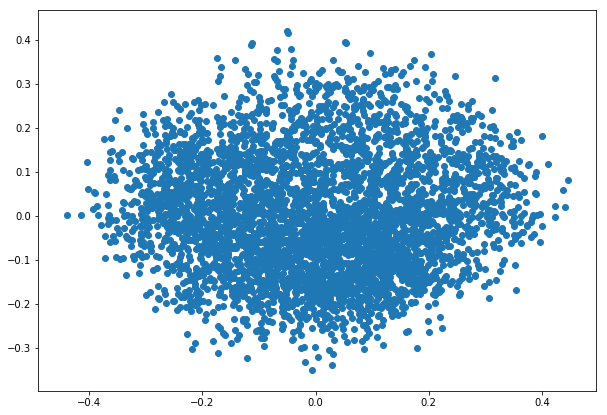

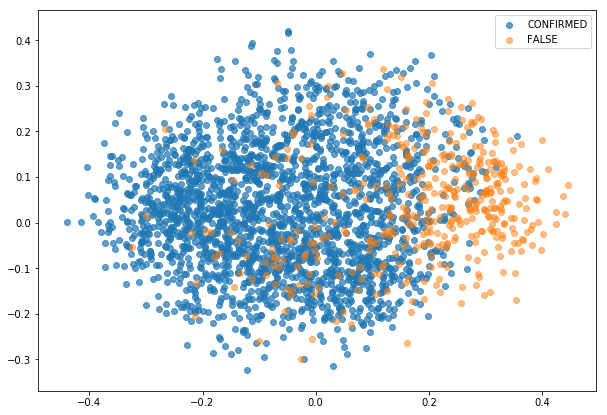

In [34]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, z_samp)

plt.figure(figsize=(10,7))
mask_ = (labels_transit=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (labels_transit=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.5)

plt.legend()
plt.show()

### clustering

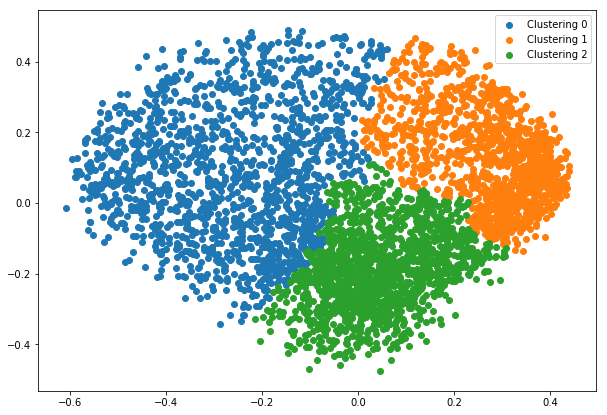

In [133]:
from sklearn.cluster import MiniBatchKMeans, KMeans, AgglomerativeClustering
K = 3
#model = KMeans(n_clusters = K, init='k-means++', n_jobs = -1)
model = AgglomerativeClustering(n_clusters=K, linkage='ward')

model.fit(to_plot)
clus_l = model.labels_

plt.figure(figsize=(10,7))
for i in range(K):
    mask_ = (clus_l==i)
    plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="Clustering "+str(i))
plt.legend()
plt.show()

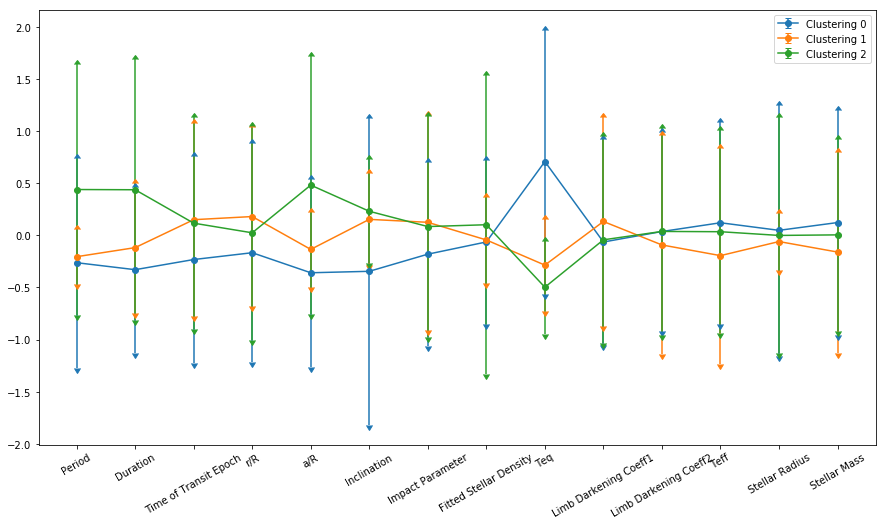

In [134]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
Y_transit_s = std.fit_transform(Y_transit)

clus_met_reps = []
clus_met_std = []
for i in range(K):
    mask_ = (clus_l==i)
    values = Y_transit_s[mask_]
    clus_met_reps.append(np.mean(values,axis =0))
    clus_met_std.append(np.std(values,axis =0))
    
metad = list(df_meta_obj.columns)
x = np.arange(len(metad))

plt.figure(figsize=(15,8))
for i in range(K):
    plt.errorbar(x, y=clus_met_reps[i], yerr=clus_met_std[i], label="Clustering "+str(i), fmt='o-', 
                 uplims=True,lolims=True)
    #plt.plot(x, clus_met_reps[i], label="Clustering "+str(i))
plt.xticks(x, metad, rotation=30)
plt.legend()
plt.show()

In [35]:
np.save("./LC_features/VAE_%dT_%dD.npy"%(T,latent_dim), z_aux)
np.save("./LC_features/VAE_%dT_%dD_samp.npy"%(T,latent_dim), z_samp)
!ls ./LC_features

FourierICA_300T_32D.npy    FourierPCA_71427T_32D.npy  VAE_300T_32D_samp.npy
FourierICA_71427T_32D.npy  MetadataLC.npy
FourierPCA_300T_32D.npy    VAE_300T_32D.npy


### Fourier de Curva Escalada

In [151]:
### la escala del input si importa
Inp = X_fold_lc[:,:]/np.std(X_fold_lc[:,:], axis=1, keepdims=True)

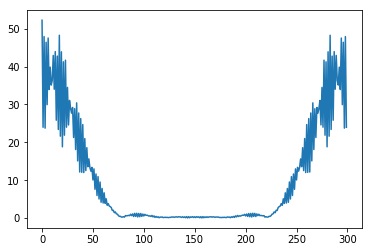

array([[26.15778101, 26.04342591, 25.42862911, ..., 24.78266268,
        25.42862911, 26.04342591],
       [11.53003706,  7.5604995 ,  5.04928396, ..., 12.72903347,
         5.04928396,  7.5604995 ],
       [22.731563  ,  5.4075442 ,  6.14663298, ...,  7.88298837,
         6.14663298,  5.4075442 ],
       ...,
       [ 9.55810768,  7.57454392, 25.27369647, ..., 39.07797339,
        25.27369647,  7.57454392],
       [ 1.08107583, 14.49249349,  9.27975872, ...,  3.85577001,
         9.27975872, 14.49249349],
       [14.65787274, 22.7791096 , 56.92800048, ..., 74.25877218,
        56.92800048, 22.7791096 ]])

In [152]:
X_fft = np.abs( np.fft.fft(Inp, axis=1) )
plt.plot(X_fft[3])
plt.show()
X_fft

In [153]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_fft_std = std.fit_transform(X_fft)
X_fft_std.shape

(8054, 300)

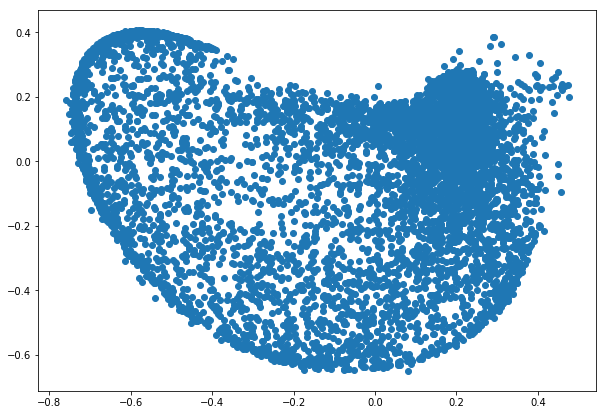

In [154]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, X_fft_std)

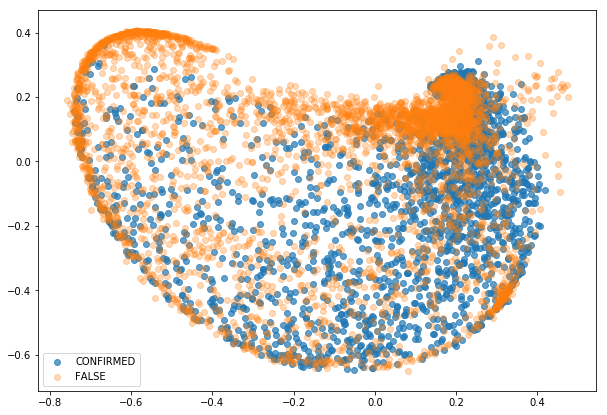

In [155]:
plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

### Transit traineds

In [158]:
X_fft = X_fft[mask_transit]
X_fft.shape

(4317, 300)

In [159]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_fft_std = std.fit_transform(X_fft)

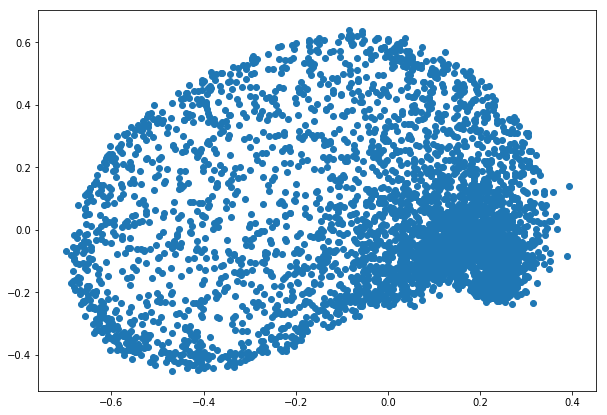

In [160]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, X_fft_std)

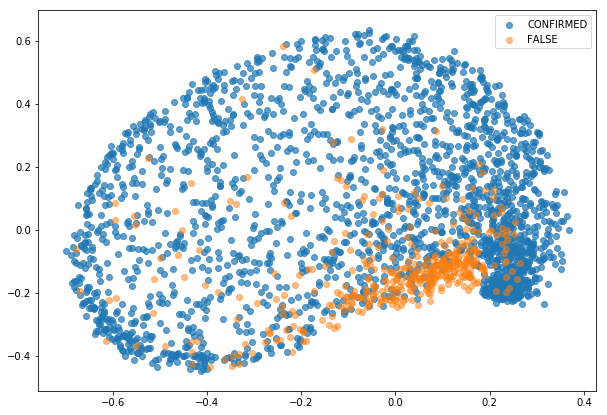

In [161]:
plt.figure(figsize=(10,7))
mask_ = (labels_transit=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (labels_transit=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.5)

plt.legend()
plt.show()

In [157]:
#save feautures of pca
from sklearn.decomposition import PCA, FastICA
model = PCA(n_components=latent_dim)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierPCA_%dT_%dD.npy"%(T,latent_dim), X_fft_save)

model = FastICA(n_components=latent_dim)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierICA_%dT_%dD.npy"%(T,latent_dim), X_fft_save)

!ls ./LC_features

FourierICA_300T_32D.npy  VAE_300T_32D.npy
FourierPCA_300T_32D.npy  VAE_300T_32D_samp.npy


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/sklearn/decomposition/fastica_.py:118: UserWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn('FastICA did not converge. Consider increasing '


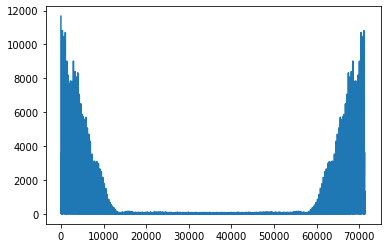

In [ ]:
#save feautures of pca of all LC
process_lc = np.load(folder_lc+'/cleaned/LC_kepler_processed.npy')
process_lc = np.nan_to_num(process_lc) #borrar nans... arreglo variable

Inp = process_lc/np.std(process_lc, axis=1, keepdims=True)
X_fft = np.abs( np.fft.fft(Inp, axis=1) )
plt.plot(X_fft[3])
plt.show()

from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_fft_std = std.fit_transform(X_fft)
X_fft_std.shape

D= 30*30*2 #latent_dim

from sklearn.decomposition import PCA, FastICA
model = PCA(n_components=D)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierPCA_%dT_%dD.npy"%(X_fft_std.shape[1],D), X_fft_save)

model = FastICA(n_components=D)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierICA_%dT_%dD.npy"%(X_fft_std.shape[1],D), X_fft_save)

!ls ./LC_features

### Metadata desde curva (manuales, especializados)
* Period 
* Duration 
* Time of Transit Epoch (T0)
* r/R
* a/R
* Inclination -- se deriva desde "a/R" e Impact
* Impact Parameter (circular)
* Teq (?) -- al parecer se necesita info d la estrella..
* Fitted Stellar Density: depends only on the transit's period, depth, and duration (see Seager and Mallen-Ornelas 2003).
* Limb Darkening Coeff1 (con informacion de la estrella - aunque podrian haber sido obtenidas )
* Limb Darkening Coeff2 (con informacion de la estrella - aunque podrian haber sido obtenidas )

https://exoplanetarchive.ipac.caltech.edu/docs/API_kepcandidate_columns.html
* Ingress: (nulos):

In [162]:
metadata_LC = df_meta_obj.iloc[:,:8]
metadata_LC

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density
0,8.884923,0.086252,169.991686,0.114,36.466,89.89,0.069,11.62061
1,5.092465,0.152458,357.535940,0.014,10.670,89.14,0.161,0.88510
2,275.073650,0.140417,315.248600,0.014,512.000,89.93,0.595,33.55994
3,8.460439,0.197288,133.774490,0.478,14.087,85.68,1.061,0.73874
4,21.761298,0.051792,166.540438,0.032,137.070,89.95,0.123,102.86534
5,4.287467,0.065388,262.062450,0.026,19.940,88.93,0.374,8.16471
6,0.539366,0.226417,131.974570,0.016,1.012,12.57,0.988,0.06737
7,36.267167,0.086042,155.081300,0.022,134.100,89.91,0.214,34.69388
8,4.298920,0.114458,132.861870,0.020,3.810,75.22,0.972,0.05666
9,161.788327,0.221250,214.039000,0.273,289.800,89.95,0.267,17.58377


In [163]:
from sklearn.preprocessing import StandardScaler, RobustScaler
std = StandardScaler()
X_metadata = std.fit_transform(metadata_LC.values)
X_metadata.shape

(8054, 8)

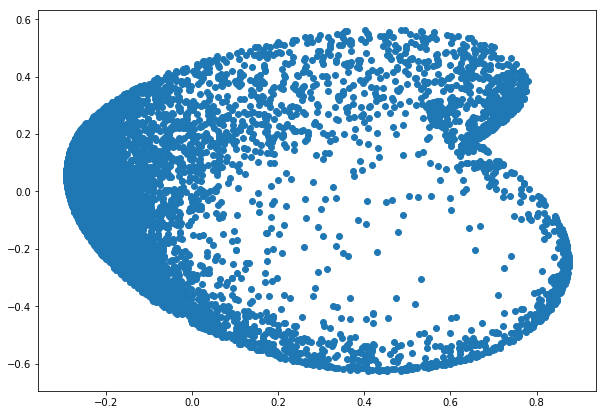

In [164]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, X_metadata)

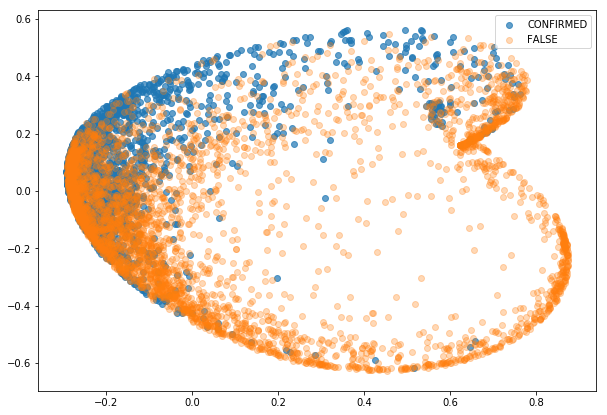

In [165]:
plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

#### Transit traineds

In [167]:
X_metadata = X_metadata[mask_transit]
X_metadata.shape

(4317, 8)

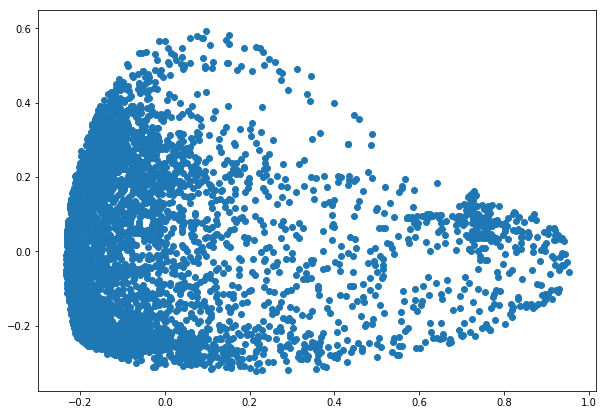

In [168]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, X_metadata)

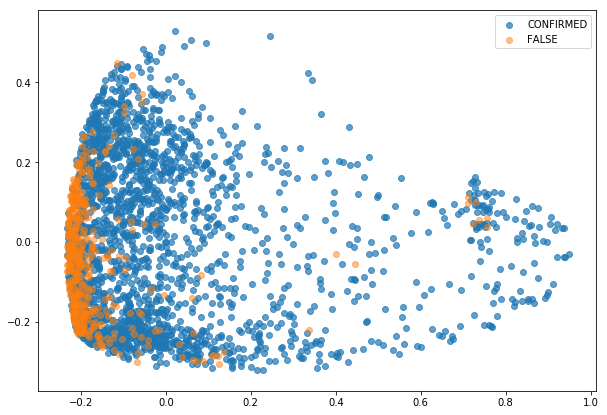

In [171]:
plt.figure(figsize=(10,7))
mask_ = (labels_transit=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (labels_transit=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.5)

plt.legend()
plt.show()

In [166]:
#save features of all X-- avisar a cony y a pato
np.save("./LC_features/MetadataLC.npy", X_metadata)
!ls ./LC_features

FourierICA_300T_32D.npy  MetadataLC.npy    VAE_300T_32D_samp.npy
FourierPCA_300T_32D.npy  VAE_300T_32D.npy


### FATS O FEETS?

In [60]:
import feets

ModuleNotFoundError: No module named 'feets'

---
## AE 
---

In [31]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) #bidirectional

z = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc], z, name="encoder")

decoder_input = Input(shape=(latent_dim,))
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, encoder([x_t, x_lc]) ])
AE_m = Model([x_t, x_lc], out)

AE_m.compile(optimizer='adam', loss=MSE_loss)
AE_m.summary()

batch_size = 64
AE_m.fit([X_train_t,X_train], X_train, epochs=200, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder (Model)                 (None, 32)           104736      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       112641      T_inp[0][0]                      
          

8634/8634 [==============================] - 13s 1ms/step - loss: 0.5624
Epoch 173/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5480
Epoch 174/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5718
Epoch 175/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.6004
Epoch 176/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5878
Epoch 177/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5821
Epoch 178/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5894
Epoch 179/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5622
Epoch 180/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5676
Epoch 181/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5511
Epoch 182/200
8634/8634 [==============================] - 13s 1ms/step - loss: 0.5647
Epoch 183/200
8634/8634 [==============================] 

Errores  []


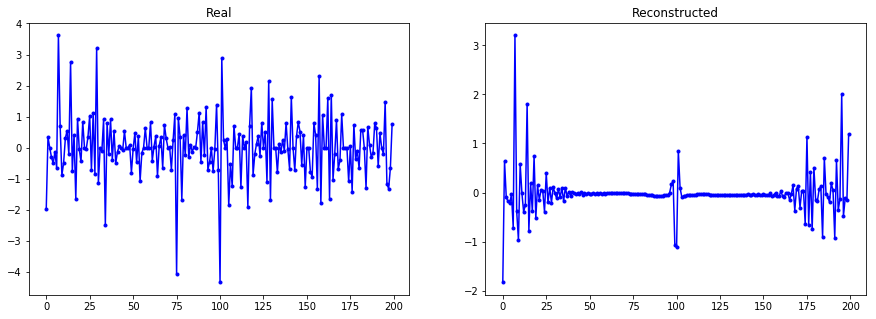

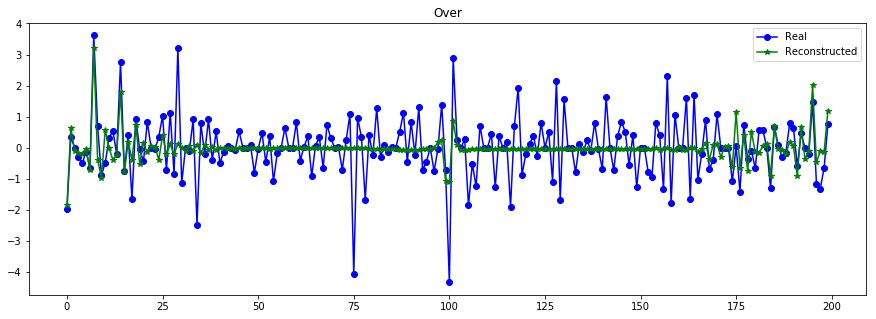

----------------------------------------------------------------


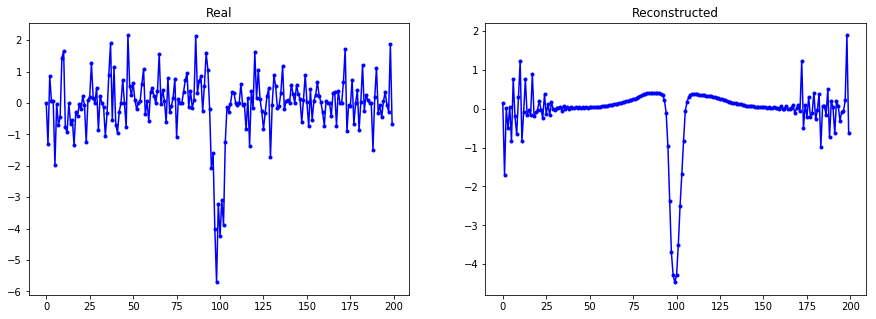

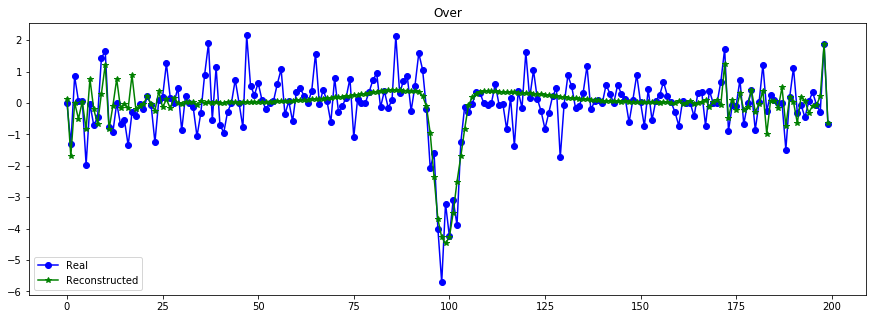

----------------------------------------------------------------


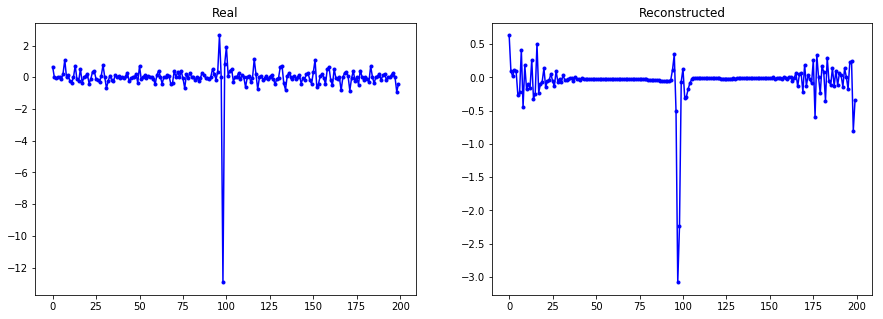

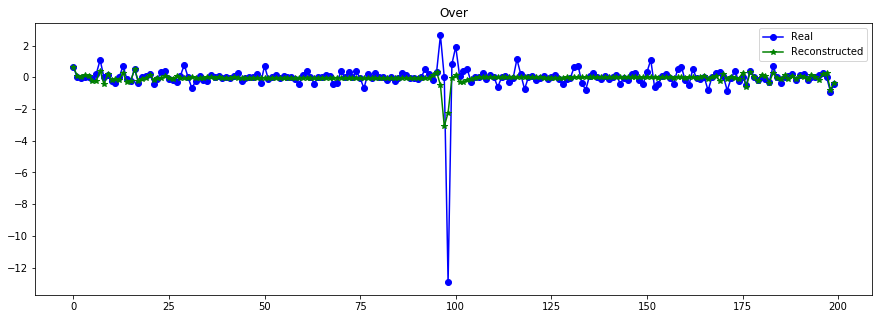

----------------------------------------------------------------


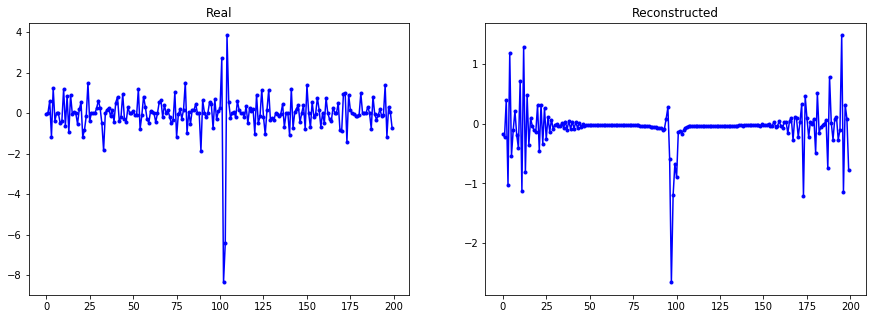

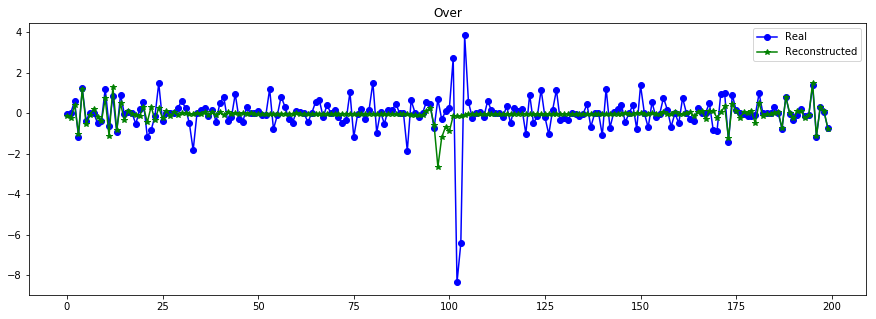

----------------------------------------------------------------


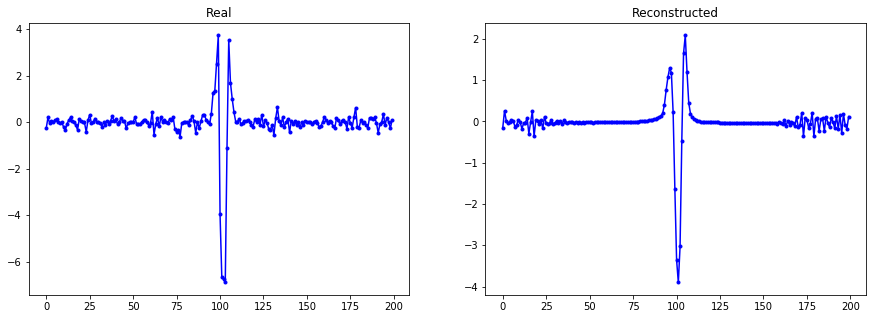

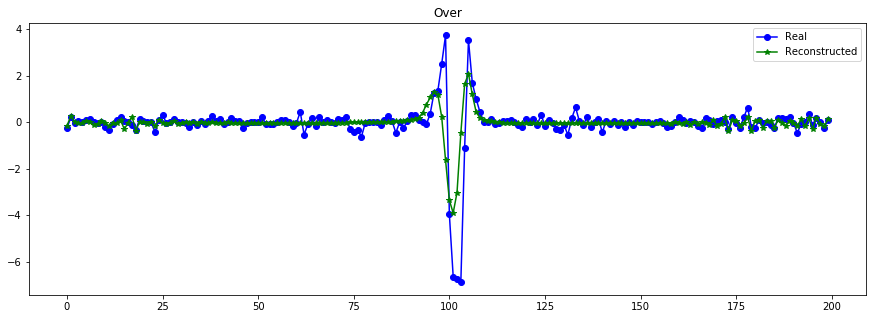

----------------------------------------------------------------


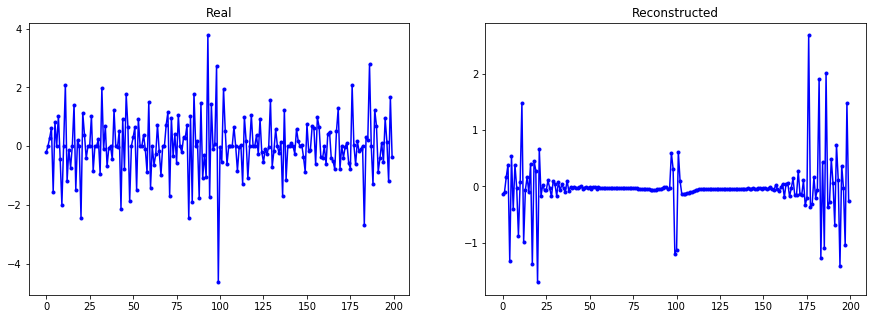

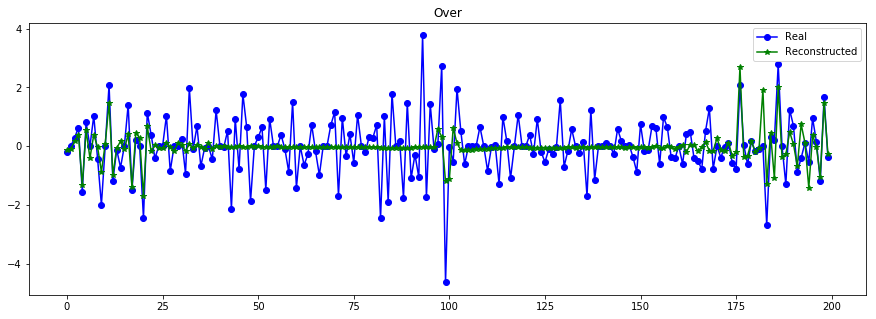

----------------------------------------------------------------


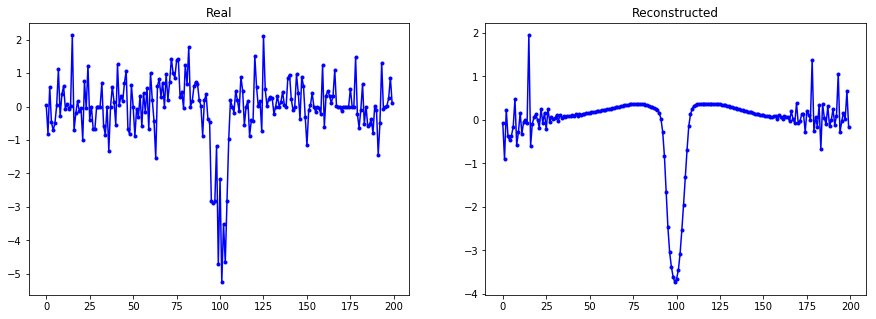

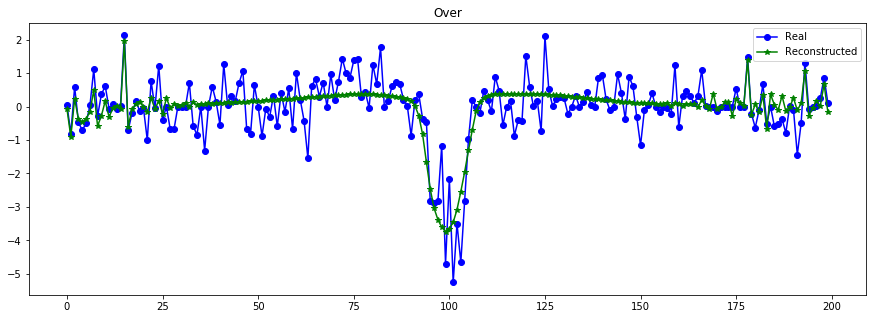

----------------------------------------------------------------


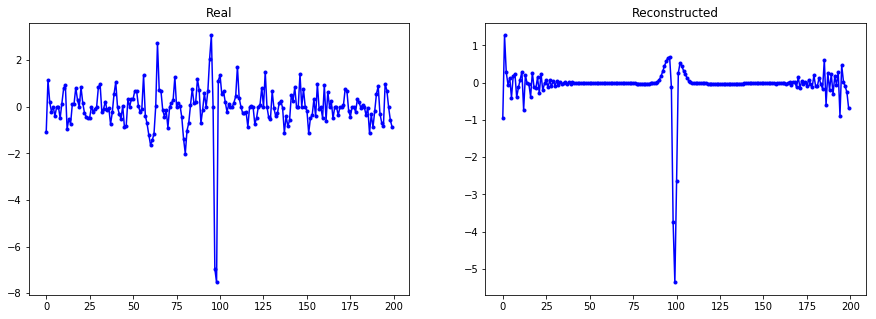

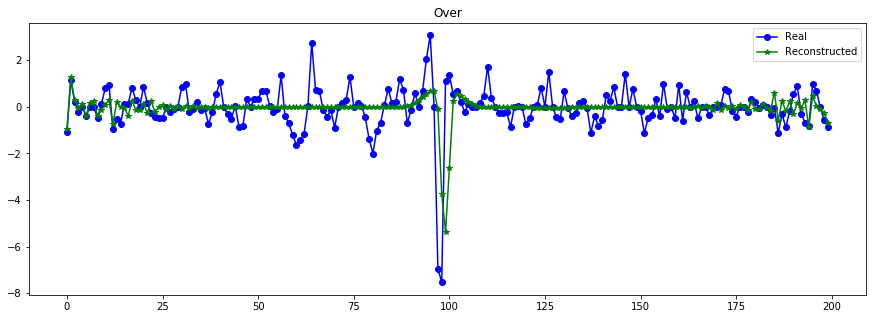

----------------------------------------------------------------


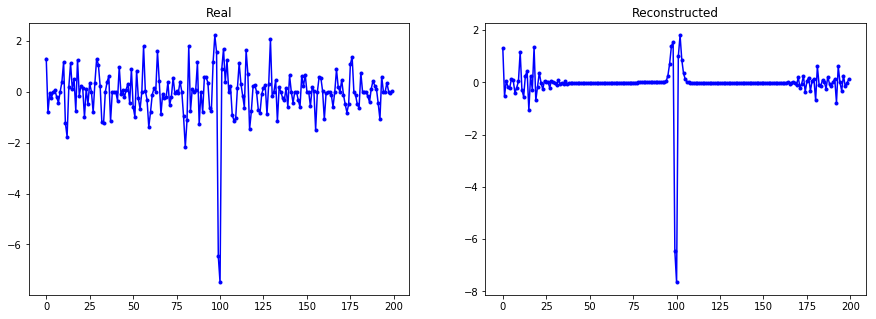

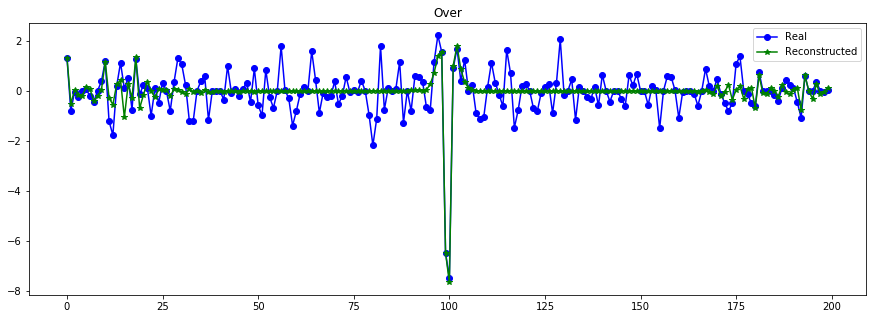

----------------------------------------------------------------


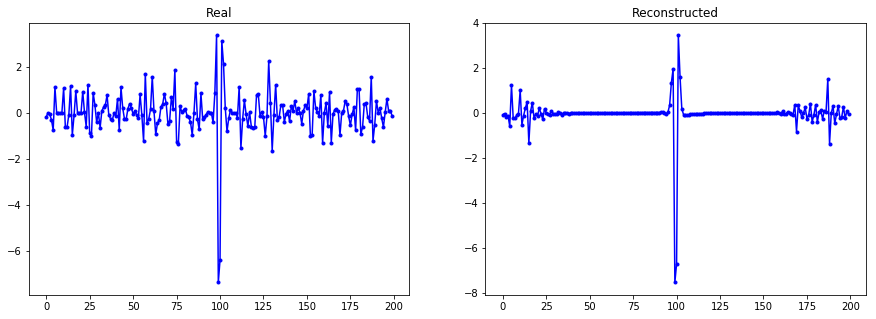

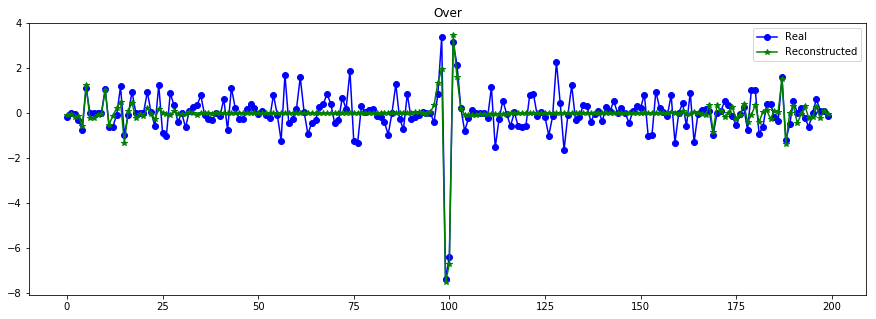

----------------------------------------------------------------


In [32]:
print("Errores ",AE_m.evaluate([X_test_t,X_test], X_test, batch_size=512))
X_train_hat = AE_m.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) 

/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


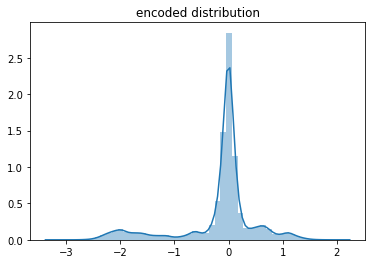

In [34]:
z_enc = encoder.predict([X_train_t, X_train], batch_size=512)

sns.distplot(z_enc.flatten())
plt.title("encoded distribution")
plt.show()

In [35]:
def transform_plot(model, data, just_plot=False):
    if just_plot:
        to_plot = data
    else:
        to_plot = model.fit_transform(data)
        
    plt.figure(figsize=(10,7))
    plt.scatter(to_plot[:,0],to_plot[:,1])
    plt.show()
    return to_plot

mask_transit = np.load("data/mask_transit_LC.py") 
Y_transit = np.tile( df_meta_obj.values[mask_transit], (2,1))
labels = np.tile((df_meta["NExScI Disposition"].values[mask_transit]),2)

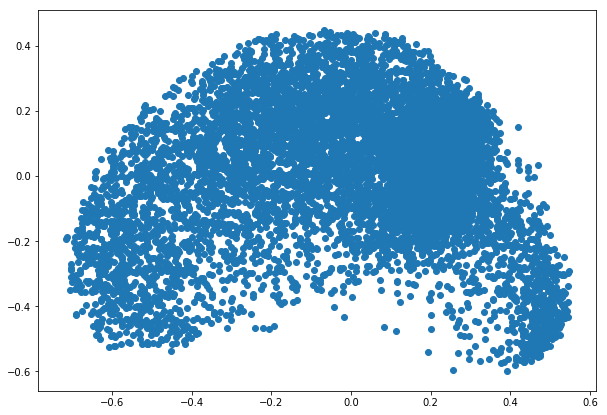

In [48]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=0.5, n_jobs=-1)
    
to_plot = transform_plot(model, z_enc)

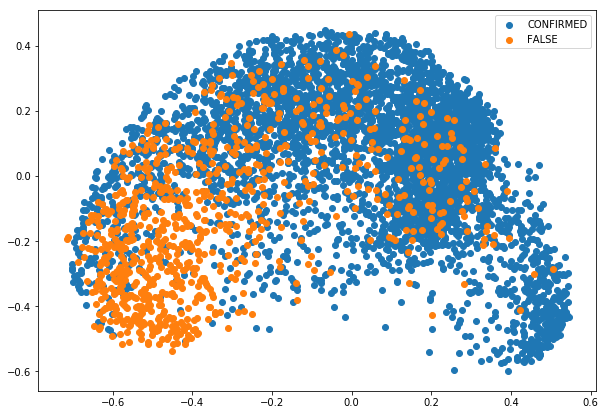

In [51]:
plt.figure(figsize=(10,7))
mask_ = (labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED")

mask_ = (labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE")
plt.legend()
plt.show()

### clustering

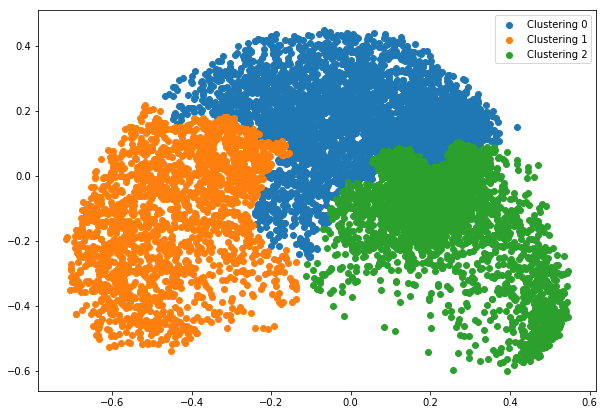

In [52]:
from sklearn.cluster import MiniBatchKMeans, KMeans, AgglomerativeClustering
K = 3
#model = KMeans(n_clusters = K, init='k-means++', n_jobs = -1)
model = AgglomerativeClustering(n_clusters=K, linkage='ward')

model.fit(to_plot)
clus_l = model.labels_

plt.figure(figsize=(10,7))
for i in range(K):
    mask_ = (clus_l==i)
    plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="Clustering "+str(i))
plt.legend()
plt.show()

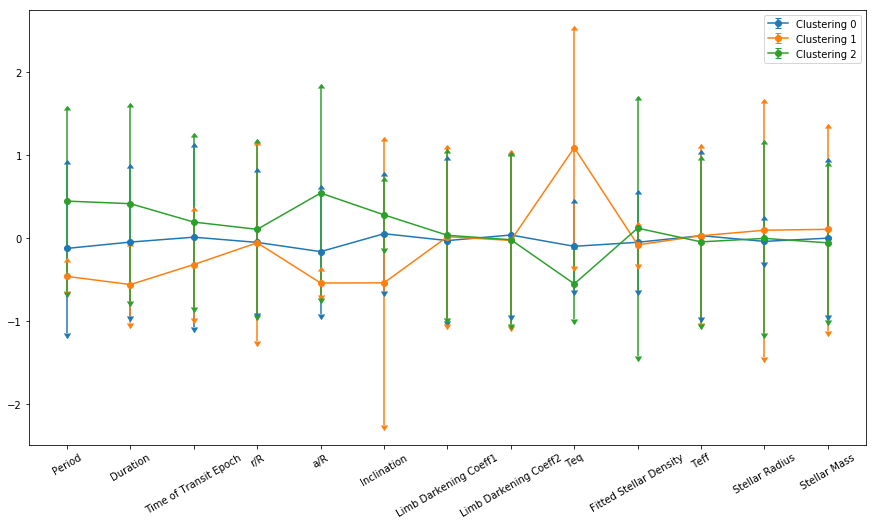

In [53]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
Y_transit_s = std.fit_transform(Y_transit)

clus_met_reps = []
clus_met_std = []
for i in range(K):
    mask_ = (clus_l==i)
    values = Y_transit_s[mask_]
    clus_met_reps.append(np.mean(values,axis =0))
    clus_met_std.append(np.std(values,axis =0))
    
metad = list(df_meta_obj.columns)
x = np.arange(len(metad))

plt.figure(figsize=(15,8))
for i in range(K):
    plt.errorbar(x, y=clus_met_reps[i], yerr=clus_met_std[i], label="Clustering "+str(i), fmt='o-', 
                 uplims=True,lolims=True)
plt.xticks(x, metad, rotation=30)
plt.legend()
plt.show()

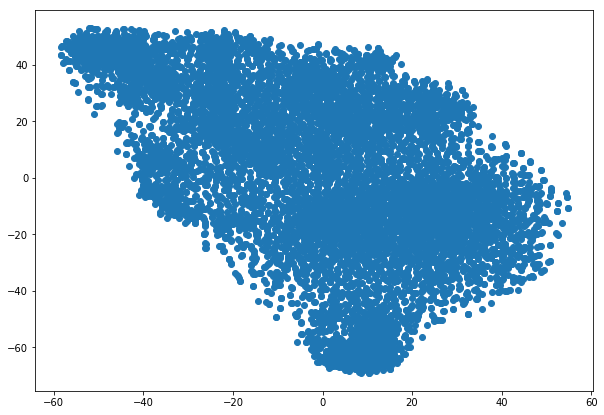

In [55]:
from sklearn.manifold import TSNE
model = TSNE(2, metric='euclidean') #, n_jobs=-1)

to_plot = transform_plot(model, z_enc)

In [42]:
def scaled_MSE(y_true,y_pred,scale):
    return np.mean(np.mean( scale**2 * np.mean( (y_true - y_pred)**2 , axis=1), axis=0))

def Multiply_layer(args):
    x,s = args
    return x*s[:,None,:]
def Divide_layer(args):
    x,s = args
    return x/s[:,None,:]

S_train = 1/np.std(X_train, axis=1)
S_test = 1/np.std(X_test, axis=1)

#escalar la escala?
S_mu = np.mean(S_train)
S_std = np.std(S_train)
def Normalization_L(x,mu,std):
    return (x-mu)/std
def RevertNorm_L(x,mu,std):
    return std*x+mu

S_train.shape

(6490, 1)

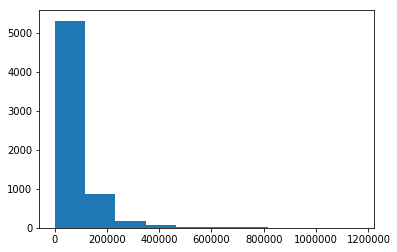

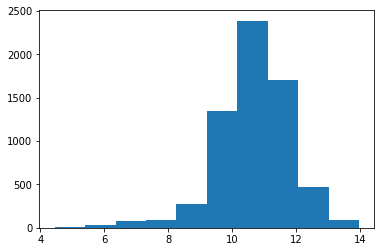

In [73]:
plt.hist(S_train)
plt.show()
plt.hist(np.log(S_train))
plt.show()

In [17]:
def S_loss(y_true, y_pred):
    s = vae.get_layer("encoder").get_layer("norm").output
    z_mean = vae.get_layer("encoder").outputs[0]
    
    R_layer = vae.get_layer("generator").get_layer("reconsnorm")
    s_hat = R_layer(z_mean)
    return K.mean( K.square( s - s_hat ), axis=-1)

def ae_loss_S(y_true, y_pred):
    return MSE_loss(y_true, y_pred) + S_loss(y_true, y_pred)

In [36]:
##### INPUTS ENCODER ######
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")
s = Input(shape= (1,), name="scale_inp") #NEW: Extension: depende de x

x_lc_s = Lambda(Multiply_layer, name="Multiply")([x_lc,s]) #NEW: escalar data

##### CODIFY LIGHT CURVE ######
x = Concatenate(axis=-1)([x_t, x_lc_s]) 
f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x)
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) 

##### CODIFY SCALE AND CONCATENATE ######
f1_s = Lambda(Normalization_L, arguments={'mu':S_mu,'std':S_std}, name="norm")(s) #mas capas?
#f1_s = Dense(4, activation='relu')(f1_s) #o tanh
f1 = Concatenate(axis=-1)([f1, f1_s]) #NEW: agregar escala a codificar

##### GET THE LATENT VARIABLE ######
z_mean = Dense(latent_dim,activation='linear')(f1)
#z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc, s], z_mean, name="encoder")

##### DO THE SAMPLING ######
#z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
#samp_encoder = Model([x_t, x_lc,s], z, name="encoder_sampling")

##### INPUTS DECODER ######
decoder_input = Input(shape=(latent_dim,))

##### RECONSTRCT SCALE ######
#s_out = Dense(4, activation='relu')(decoder_input)
s_out = Dense(1, activation='linear', name="reconsnorm")(decoder_input) #NEW: aprende s o 1/s 
s_out = Lambda(RevertNorm_L, arguments={'mu':S_mu,'std':S_std},name="revertnorm")(s_out) #NEW: volver a escala normal 
aux_model = Model(decoder_input, s_out)
s_model = Model([x_t, x_lc, s], aux_model(encoder([x_t, x_lc, s])))

##### RECONSTRUCT LIGHT CURVE ######
decode = RepeatVector(T)(decoder_input)
decode = Concatenate(axis=-1)([x_t, decode]) #add time decode
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = TimeDistributed(Dense(1, activation='linear'))(decode)

decode = Lambda(Divide_layer, name="Divide")([decode, s_out]) #NEW: 

generator = Model([x_t, decoder_input], decode, name="generator")

##### VAE MODEL ######
out = generator([x_t, encoder([x_t, x_lc, s])])  #samp_encoder([x_t, x_lc, s]) ])
vae = Model([x_t, x_lc, s], out)

vae.compile(optimizer='adam', loss=MSE_loss, metrics = [MSE_loss])
vae.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
scale_inp (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
encoder (Model)                 (None, 32)           104768      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
          

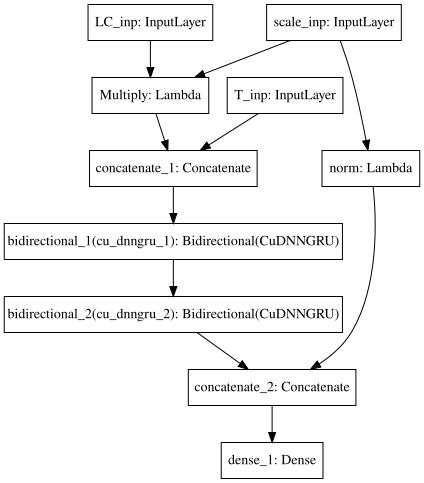

In [19]:
SVG(model_to_dot(encoder).create(prog='dot', format='svg'))

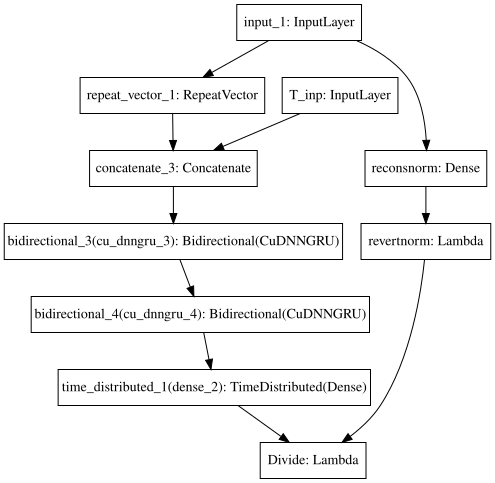

In [20]:
SVG(model_to_dot(generator).create(prog='dot', format='svg'))

In [197]:
batch_size = 64
vae.fit([X_train_t,X_train, S_train], X_train, epochs=500, batch_size=batch_size, sample_weight=(S_train**2)[:,0],
        validation_data=([X_test_t,X_test,S_test], X_test)) #a 1

Train on 6484 samples, validate on 1075 samples
Epoch 1/500
6484/6484 [==============================] - 30s 5ms/step - loss: 1.0123 - MSE_loss: 1.4266e-07 - val_loss: 7.9734e-08 - val_MSE_loss: 7.9734e-08
Epoch 2/500
6484/6484 [==============================] - 12s 2ms/step - loss: 1.0023 - MSE_loss: 1.4265e-07 - val_loss: 7.9733e-08 - val_MSE_loss: 7.9733e-08
Epoch 3/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0018 - MSE_loss: 1.4266e-07 - val_loss: 7.9728e-08 - val_MSE_loss: 7.9728e-08
Epoch 4/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0013 - MSE_loss: 1.4265e-07 - val_loss: 7.9727e-08 - val_MSE_loss: 7.9727e-08
Epoch 5/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0007 - MSE_loss: 1.4265e-07 - val_loss: 7.9721e-08 - val_MSE_loss: 7.9721e-08
Epoch 6/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.5173 - MSE_loss: 1.4272e-07 - val_loss: 7.9810e-08 - val_MSE_loss: 7.9810e-08
Epoc

6484/6484 [==============================] - 11s 2ms/step - loss: 0.9852 - MSE_loss: 1.4239e-07 - val_loss: 7.9406e-08 - val_MSE_loss: 7.9406e-08
Epoch 104/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0034 - MSE_loss: 1.4245e-07 - val_loss: 7.9722e-08 - val_MSE_loss: 7.9722e-08
Epoch 105/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9992 - MSE_loss: 1.4263e-07 - val_loss: 7.9699e-08 - val_MSE_loss: 7.9699e-08
Epoch 106/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9947 - MSE_loss: 1.4259e-07 - val_loss: 7.9733e-08 - val_MSE_loss: 7.9733e-08
Epoch 107/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0008 - MSE_loss: 1.4265e-07 - val_loss: 7.9721e-08 - val_MSE_loss: 7.9721e-08
Epoch 108/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9959 - MSE_loss: 1.4260e-07 - val_loss: 7.9651e-08 - val_MSE_loss: 7.9651e-08
Epoch 109/500
6484/6484 [=============================

6484/6484 [==============================] - 11s 2ms/step - loss: 0.7337 - MSE_loss: 1.2531e-07 - val_loss: 6.3287e-08 - val_MSE_loss: 6.3287e-08
Epoch 206/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.9013 - MSE_loss: 1.2853e-07 - val_loss: 7.9716e-08 - val_MSE_loss: 7.9716e-08
Epoch 207/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0081 - MSE_loss: 1.4265e-07 - val_loss: 7.9722e-08 - val_MSE_loss: 7.9722e-08
Epoch 208/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0026 - MSE_loss: 1.4263e-07 - val_loss: 7.9706e-08 - val_MSE_loss: 7.9706e-08
Epoch 209/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0007 - MSE_loss: 1.4261e-07 - val_loss: 7.9690e-08 - val_MSE_loss: 7.9690e-08
Epoch 210/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9990 - MSE_loss: 1.4259e-07 - val_loss: 7.9682e-08 - val_MSE_loss: 7.9682e-08
Epoch 211/500
6484/6484 [=============================

6484/6484 [==============================] - 11s 2ms/step - loss: 0.7396 - MSE_loss: 1.2185e-07 - val_loss: 6.1266e-08 - val_MSE_loss: 6.1266e-08
Epoch 308/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8530 - MSE_loss: 1.3831e-07 - val_loss: 7.7693e-08 - val_MSE_loss: 7.7693e-08
Epoch 309/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8041 - MSE_loss: 1.3961e-07 - val_loss: 7.7215e-08 - val_MSE_loss: 7.7215e-08
Epoch 310/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.7802 - MSE_loss: 1.3839e-07 - val_loss: 7.6775e-08 - val_MSE_loss: 7.6775e-08
Epoch 311/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.7790 - MSE_loss: 1.3785e-07 - val_loss: 7.6088e-08 - val_MSE_loss: 7.6088e-08
Epoch 312/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.7583 - MSE_loss: 1.3797e-07 - val_loss: 7.4711e-08 - val_MSE_loss: 7.4711e-08
Epoch 313/500
6484/6484 [=============================

6484/6484 [==============================] - 11s 2ms/step - loss: 0.9739 - MSE_loss: 1.4249e-07 - val_loss: 7.9567e-08 - val_MSE_loss: 7.9567e-08
Epoch 410/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9604 - MSE_loss: 1.4244e-07 - val_loss: 7.9529e-08 - val_MSE_loss: 7.9529e-08
Epoch 411/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9538 - MSE_loss: 1.4241e-07 - val_loss: 7.9510e-08 - val_MSE_loss: 7.9510e-08
Epoch 412/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9490 - MSE_loss: 1.4238e-07 - val_loss: 7.9479e-08 - val_MSE_loss: 7.9479e-08
Epoch 413/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9432 - MSE_loss: 1.4235e-07 - val_loss: 7.9451e-08 - val_MSE_loss: 7.9451e-08
Epoch 414/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.9373 - MSE_loss: 1.4232e-07 - val_loss: 7.9429e-08 - val_MSE_loss: 7.9429e-08
Epoch 415/500
6484/6484 [=============================

1075/1075 [==============================] - 0s 239us/step
Errores  [7.67626542489692e-08, 7.67626542489692e-08]


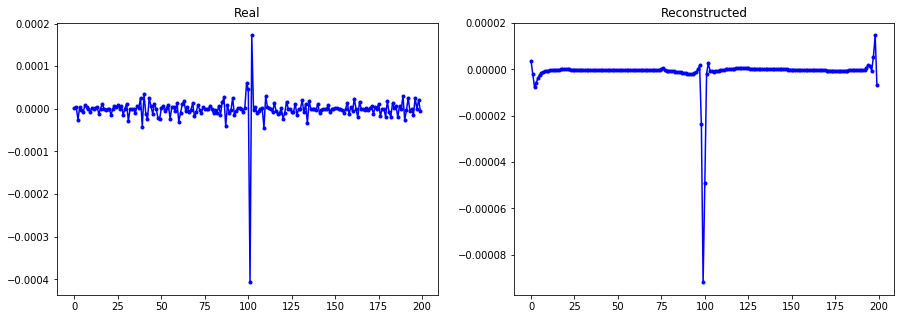

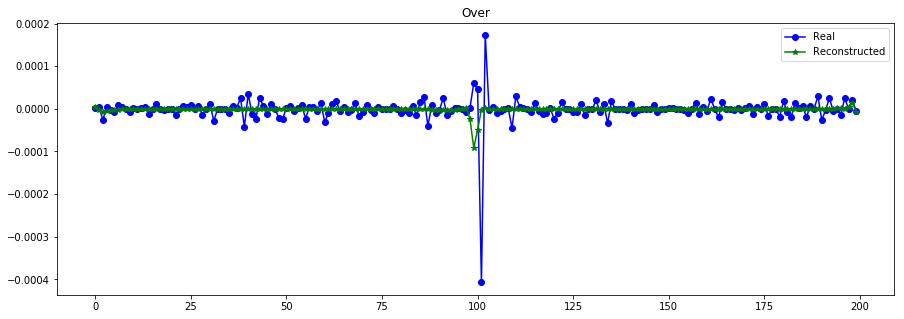

----------------------------------------------------------------


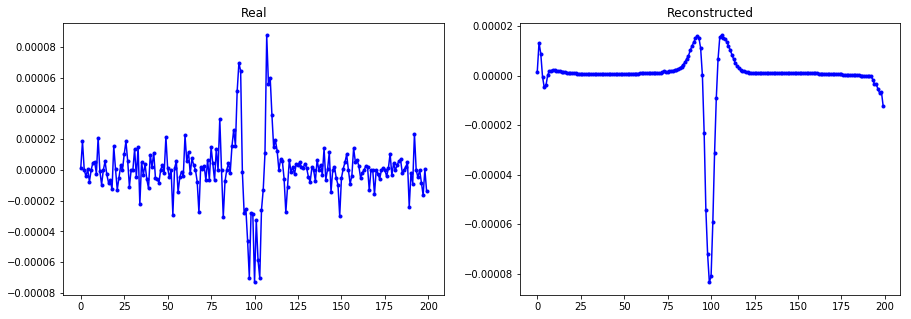

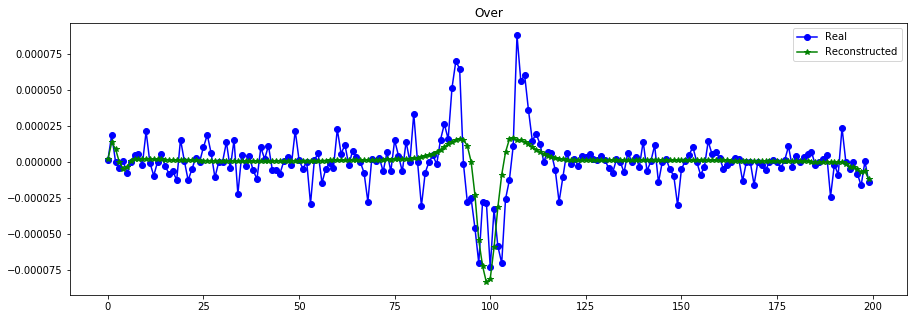

----------------------------------------------------------------


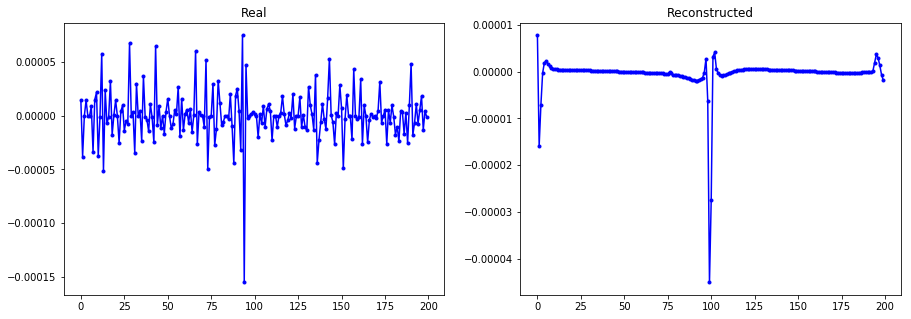

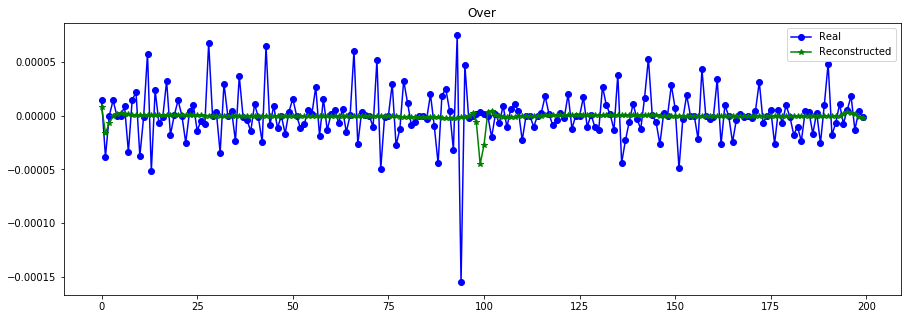

----------------------------------------------------------------


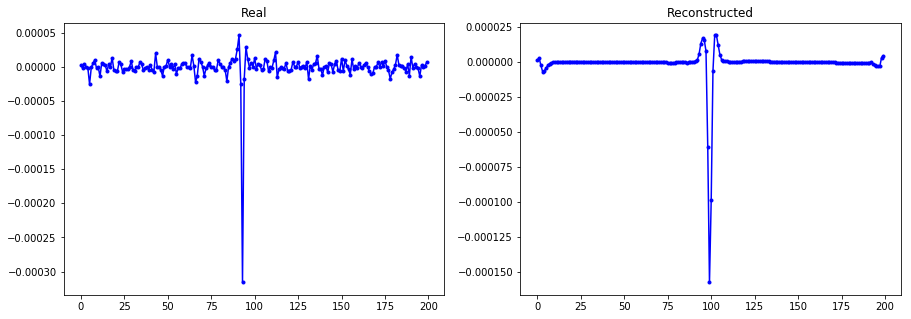

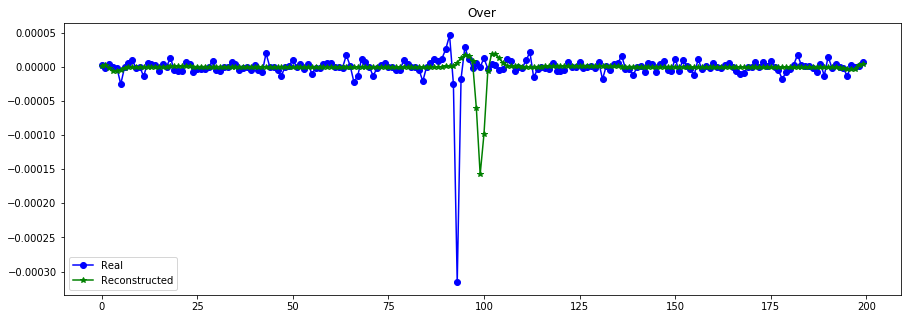

----------------------------------------------------------------


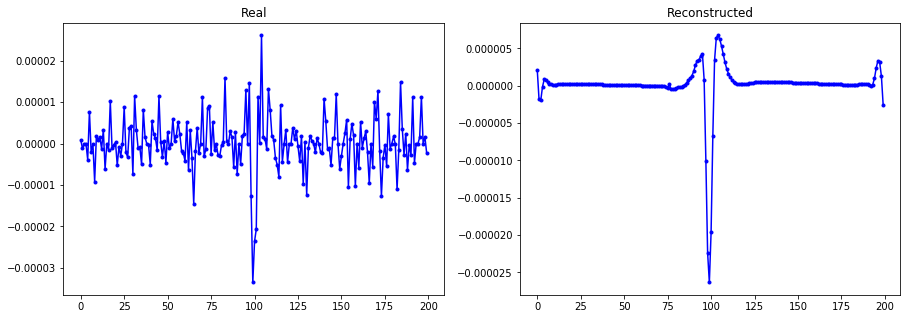

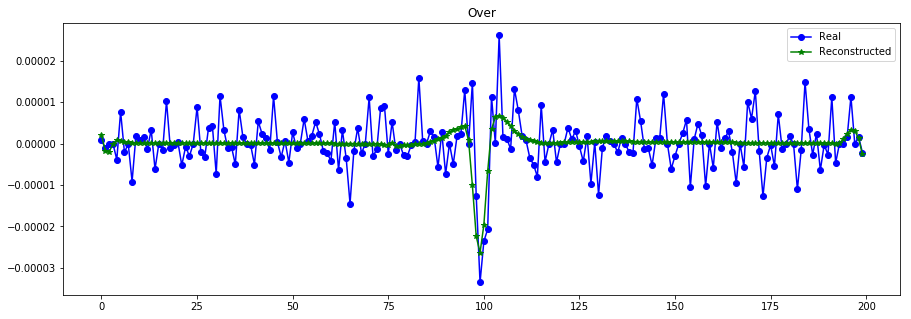

----------------------------------------------------------------


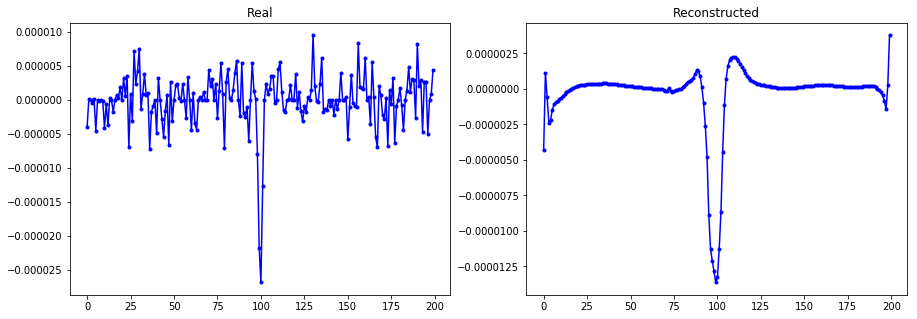

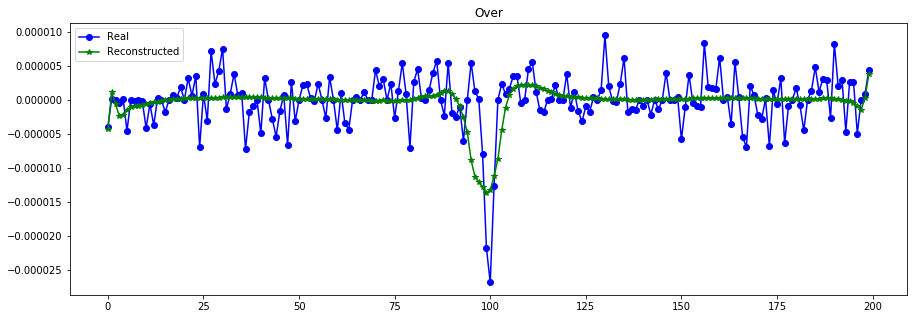

----------------------------------------------------------------


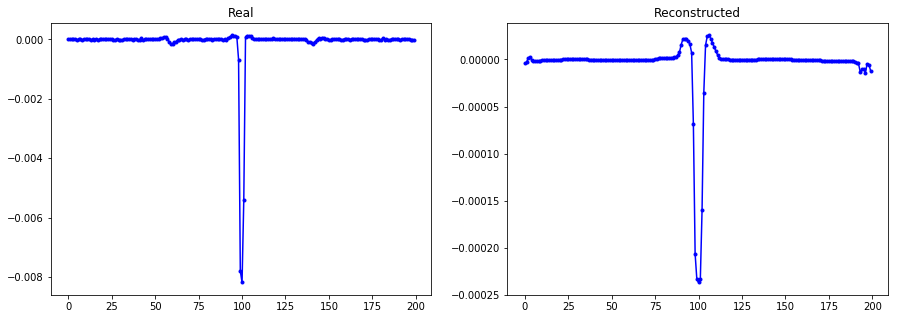

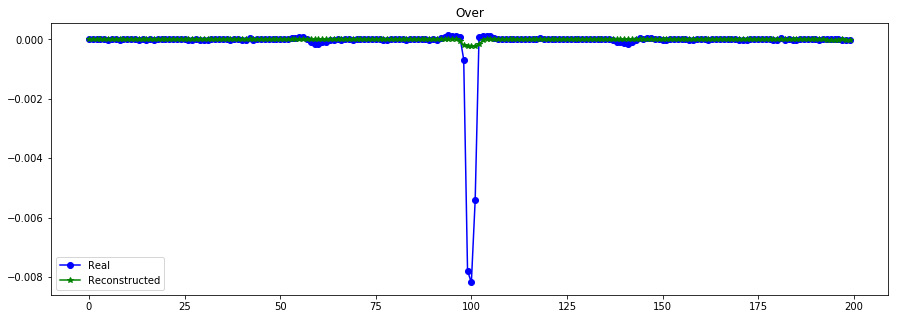

----------------------------------------------------------------


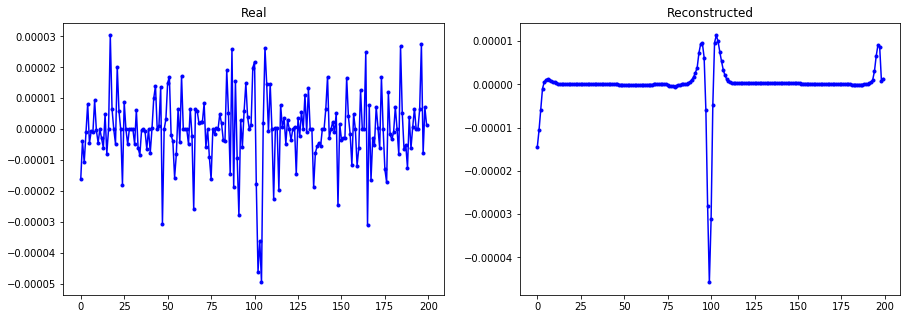

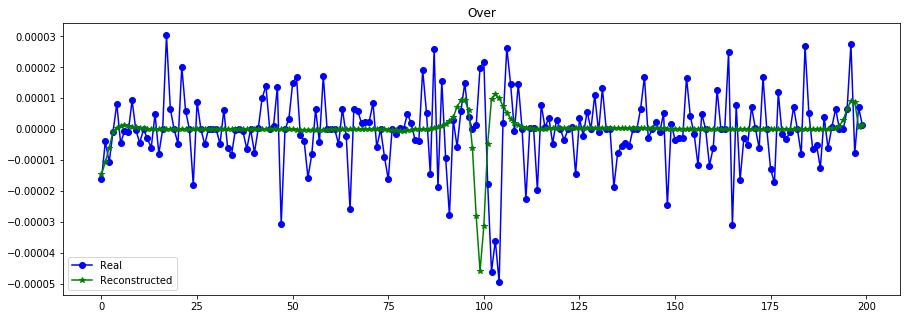

----------------------------------------------------------------


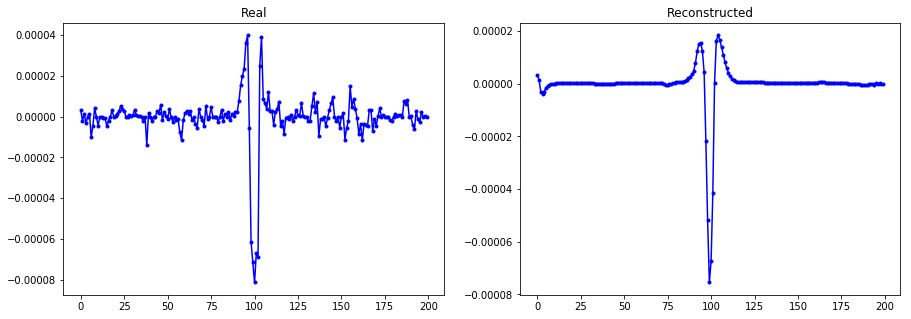

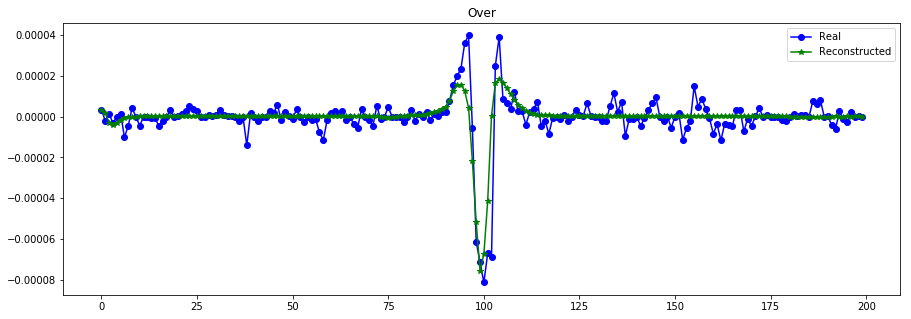

----------------------------------------------------------------


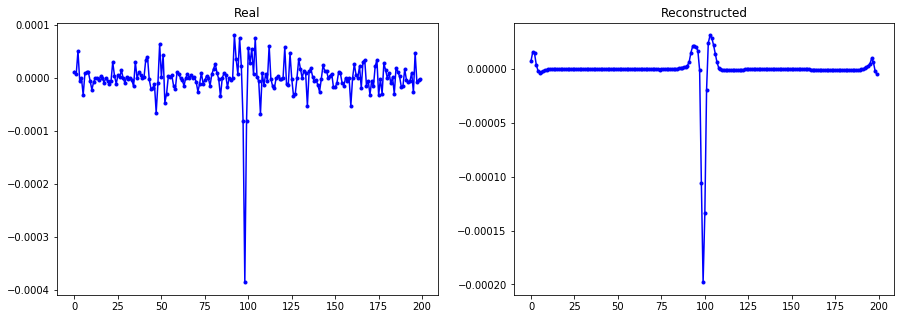

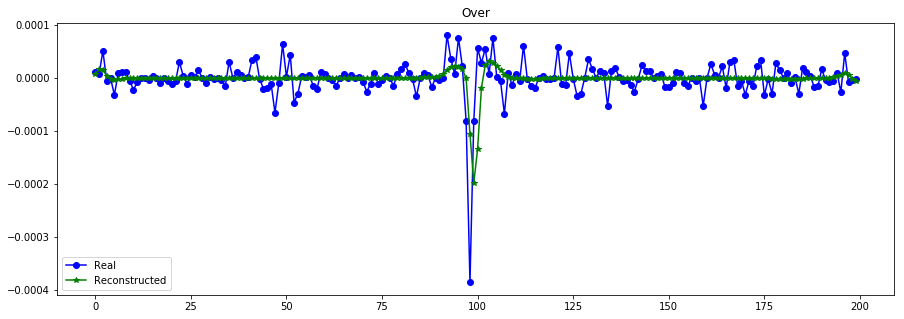

----------------------------------------------------------------


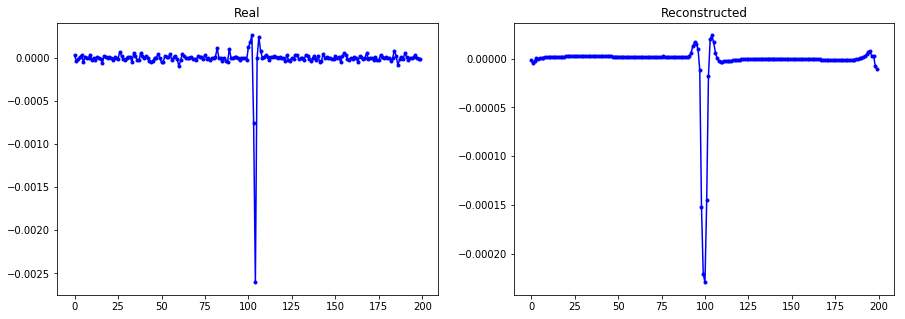

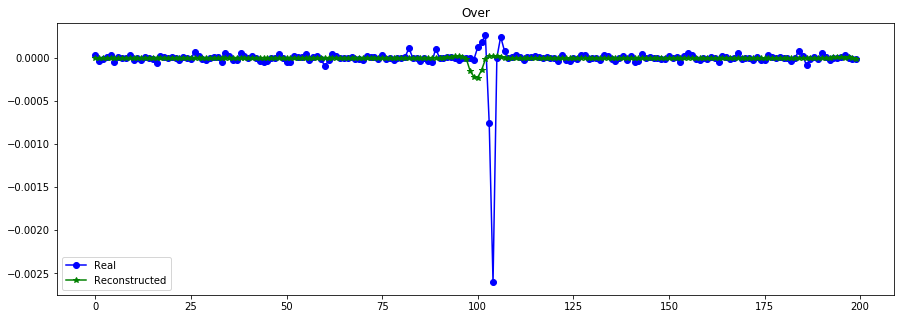

----------------------------------------------------------------


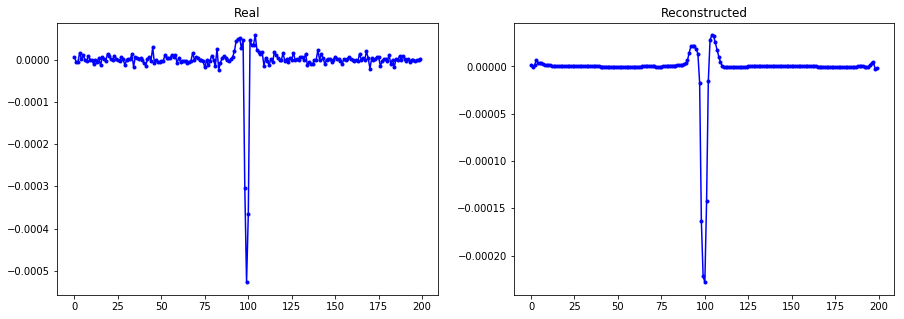

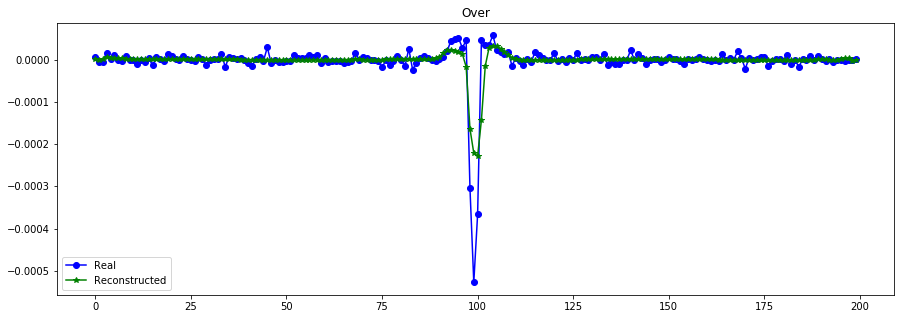

----------------------------------------------------------------


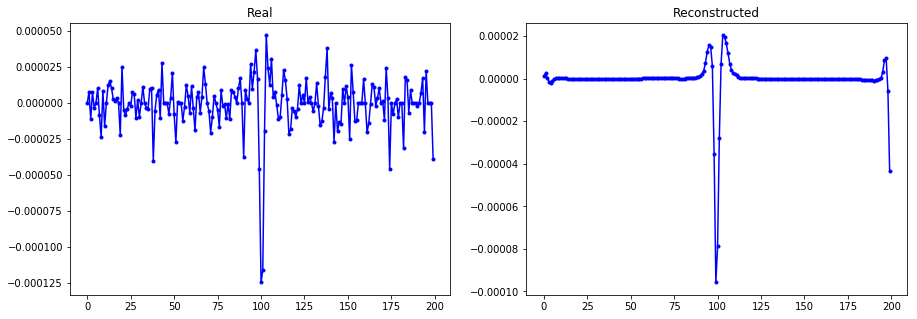

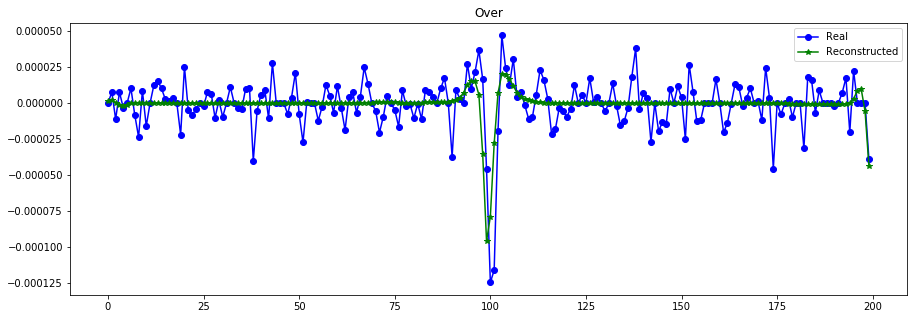

----------------------------------------------------------------


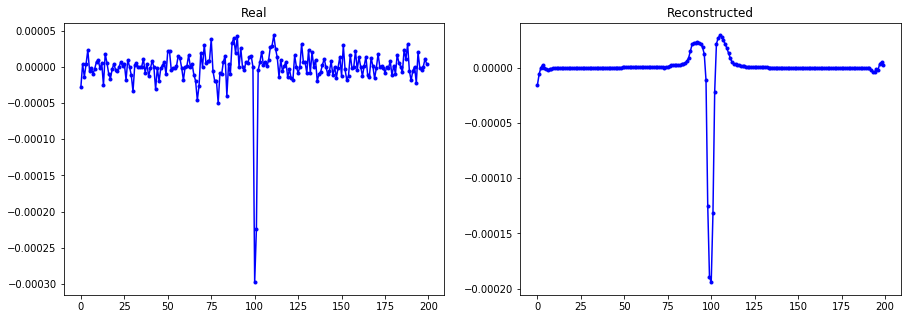

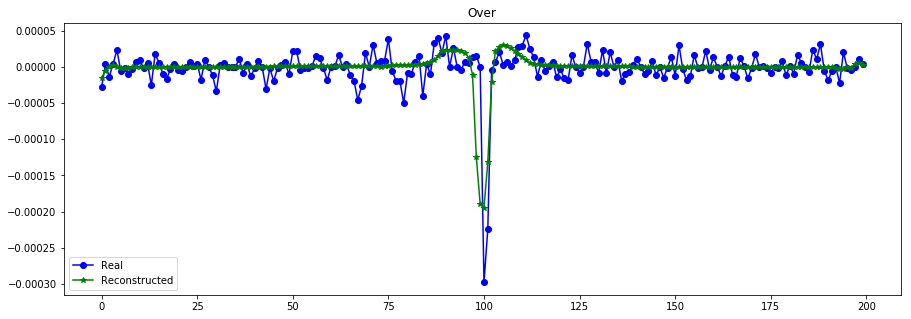

----------------------------------------------------------------


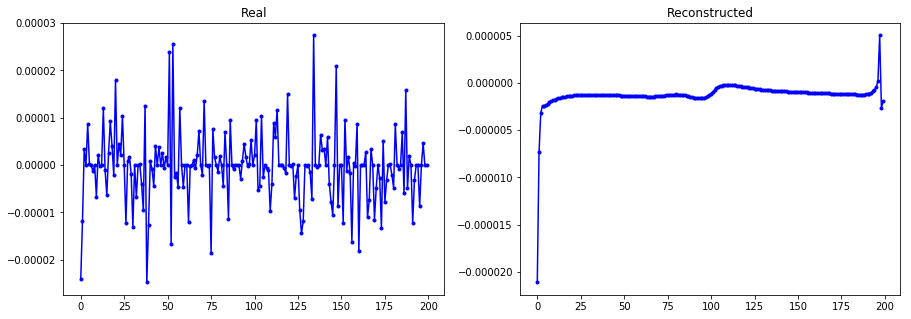

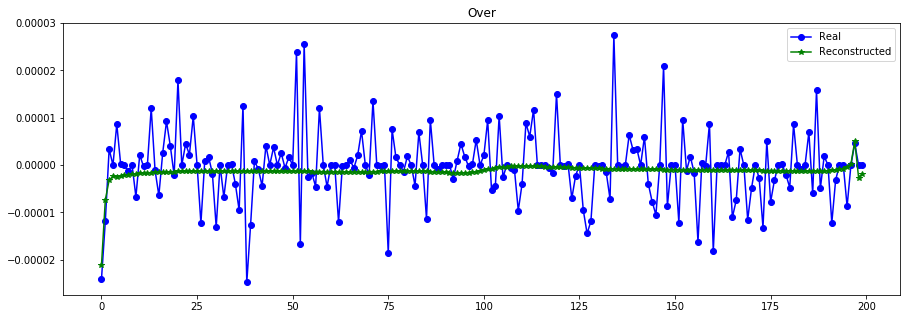

----------------------------------------------------------------


In [198]:
print("Errores ",vae.evaluate([X_test_t,X_test, S_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train, S_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 15) #

In [199]:
print(mean_squared_error(S_train, s_model.predict([X_train_t,X_train, S_train], batch_size=512) ))
s_model.predict([X_train_t,X_train, S_train], batch_size=512)

array([[266742.75],
       [278990.7 ],
       [328088.  ],
       ...,
       [273924.66],
       [259893.2 ],
       [338685.44]], dtype=float32)

In [201]:
batch_size = 64
vae.fit([X_train_t,X_train, S_train], X_train, epochs=500, batch_size=batch_size, sample_weight=(S_train**2)[:,0],
        validation_data=([X_test_t,X_test,S_test], X_test)) #con dnese de 4 (deberia funcionar)

Train on 6484 samples, validate on 1075 samples
Epoch 1/500
6484/6484 [==============================] - 29s 5ms/step - loss: 1.0806 - MSE_loss: 1.4266e-07 - val_loss: 7.9732e-08 - val_MSE_loss: 7.9732e-08
Epoch 2/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0028 - MSE_loss: 1.4264e-07 - val_loss: 7.9717e-08 - val_MSE_loss: 7.9717e-08
Epoch 3/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0021 - MSE_loss: 1.4262e-07 - val_loss: 7.9693e-08 - val_MSE_loss: 7.9693e-08
Epoch 4/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.0076 - MSE_loss: 1.4263e-07 - val_loss: 7.9739e-08 - val_MSE_loss: 7.9739e-08
Epoch 5/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.3167 - MSE_loss: 1.4276e-07 - val_loss: 7.9727e-08 - val_MSE_loss: 7.9727e-08
Epoch 6/500
6484/6484 [==============================] - 11s 2ms/step - loss: 1.1228 - MSE_loss: 1.4264e-07 - val_loss: 7.9702e-08 - val_MSE_loss: 7.9702e-08
Epoc

6484/6484 [==============================] - 11s 2ms/step - loss: 0.8374 - MSE_loss: 1.3956e-07 - val_loss: 7.6900e-08 - val_MSE_loss: 7.6900e-08
Epoch 104/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8116 - MSE_loss: 1.3936e-07 - val_loss: 7.7250e-08 - val_MSE_loss: 7.7250e-08
Epoch 105/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8225 - MSE_loss: 1.3934e-07 - val_loss: 7.6813e-08 - val_MSE_loss: 7.6813e-08
Epoch 106/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8080 - MSE_loss: 1.3928e-07 - val_loss: 7.6817e-08 - val_MSE_loss: 7.6817e-08
Epoch 107/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8106 - MSE_loss: 1.3920e-07 - val_loss: 7.6810e-08 - val_MSE_loss: 7.6810e-08
Epoch 108/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.8174 - MSE_loss: 1.3918e-07 - val_loss: 7.6862e-08 - val_MSE_loss: 7.6862e-08
Epoch 109/500
6484/6484 [=============================

6484/6484 [==============================] - 11s 2ms/step - loss: 0.7031 - MSE_loss: 1.2881e-07 - val_loss: 6.8395e-08 - val_MSE_loss: 6.8395e-08
Epoch 206/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6919 - MSE_loss: 1.2908e-07 - val_loss: 6.9147e-08 - val_MSE_loss: 6.9147e-08
Epoch 207/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6978 - MSE_loss: 1.2844e-07 - val_loss: 6.7195e-08 - val_MSE_loss: 6.7195e-08
Epoch 208/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.7009 - MSE_loss: 1.2794e-07 - val_loss: 6.7391e-08 - val_MSE_loss: 6.7391e-08
Epoch 209/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6901 - MSE_loss: 1.2756e-07 - val_loss: 6.6823e-08 - val_MSE_loss: 6.6823e-08
Epoch 210/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.7242 - MSE_loss: 1.2854e-07 - val_loss: 6.8464e-08 - val_MSE_loss: 6.8464e-08
Epoch 211/500
6484/6484 [=============================

6484/6484 [==============================] - 11s 2ms/step - loss: 0.7839 - MSE_loss: 1.3357e-07 - val_loss: 7.3843e-08 - val_MSE_loss: 7.3843e-08
Epoch 308/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.7130 - MSE_loss: 1.2432e-07 - val_loss: 6.2662e-08 - val_MSE_loss: 6.2662e-08
Epoch 309/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6827 - MSE_loss: 1.2227e-07 - val_loss: 6.2135e-08 - val_MSE_loss: 6.2135e-08
Epoch 310/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6654 - MSE_loss: 1.2059e-07 - val_loss: 6.2172e-08 - val_MSE_loss: 6.2172e-08
Epoch 311/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6746 - MSE_loss: 1.2048e-07 - val_loss: 6.1150e-08 - val_MSE_loss: 6.1150e-08
Epoch 312/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6550 - MSE_loss: 1.1984e-07 - val_loss: 6.0133e-08 - val_MSE_loss: 6.0133e-08
Epoch 313/500
6484/6484 [=============================

6484/6484 [==============================] - 11s 2ms/step - loss: 0.5879 - MSE_loss: 1.1125e-07 - val_loss: 5.4053e-08 - val_MSE_loss: 5.4053e-08
Epoch 410/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.5942 - MSE_loss: 1.1152e-07 - val_loss: 5.3240e-08 - val_MSE_loss: 5.3240e-08
Epoch 411/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.6213 - MSE_loss: 1.2541e-07 - val_loss: 6.1482e-08 - val_MSE_loss: 6.1482e-08
Epoch 412/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.5670 - MSE_loss: 1.1063e-07 - val_loss: 5.3210e-08 - val_MSE_loss: 5.3210e-08
Epoch 413/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.5787 - MSE_loss: 1.0868e-07 - val_loss: 5.2048e-08 - val_MSE_loss: 5.2048e-08
Epoch 414/500
6484/6484 [==============================] - 11s 2ms/step - loss: 0.5738 - MSE_loss: 1.0699e-07 - val_loss: 5.2603e-08 - val_MSE_loss: 5.2603e-08
Epoch 415/500
6484/6484 [=============================

1075/1075 [==============================] - 0s 254us/step
Errores  [4.8834259010025494e-08, 4.8834259010025494e-08]


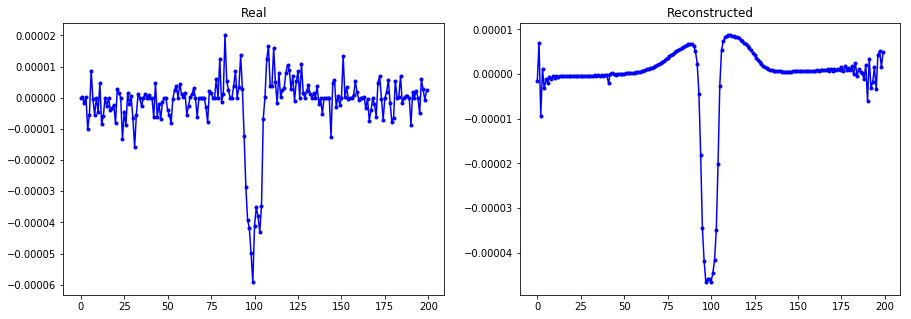

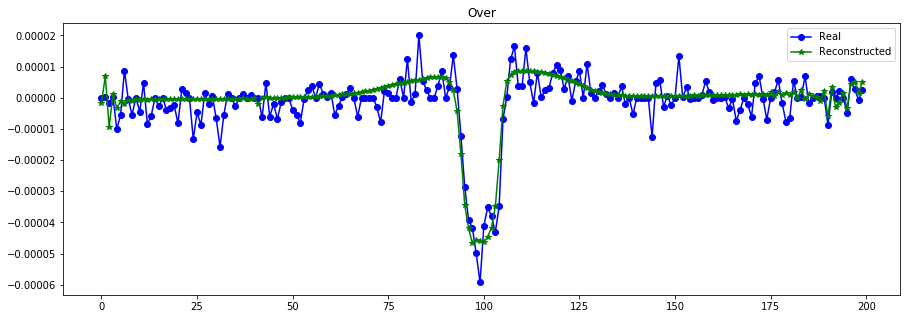

----------------------------------------------------------------


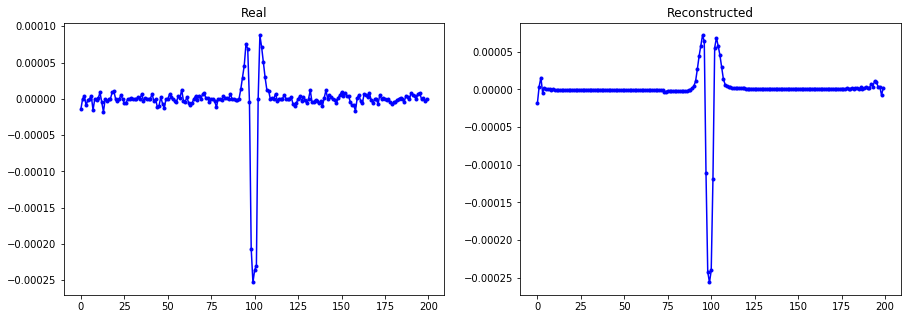

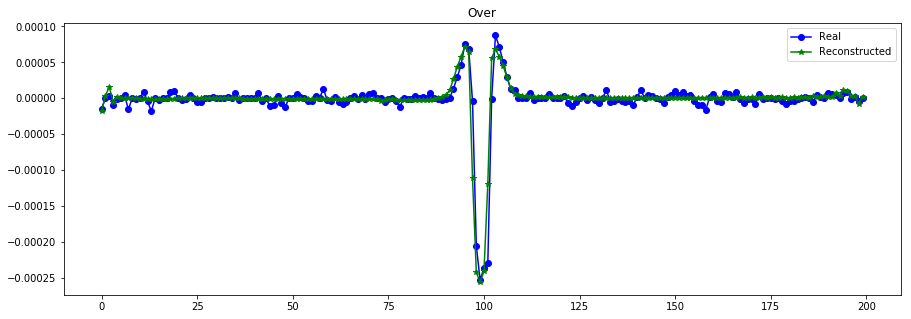

----------------------------------------------------------------


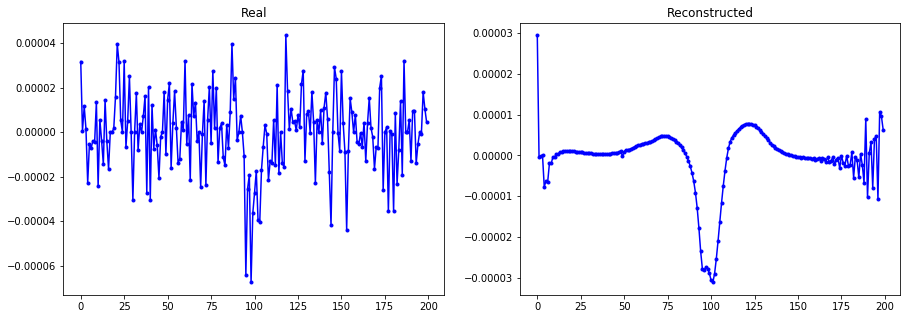

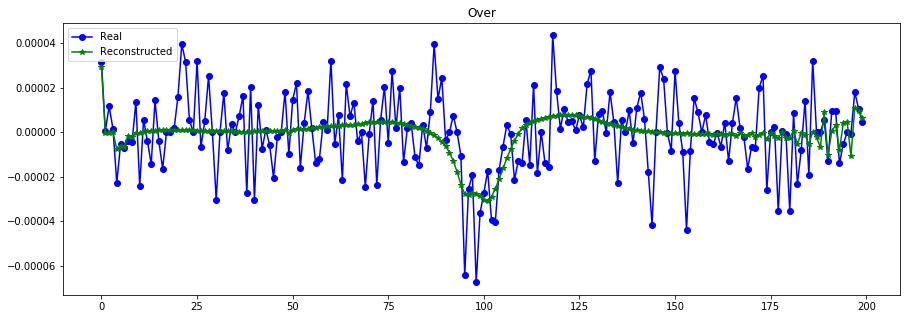

----------------------------------------------------------------


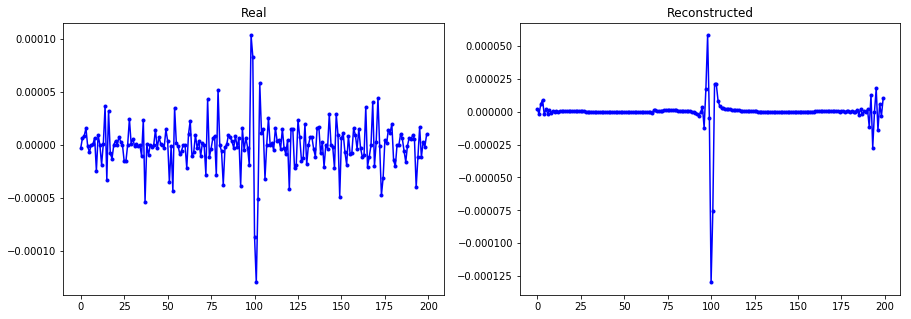

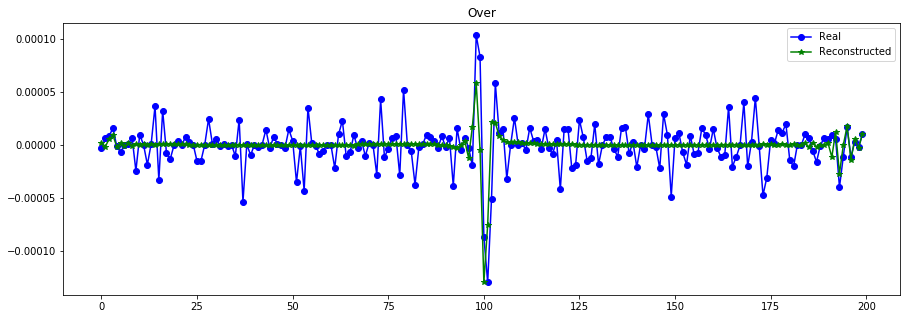

----------------------------------------------------------------


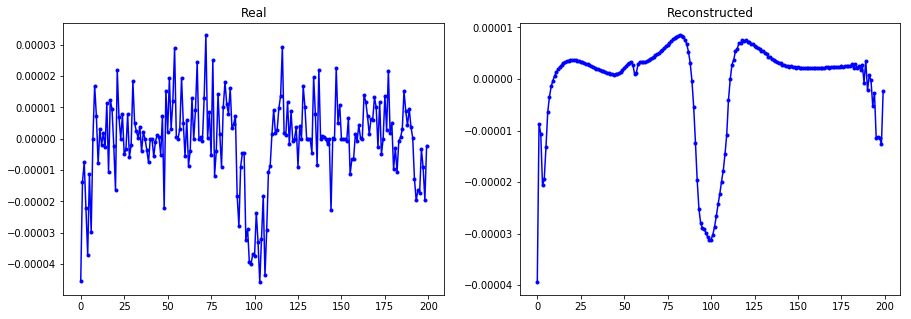

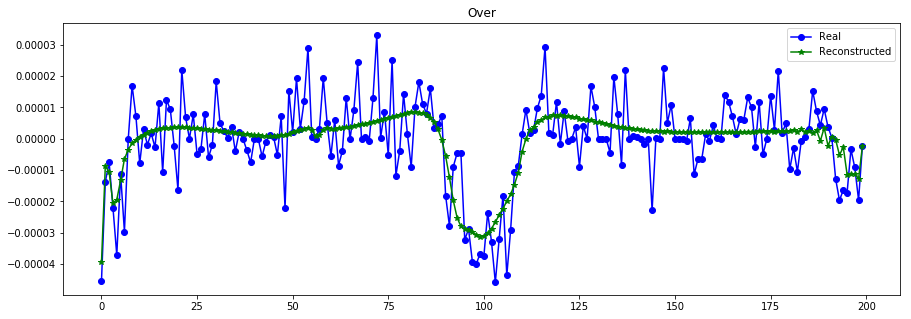

----------------------------------------------------------------


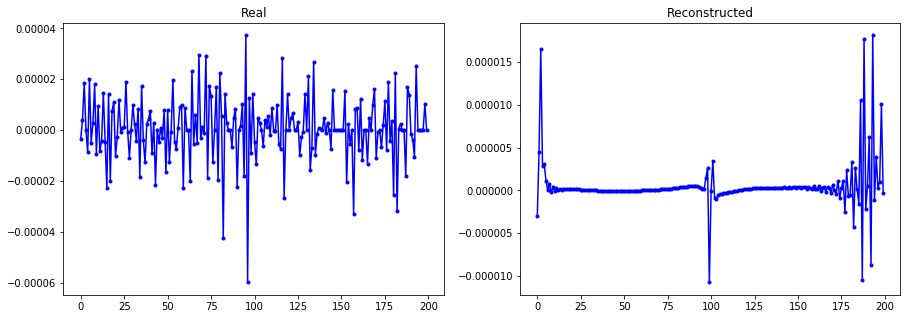

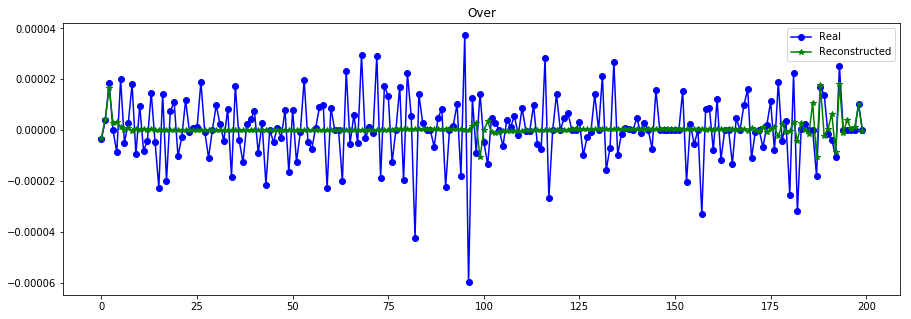

----------------------------------------------------------------


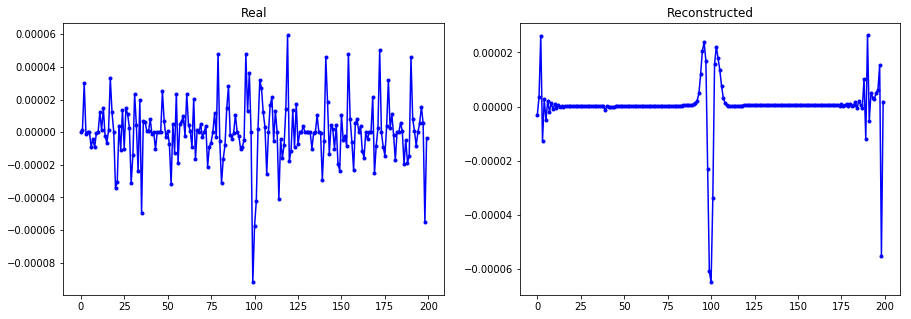

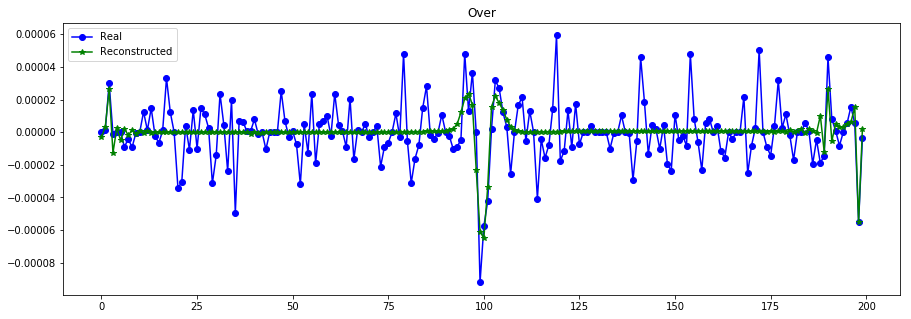

----------------------------------------------------------------


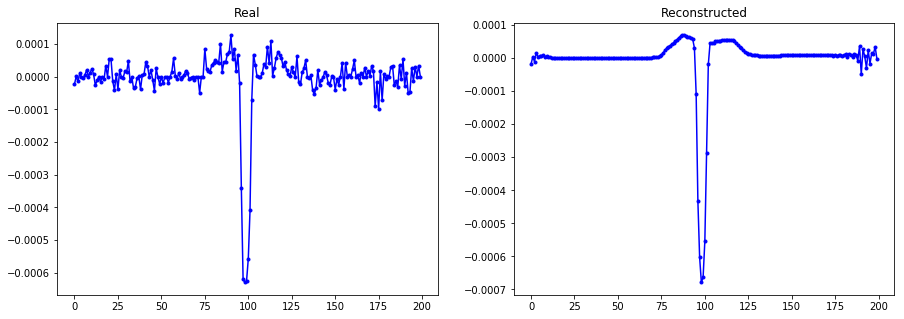

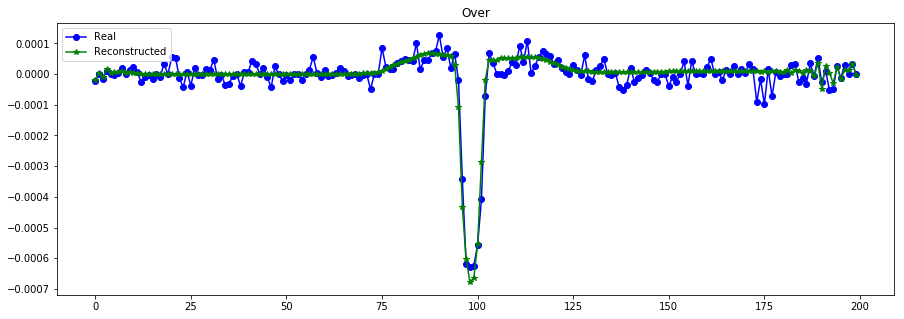

----------------------------------------------------------------


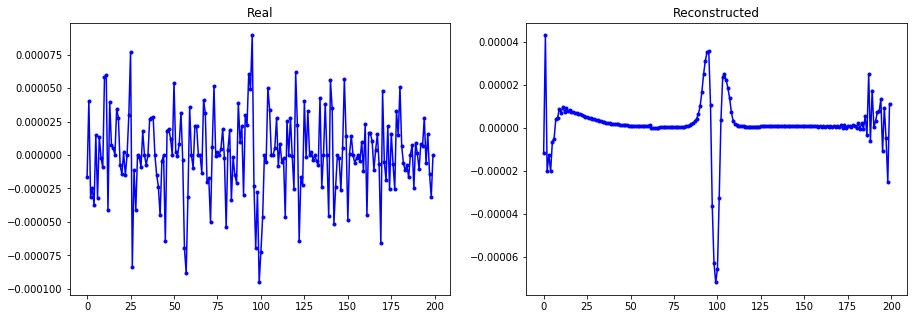

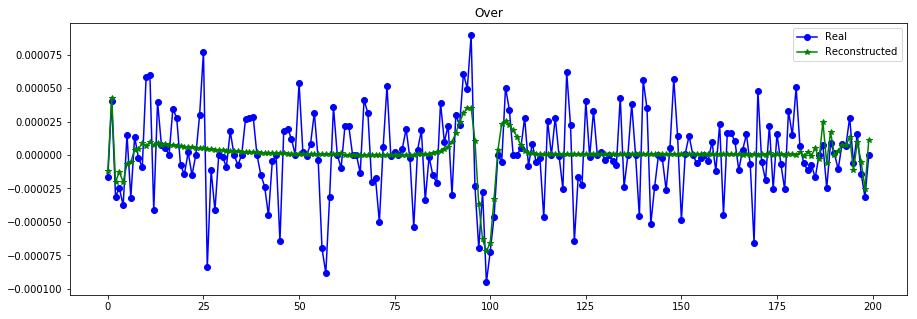

----------------------------------------------------------------


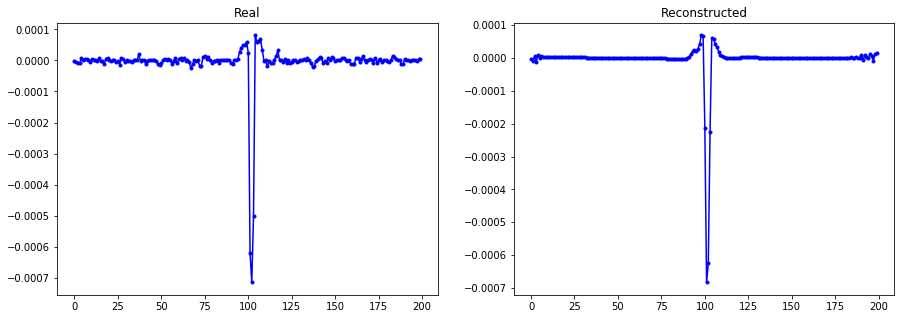

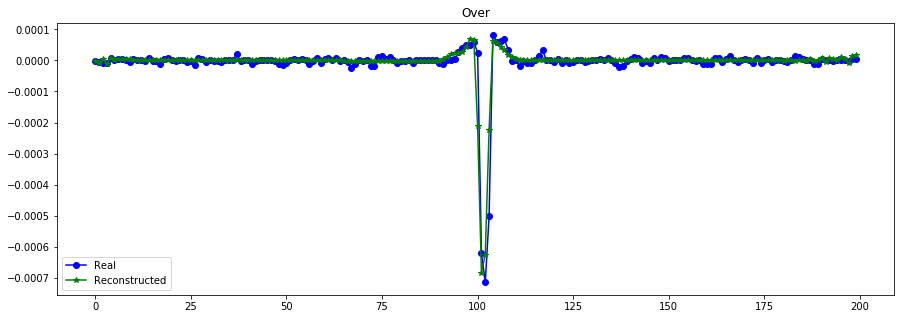

----------------------------------------------------------------


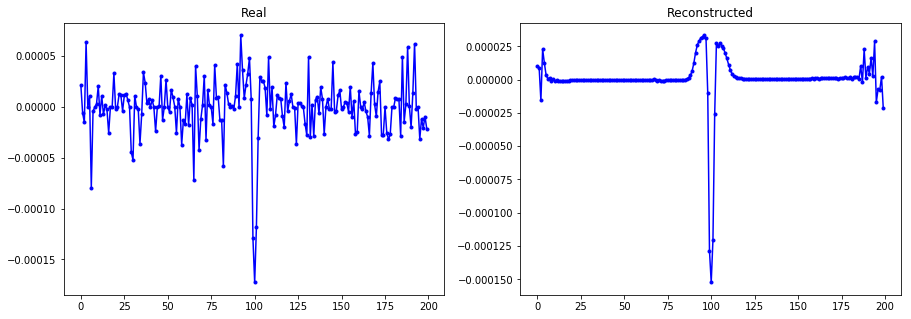

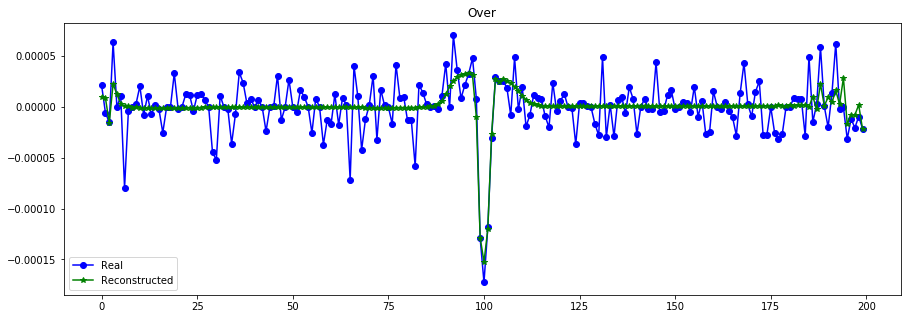

----------------------------------------------------------------


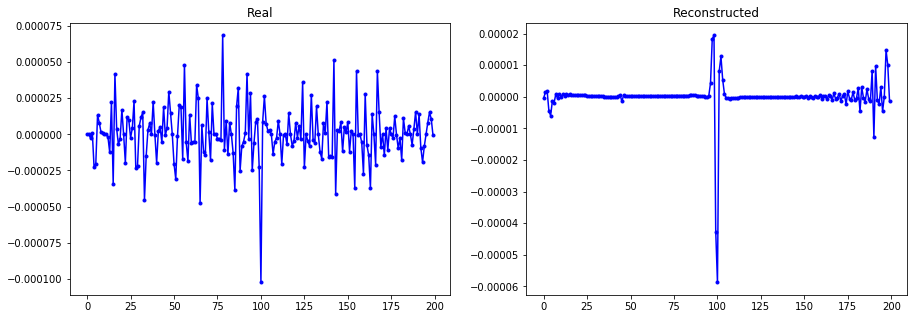

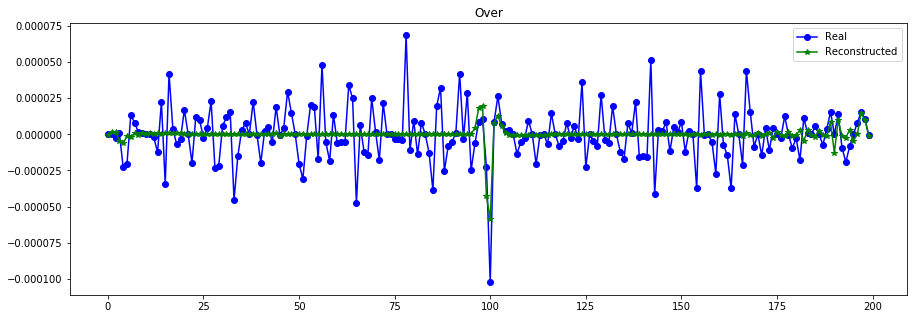

----------------------------------------------------------------


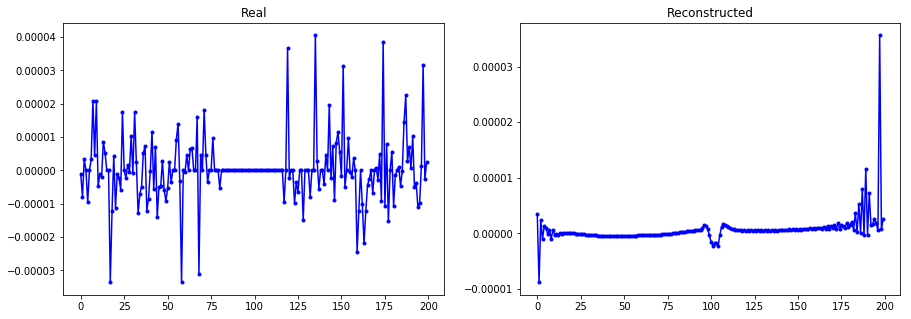

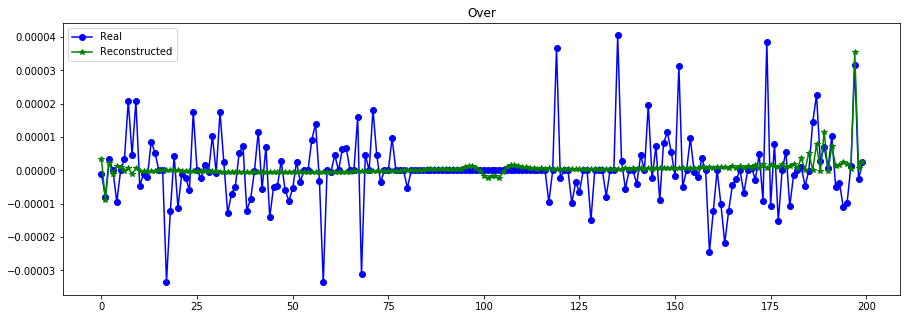

----------------------------------------------------------------


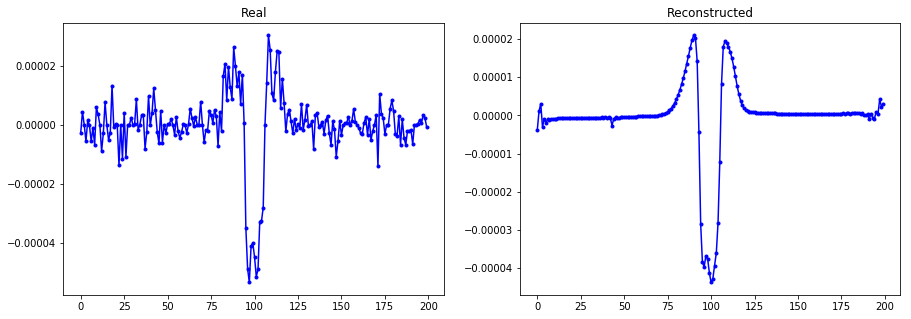

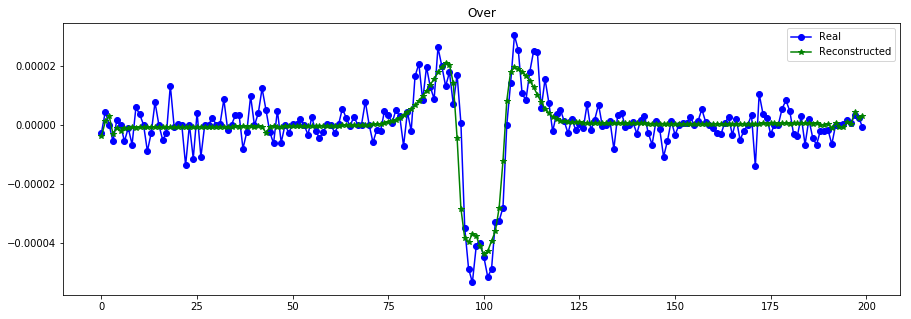

----------------------------------------------------------------


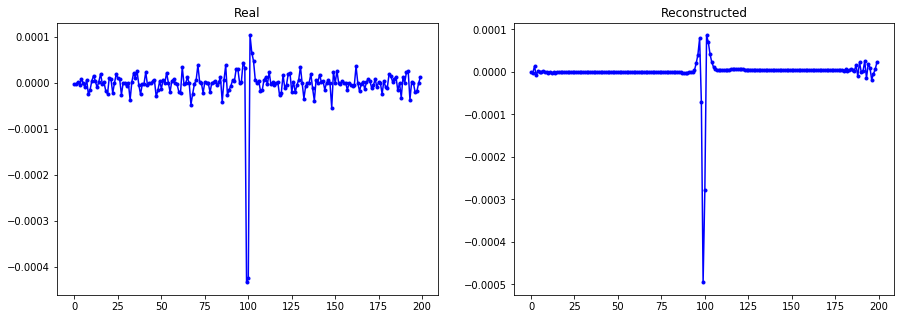

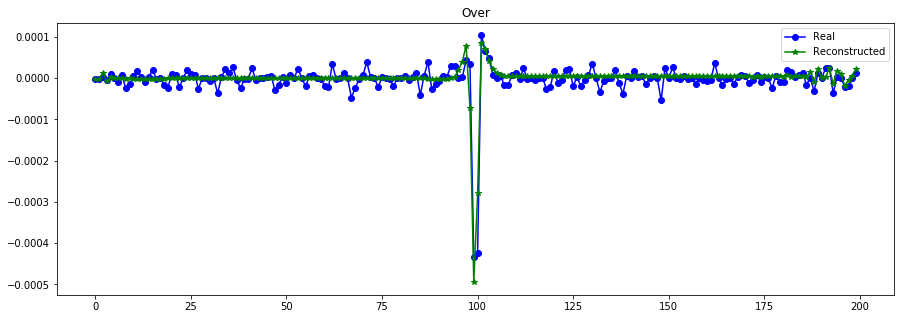

----------------------------------------------------------------


In [202]:
print("Errores ",vae.evaluate([X_test_t,X_test, S_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train, S_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 15) #

In [205]:
s_model.predict([X_train_t,X_train, S_train], batch_size=512)

array([[24222.707],
       [24222.707],
       [24222.707],
       ...,
       [24222.707],
       [24222.707],
       [24222.707]], dtype=float32)

In [24]:
np.median(S_train)

43770.12764662853

In [22]:
S_mu_tr = np.tile(S_mu, (S_train.shape[0],1))
S_mu_te = np.tile(S_mu, (S_test.shape[0],1))
S_mu_tr

array([[74305.40928046],
       [74305.40928046],
       [74305.40928046],
       ...,
       [74305.40928046],
       [74305.40928046],
       [74305.40928046]])

In [37]:
batch_size = 64
vae.fit([X_train_t,X_train, S_mu_tr], X_train, epochs=200, batch_size=batch_size, sample_weight=(S_train**2)[:,0],
        validation_data=([X_test_t,X_test,S_mu_te], X_test)) #con std global entrada a 1

Train on 6446 samples, validate on 1094 samples
Epoch 1/200
6446/6446 [==============================] - 15s 2ms/step - loss: 1.0050 - MSE_loss: 1.3506e-07 - val_loss: 1.0348e-07 - val_MSE_loss: 1.0348e-07
Epoch 2/200
6446/6446 [==============================] - 11s 2ms/step - loss: 1.3316 - MSE_loss: 1.3596e-07 - val_loss: 1.0374e-07 - val_MSE_loss: 1.0374e-07
Epoch 3/200
6446/6446 [==============================] - 11s 2ms/step - loss: 2.2618 - MSE_loss: 1.3699e-07 - val_loss: 1.0351e-07 - val_MSE_loss: 1.0351e-07
Epoch 4/200
6446/6446 [==============================] - 11s 2ms/step - loss: 1.0034 - MSE_loss: 1.3511e-07 - val_loss: 1.0351e-07 - val_MSE_loss: 1.0351e-07
Epoch 5/200
6446/6446 [==============================] - 11s 2ms/step - loss: 1.0033 - MSE_loss: 1.3511e-07 - val_loss: 1.0351e-07 - val_MSE_loss: 1.0351e-07
Epoch 6/200
6446/6446 [==============================] - 11s 2ms/step - loss: 1.0032 - MSE_loss: 1.3511e-07 - val_loss: 1.0351e-07 - val_MSE_loss: 1.0351e-07
Epoc

6446/6446 [==============================] - 11s 2ms/step - loss: 0.9719 - MSE_loss: 1.3490e-07 - val_loss: 1.0335e-07 - val_MSE_loss: 1.0335e-07
Epoch 104/200
6446/6446 [==============================] - 11s 2ms/step - loss: 0.9742 - MSE_loss: 1.3487e-07 - val_loss: 1.0345e-07 - val_MSE_loss: 1.0345e-07
Epoch 105/200
6446/6446 [==============================] - 11s 2ms/step - loss: 0.9590 - MSE_loss: 1.3484e-07 - val_loss: 1.0329e-07 - val_MSE_loss: 1.0329e-07
Epoch 106/200
6446/6446 [==============================] - 11s 2ms/step - loss: 0.9584 - MSE_loss: 1.3480e-07 - val_loss: 1.0327e-07 - val_MSE_loss: 1.0327e-07
Epoch 107/200
6446/6446 [==============================] - 11s 2ms/step - loss: 0.9768 - MSE_loss: 1.3491e-07 - val_loss: 1.0349e-07 - val_MSE_loss: 1.0349e-07
Epoch 108/200
6446/6446 [==============================] - 11s 2ms/step - loss: 1.0013 - MSE_loss: 1.3506e-07 - val_loss: 1.0349e-07 - val_MSE_loss: 1.0349e-07
Epoch 109/200
6446/6446 [=============================

1094/1094 [==============================] - 0s 225us/step
Errores  [1.0349026829897019e-07, 1.0349026829897019e-07]


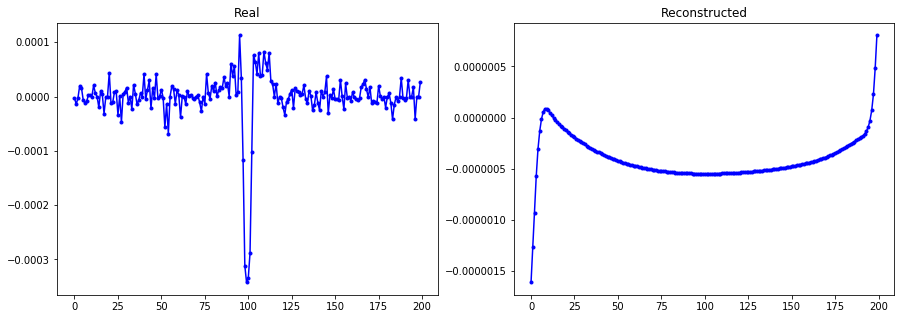

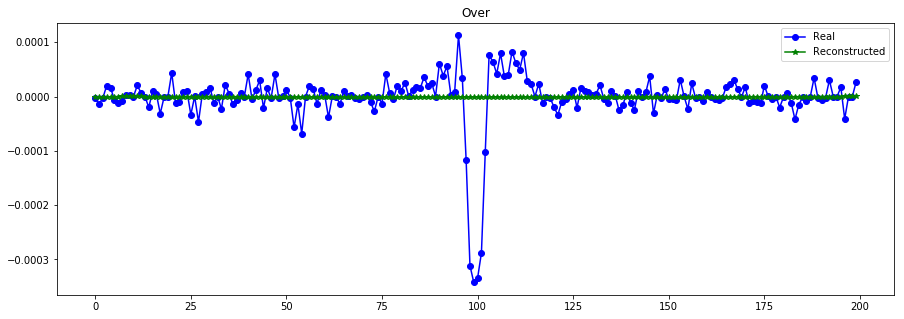

----------------------------------------------------------------


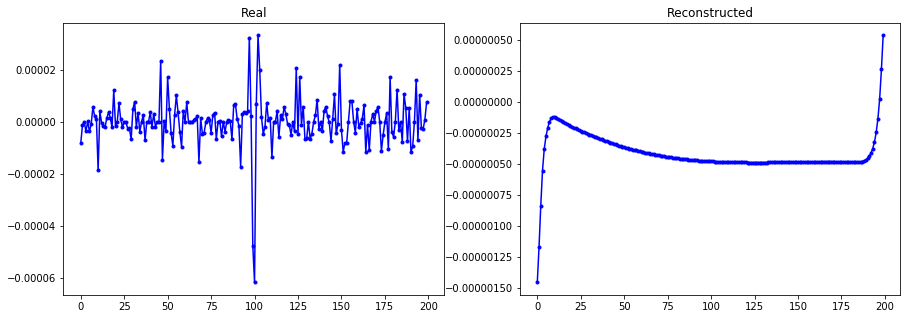

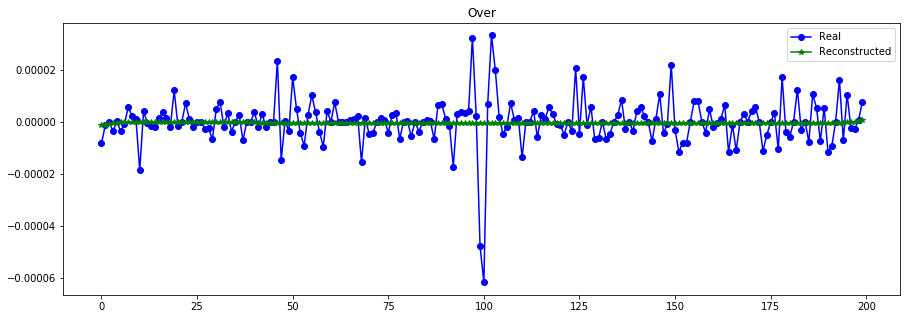

----------------------------------------------------------------


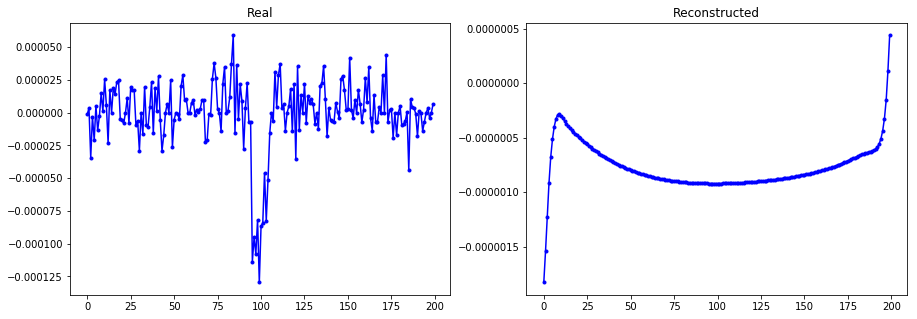

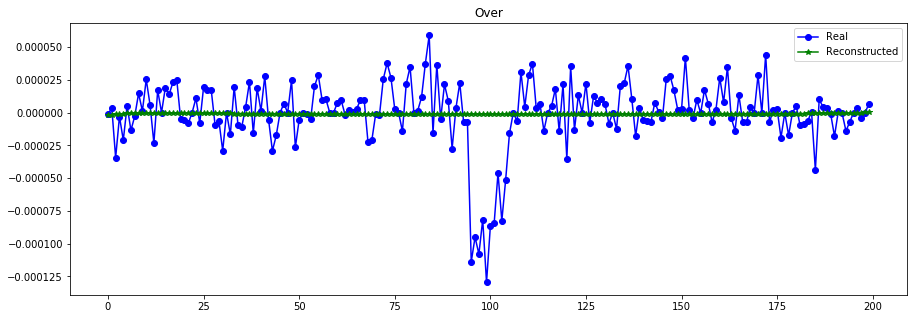

----------------------------------------------------------------


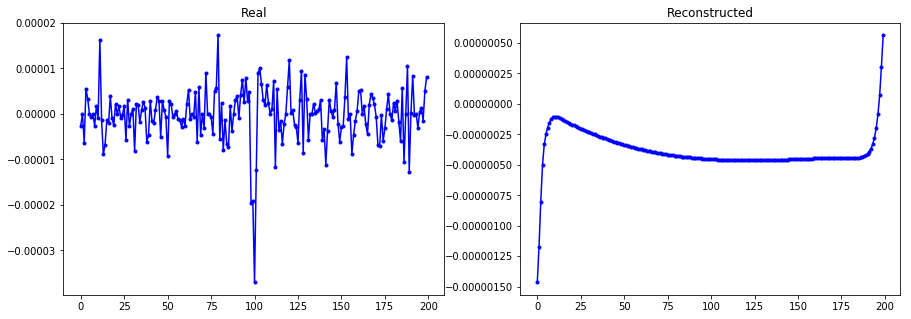

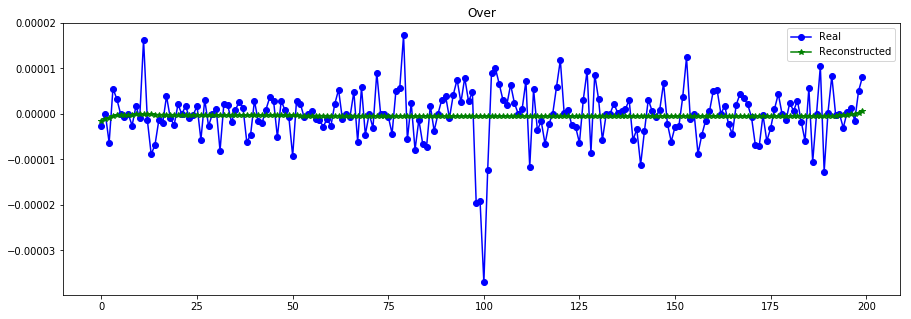

----------------------------------------------------------------


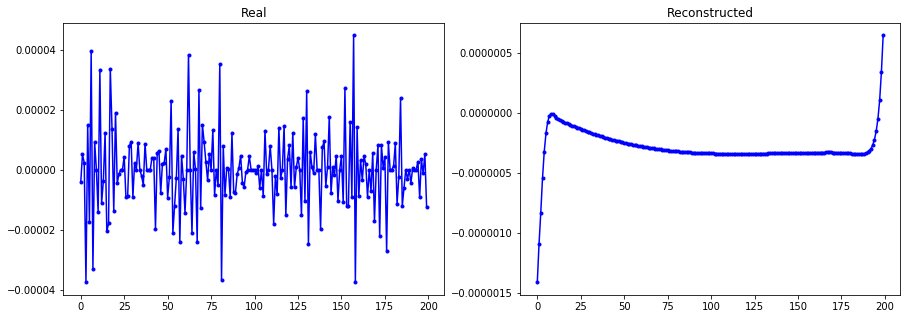

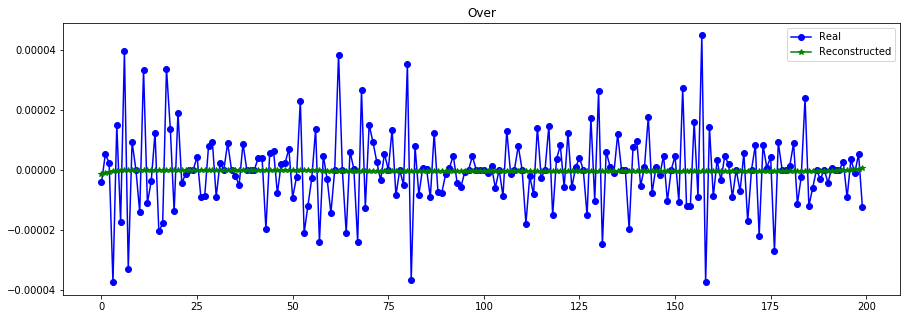

----------------------------------------------------------------


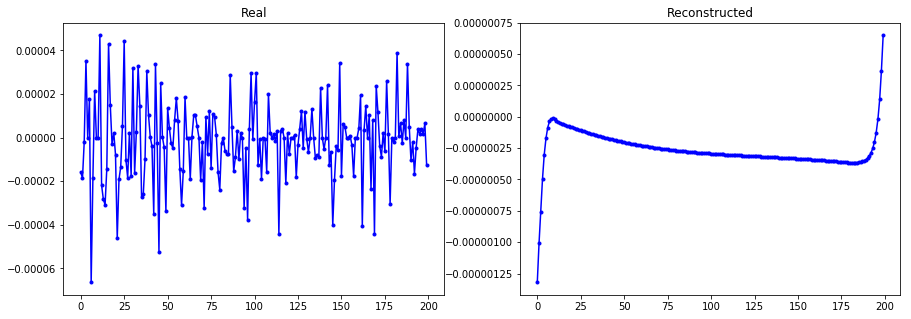

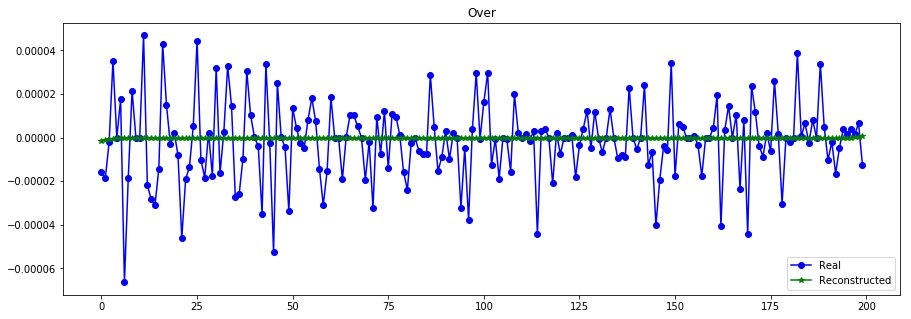

----------------------------------------------------------------


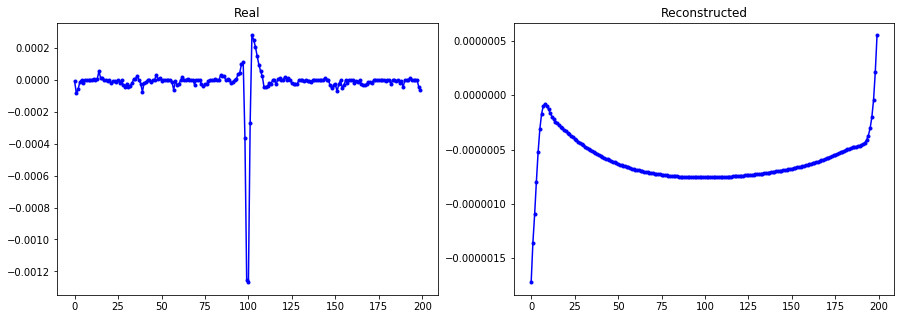

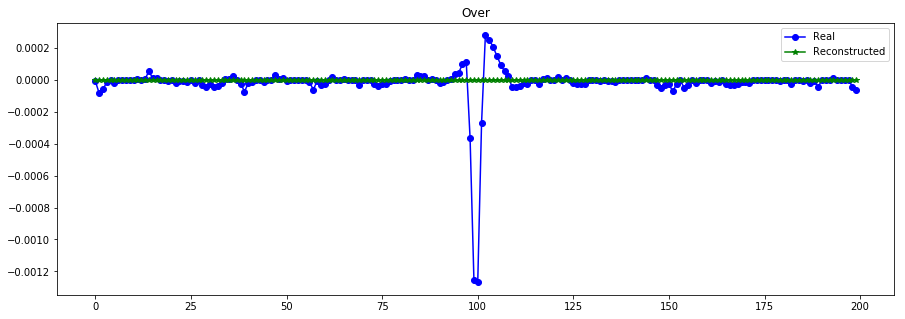

----------------------------------------------------------------


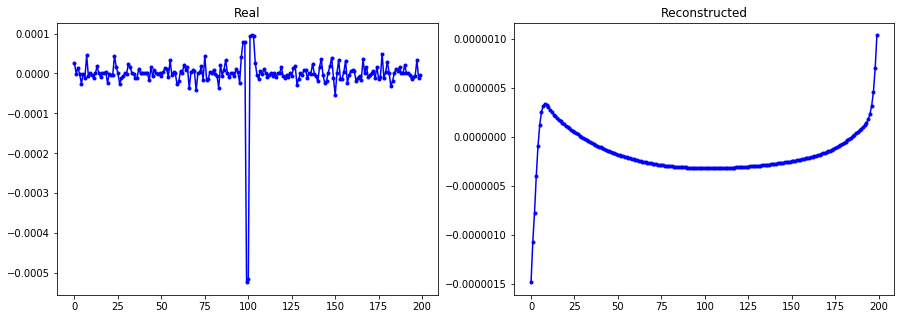

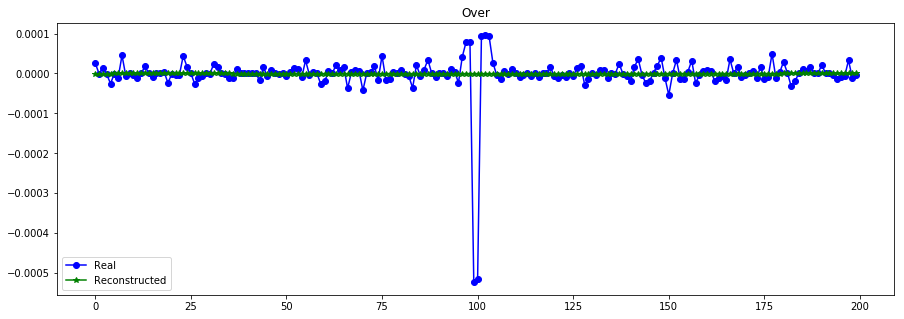

----------------------------------------------------------------


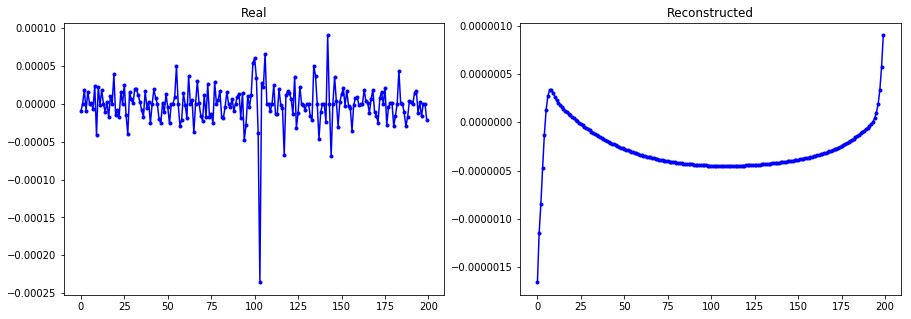

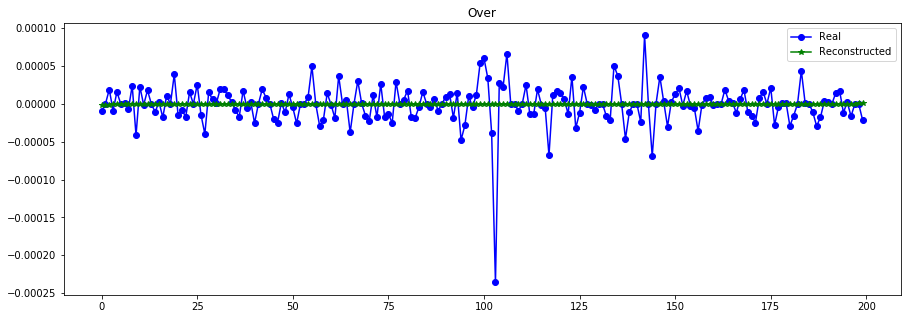

----------------------------------------------------------------


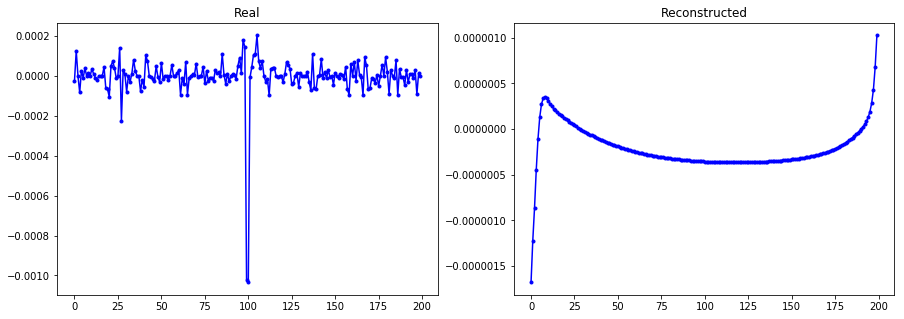

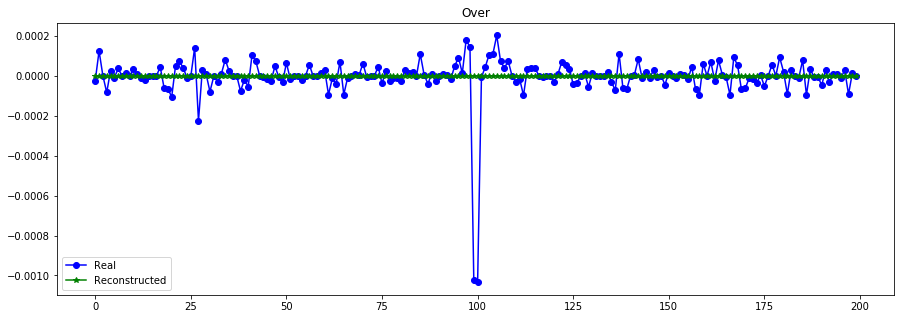

----------------------------------------------------------------


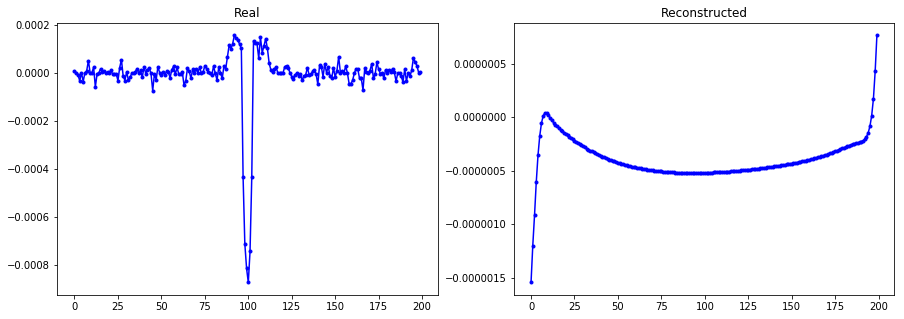

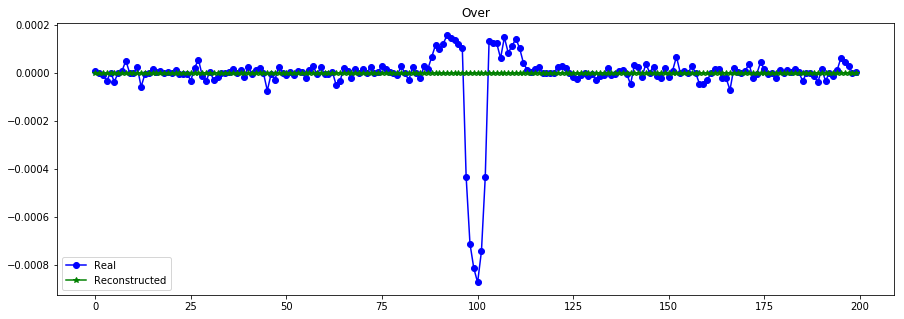

----------------------------------------------------------------


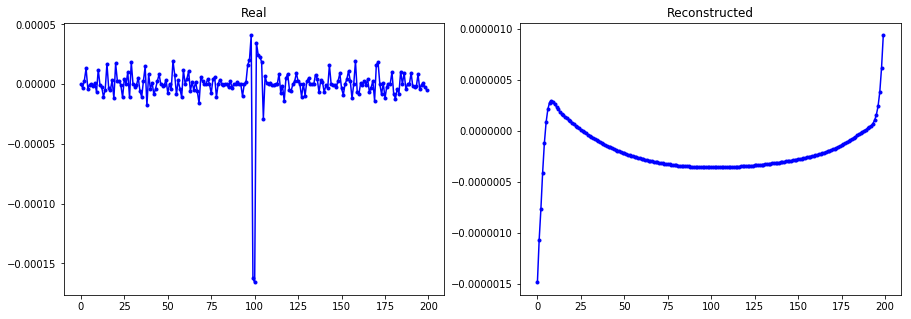

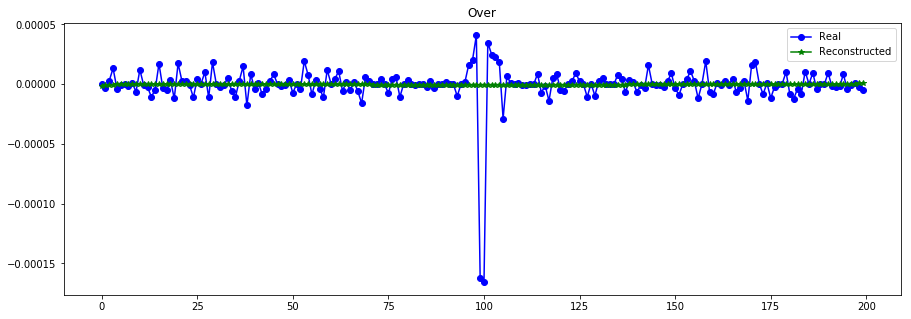

----------------------------------------------------------------


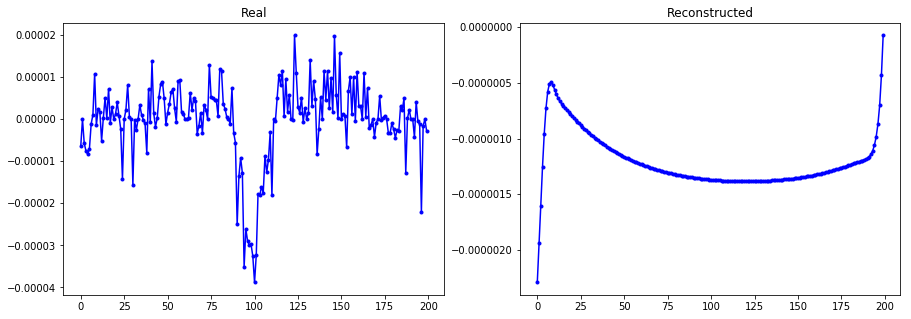

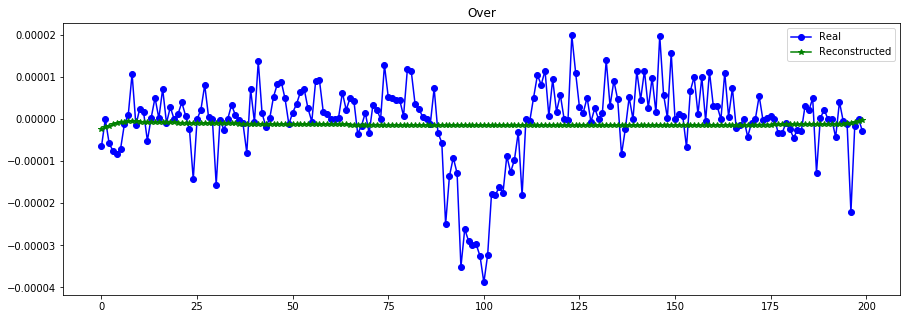

----------------------------------------------------------------


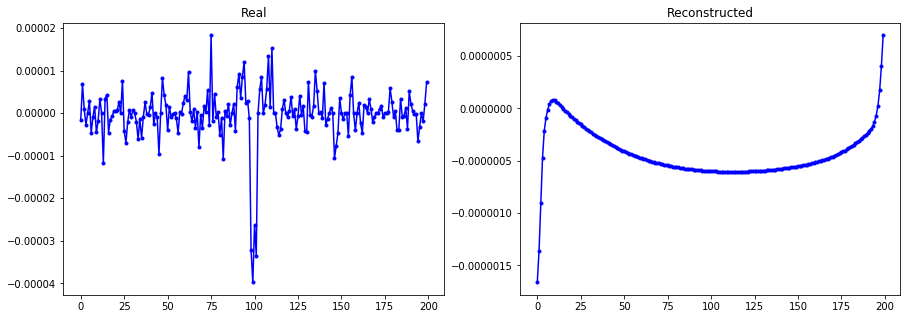

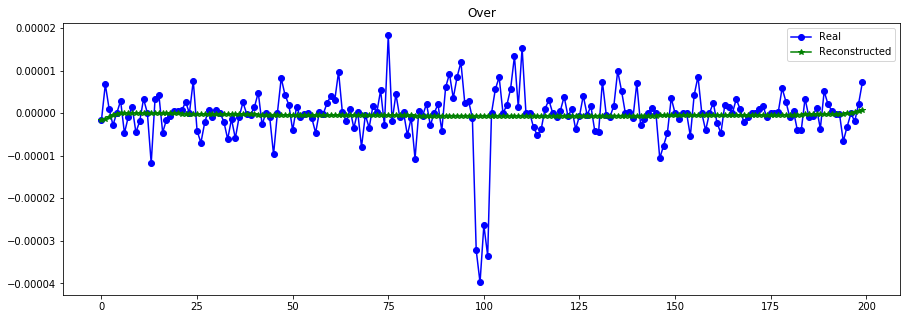

----------------------------------------------------------------


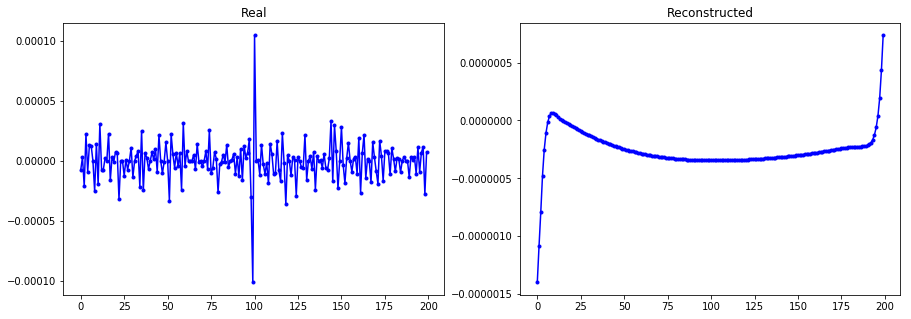

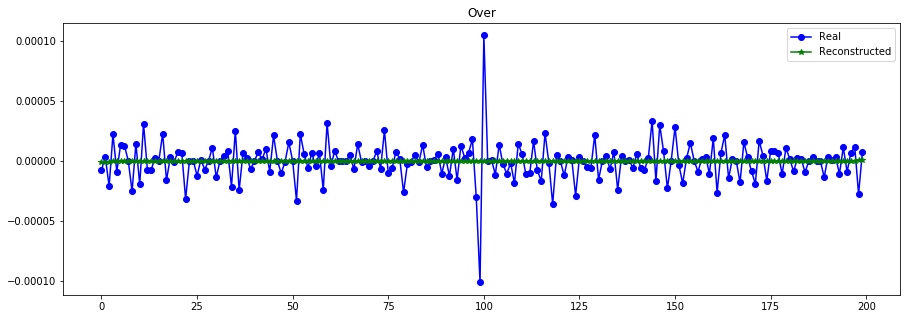

----------------------------------------------------------------


In [38]:
print("Errores ",vae.evaluate([X_test_t,X_test, S_test], X_test, batch_size=512))
X_train_hat = vae.predict([X_train_t,X_train, S_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 15) #

In [ ]:
### loss entre s y s_out/hat

In [43]:
##### INPUTS ENCODER ######
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")
s = Input(shape= (1,), name="scale_inp") #NEW: Extension: depende de x

x_lc_s = Lambda(Multiply_layer, name="Multiply")([x_lc,s]) #NEW: escalar data

##### CODIFY LIGHT CURVE ######
x = Concatenate(axis=-1)([x_t, x_lc_s]) 
f1 = Bidirectional(CuDNNGRU(64, return_sequences=True))(x)
f1 = Bidirectional(CuDNNGRU(64, return_sequences=False))(f1) 

##### GET THE LATENT VARIABLE ######
z_mean = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc, s], z_mean, name="encoder")

##### INPUTS DECODER ######
decoder_input = Input(shape=(latent_dim,))

##### RECONSTRUCT LIGHT CURVE ######
decode = RepeatVector(T)(decoder_input)
decode = Concatenate(axis=-1)([x_t, decode]) #add time decode
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(CuDNNGRU(64, return_sequences=True))(decode) #bidirectional
decode = TimeDistributed(Dense(1, activation='linear'))(decode)

decode = Lambda(Divide_layer, name="Divide")([decode, s]) #NEW: 

generator = Model([x_t, decoder_input, s], decode, name="generator")

##### VAE MODEL ######
out = generator([x_t, encoder([x_t, x_lc, s]), s])  #samp_encoder([x_t, x_lc, s]) ])
vae = Model([x_t, x_lc, s], out)

vae.compile(optimizer='adam', loss=MSE_loss, metrics = [MSE_loss])
vae.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
scale_inp (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
encoder (Model)                 (None, 32)           104736      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
          

In [44]:
batch_size = 64
vae.fit([X_train_t,X_train, S_train], X_train, epochs=500, batch_size=batch_size, sample_weight=(S_train**2)[:,0],
        validation_data=([X_test_t,X_test,S_test], X_test)) #el mejor con loss sobre escala real

Train on 6490 samples, validate on 1072 samples
Epoch 1/500
6490/6490 [==============================] - 14s 2ms/step - loss: 1.0003 - MSE_loss: 1.2958e-07 - val_loss: 1.0969e-07 - val_MSE_loss: 1.0969e-07
Epoch 2/500
6490/6490 [==============================] - 10s 2ms/step - loss: 0.9989 - MSE_loss: 1.2927e-07 - val_loss: 1.0947e-07 - val_MSE_loss: 1.0947e-07
Epoch 3/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.9963 - MSE_loss: 1.2791e-07 - val_loss: 1.0911e-07 - val_MSE_loss: 1.0911e-07
Epoch 4/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.9921 - MSE_loss: 1.2651e-07 - val_loss: 1.0727e-07 - val_MSE_loss: 1.0727e-07
Epoch 5/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.9869 - MSE_loss: 1.2498e-07 - val_loss: 1.0610e-07 - val_MSE_loss: 1.0610e-07
Epoch 6/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.9813 - MSE_loss: 1.2442e-07 - val_loss: 1.0619e-07 - val_MSE_loss: 1.0619e-07
Epoc

6490/6490 [==============================] - 12s 2ms/step - loss: 0.6080 - MSE_loss: 1.5894e-08 - val_loss: 2.2029e-08 - val_MSE_loss: 2.2029e-08
Epoch 104/500
6490/6490 [==============================] - 12s 2ms/step - loss: 0.6106 - MSE_loss: 1.8496e-08 - val_loss: 8.1092e-09 - val_MSE_loss: 8.1092e-09
Epoch 105/500
6490/6490 [==============================] - 12s 2ms/step - loss: 0.5979 - MSE_loss: 1.4653e-08 - val_loss: 7.4358e-09 - val_MSE_loss: 7.4358e-09
Epoch 106/500
6490/6490 [==============================] - 12s 2ms/step - loss: 0.6014 - MSE_loss: 1.5453e-08 - val_loss: 7.5990e-09 - val_MSE_loss: 7.5990e-09
Epoch 107/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.6010 - MSE_loss: 1.4583e-08 - val_loss: 1.1759e-08 - val_MSE_loss: 1.1759e-08
Epoch 108/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5949 - MSE_loss: 1.4651e-08 - val_loss: 1.0339e-08 - val_MSE_loss: 1.0339e-08
Epoch 109/500
6490/6490 [=============================

6490/6490 [==============================] - 11s 2ms/step - loss: 0.5346 - MSE_loss: 1.2964e-08 - val_loss: 9.6239e-09 - val_MSE_loss: 9.6239e-09
Epoch 206/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5448 - MSE_loss: 1.4085e-08 - val_loss: 6.2179e-09 - val_MSE_loss: 6.2179e-09
Epoch 207/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5340 - MSE_loss: 1.2089e-08 - val_loss: 7.2489e-09 - val_MSE_loss: 7.2489e-09
Epoch 208/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5248 - MSE_loss: 1.1655e-08 - val_loss: 7.0194e-09 - val_MSE_loss: 7.0194e-09
Epoch 209/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5806 - MSE_loss: 1.7799e-08 - val_loss: 9.7321e-09 - val_MSE_loss: 9.7321e-09
Epoch 210/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5714 - MSE_loss: 1.6580e-08 - val_loss: 6.1199e-09 - val_MSE_loss: 6.1199e-09
Epoch 211/500
6490/6490 [=============================

6490/6490 [==============================] - 11s 2ms/step - loss: 0.4851 - MSE_loss: 9.5741e-09 - val_loss: 6.8843e-09 - val_MSE_loss: 6.8843e-09
Epoch 308/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5147 - MSE_loss: 1.0752e-08 - val_loss: 8.4585e-09 - val_MSE_loss: 8.4585e-09
Epoch 309/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4922 - MSE_loss: 8.7989e-09 - val_loss: 1.1428e-08 - val_MSE_loss: 1.1428e-08
Epoch 310/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4832 - MSE_loss: 9.0528e-09 - val_loss: 6.3130e-09 - val_MSE_loss: 6.3130e-09
Epoch 311/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.5268 - MSE_loss: 1.3546e-08 - val_loss: 7.3451e-09 - val_MSE_loss: 7.3451e-09
Epoch 312/500
6490/6490 [==============================] - 12s 2ms/step - loss: 0.5022 - MSE_loss: 9.5636e-09 - val_loss: 8.6051e-09 - val_MSE_loss: 8.6051e-09
Epoch 313/500
6490/6490 [=============================

6490/6490 [==============================] - 11s 2ms/step - loss: 0.4472 - MSE_loss: 5.0488e-09 - val_loss: 6.2963e-09 - val_MSE_loss: 6.2963e-09
Epoch 410/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4395 - MSE_loss: 4.7313e-09 - val_loss: 6.5365e-09 - val_MSE_loss: 6.5365e-09
Epoch 411/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4852 - MSE_loss: 8.3682e-09 - val_loss: 5.8742e-09 - val_MSE_loss: 5.8742e-09
Epoch 412/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4383 - MSE_loss: 5.6079e-09 - val_loss: 8.2071e-09 - val_MSE_loss: 8.2071e-09
Epoch 413/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4310 - MSE_loss: 6.0164e-09 - val_loss: 6.7010e-09 - val_MSE_loss: 6.7010e-09
Epoch 414/500
6490/6490 [==============================] - 11s 2ms/step - loss: 0.4321 - MSE_loss: 6.2635e-09 - val_loss: 7.3273e-09 - val_MSE_loss: 7.3273e-09
Epoch 415/500
6490/6490 [=============================

Error scaled mse=  0.5479242113136348


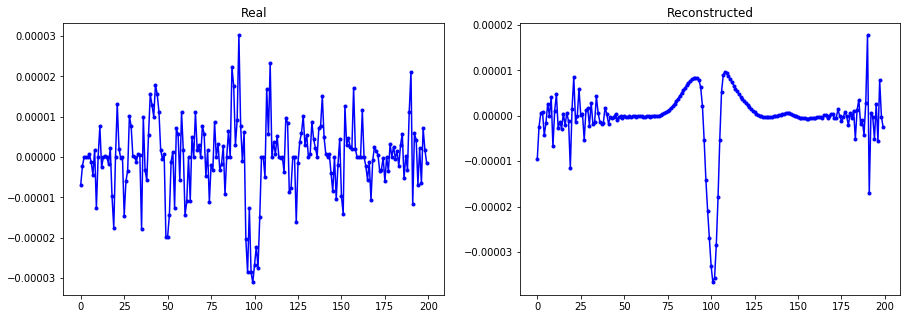

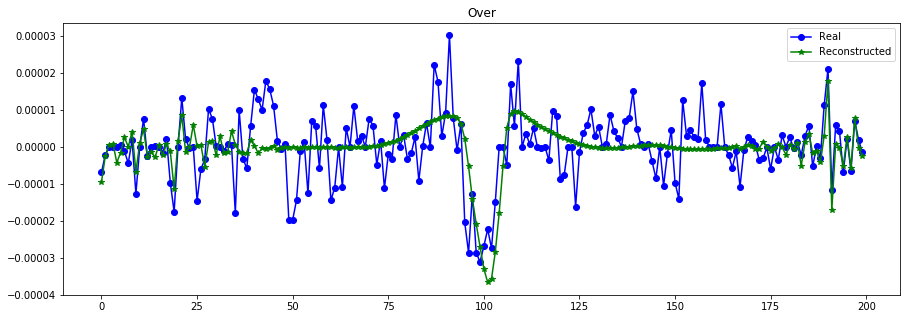

----------------------------------------------------------------


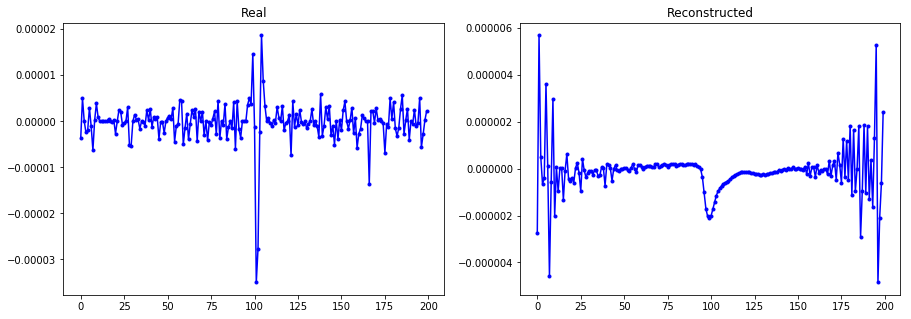

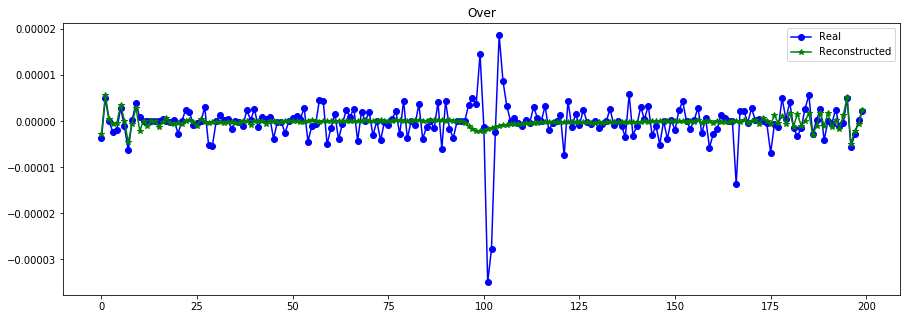

----------------------------------------------------------------


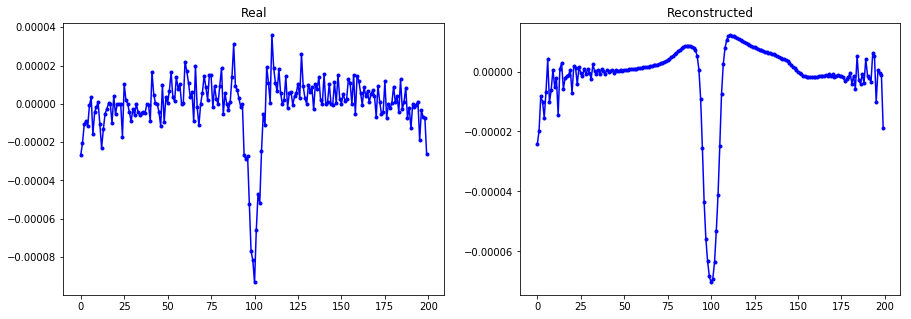

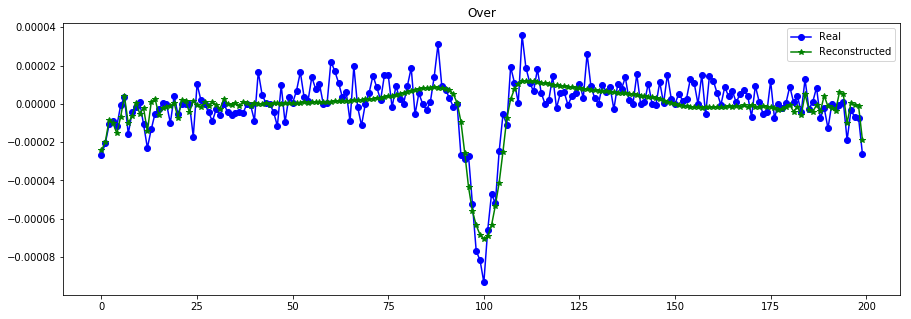

----------------------------------------------------------------


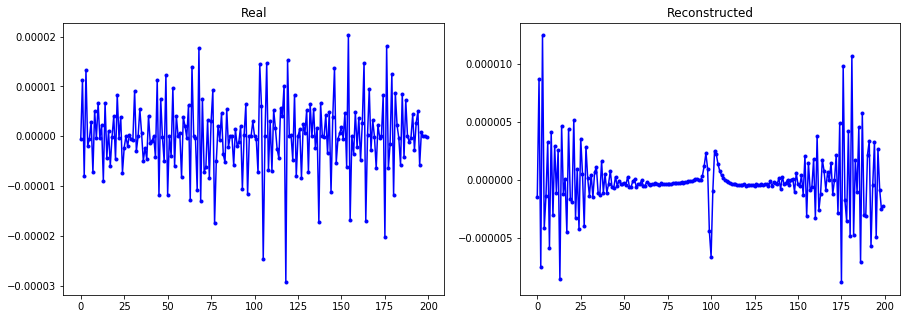

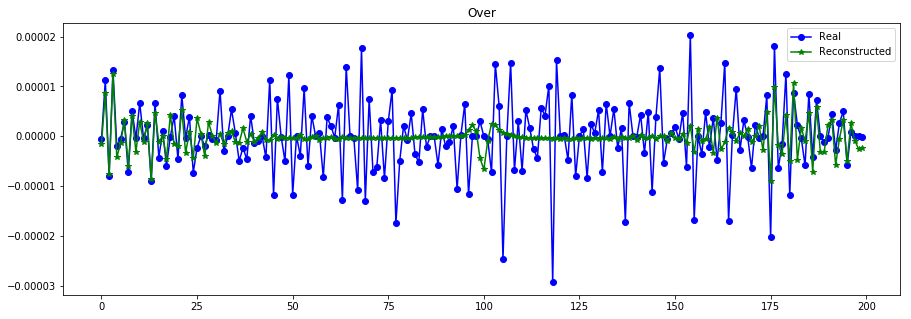

----------------------------------------------------------------


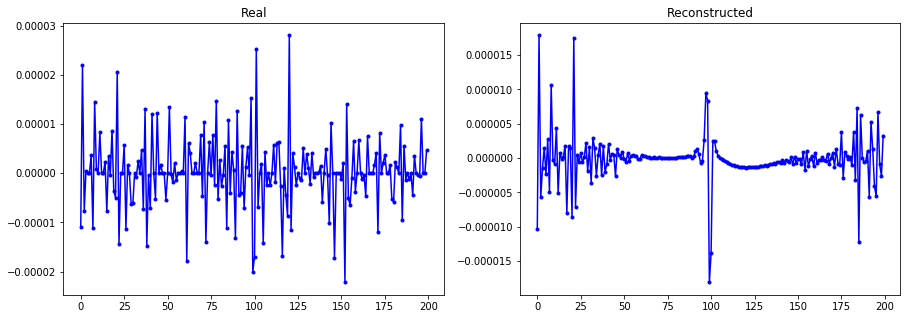

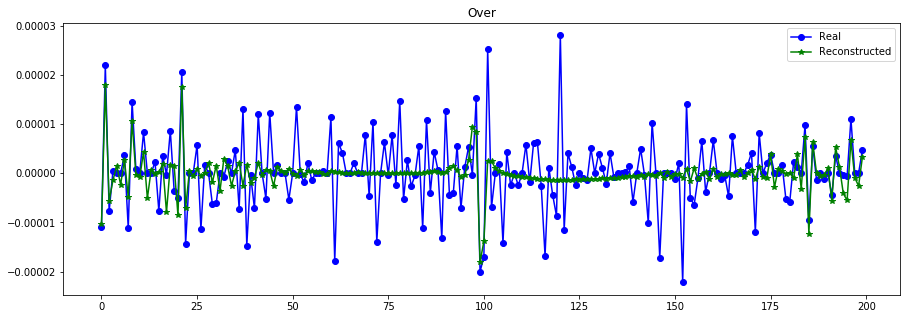

----------------------------------------------------------------


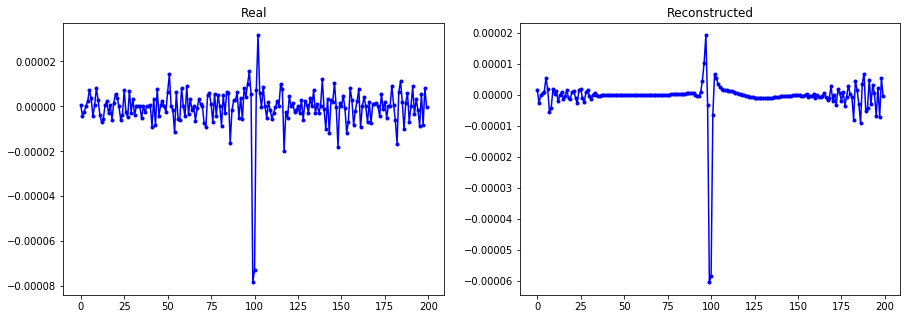

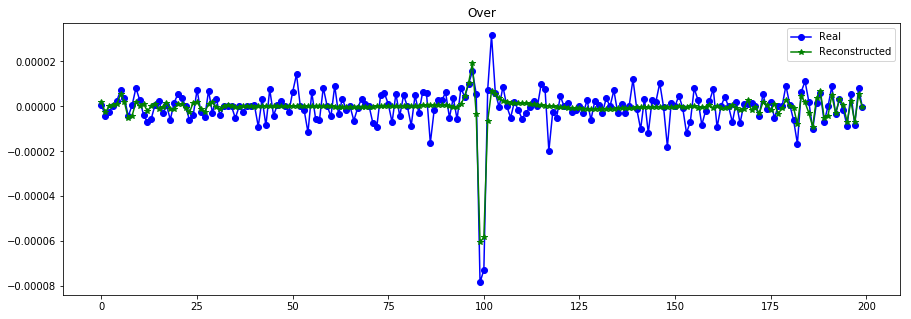

----------------------------------------------------------------


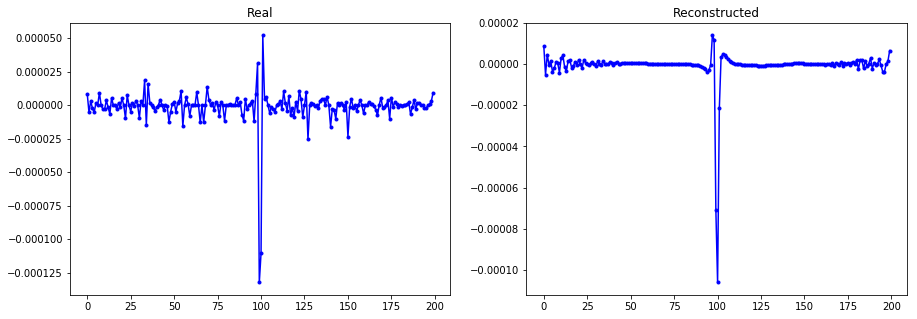

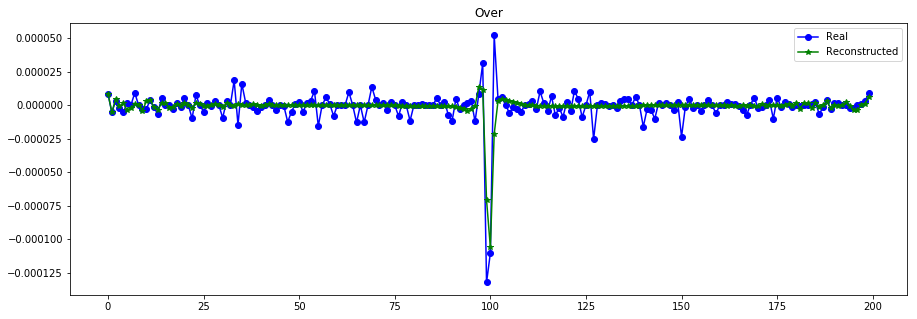

----------------------------------------------------------------


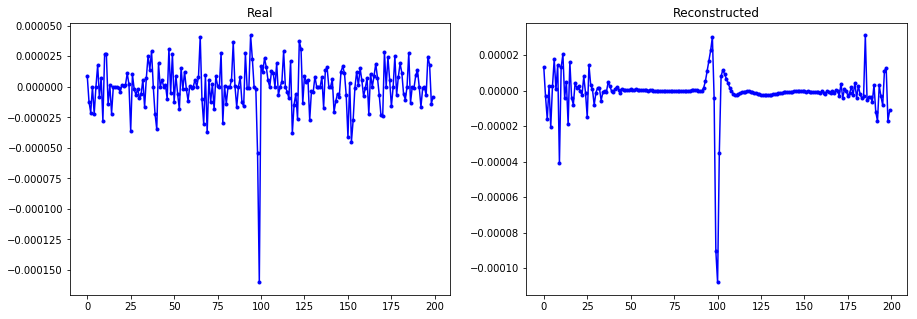

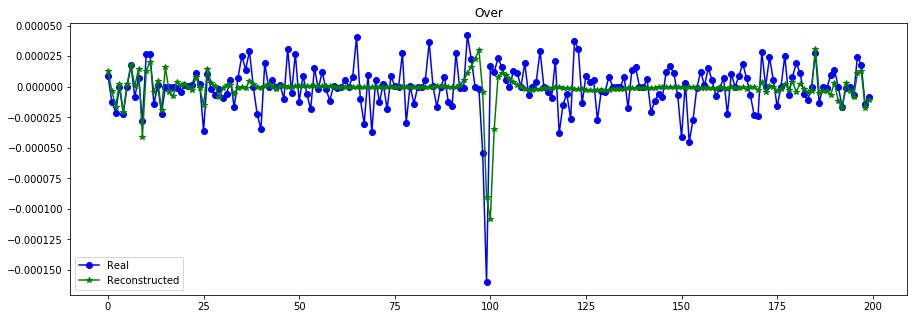

----------------------------------------------------------------


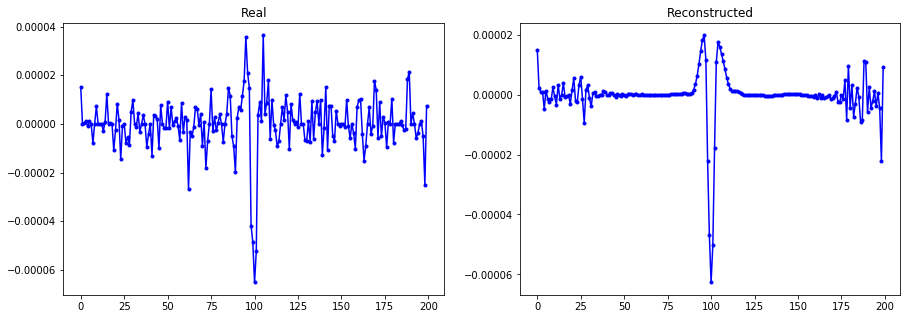

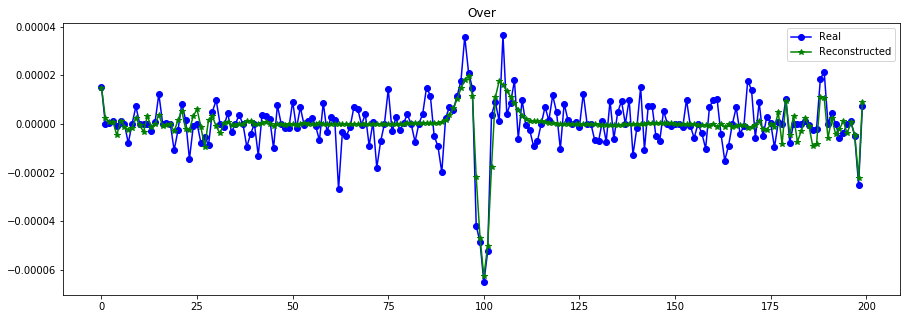

----------------------------------------------------------------


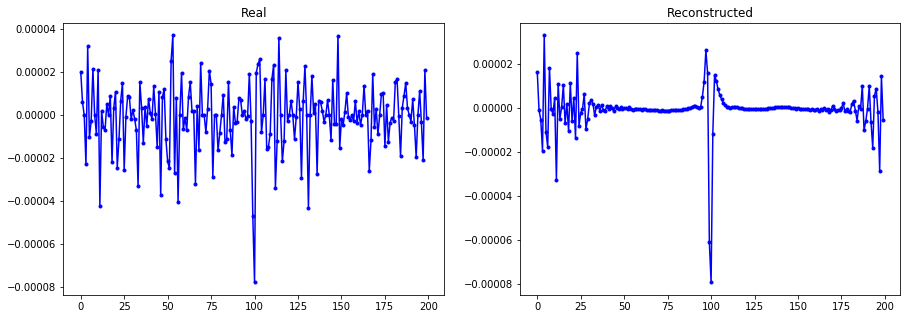

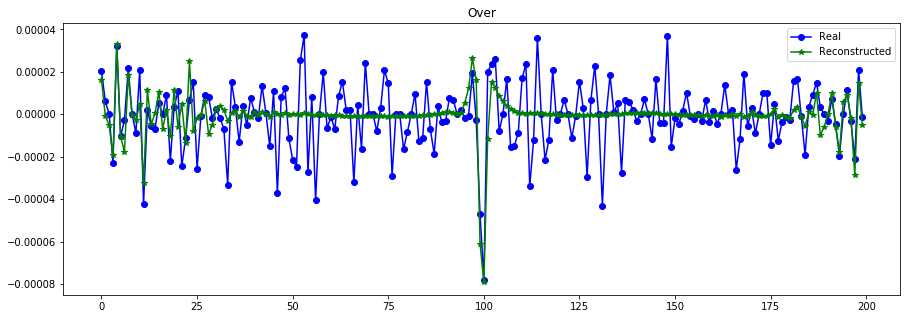

----------------------------------------------------------------


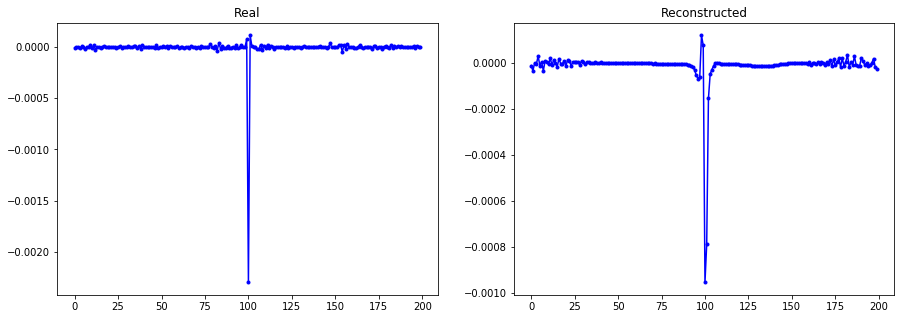

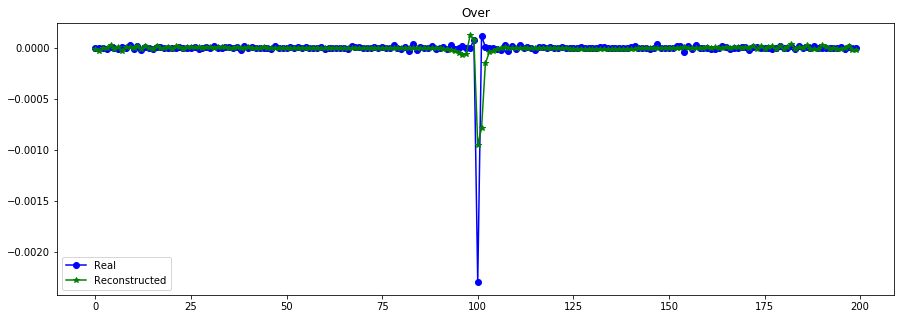

----------------------------------------------------------------


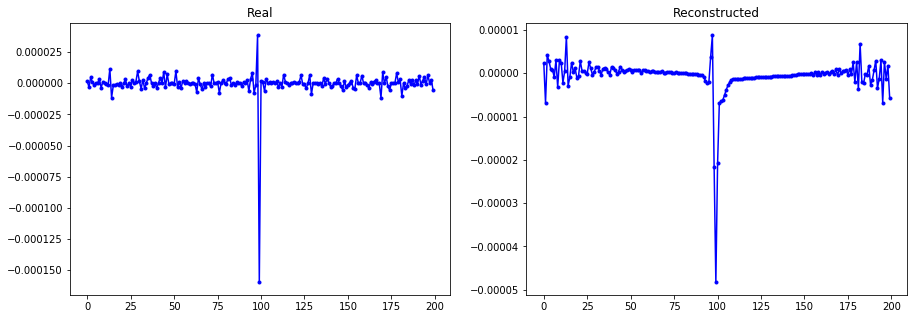

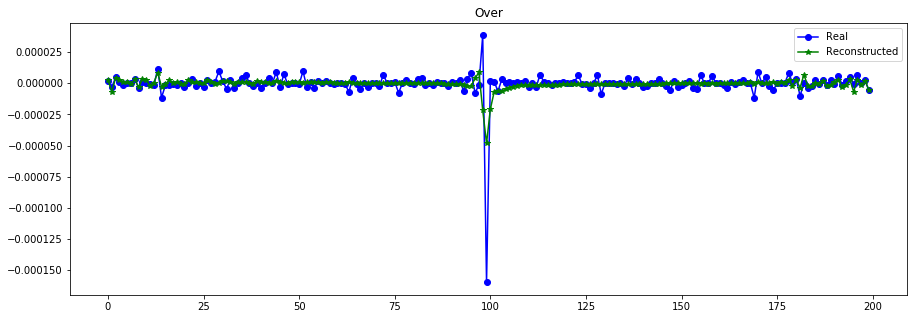

----------------------------------------------------------------


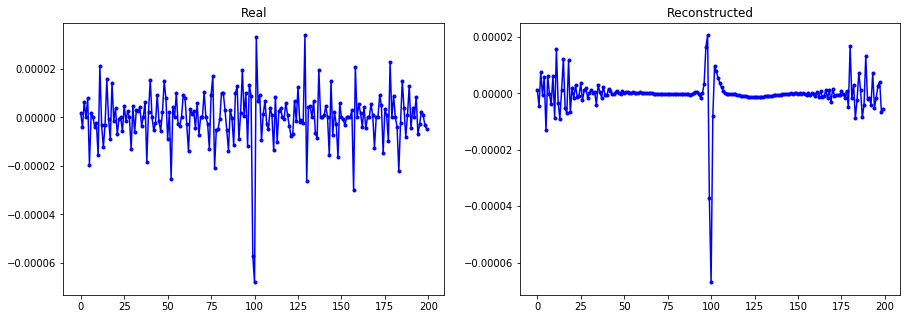

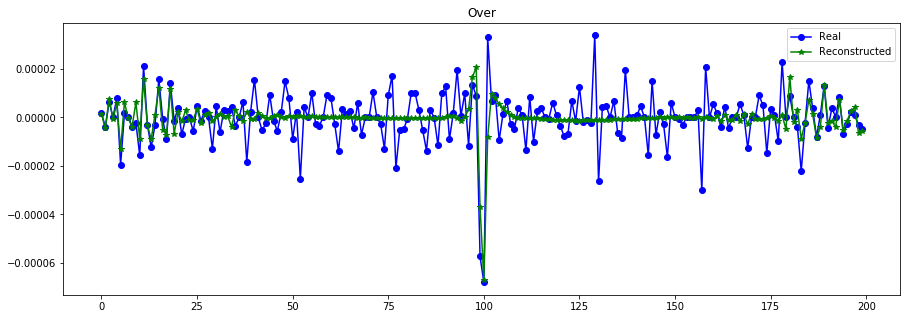

----------------------------------------------------------------


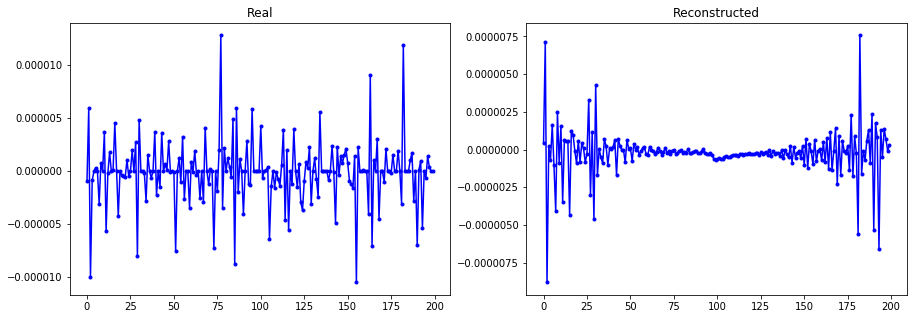

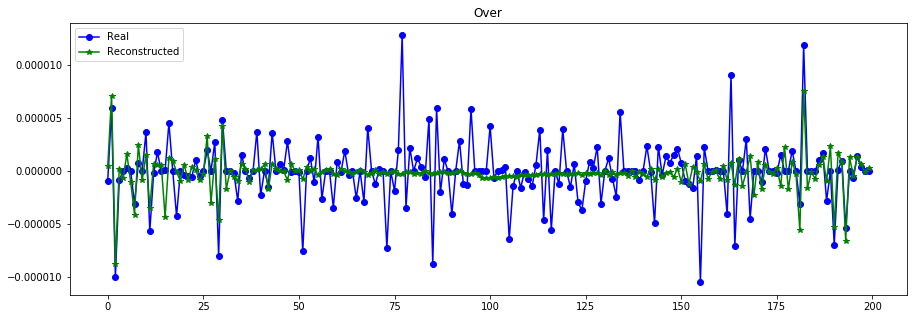

----------------------------------------------------------------


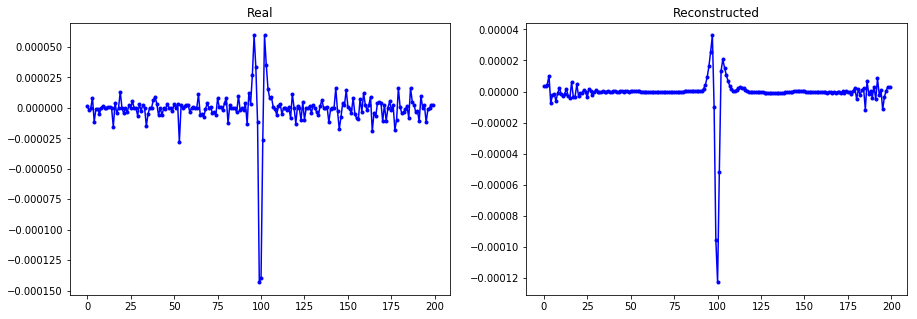

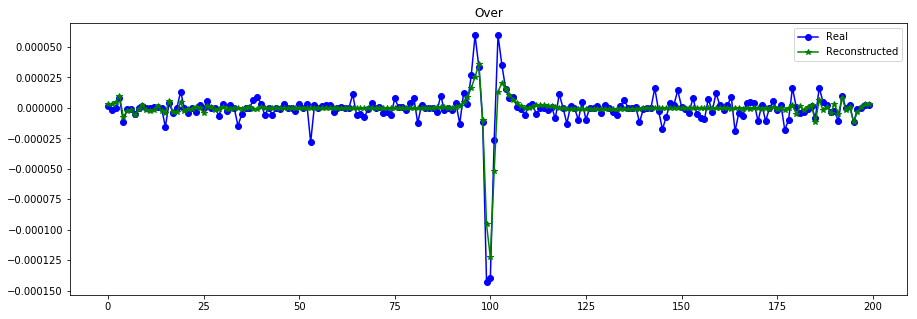

----------------------------------------------------------------


In [45]:
X_train_hat = vae.predict([X_train_t,X_train,S_train], batch_size=512)
print("Error scaled mse= ",scaled_MSE(X_train, X_train_hat, S_train))
plot_n_lc(X_train[:,:,0], X_train_hat, n= 15) #